## Import your stuff

In [1]:
import numpy as np
import simulators.jla_supernovae.jla_simulator as jla
import pydelfi.ndes as ndes
import pydelfi.delfi as delfi
import pydelfi.score as score
import pydelfi.priors as priors
import tensorflow as tf
tf.logging.set_verbosity(tf.logging.ERROR)
%matplotlib inline

In [2]:
import pylab as plt
import pyccl as ccl
import scipy
from scipy.interpolate import interp1d

import matplotlib
%matplotlib inline

import time
import importlib

print("CCL version you are using:",ccl.__version__)

CCL version you are using: 2.1.0


In [3]:
font_config = {"size" : 10,
               "family" : "serif"}

matplotlib.rc("font", **font_config)
matplotlib.rc("text", usetex=True)
# Move title to make space for exponents of y axis
matplotlib.rc("axes", titlepad=5) 
matplotlib.rc("axes", titlesize="medium") 

# Make the figures bigger in the notebook
matplotlib.rc("figure", dpi=150)

color_map = plt.get_cmap("tab10")

paper_textwidth = 7.125
fig_size = (paper_textwidth/2, 2.6)

plot_adjust = dict(left=0.2, top=0.9, bottom=0.2)

In [4]:
import simulators.mass_function_n_counts.simulator_trapz_3params as n_counts_simulator
#importlib.reload(n_counts_simulator)

In [5]:
importlib.reload(delfi)

<module 'pydelfi.delfi' from '/home/aizhana/.conda/envs/fast-mpi4py/lib/python3.7/site-packages/pydelfi/delfi.py'>

## Set up priors on params of interest (for now): {$\Omega_{m}h^{2} = \Omega_{cdm}h^{2} + \Omega_{b}h^{2}$, $\sigma_{8}$, $h$, $n_{s}$, $w_{0}$}

In [6]:
lower = np.array([0.1125, 0.020, 0.6])
upper = np.array([0.1275, 0.024, 1.1])
prior = priors.Uniform(lower, upper)

In [7]:
theta_fiducial = np.array([0.1197, 0.02222, 0.76])
n_params = len(theta_fiducial)

## Set up the simulator
This must have the signature `simulator(parameters, seed, args, batch)` -> `np.array([batch, ndata])`

In [8]:
importlib.reload(n_counts_simulator)

<module 'simulators.mass_function_n_counts.simulator_trapz_3params' from '/home/aizhana/pydelfi_cluster_counts/examples/simulators/mass_function_n_counts/simulator_trapz_3params.py'>

In [9]:
N_countsSimulator = n_counts_simulator.Model()

N_countsSimulator.N_counts

array([1.78485558e+04, 5.76970955e+04, 7.91959673e+04, 7.60280551e+04,
       5.88513395e+04, 2.53149917e+03, 6.50857065e+03, 6.79905624e+03,
       4.77690342e+03, 2.60821304e+03, 1.41326957e+02, 2.40973379e+02,
       1.54407659e+02, 6.19686706e+01, 1.80224732e+01, 1.15792928e+00,
       8.97137339e-01, 2.22002922e-01, 2.95445872e-02, 2.45078214e-03])

In [10]:
log10masses = np.linspace(14, 16, num = 5)
z_min = np.linspace(0.1, 0.9, num = 5)
z_max = np.linspace(0.2, 1.0, num = 5)

In [11]:
N_countsSimulator.n_counts_trapz(theta_fiducial, 0.1, 0.2, 14.0, 14.5)

computing cosmo: 8.300400000038621e-05 s
computing halo mass function object: 0.0968842530000007 s
computing factors: 0.1014923320000003 s
loop over z_steps: 0.027156704999999448 s


17848.555764027973

In [12]:
N_countsSimulator.n_counts_trapz_all(theta_fiducial, z_min, z_max, log10masses)

array([1.78485558e+04, 5.76970955e+04, 7.91959673e+04, 7.60280551e+04,
       5.88513395e+04, 2.53149917e+03, 6.50857065e+03, 6.79905624e+03,
       4.77690342e+03, 2.60821304e+03, 1.41326957e+02, 2.40973379e+02,
       1.54407659e+02, 6.19686706e+01, 1.80224732e+01, 1.15792928e+00,
       8.97137339e-01, 2.22002922e-01, 2.95445872e-02, 2.45078214e-03])

In [13]:
N_countsSimulator.N_counts.shape

(20,)

In [14]:
def simulator(theta, seed, simulator_args, batch):
    return N_countsSimulator.simulation(theta, seed)

simulator_args = None

## Set up fake compressor for now

In [15]:
def compressor(data, compressor_args):
    return data
compressor_args=None

## Load data

In [16]:
N_counts_data = np.load('N_counts_random_data.npy')
N_counts_data

array([[17720, 57628, 78955, 75947, 58462],
       [ 2499,  6606,  6684,  4733,  2579],
       [  140,   228,   173,    55,    15],
       [    1,     0,     0,     1,     0]])

## Define ensemble of NDEs

In [17]:
NDEs1 = [ndes.MixtureDensityNetwork(n_parameters=n_params, n_data=20, n_components=1, n_hidden=[30,30], activations=[tf.tanh, tf.tanh], index=0),
       ndes.MixtureDensityNetwork(n_parameters=n_params, n_data=20, n_components=2, n_hidden=[30,30], activations=[tf.tanh, tf.tanh], index=1),
       ndes.MixtureDensityNetwork(n_parameters=n_params, n_data=20, n_components=3, n_hidden=[30,30], activations=[tf.tanh, tf.tanh], index=2),
       ndes.MixtureDensityNetwork(n_parameters=n_params, n_data=20, n_components=4, n_hidden=[30,30], activations=[tf.tanh, tf.tanh], index=3),
       ndes.MixtureDensityNetwork(n_parameters=n_params, n_data=20, n_components=5, n_hidden=[30,30], activations=[tf.tanh, tf.tanh], index=4),
       ndes.ConditionalMaskedAutoregressiveFlow(n_parameters=n_params, n_data=20, n_hiddens=[50,50], n_mades=5, act_fun=tf.tanh, index=5)]

## Create DELFI object

In [18]:
DelfiEnsemble = delfi.Delfi(N_counts_data.reshape(20), prior, NDEs1, 
                            theta_fiducial = theta_fiducial, 
                            param_limits = [lower, upper],
                            param_names = ['\\Omega_{cdm}h^{2}', '\\Omega_{b}h^{2}', '\\sigma_{8}'],
                            results_dir = "simulators/mass_function_n_counts/results_3params_200sims_2/")

## Sequential Neural Likelihood

In [19]:
n_initial = 10 #200
n_batch = 20 #200
n_populations = 10 #20


Sampling approximate posterior...
Done.
Removed no burn in


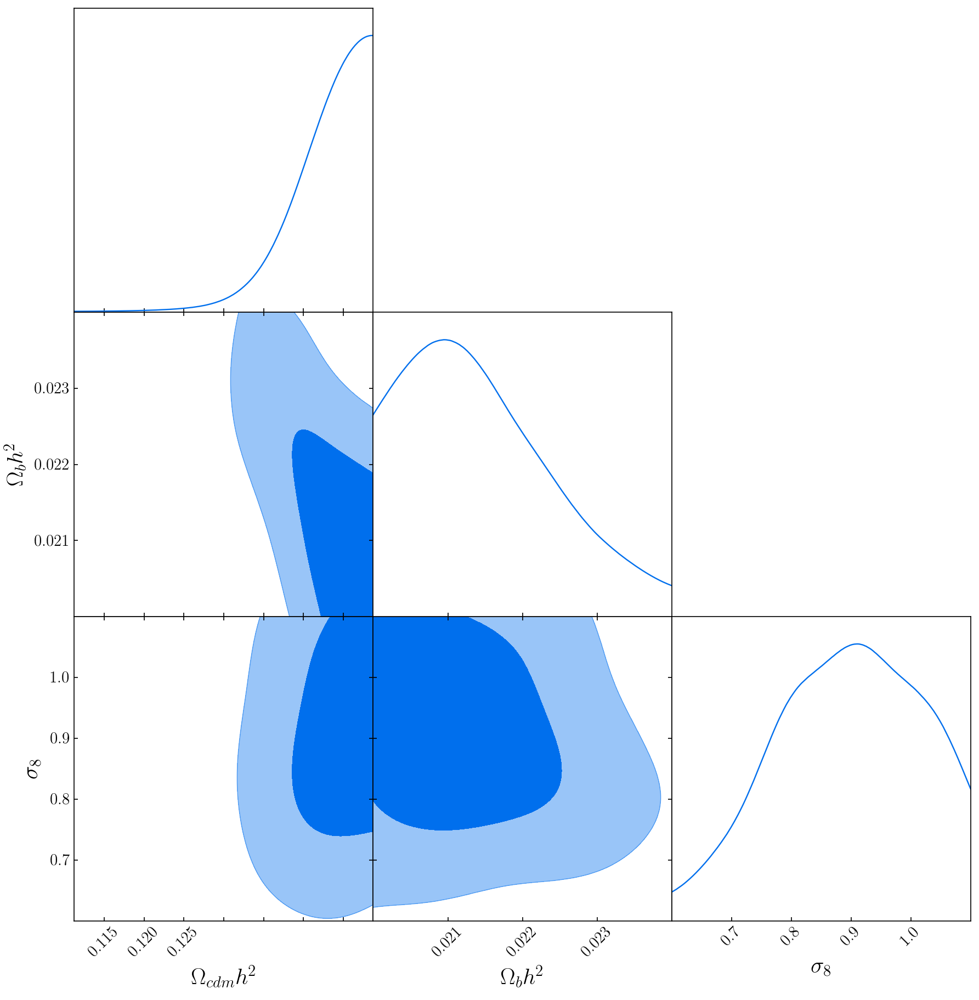

Population 1/10
Sampling proposal density...
Done.


Sampling approximate posterior...
Done.
Removed no burn in


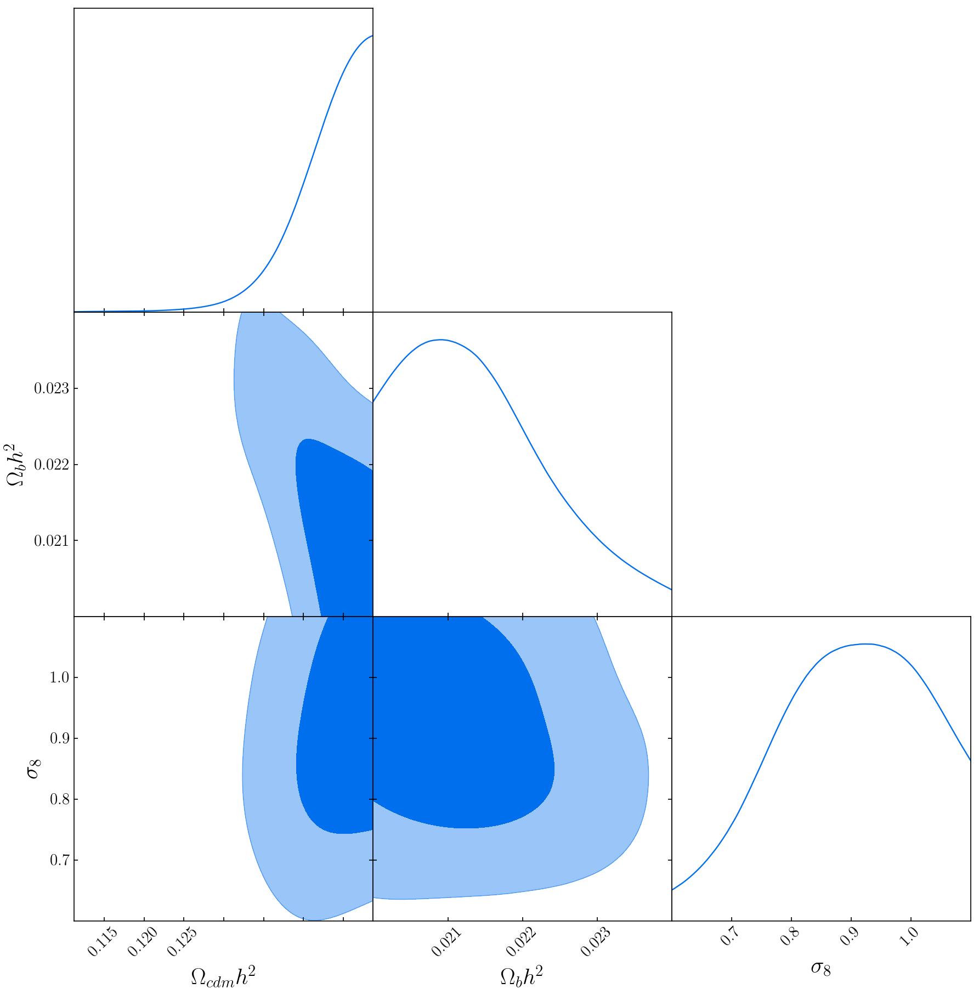

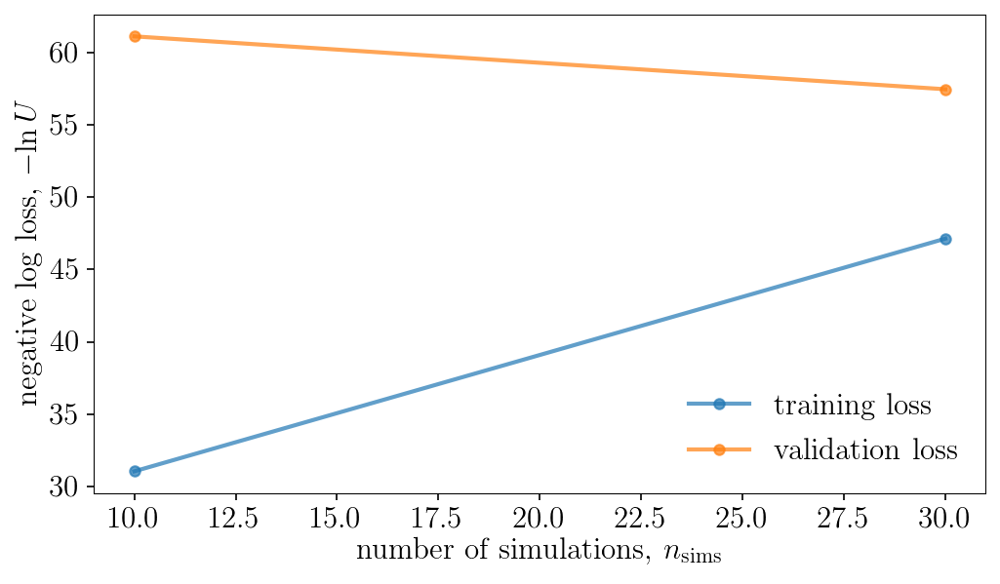

Population 2/10
Sampling proposal density...
Done.


Sampling approximate posterior...
Done.
Removed no burn in


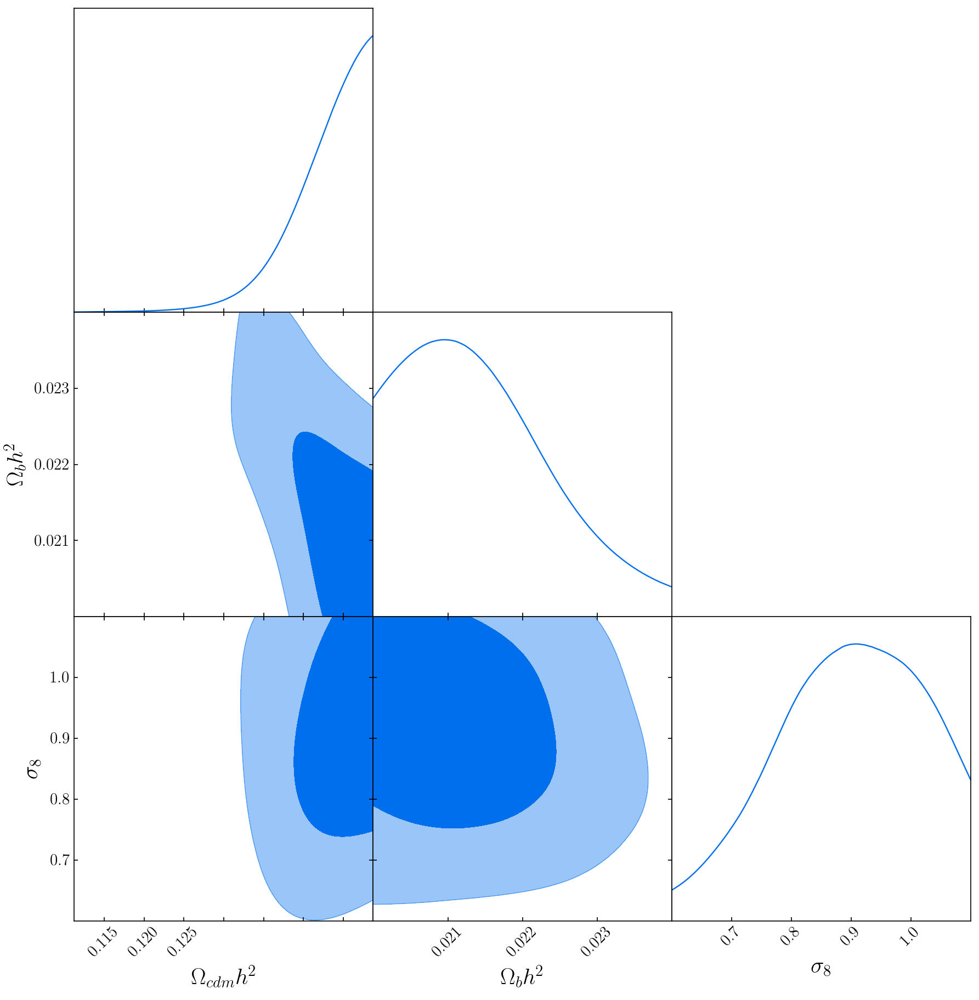

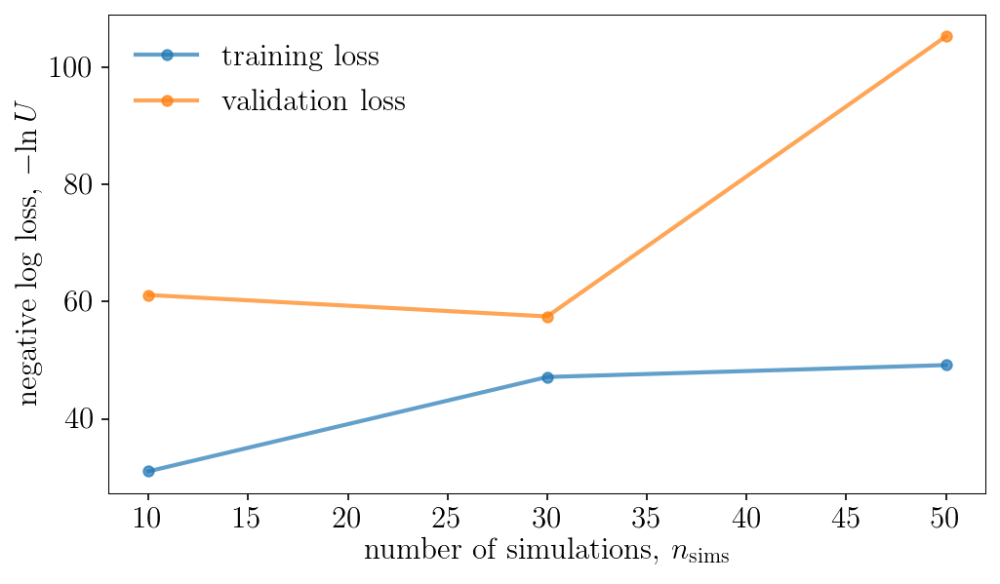

Population 3/10
Sampling proposal density...
Done.


Sampling approximate posterior...
Done.
Removed no burn in


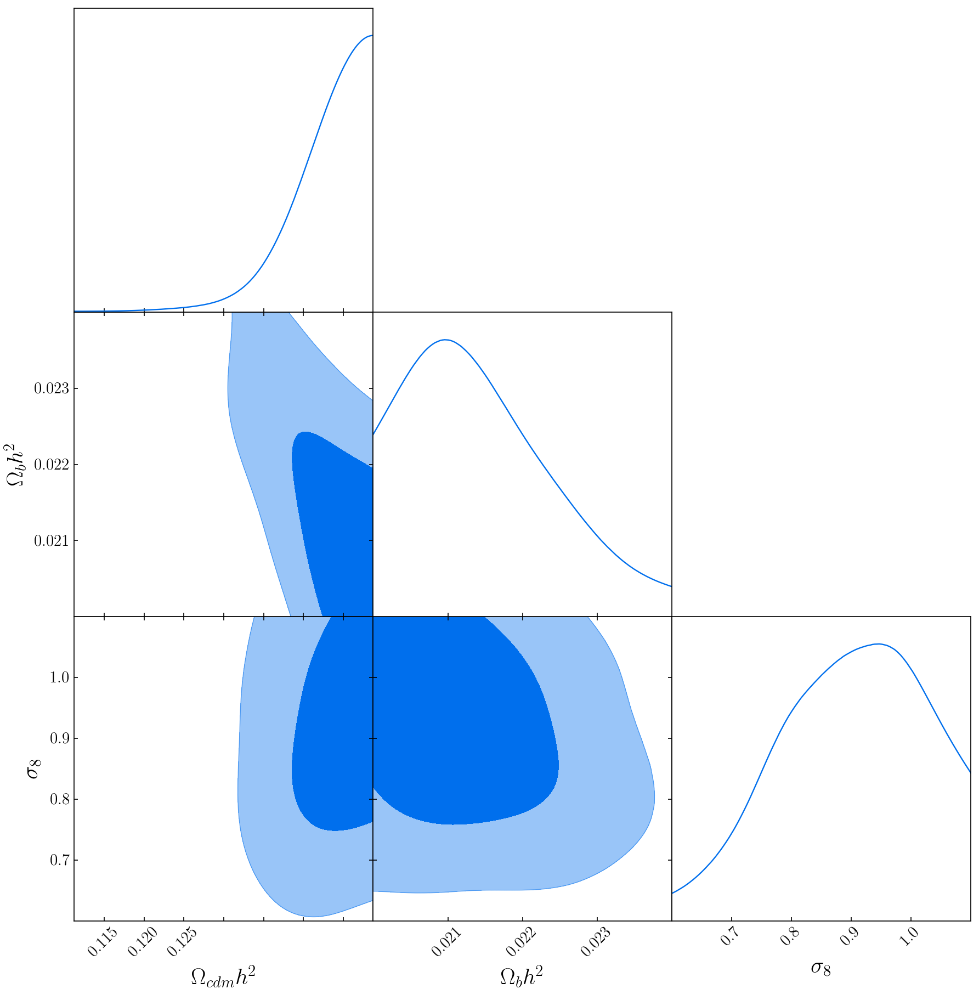

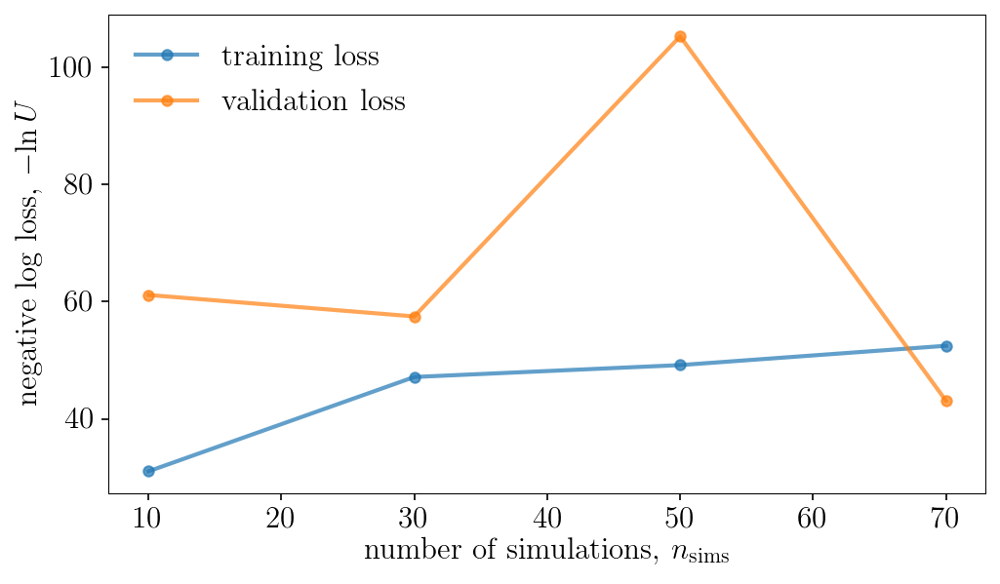

Population 4/10
Sampling proposal density...
Done.


Sampling approximate posterior...
Done.
Removed no burn in


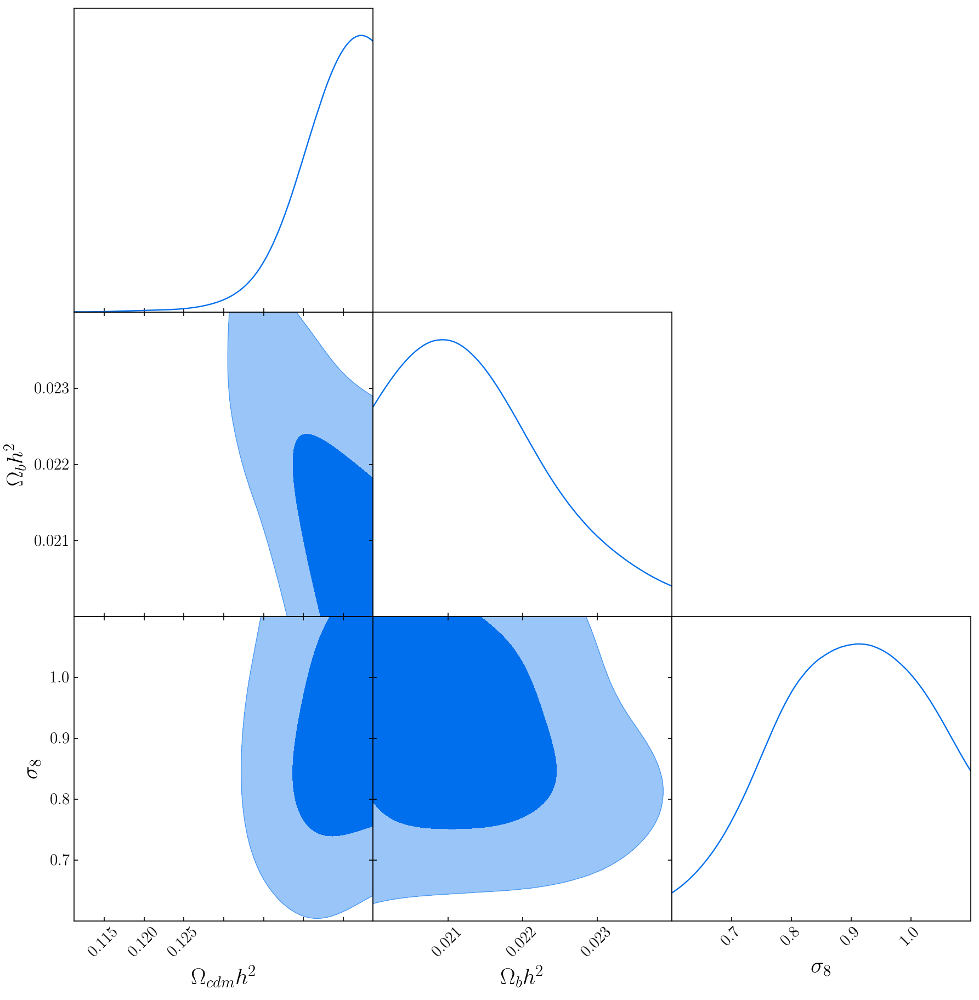

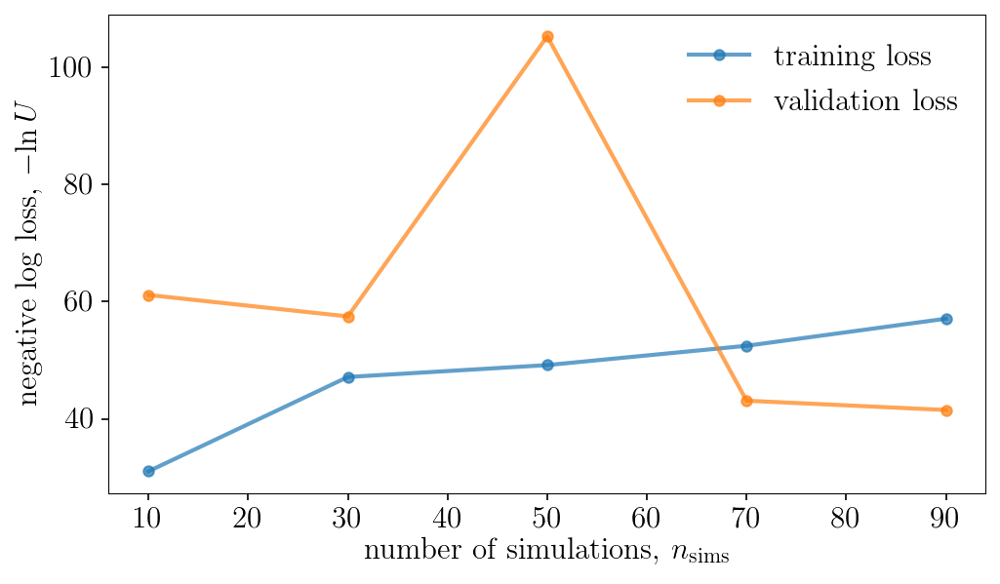

Population 5/10
Sampling proposal density...
Done.


Sampling approximate posterior...
Done.
Removed no burn in


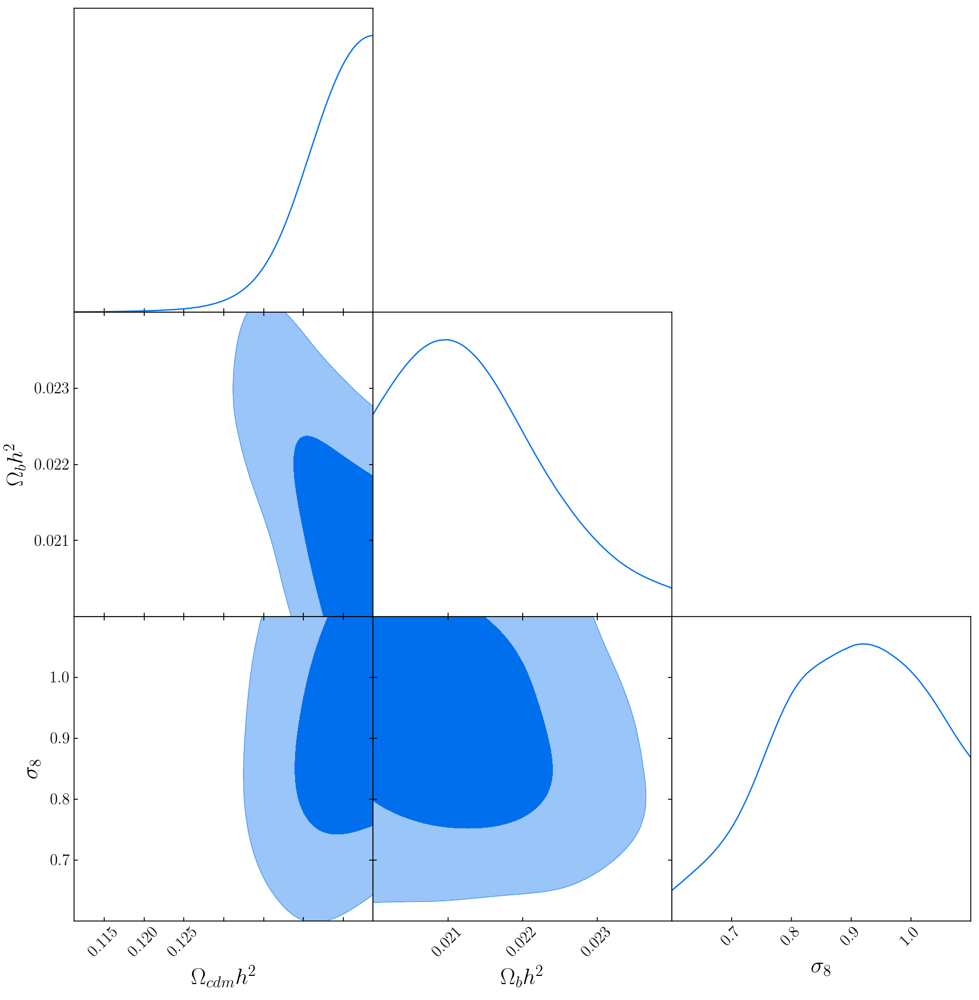

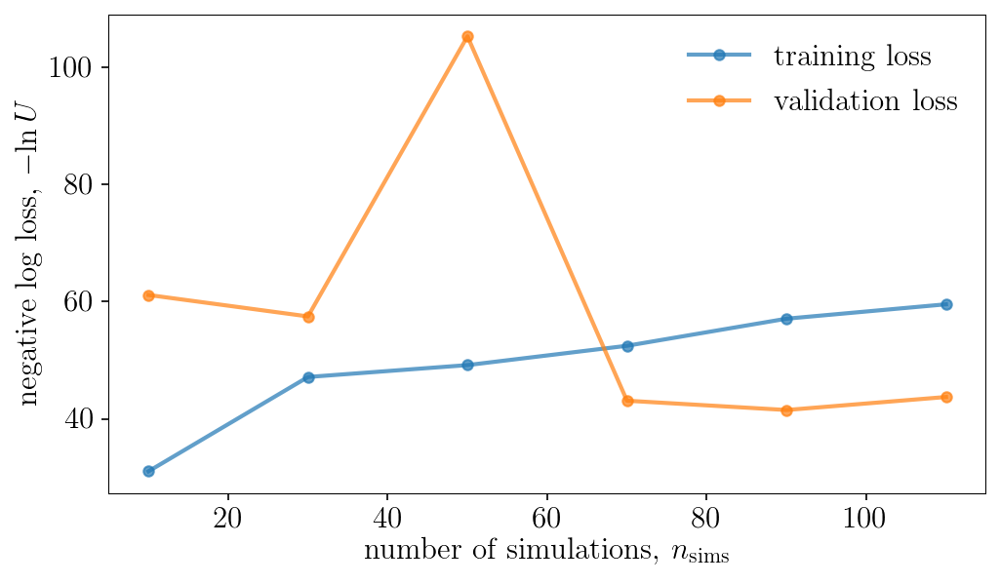

Population 6/10
Sampling proposal density...
Done.


Sampling approximate posterior...
Done.
Removed no burn in


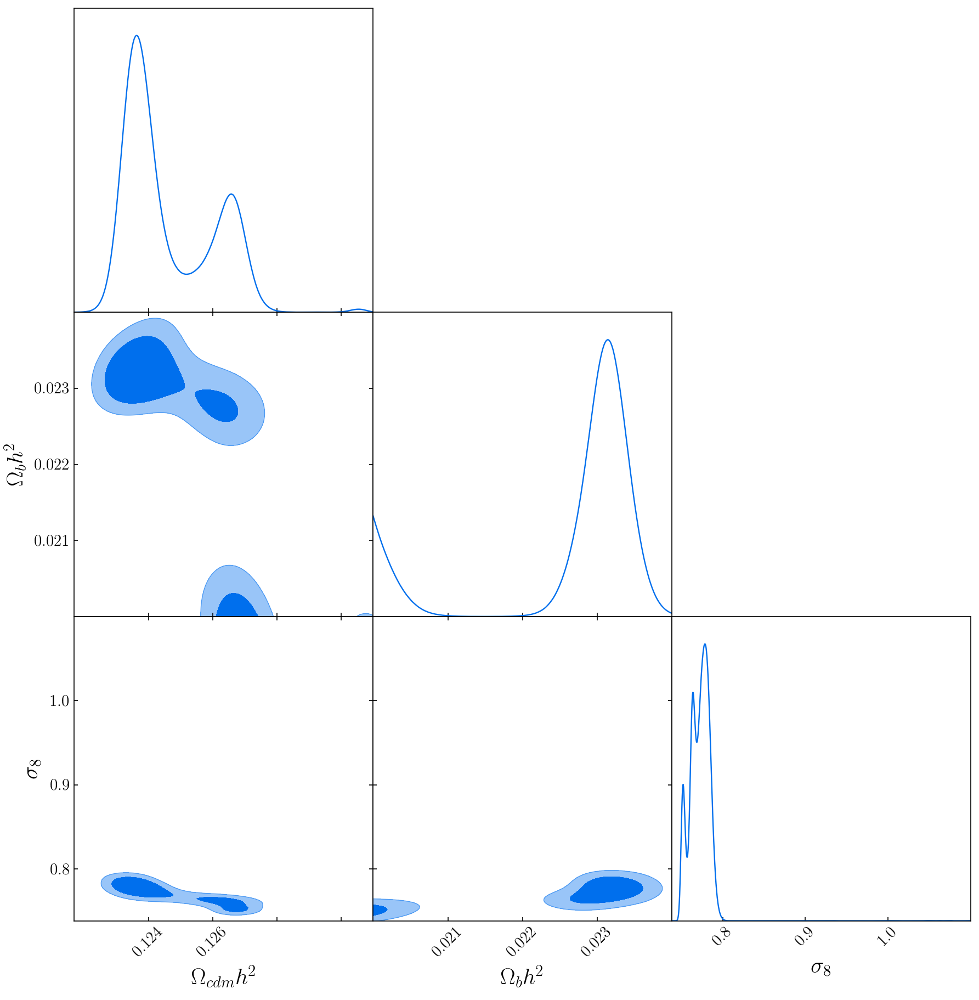

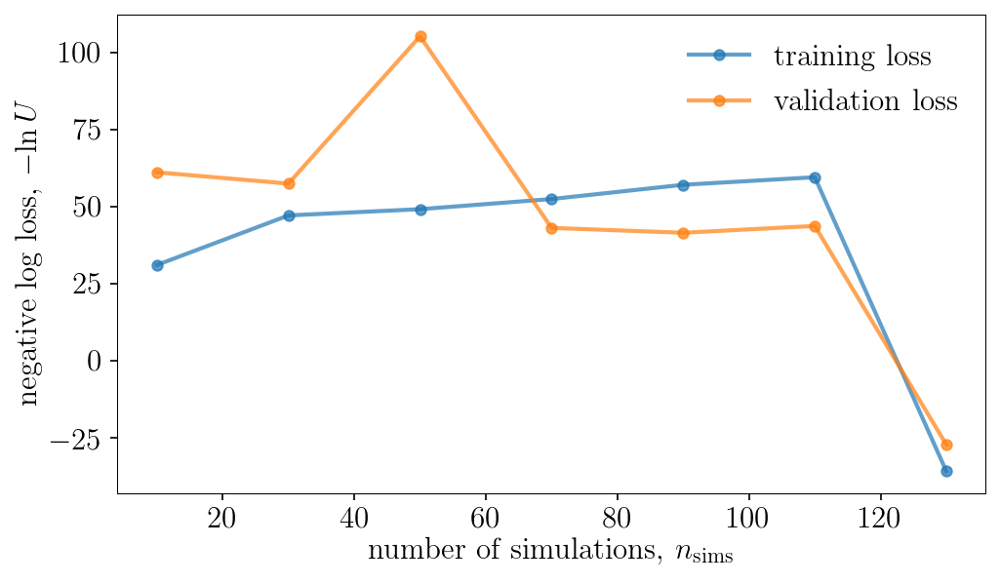

Population 7/10
Sampling proposal density...
Done.


Sampling approximate posterior...
Done.
Removed no burn in


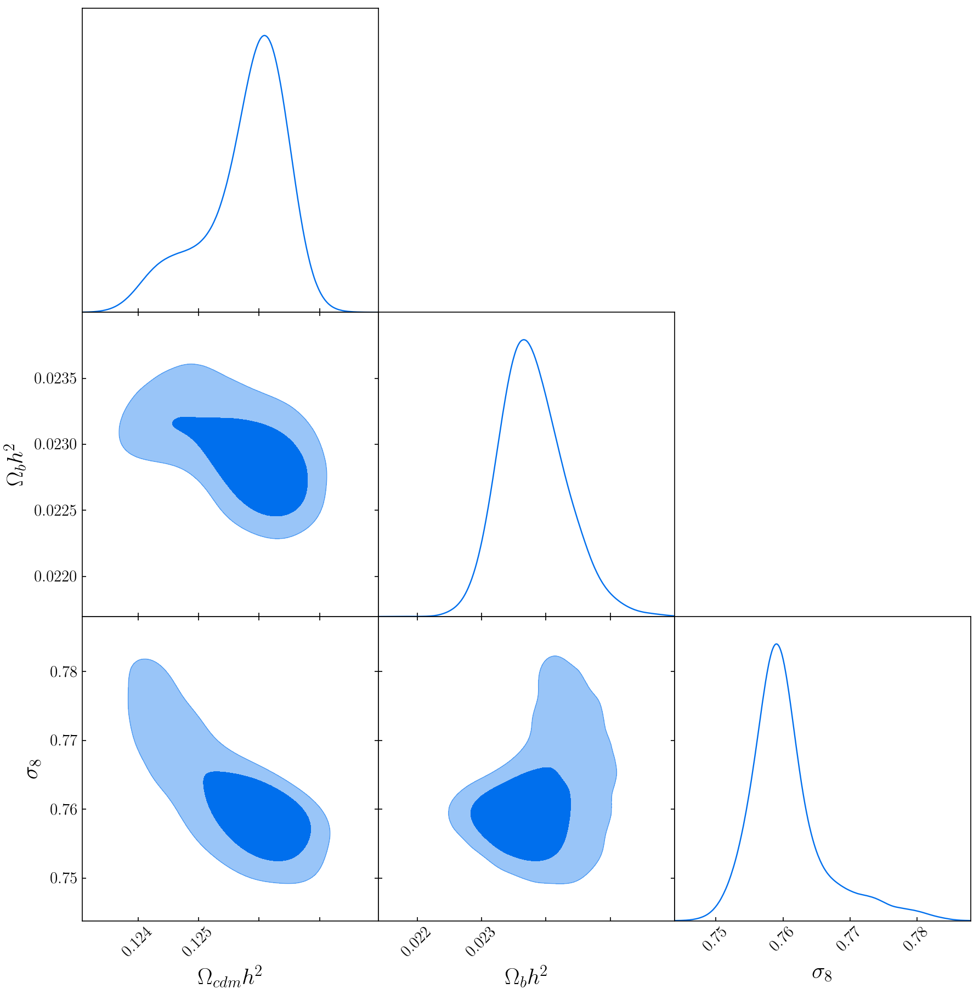

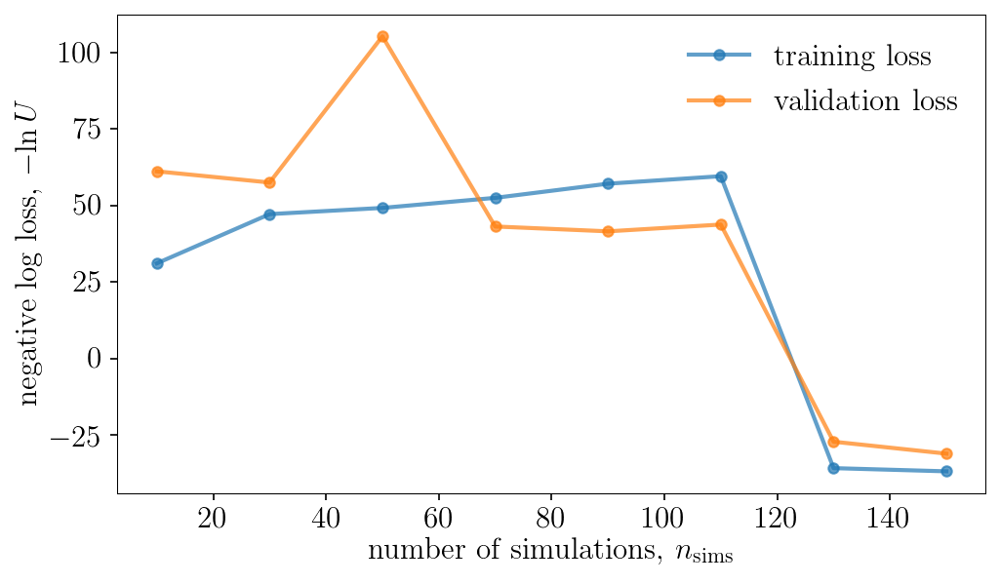

Population 8/10
Sampling proposal density...
Done.


Sampling approximate posterior...
Done.
Removed no burn in


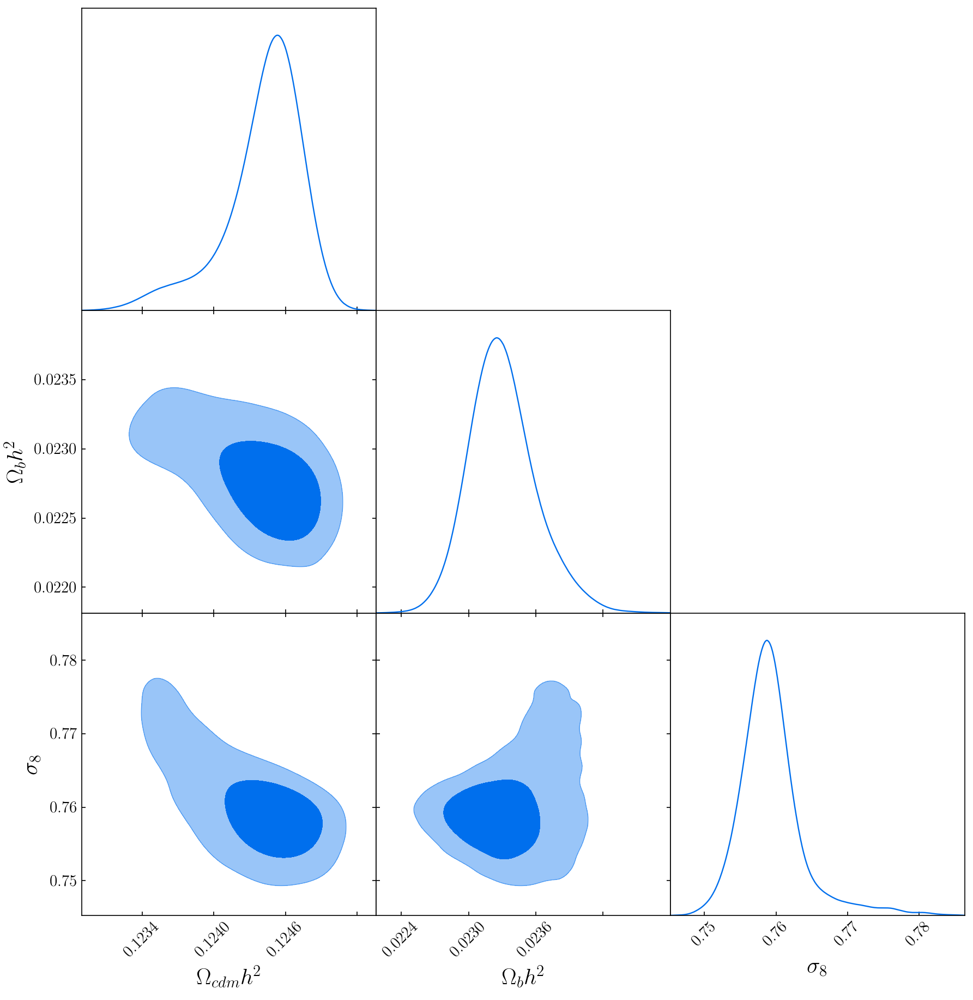

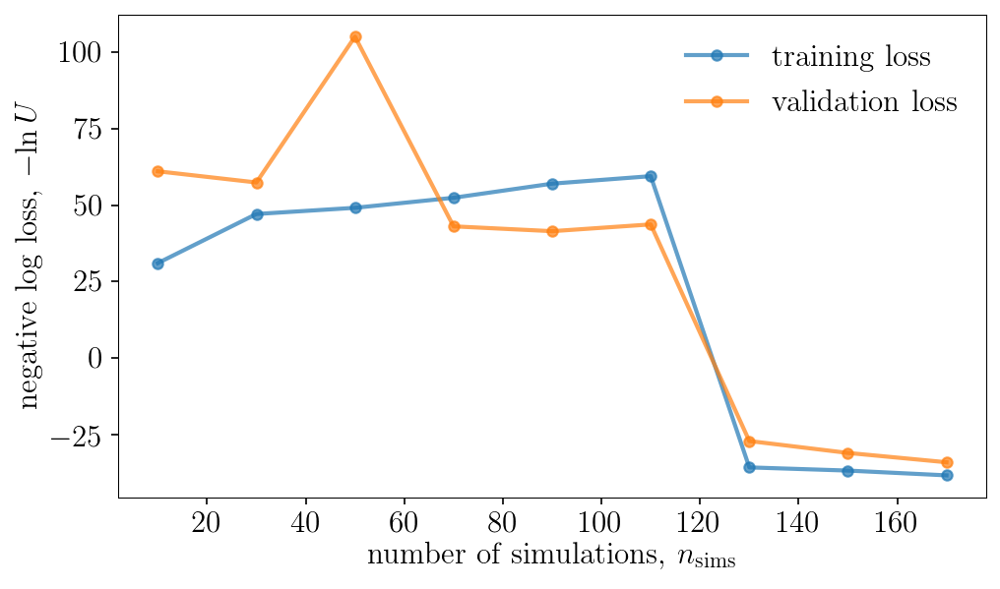

Population 9/10
Sampling proposal density...
Done.


Sampling approximate posterior...
Done.
Removed no burn in


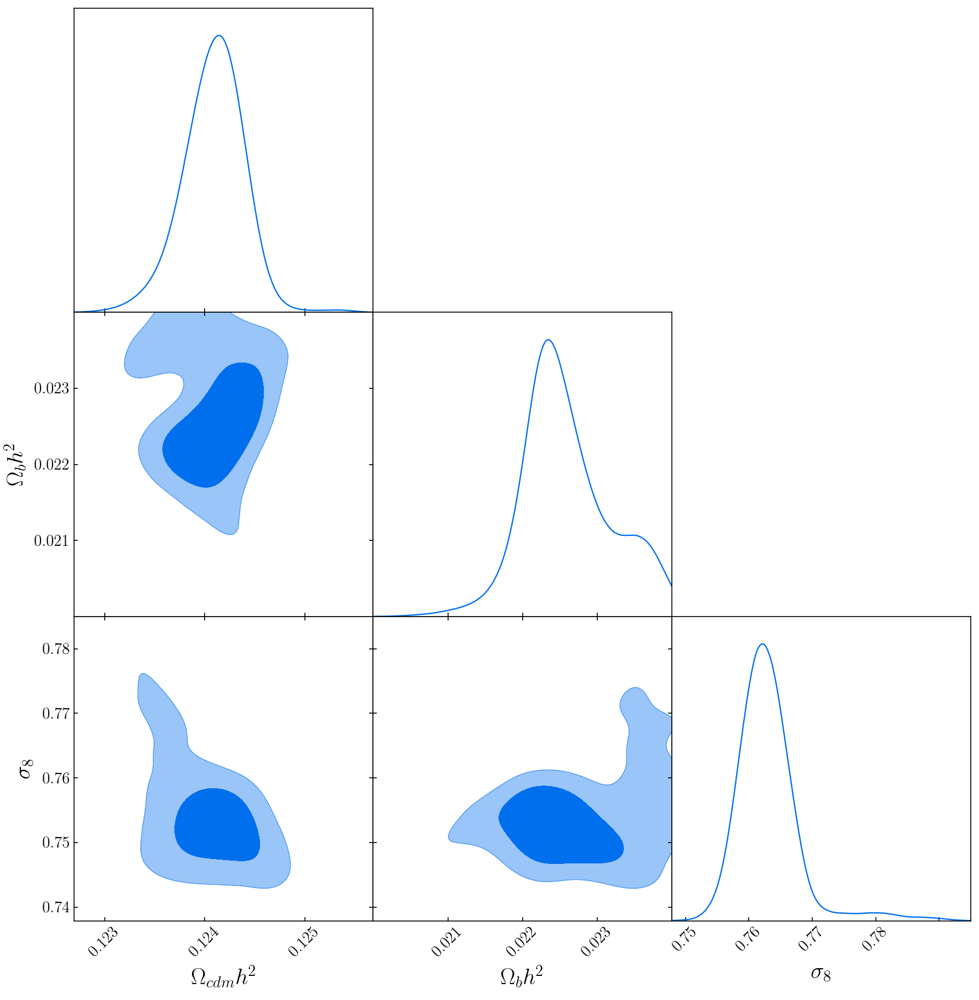

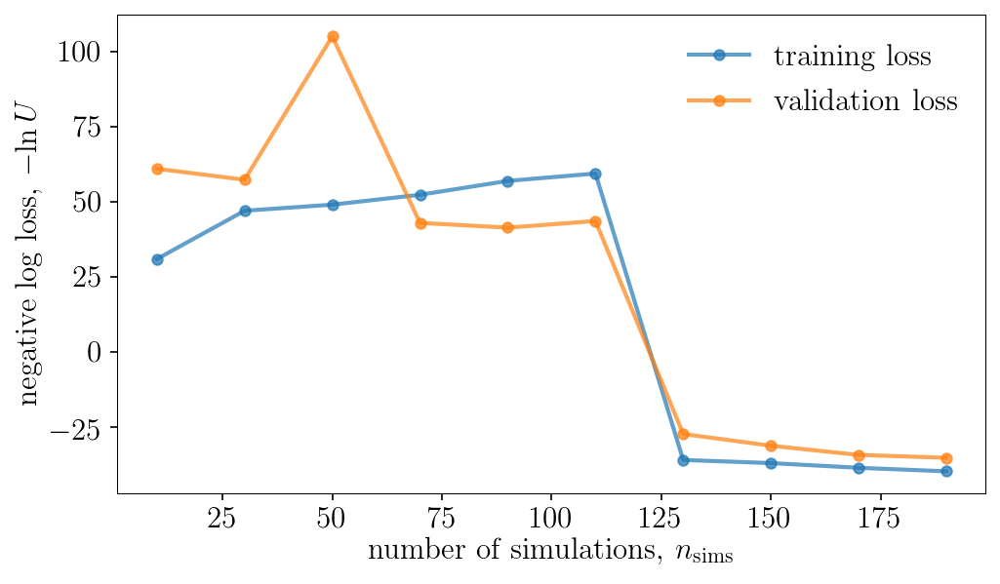

Population 10/10
Sampling proposal density...
Done.


Sampling approximate posterior...
Done.
Removed no burn in


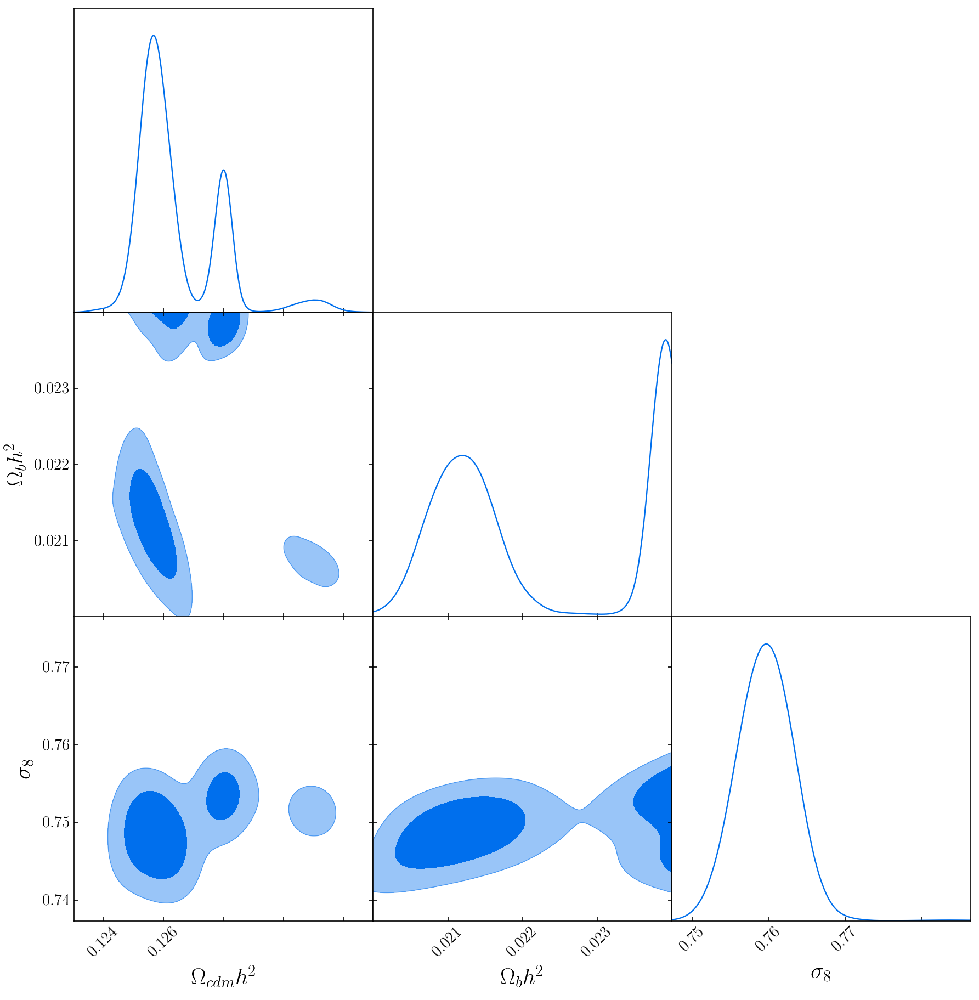

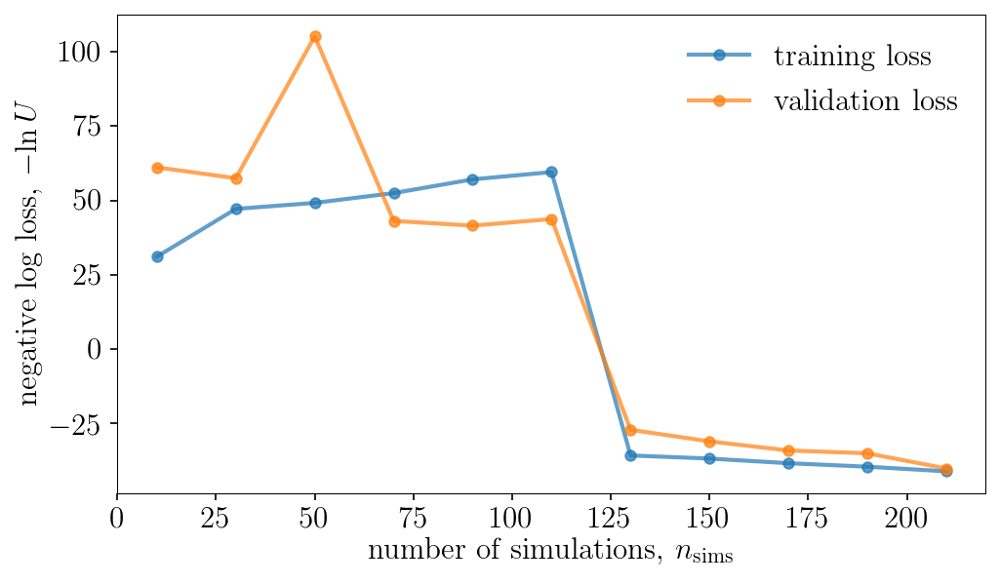

In [20]:
DelfiEnsemble.sequential_training(simulator, compressor, n_initial, n_batch, n_populations, patience=20, 
                                  save_intermediate_posteriors=True)

## Sample the learned posterior

In [21]:
x0 = DelfiEnsemble.posterior_samples[np.random.choice(np.arange(len(DelfiEnsemble.posterior_samples)), p=DelfiEnsemble.posterior_weights.astype(np.float32)/sum(DelfiEnsemble.posterior_weights), replace=False, size=DelfiEnsemble.nwalkers),:]
posterior_samples, posterior_weights, log_prob = DelfiEnsemble.emcee_sample(x0=x0)

## Alright let's plot it!
Feed it a list of `(n_samples, n_parameters)` arrays for making a triangle plot; in this case let's just plot the posterior samples.

Removed no burn in


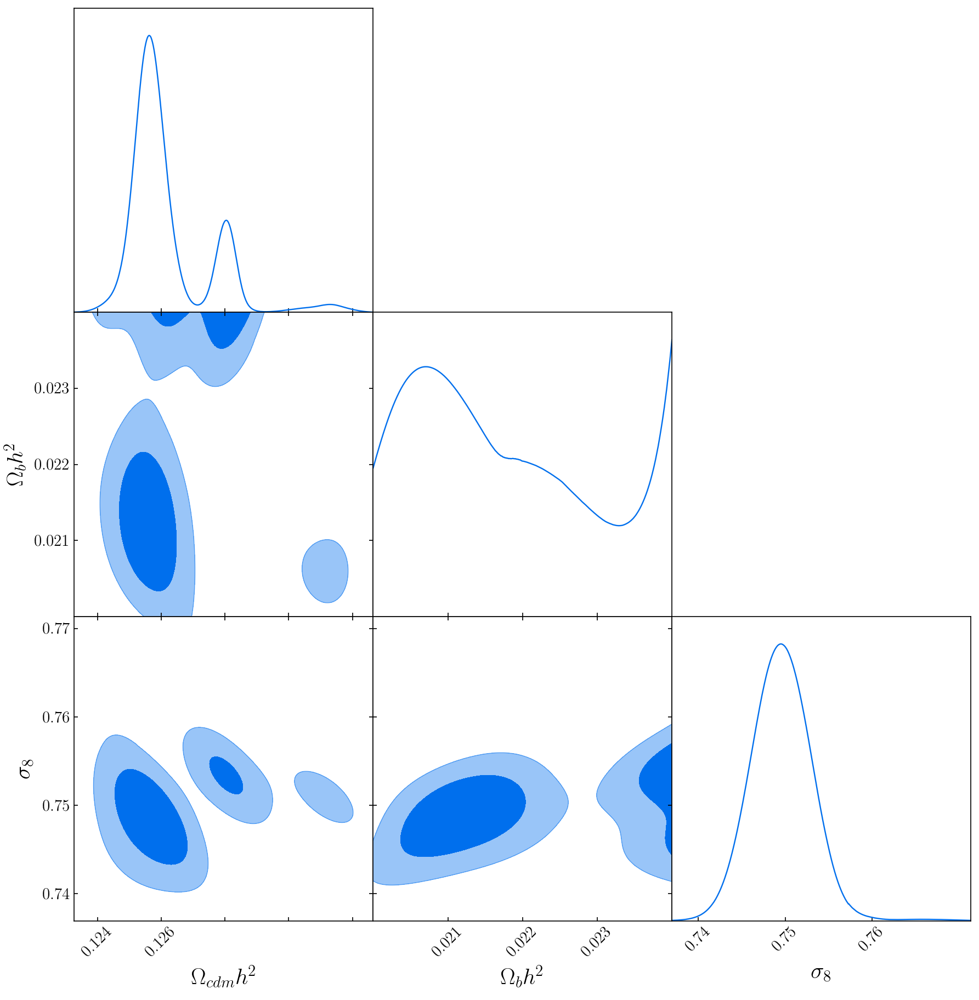

In [22]:
DelfiEnsemble.triangle_plot(samples=[posterior_samples], weights=[posterior_weights])


## Attempt 2

In [18]:
n_initial = 10 #200
n_batch = 20 #200
n_populations = 20 #20

Sampling approximate posterior...
Done.
Removed no burn in


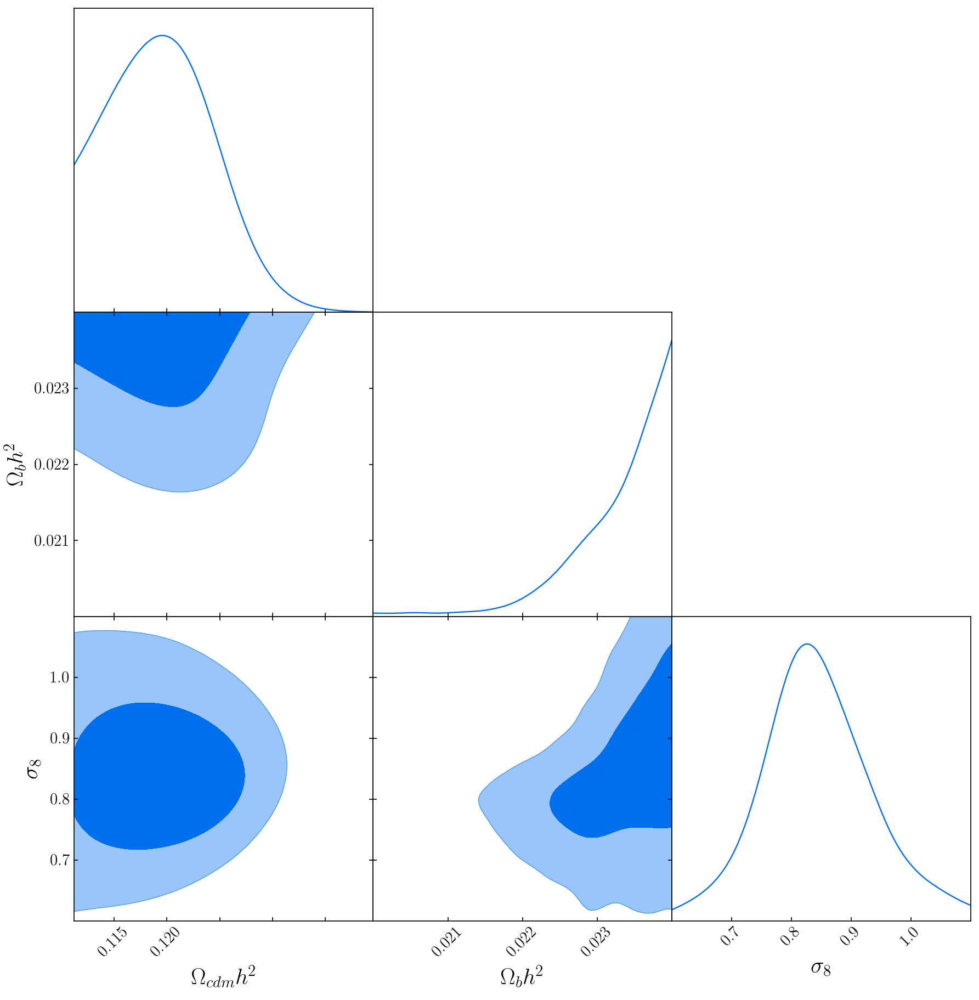

Population 1/20
Sampling proposal density...
Done.


Sampling approximate posterior...
Done.
Removed no burn in


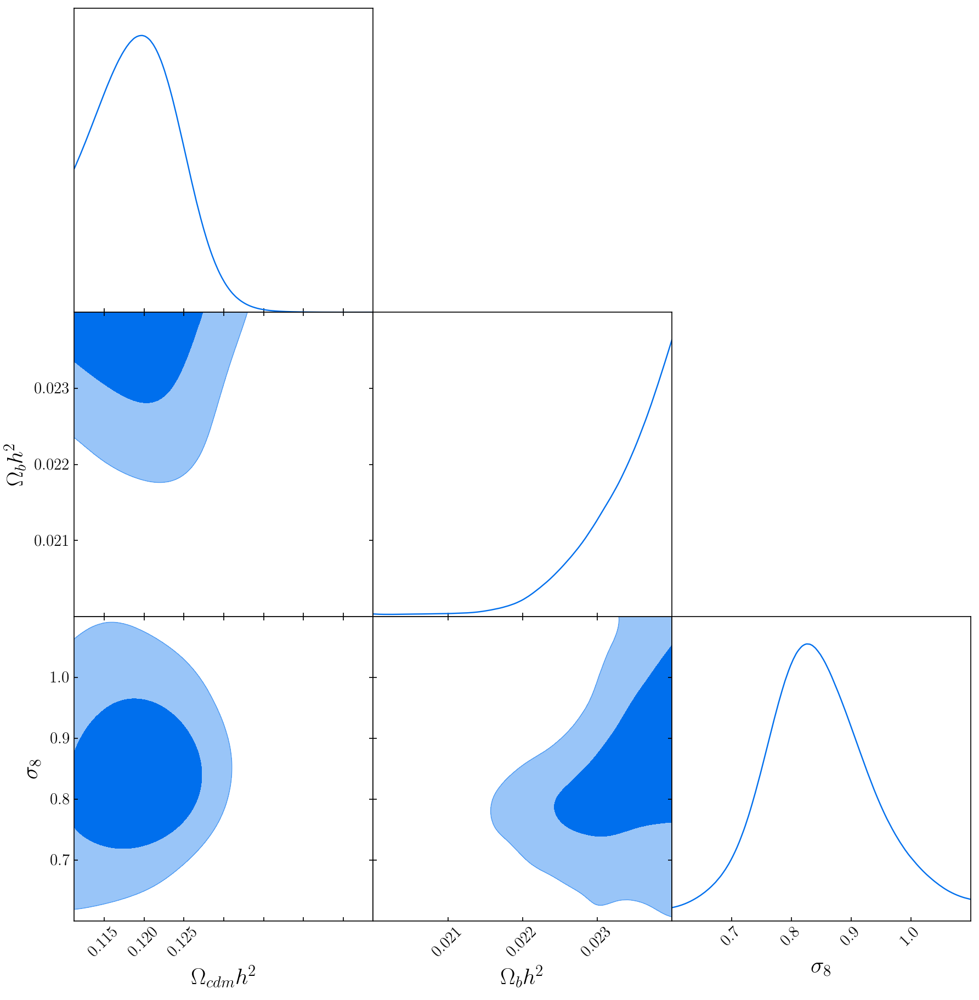

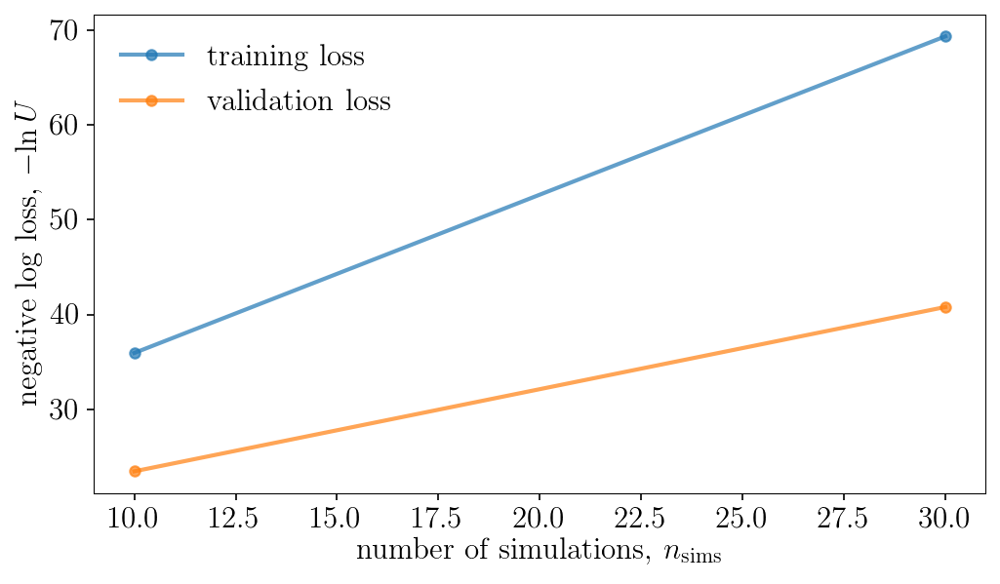

Population 2/20
Sampling proposal density...
Done.


Sampling approximate posterior...
Done.
Removed no burn in


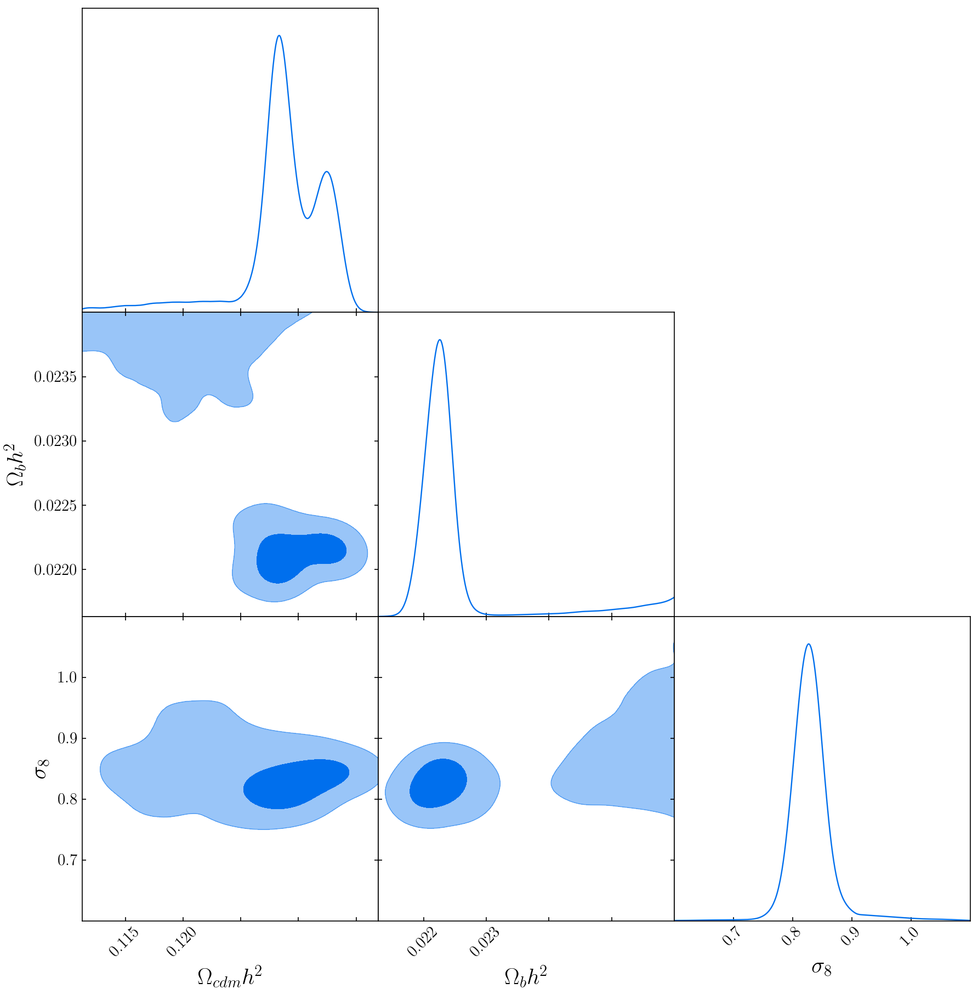

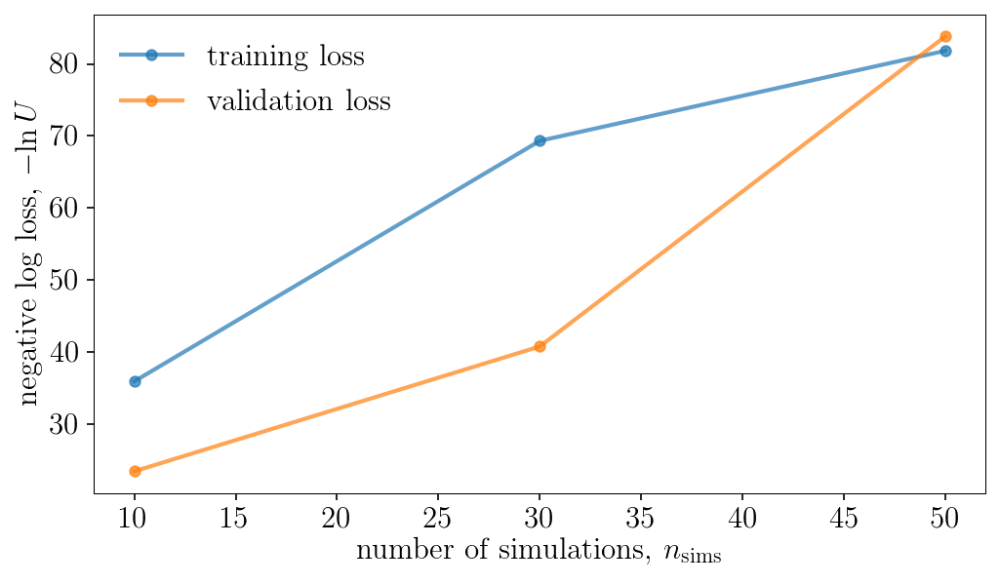

Population 3/20
Sampling proposal density...
Done.


Sampling approximate posterior...
Done.
Removed no burn in


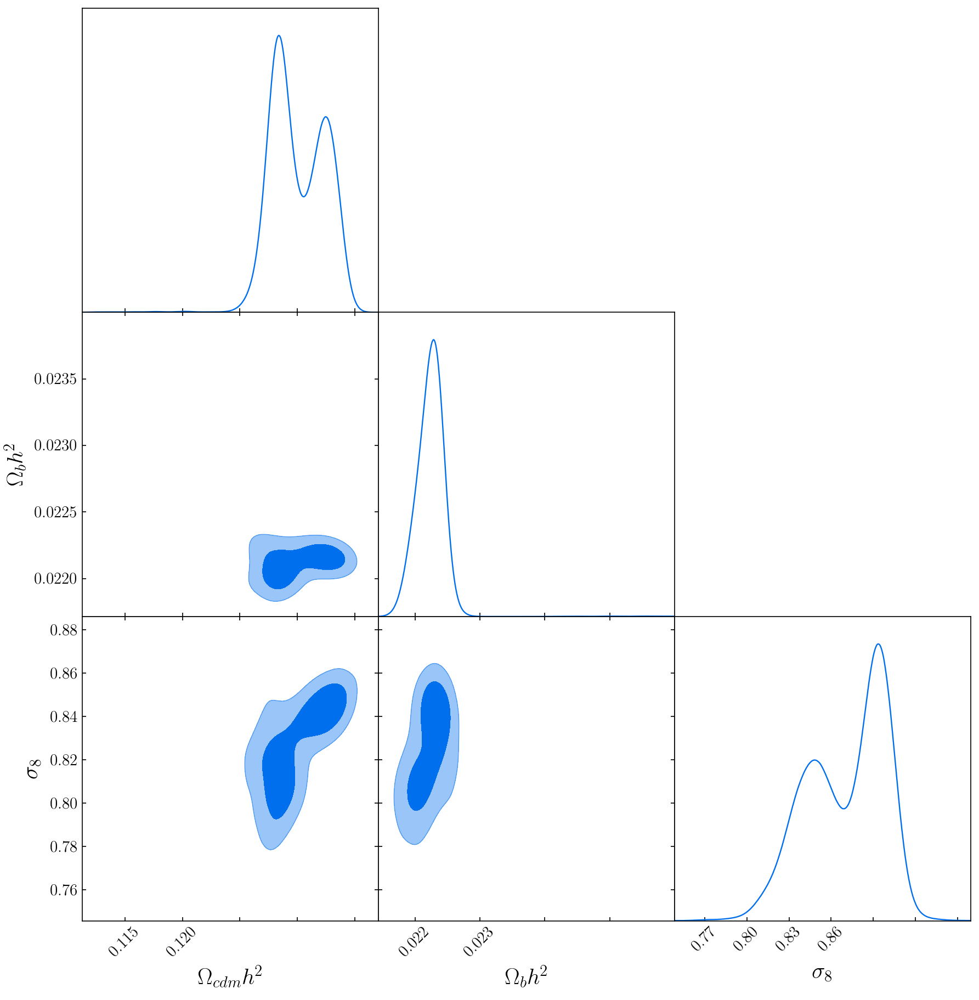

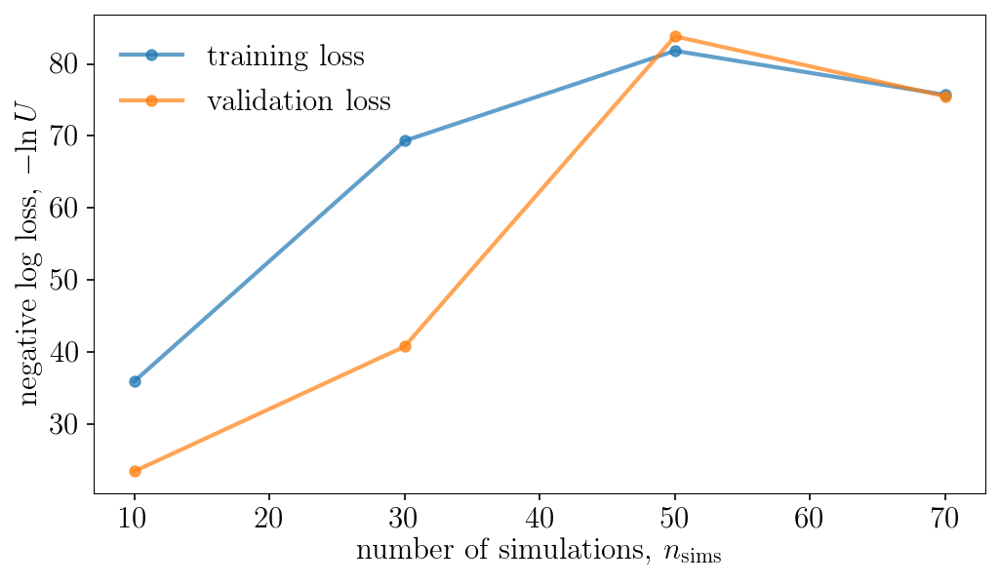

Population 4/20
Sampling proposal density...
Done.


Sampling approximate posterior...
Done.
Removed no burn in


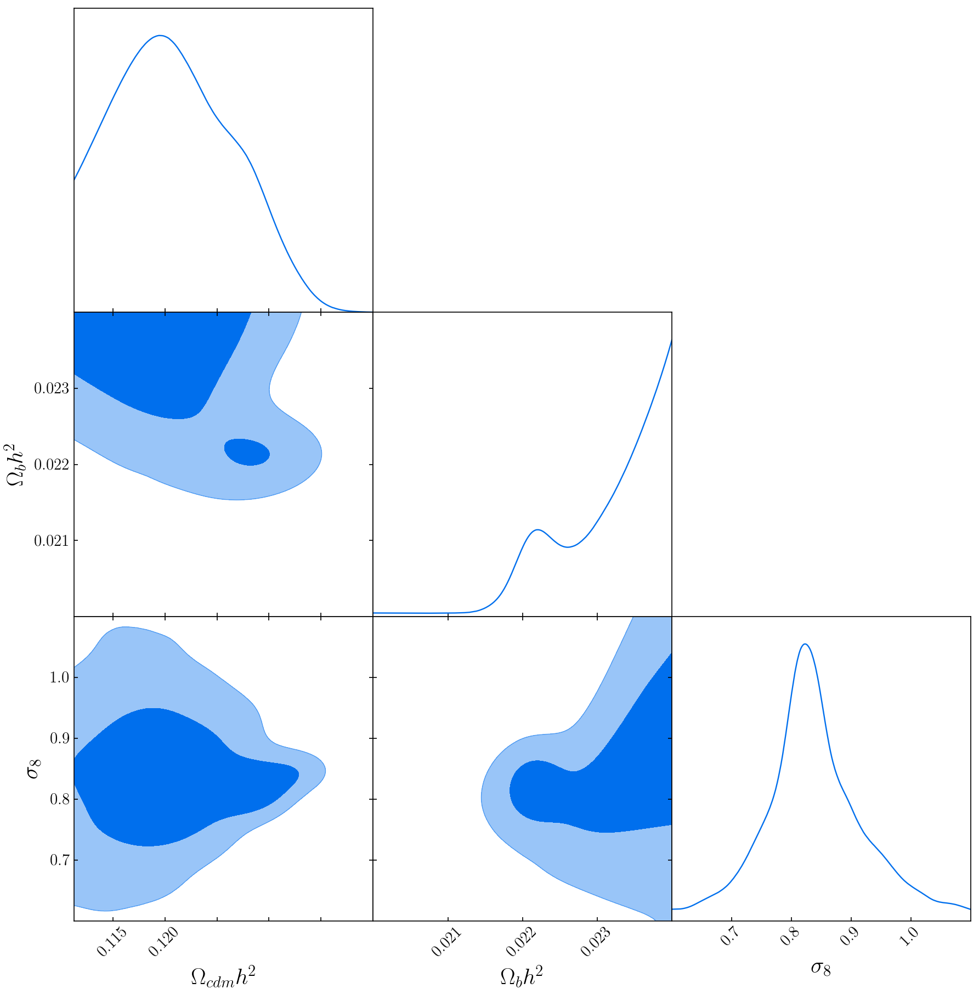

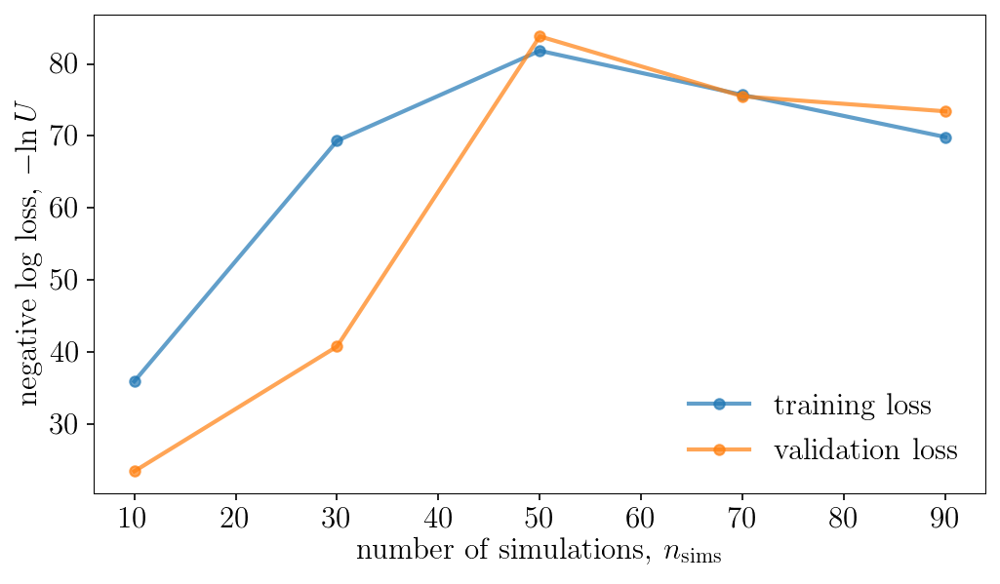

Population 5/20
Sampling proposal density...
Done.


Sampling approximate posterior...
Done.
Removed no burn in


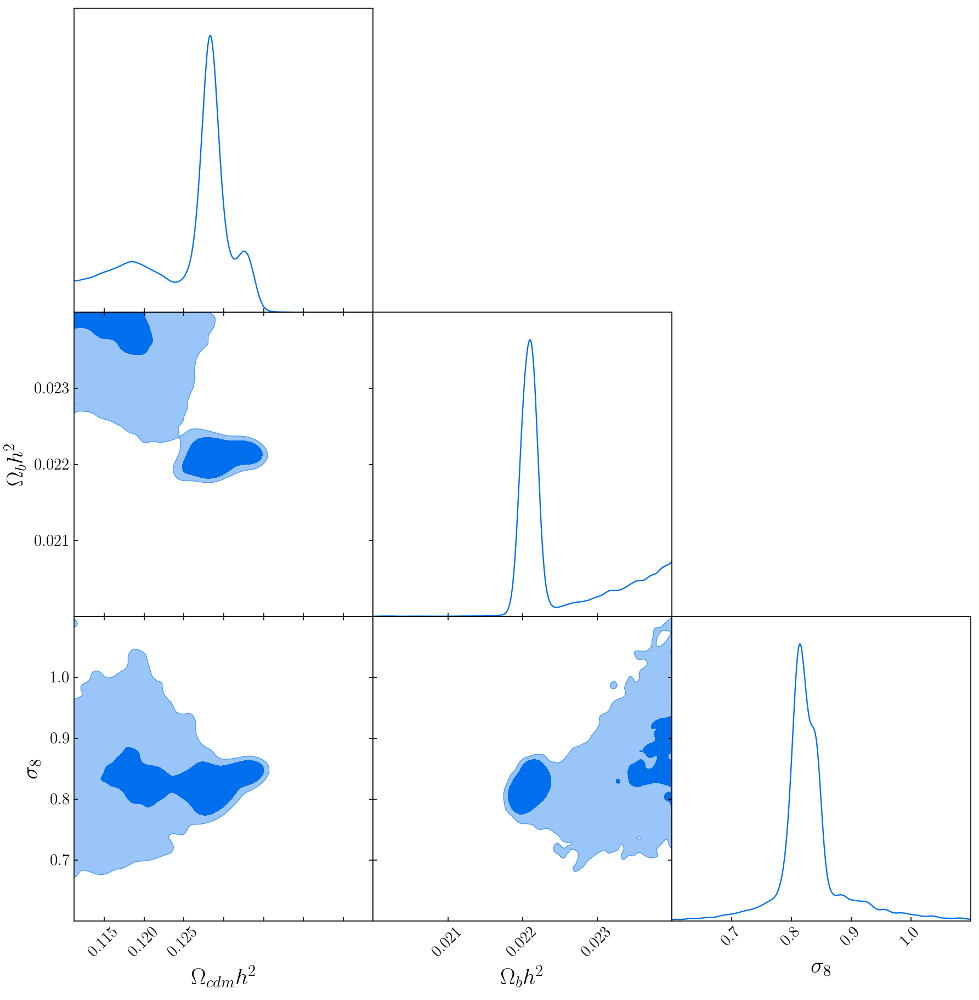

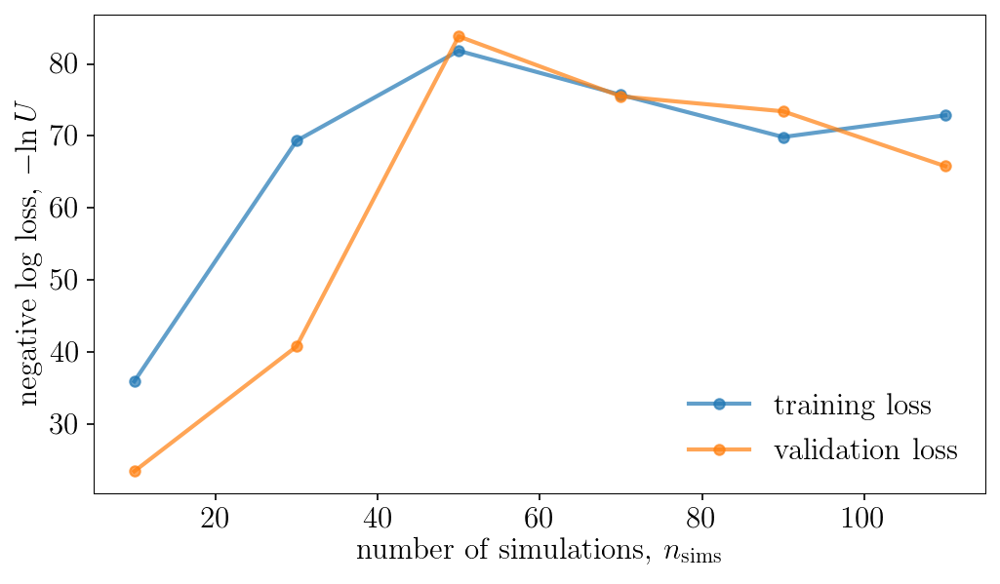

Population 6/20
Sampling proposal density...
Done.


Sampling approximate posterior...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.
Removed no burn in


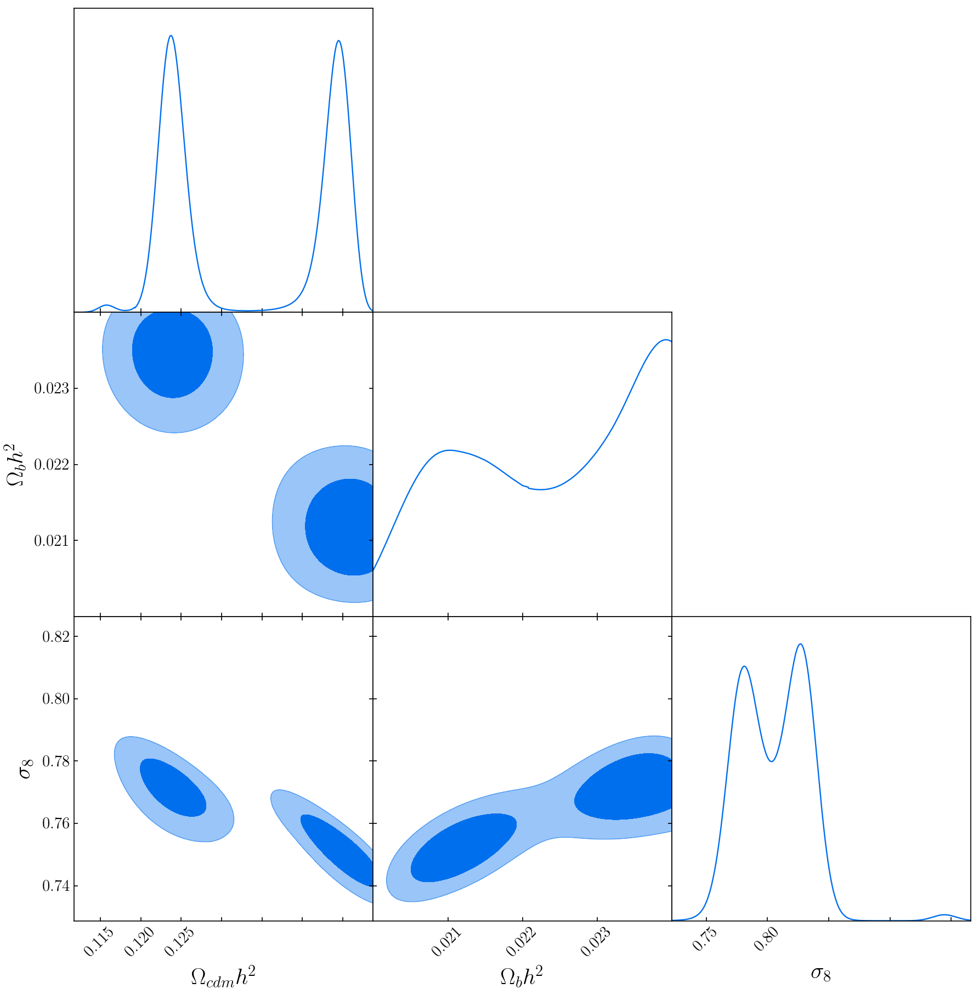

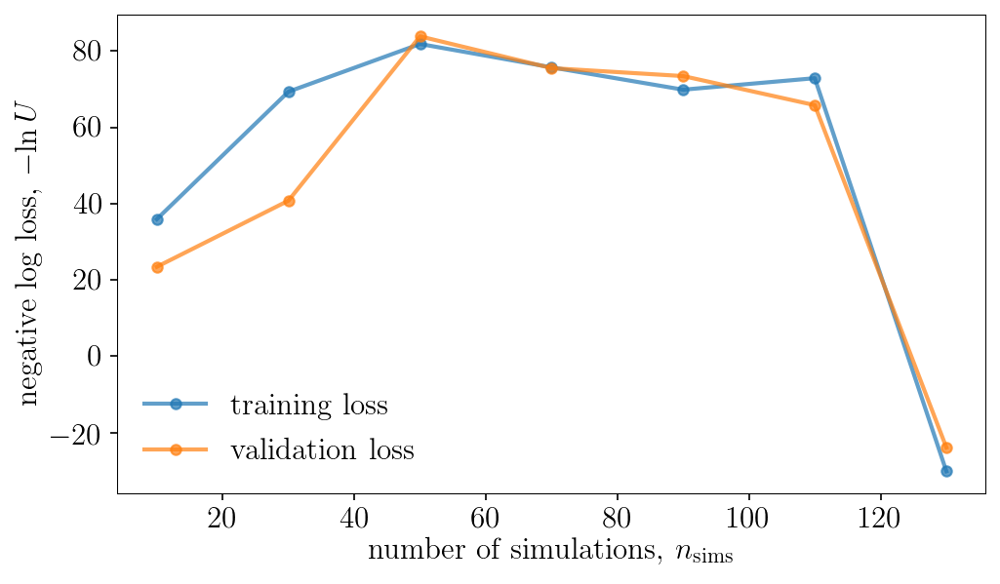

Population 7/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...
Done.
Removed no burn in


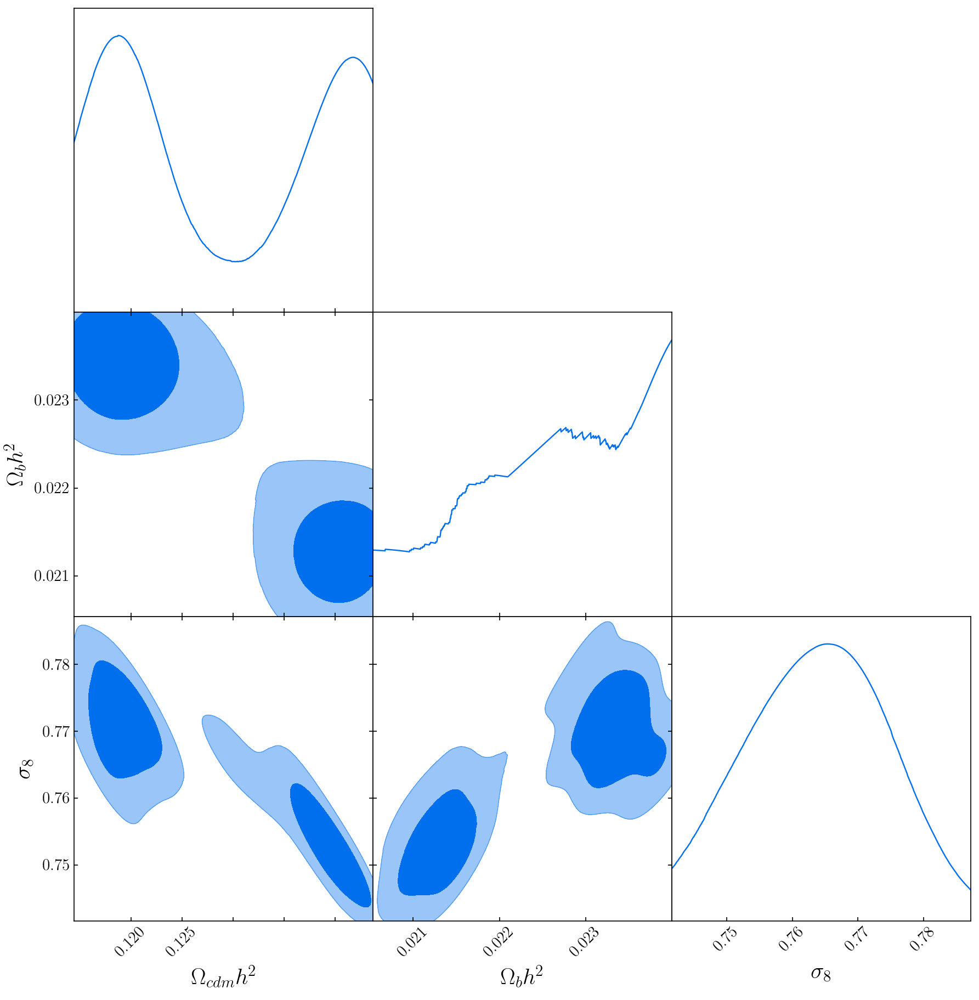

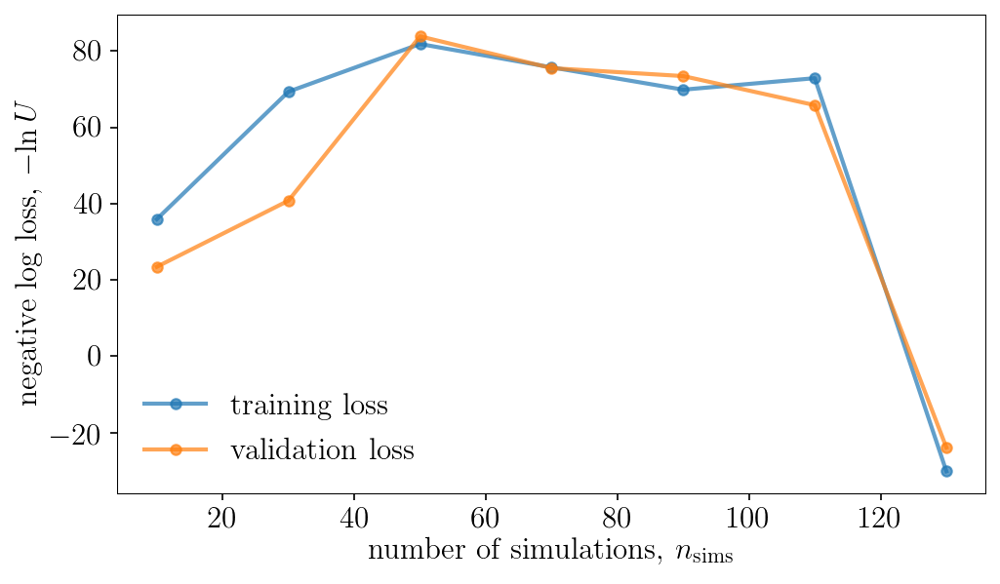

Population 8/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...
Done.
Removed no burn in


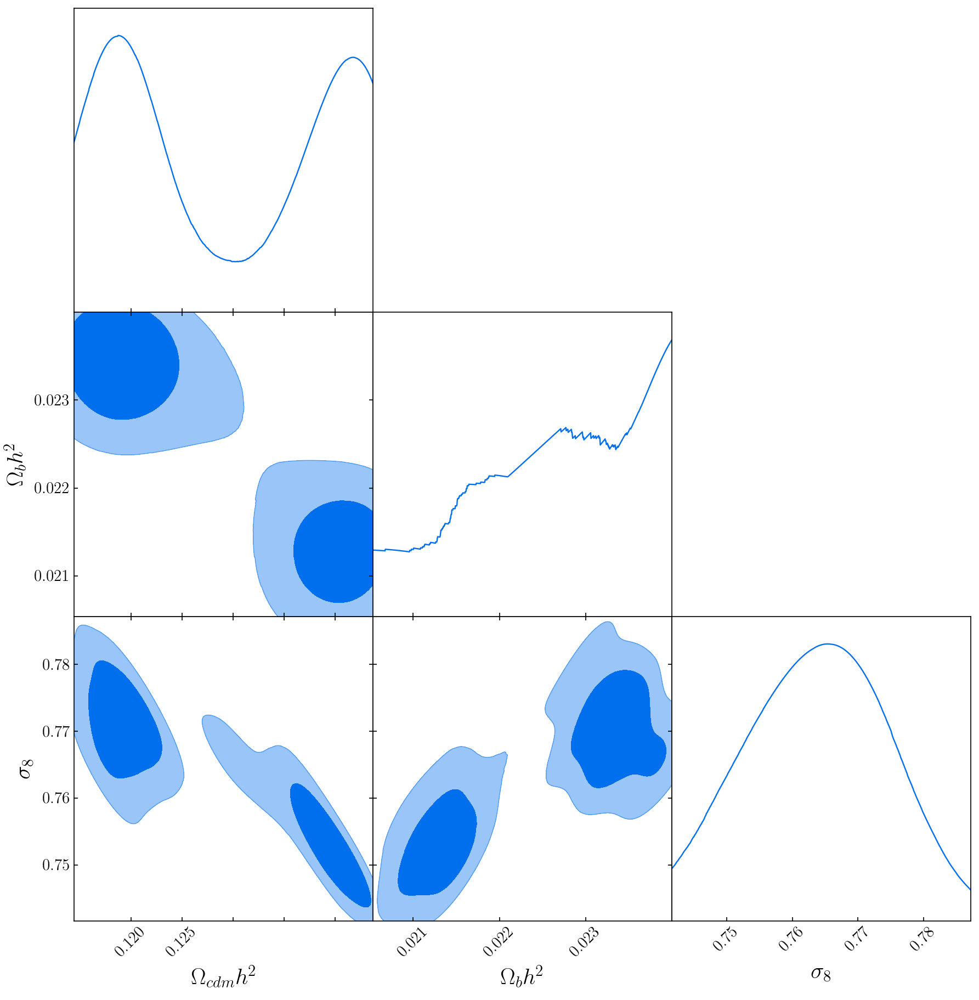

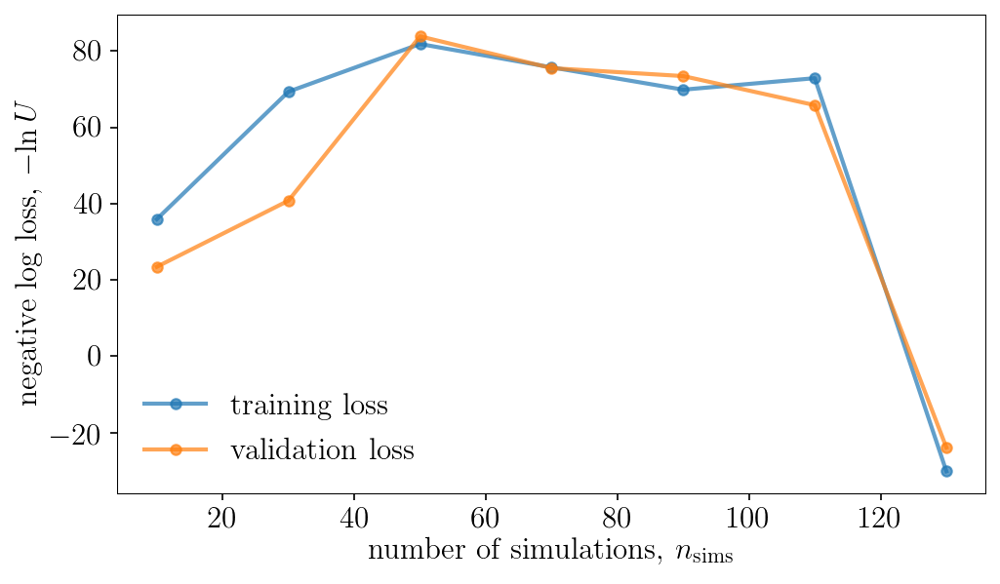

Population 9/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...
Done.
Removed no burn in


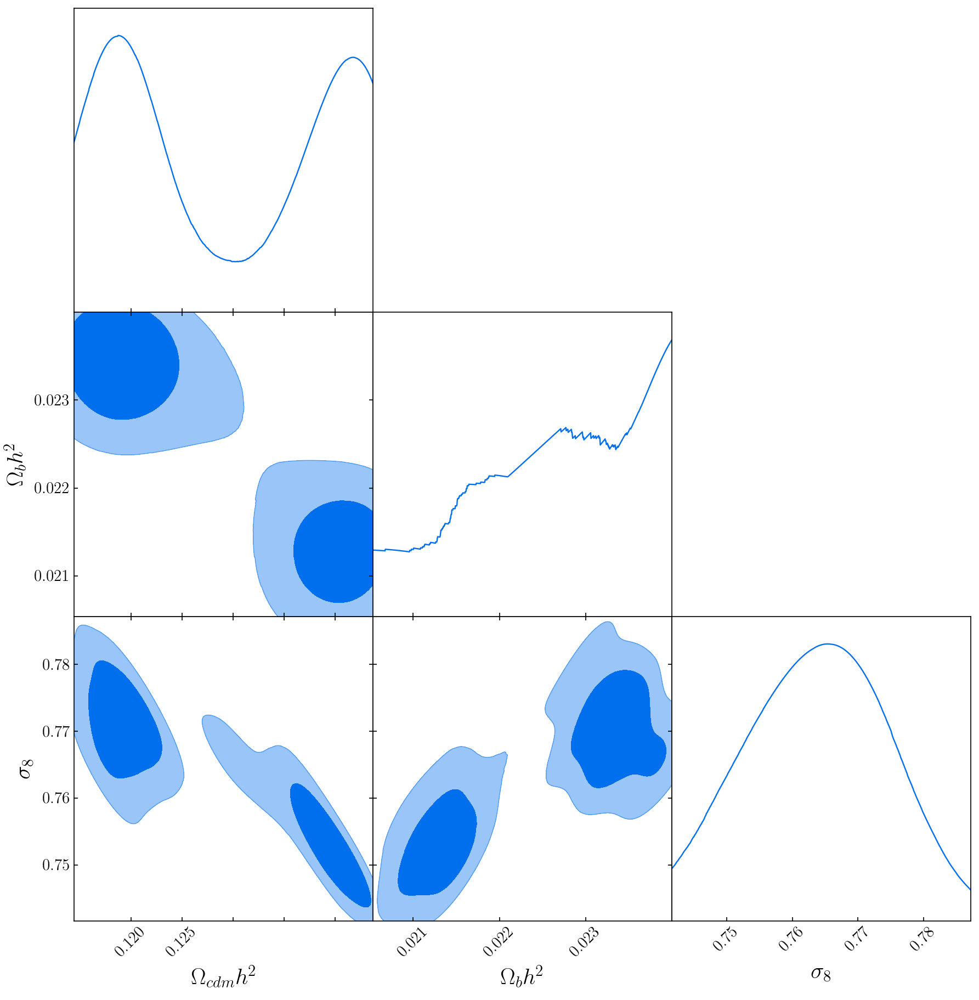

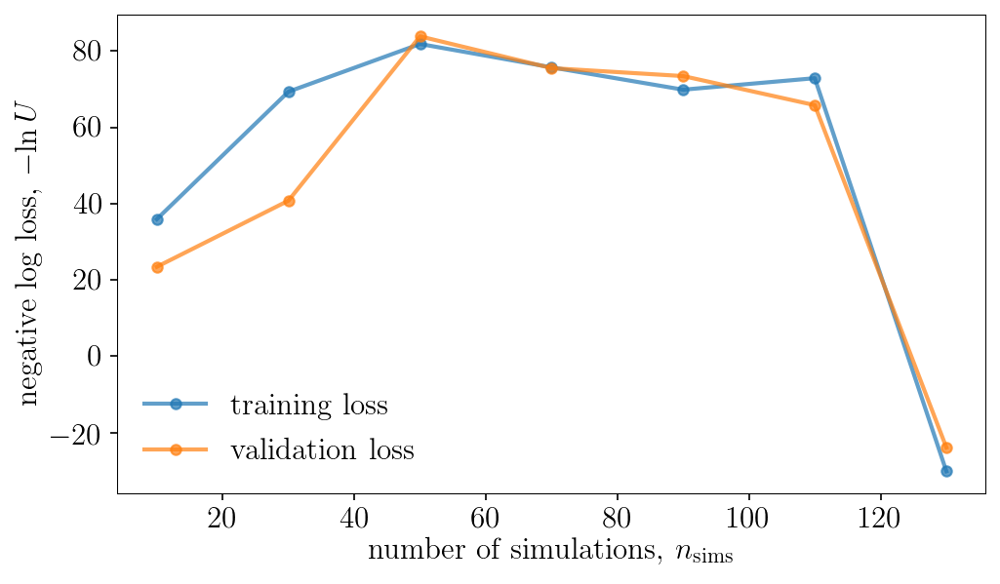

Population 10/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...
Done.
Removed no burn in


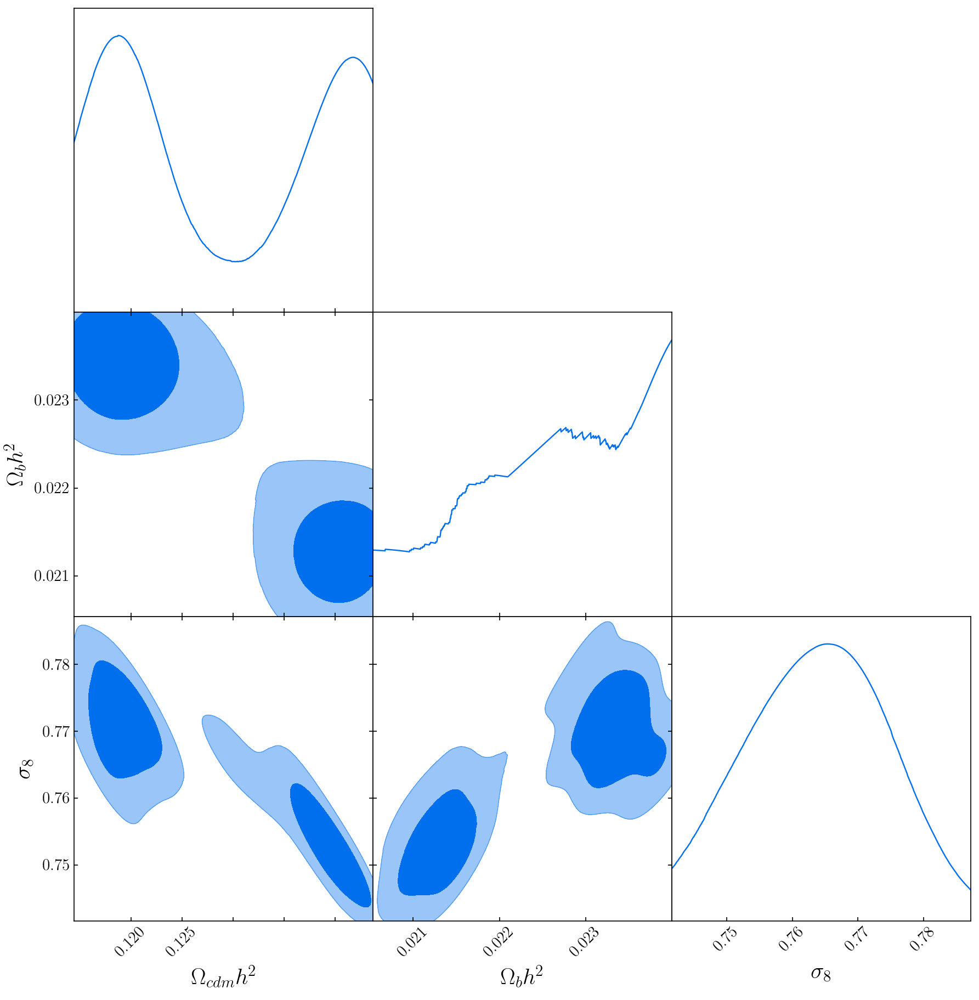

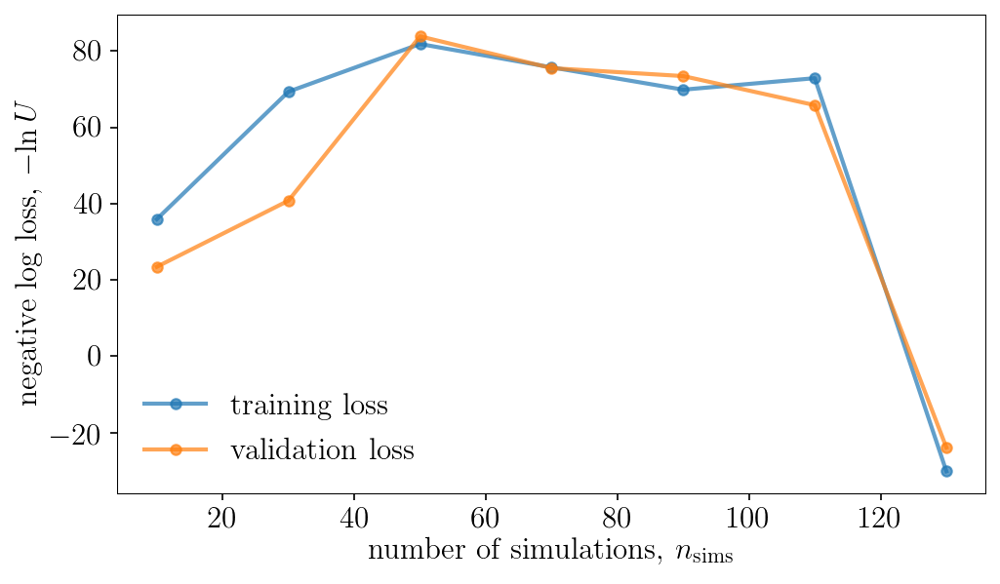

Population 11/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...
Done.
Removed no burn in


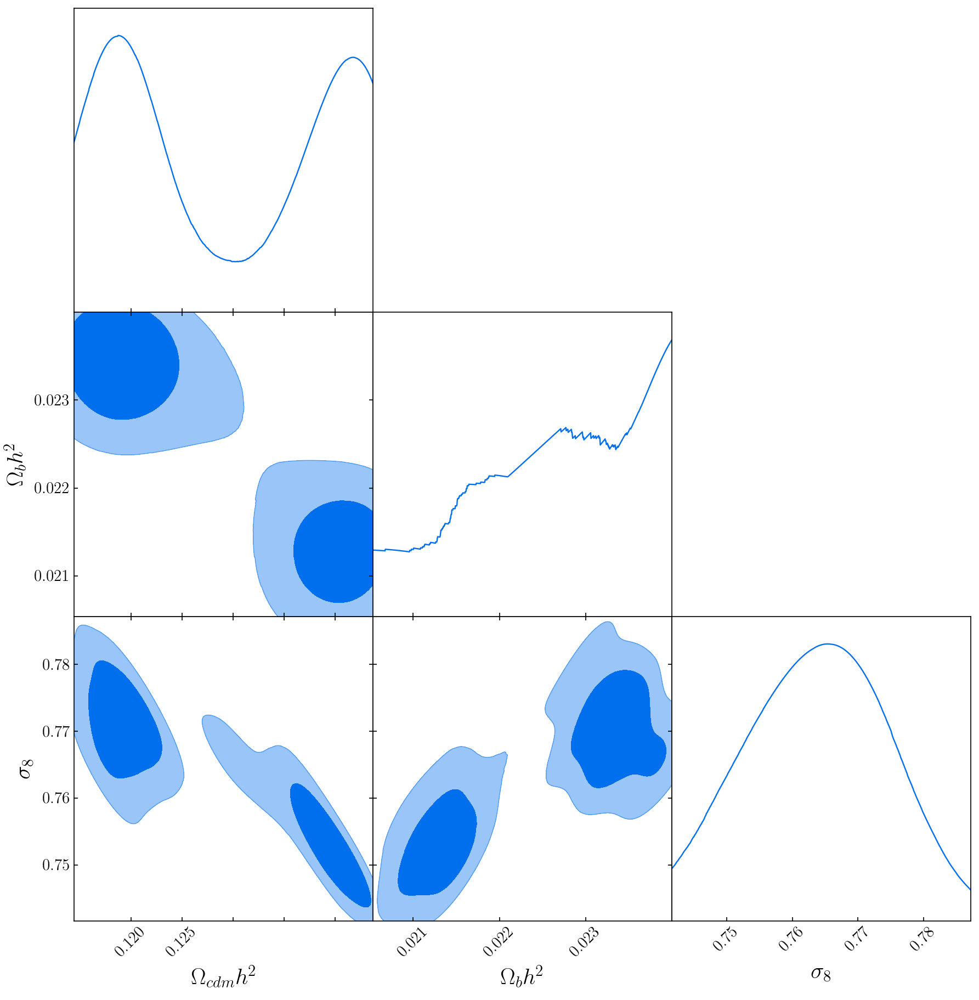

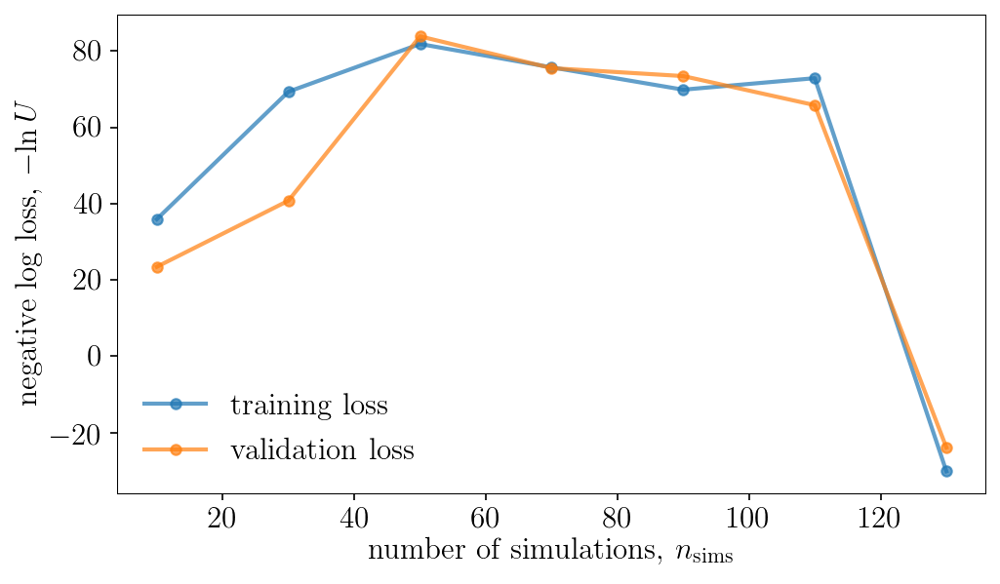

Population 12/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...
Done.
Removed no burn in


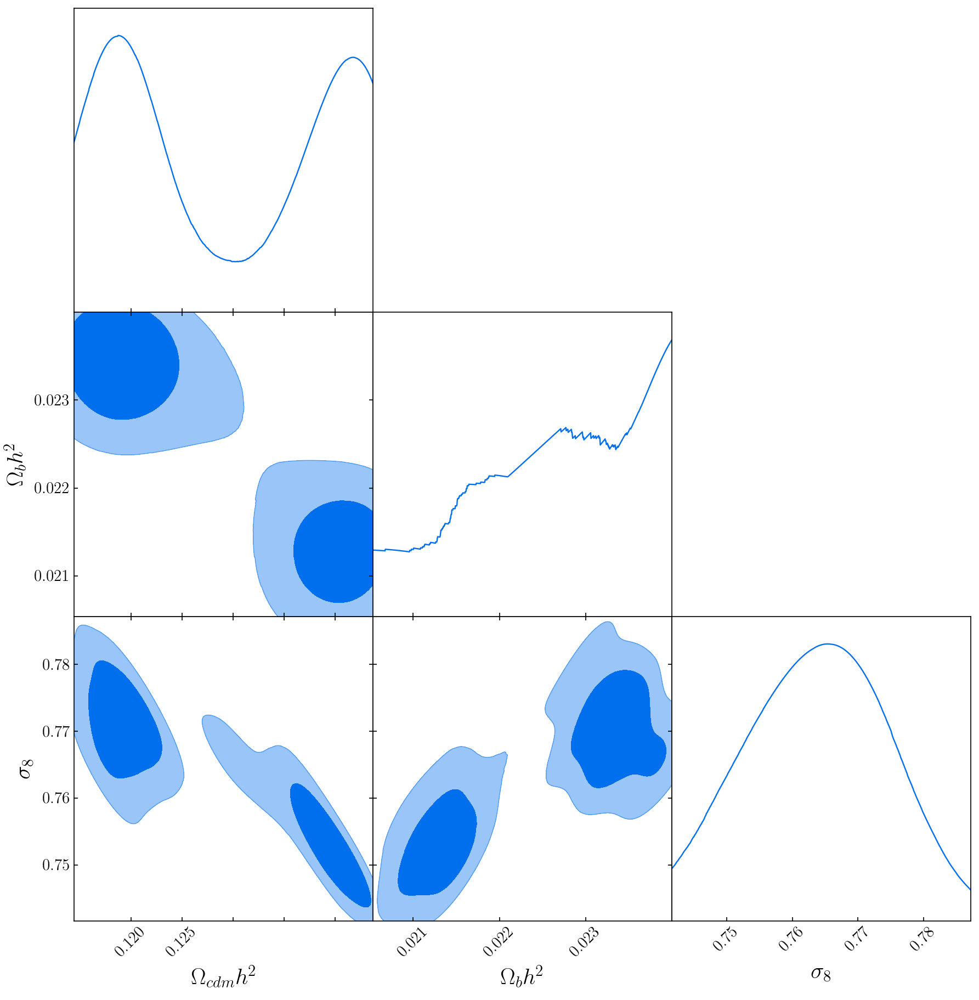

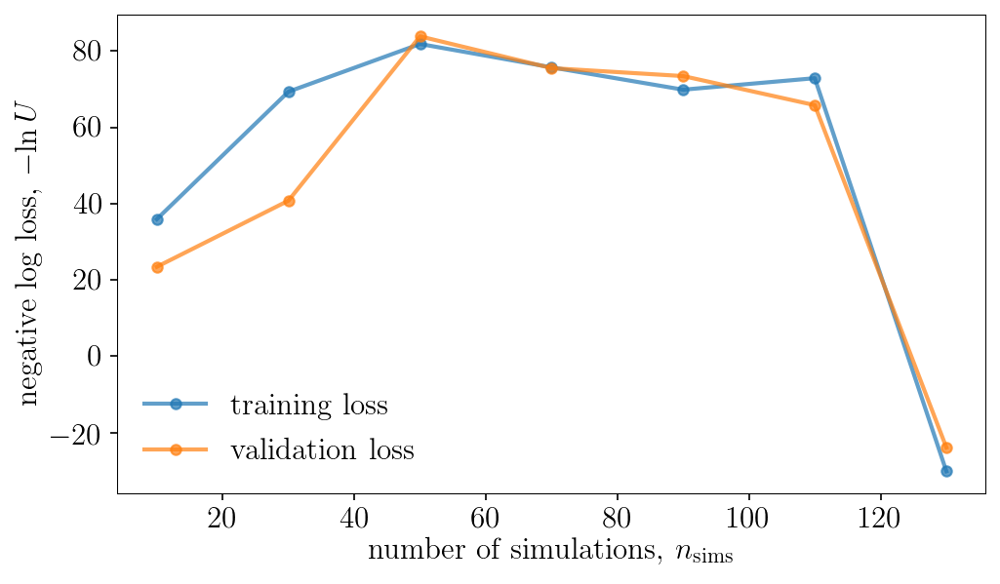

Population 13/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...
Done.
Removed no burn in


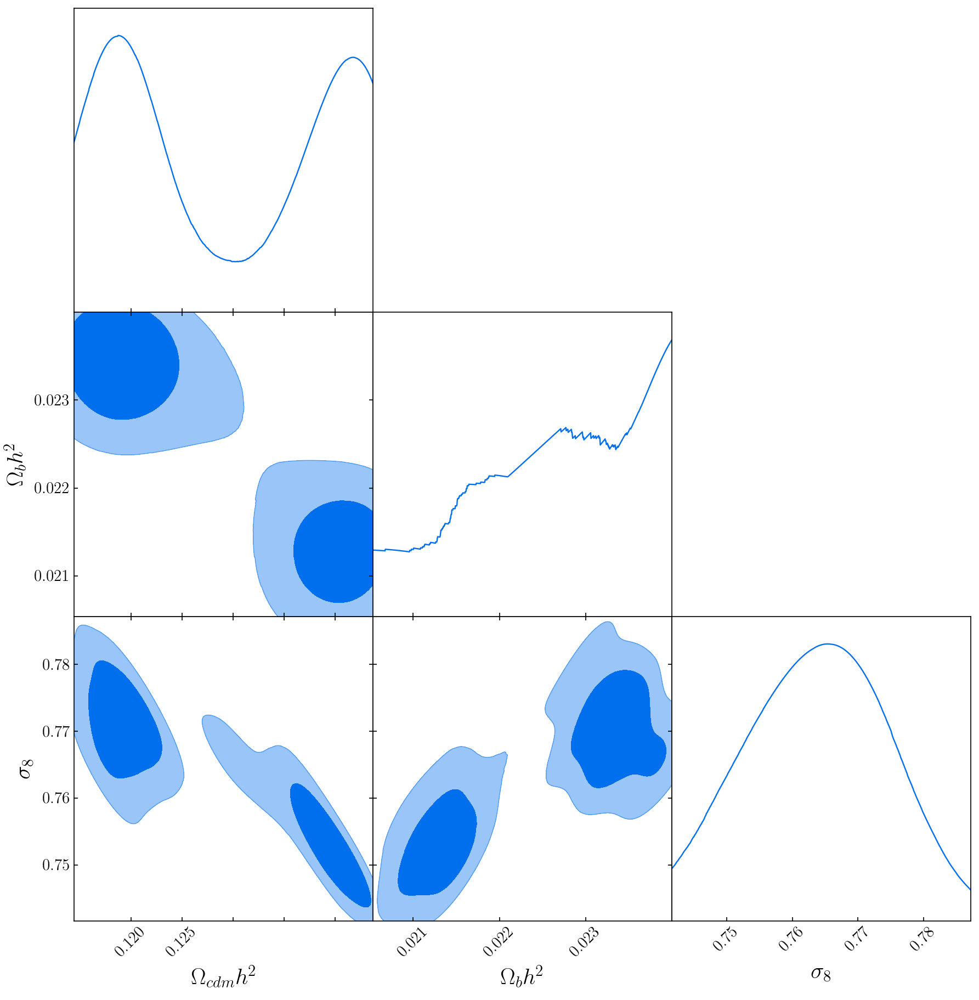

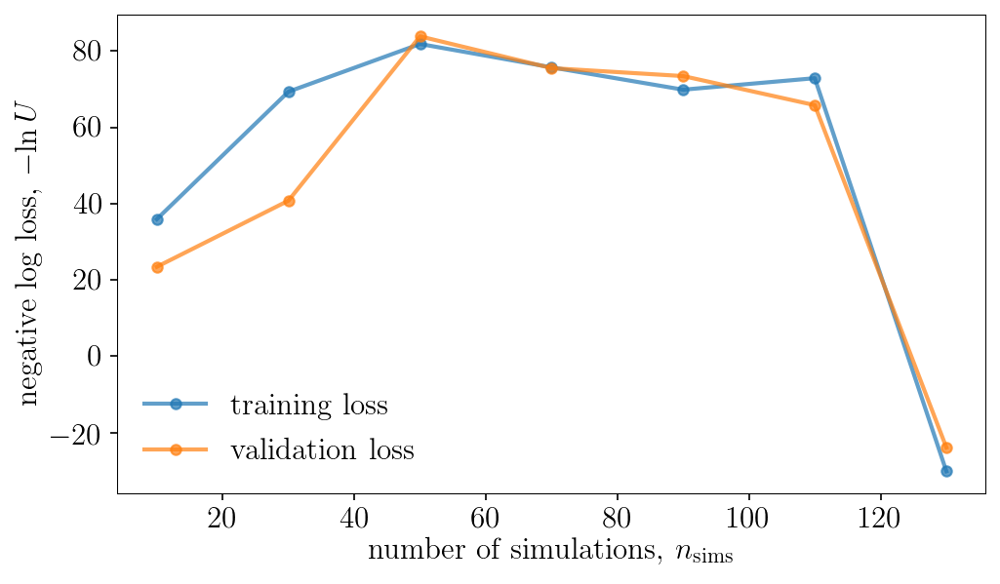

Population 14/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...
Done.
Removed no burn in


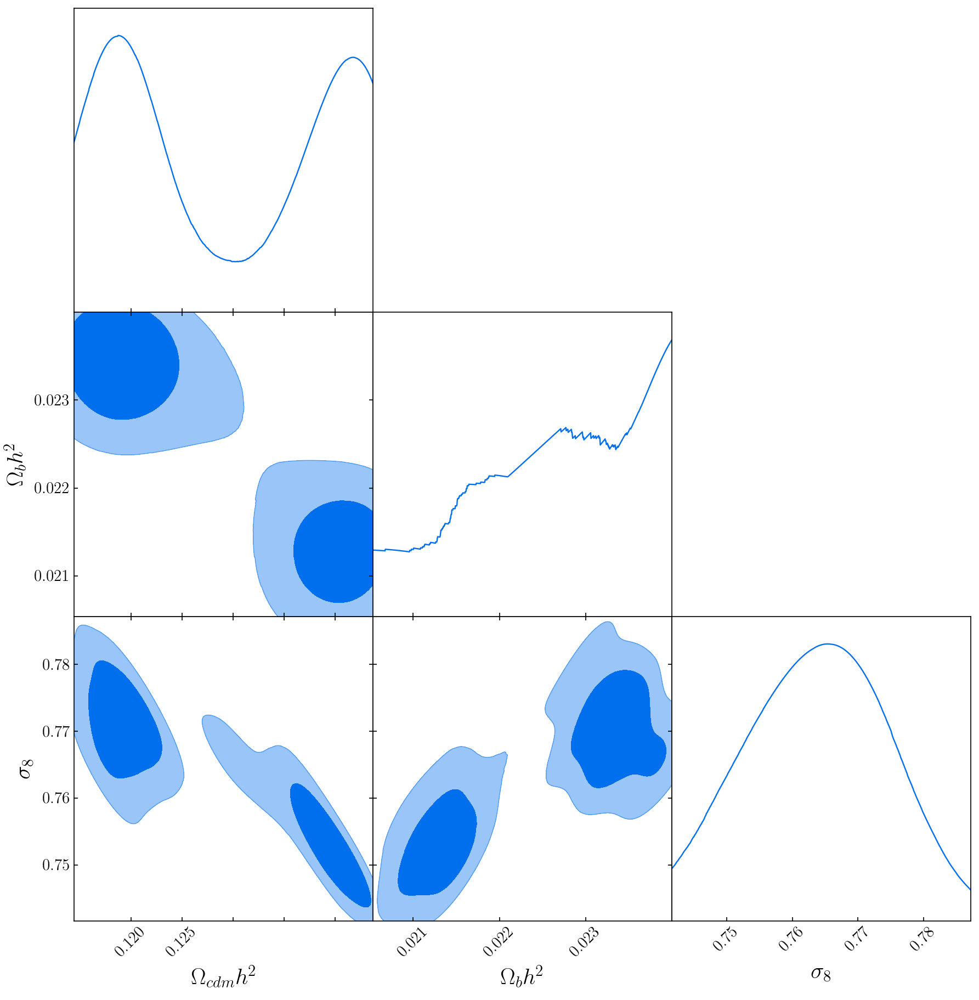

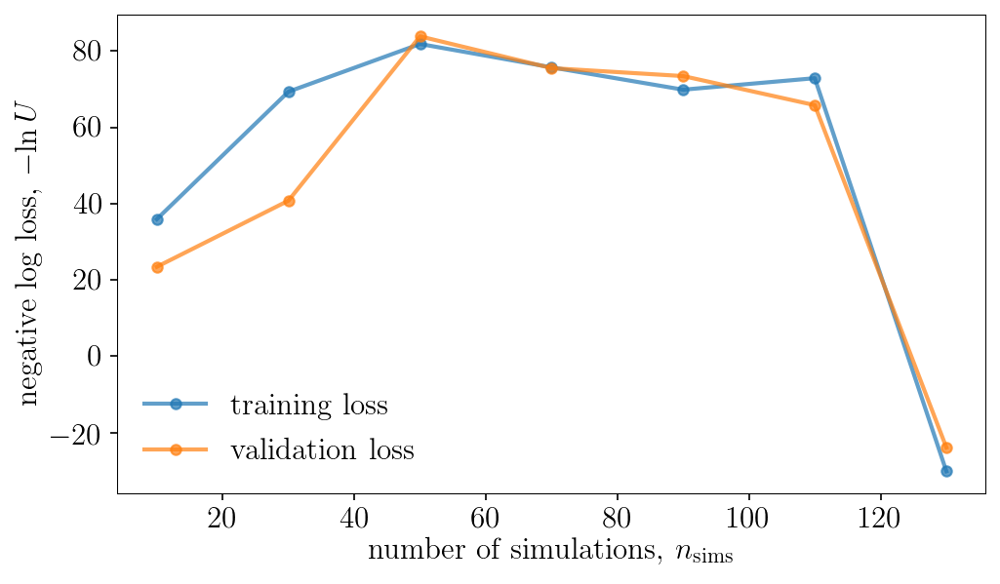

Population 15/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...
Done.
Removed no burn in


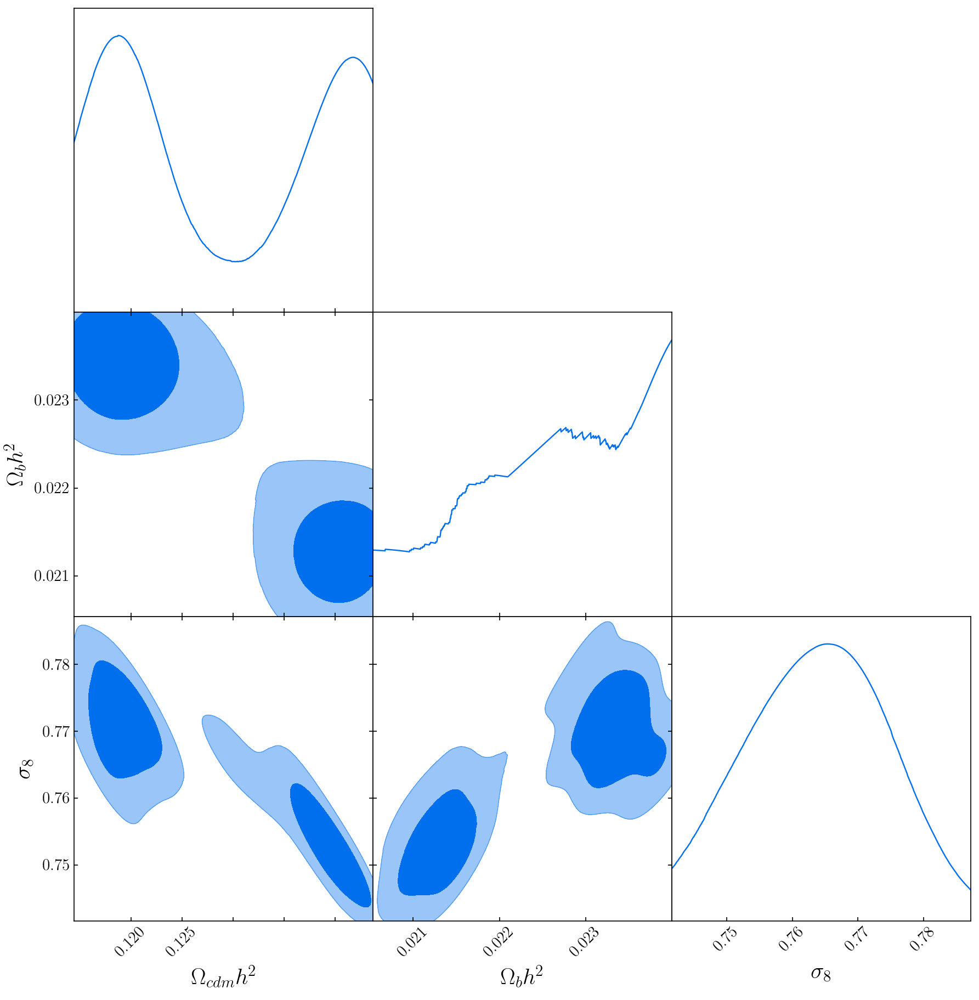

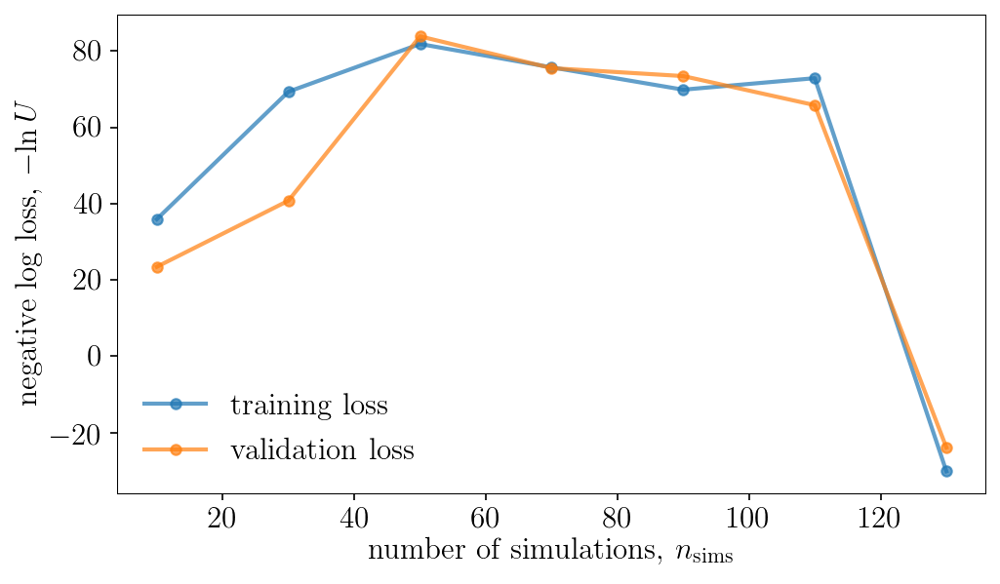

Population 16/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...
Done.
Removed no burn in


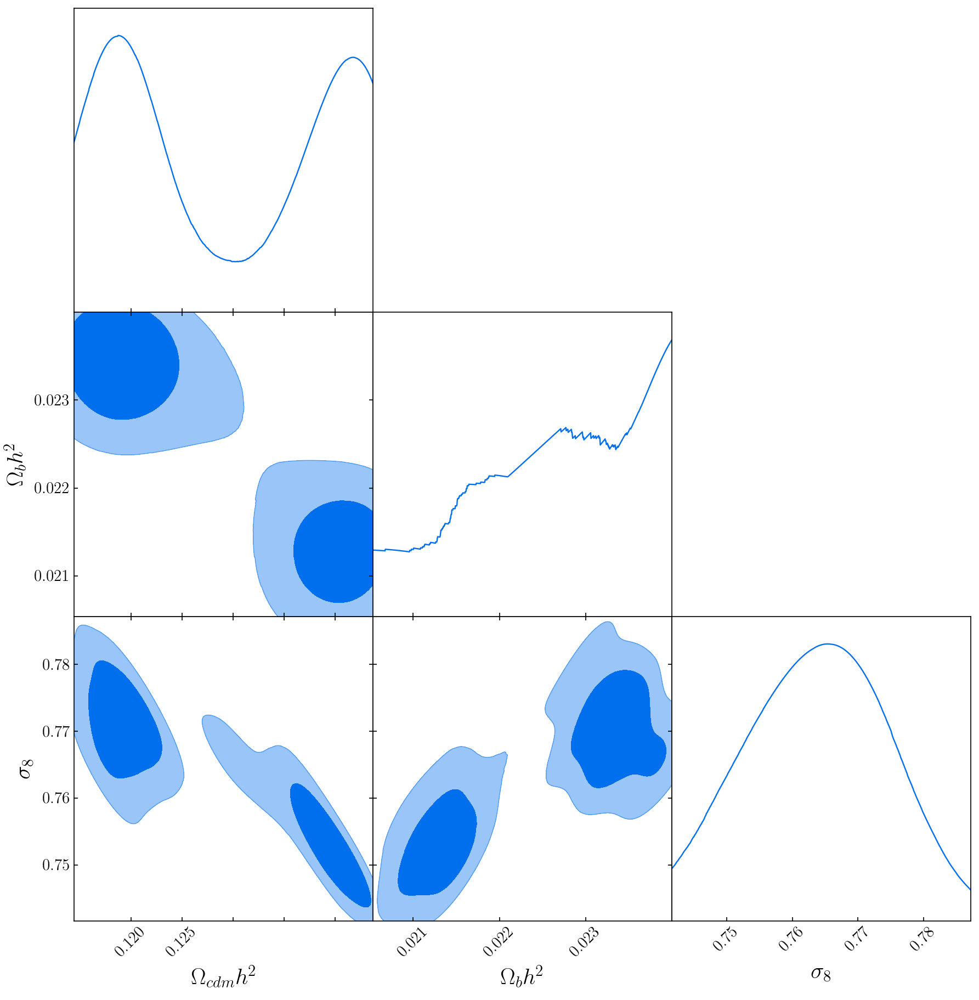

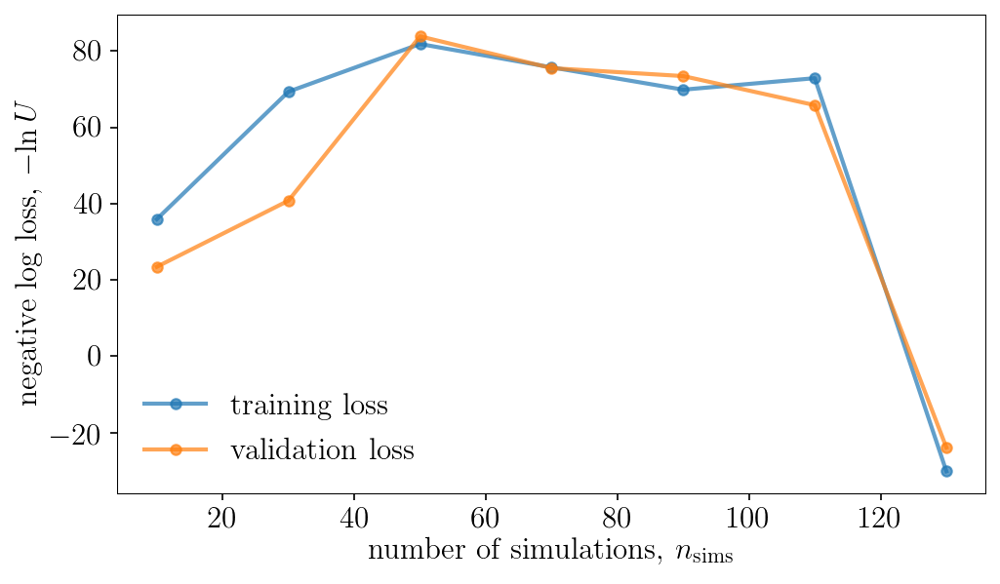

Population 17/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...
Done.
Removed no burn in


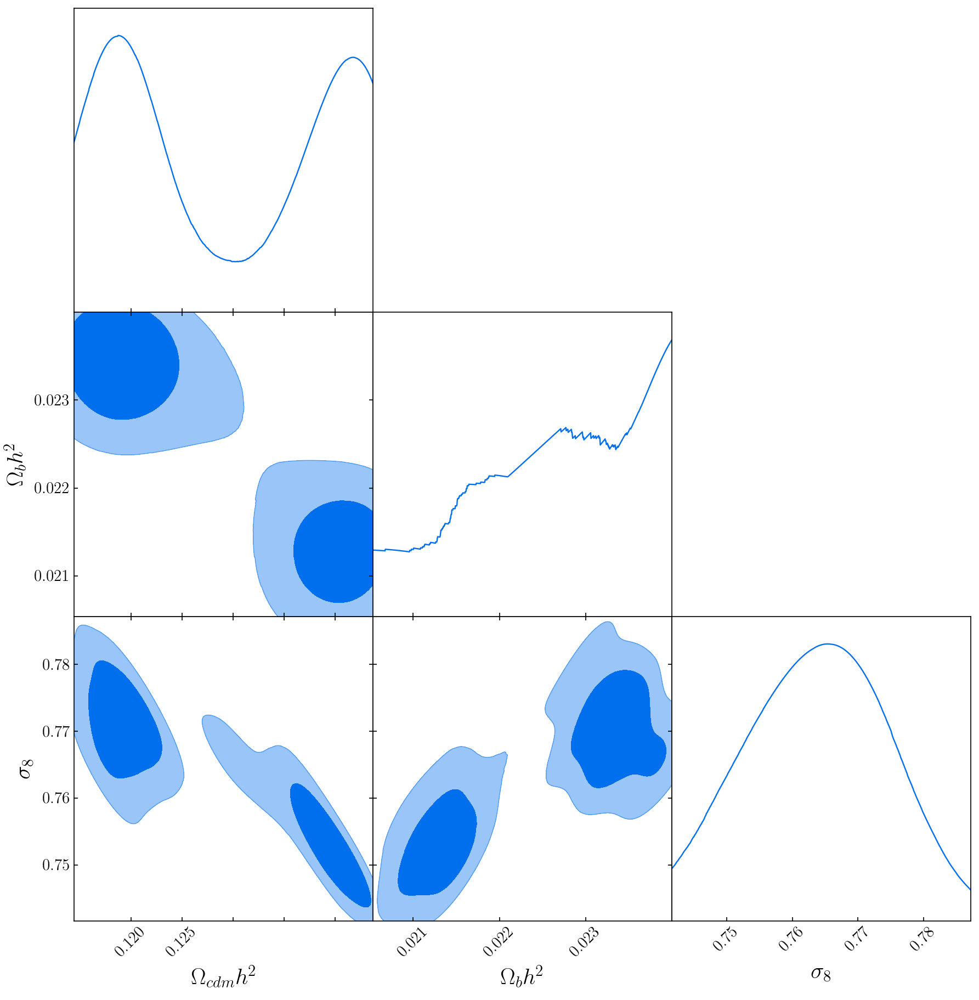

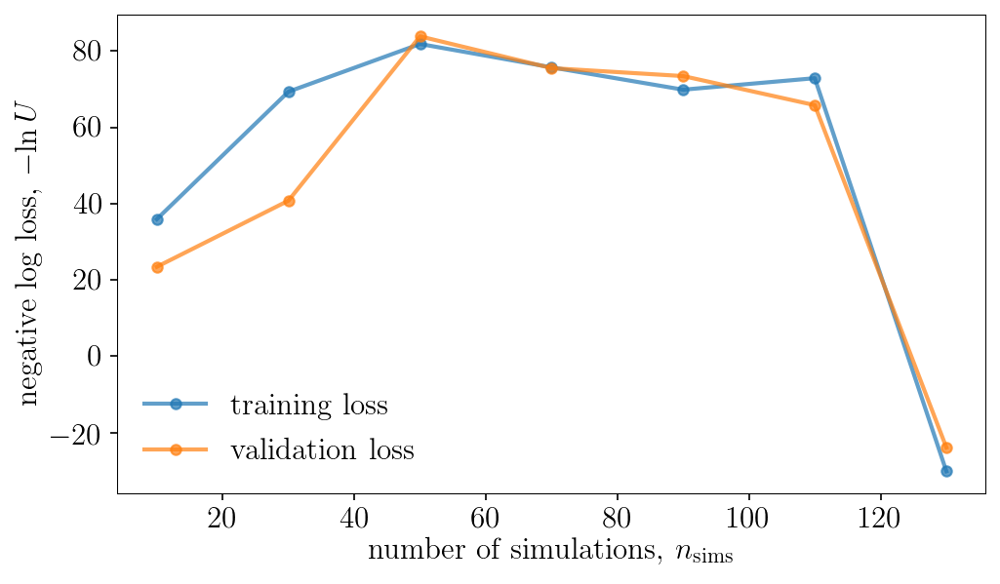

Population 18/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...
Done.
Removed no burn in


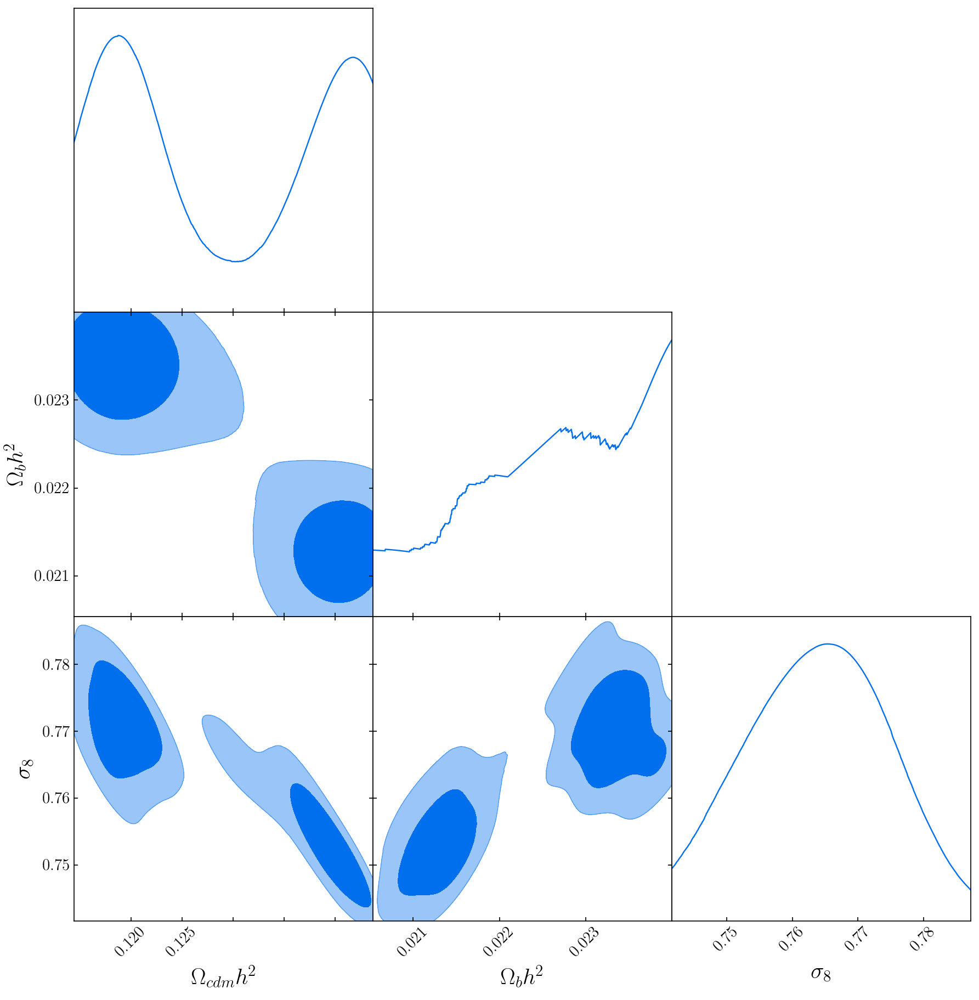

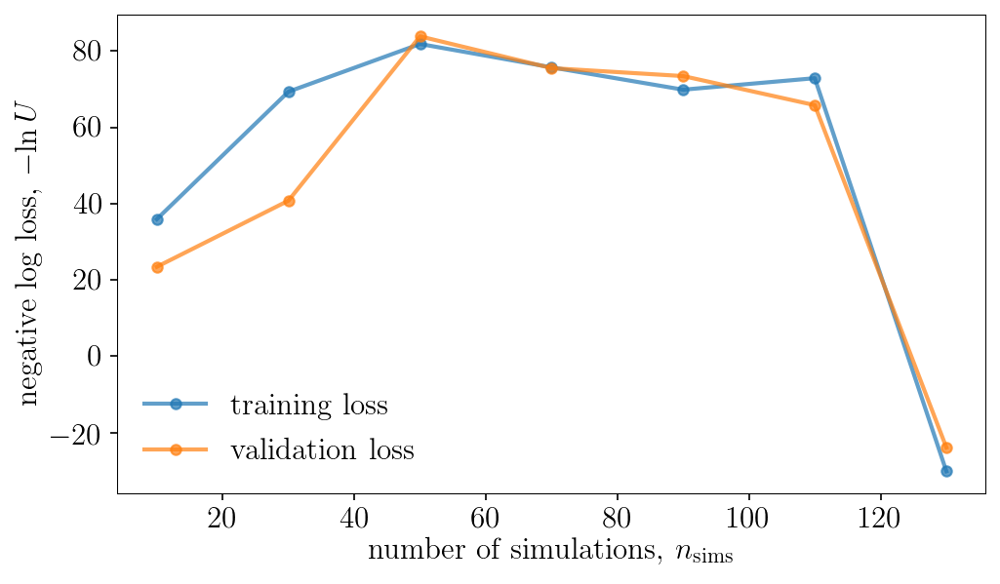

Population 19/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...
Done.
Removed no burn in


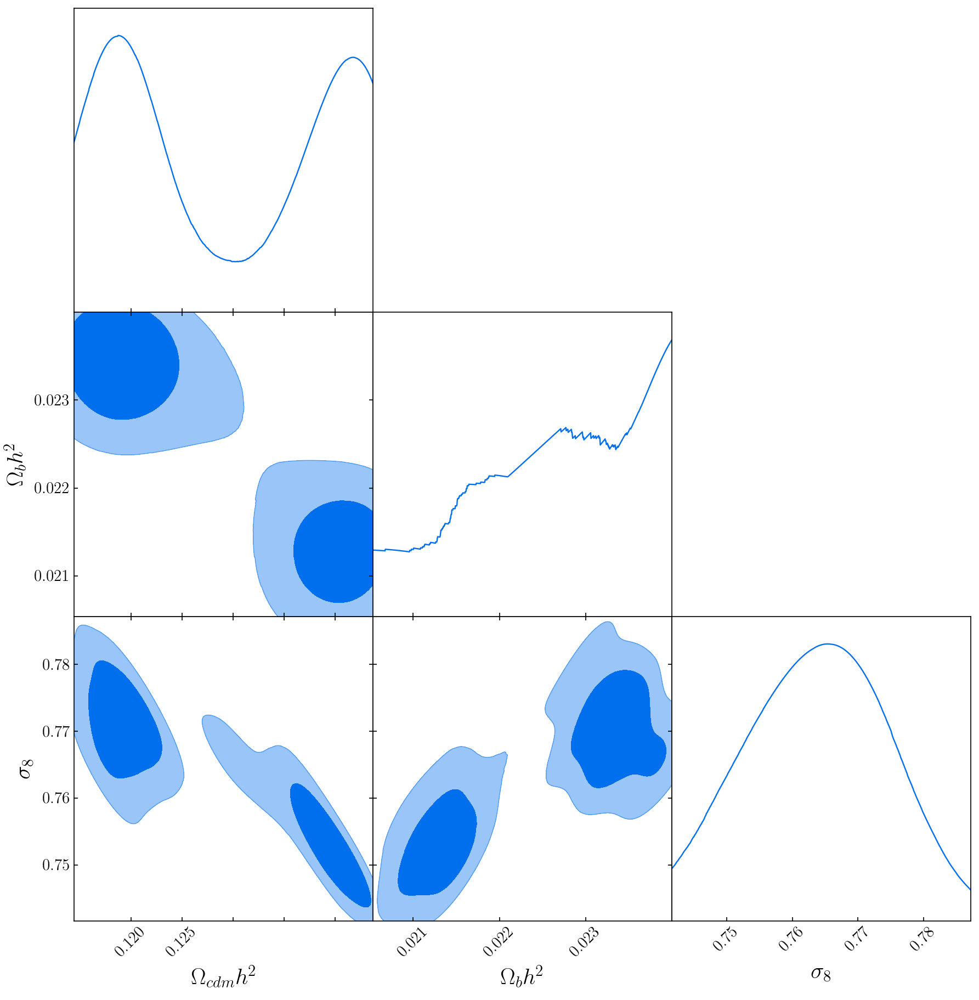

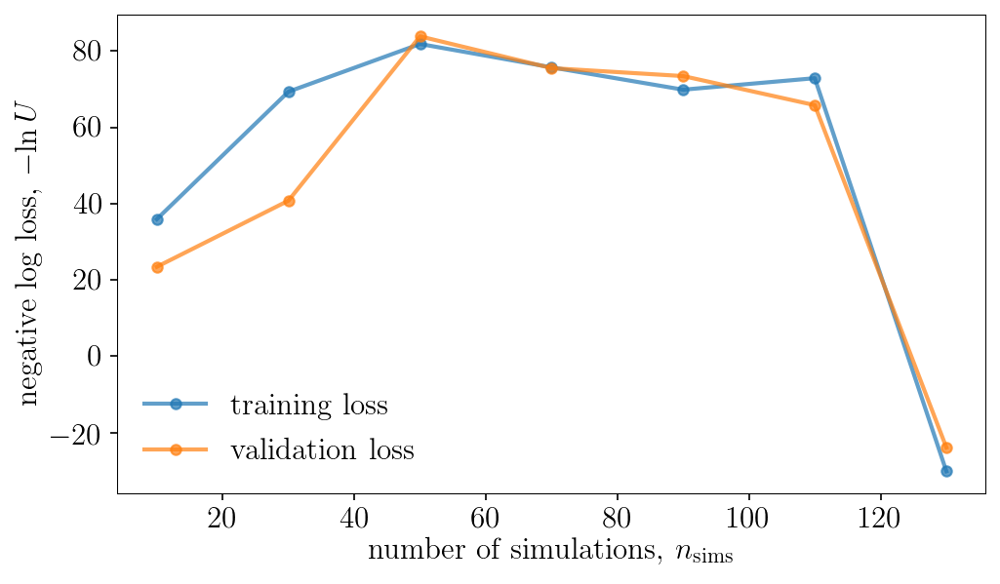

Population 20/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...
Done.
Removed no burn in


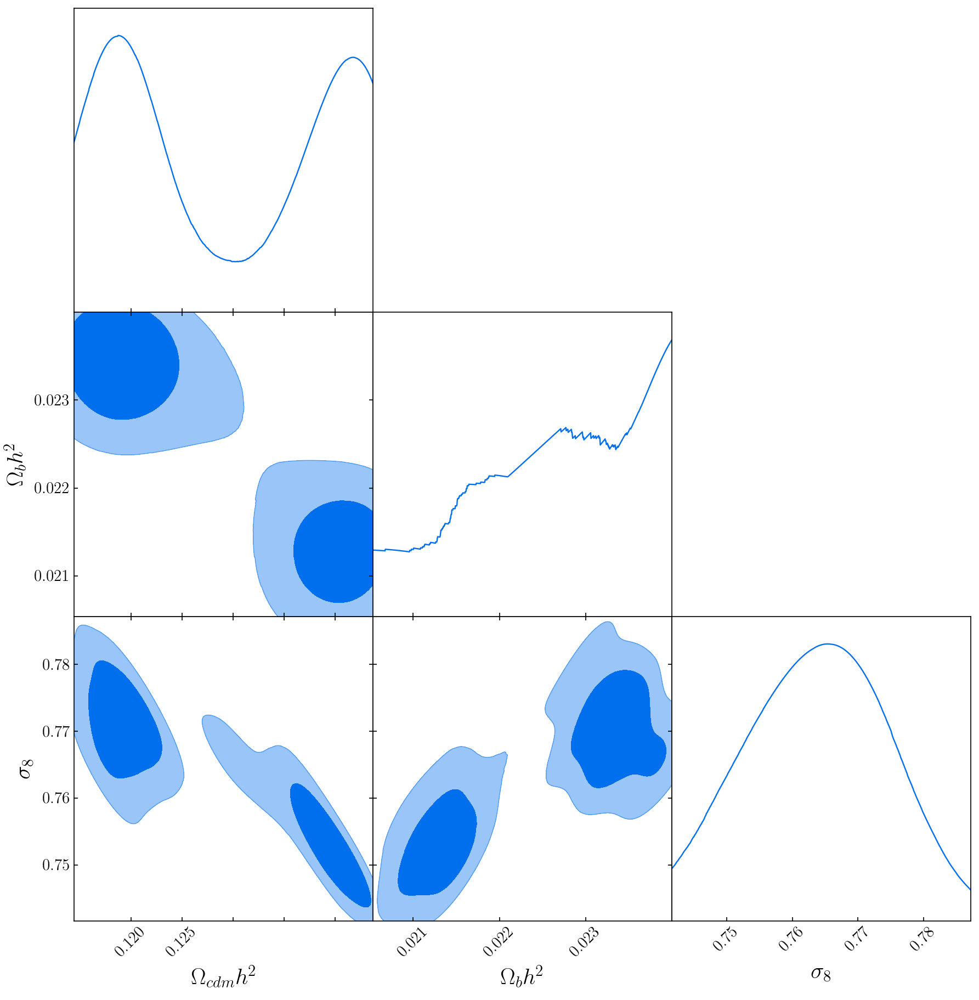

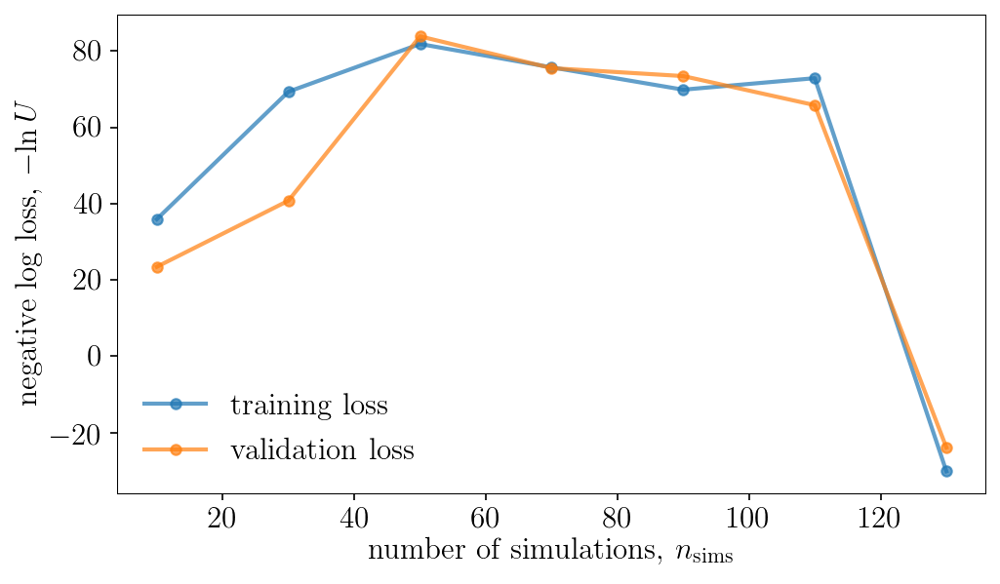

In [19]:
DelfiEnsemble.sequential_training(simulator, compressor, n_initial, n_batch, n_populations, patience=20, 
                                  save_intermediate_posteriors=True)

In [20]:
x0 = DelfiEnsemble.posterior_samples[np.random.choice(np.arange(len(DelfiEnsemble.posterior_samples)), p=DelfiEnsemble.posterior_weights.astype(np.float32)/sum(DelfiEnsemble.posterior_weights), replace=False, size=DelfiEnsemble.nwalkers),:]
posterior_samples, posterior_weights, log_prob = DelfiEnsemble.emcee_sample(x0=x0)


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Removed no burn in


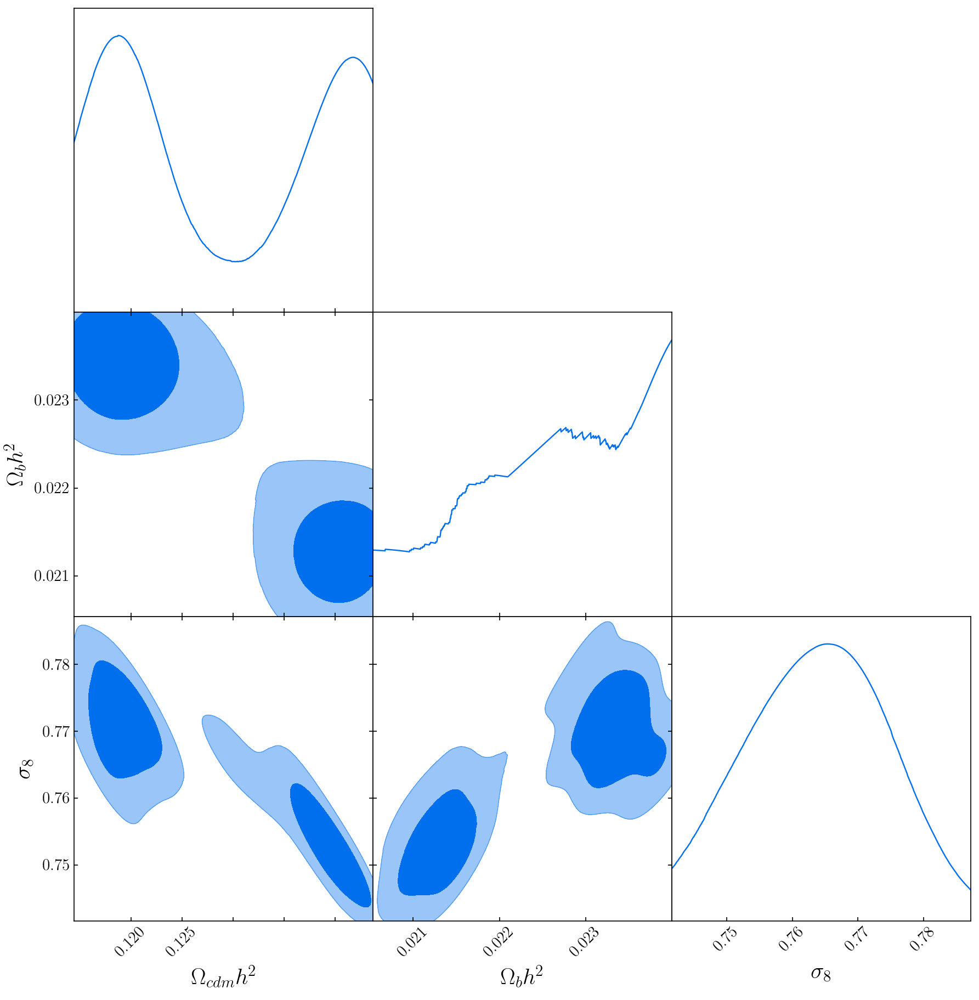

<Figure size 900x600 with 0 Axes>

In [21]:
DelfiEnsemble.triangle_plot(samples=[posterior_samples], weights=[posterior_weights])
plt.savefig('posteriors_3params_20populations.png')

In [22]:
posterior_samples

array([[0.1166769 , 0.02333023, 0.77690101],
       [0.11667737, 0.02302603, 0.78146159],
       [0.11670499, 0.02375674, 0.76770074],
       [0.11672136, 0.02334902, 0.76624376],
       [0.11672718, 0.02352773, 0.76424258],
       [0.11681501, 0.02342823, 0.77035791],
       [0.11684509, 0.02298694, 0.77976012],
       [0.11689255, 0.02377858, 0.76923088],
       [0.11695883, 0.0233259 , 0.77260899],
       [0.11696411, 0.02341206, 0.7713084 ],
       [0.11698918, 0.02346046, 0.76865586],
       [0.11706186, 0.02384651, 0.76192477],
       [0.11706491, 0.02341257, 0.77233483],
       [0.11706614, 0.02331125, 0.76675694],
       [0.11708958, 0.023342  , 0.76642885],
       [0.11713053, 0.02373388, 0.76103387],
       [0.11716344, 0.02377216, 0.76398106],
       [0.11716471, 0.02322213, 0.76853584],
       [0.1172039 , 0.0233883 , 0.77180102],
       [0.11722128, 0.02324421, 0.77006265],
       [0.11724963, 0.02290577, 0.77776641],
       [0.1172594 , 0.02333544, 0.7704363 ],
       [0.

## Attempt 3

In [28]:
DelfiEnsemble = delfi.Delfi(N_counts_data.reshape(20), prior, NDEs1, 
                            theta_fiducial = theta_fiducial, 
                            param_limits = [lower, upper],
                            param_names = ['\\Omega_{cdm}h^{2}', '\\Omega_{b}h^{2}', '\\sigma_{8}'],
                            results_dir = "simulators/mass_function_n_counts/results_3/")

In [29]:
n_initial = 100 #200
n_batch = 100 #200
n_populations = 20 #20

Sampling approximate posterior...
Done.
Removed no burn in


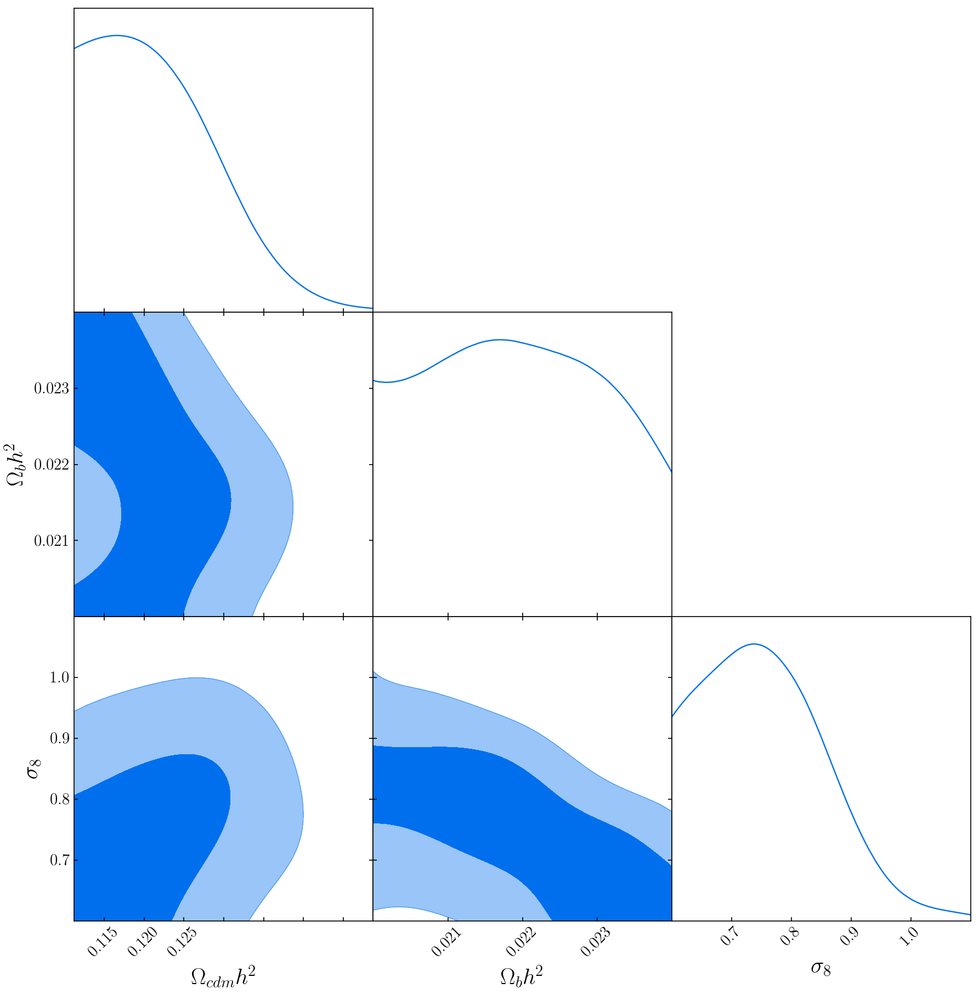

Population 1/20
Sampling proposal density...
Done.


Sampling approximate posterior...


/home/aizhana/.conda/envs/fast-mpi4py/lib/python3.7/site-packages/pydelfi/delfi.py:222: RuntimeWarning: divide by zero encountered in log
  lnL = np.log(L)


Done.
Removed no burn in


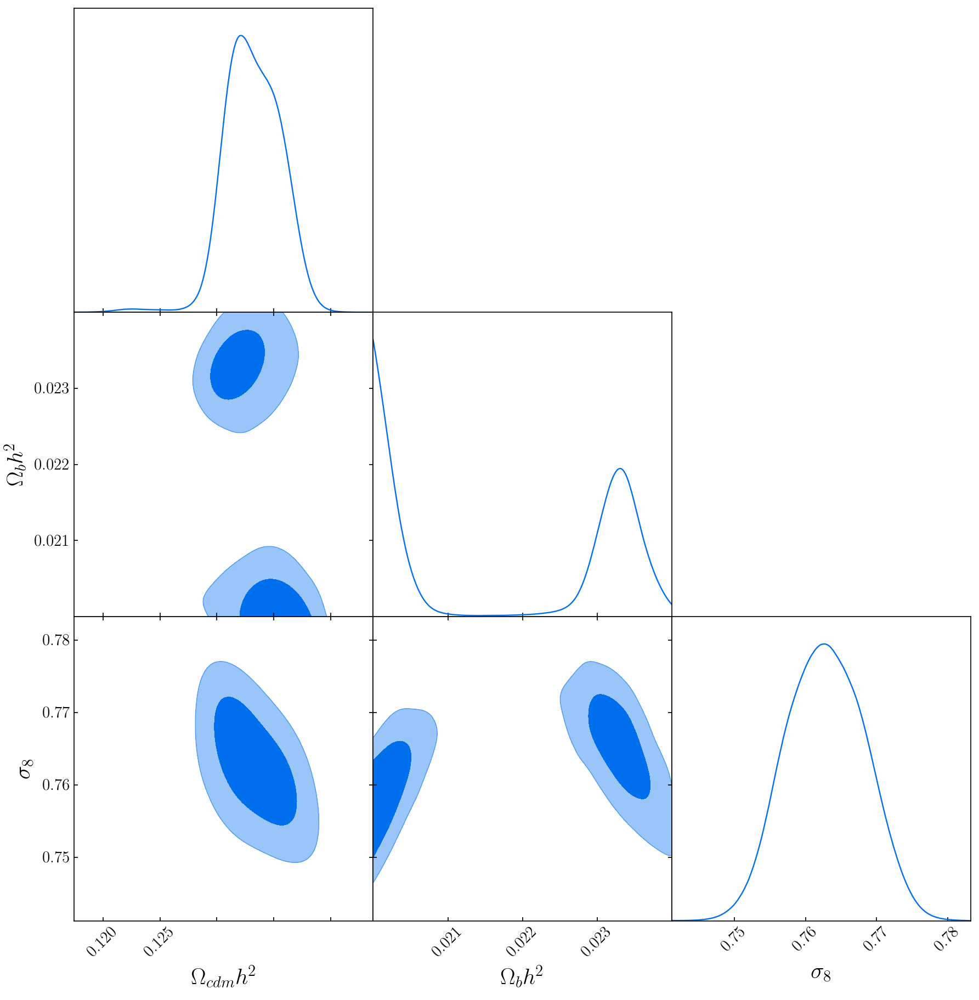

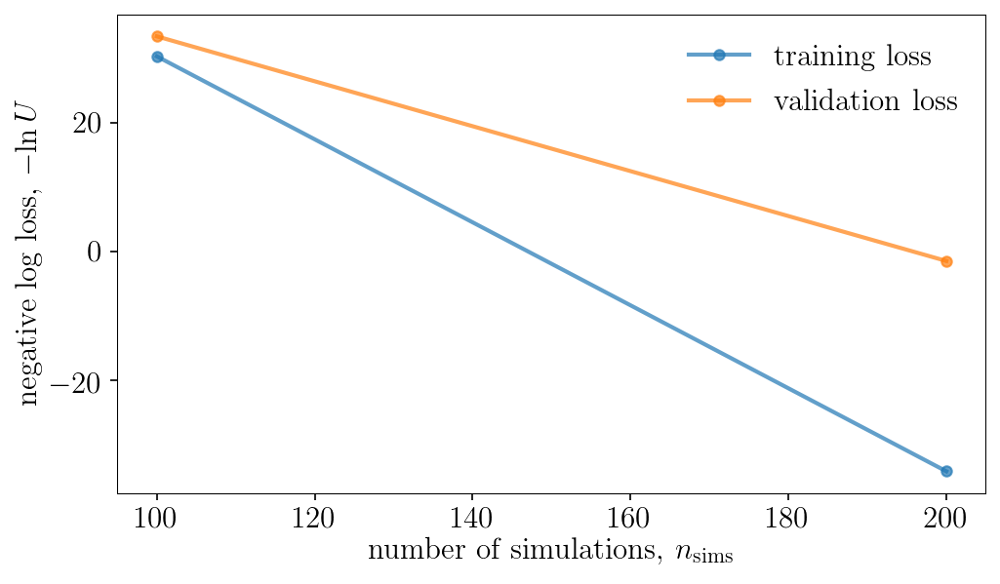

Population 2/20
Sampling proposal density...


/home/aizhana/.conda/envs/fast-mpi4py/lib/python3.7/site-packages/pydelfi/delfi.py:222: RuntimeWarning: divide by zero encountered in log
  lnL = np.log(L)
/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...


Done.
Removed no burn in


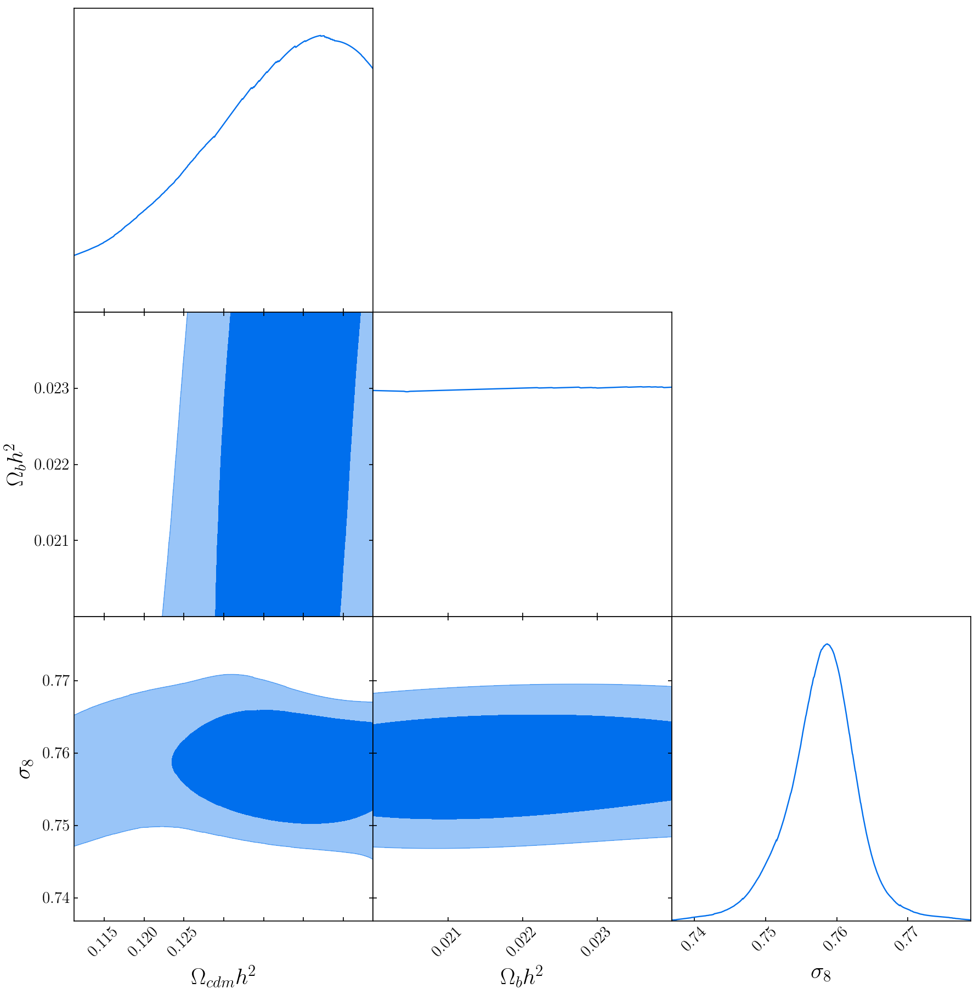

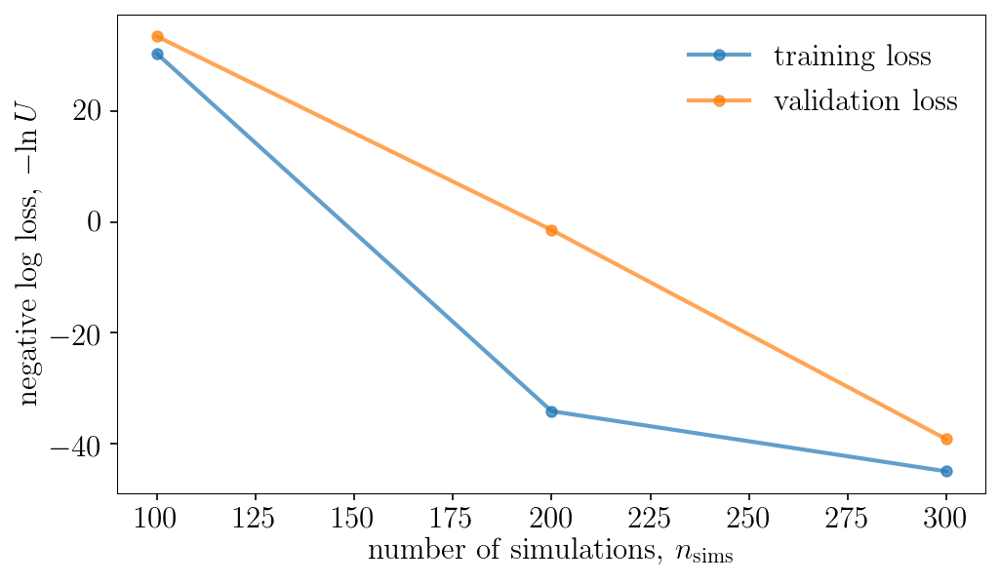

Population 3/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...


Done.
Removed no burn in


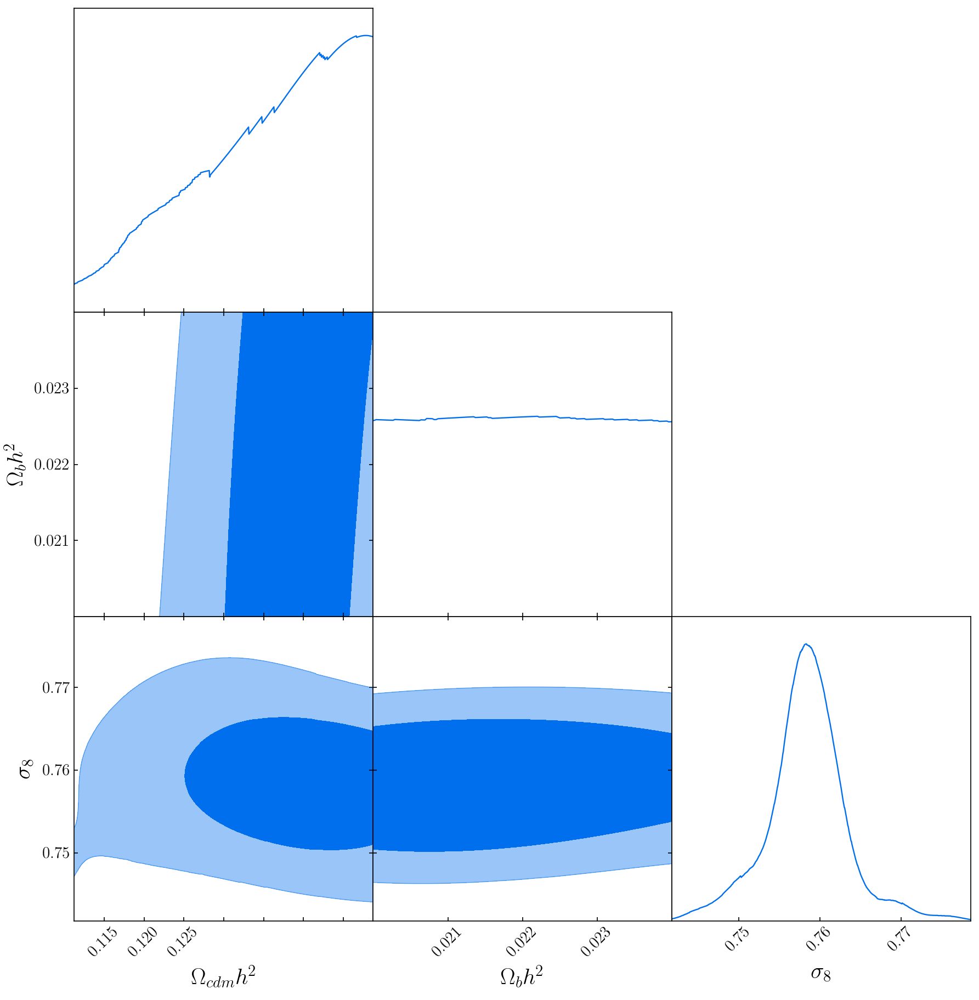

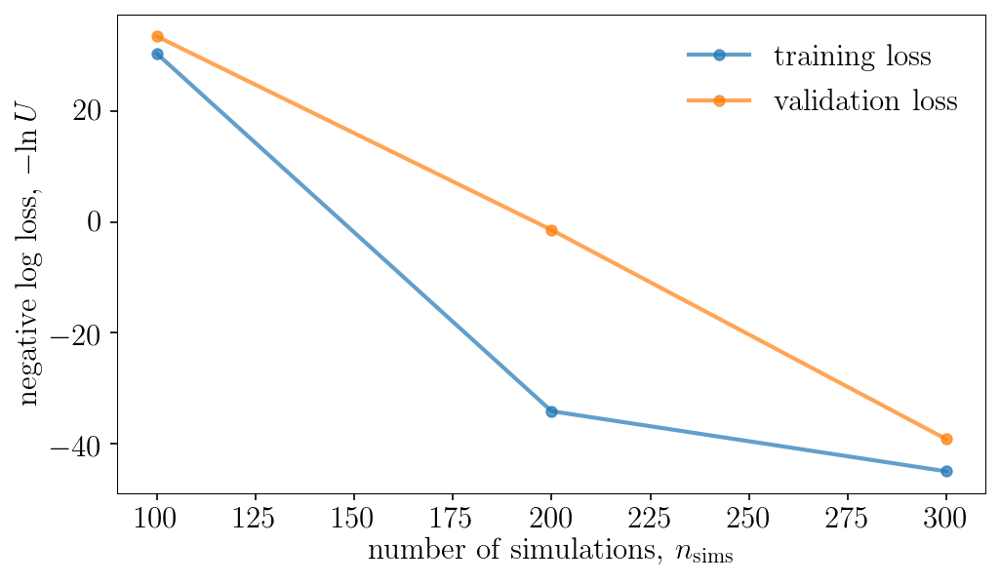

Population 4/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...


Done.
Removed no burn in


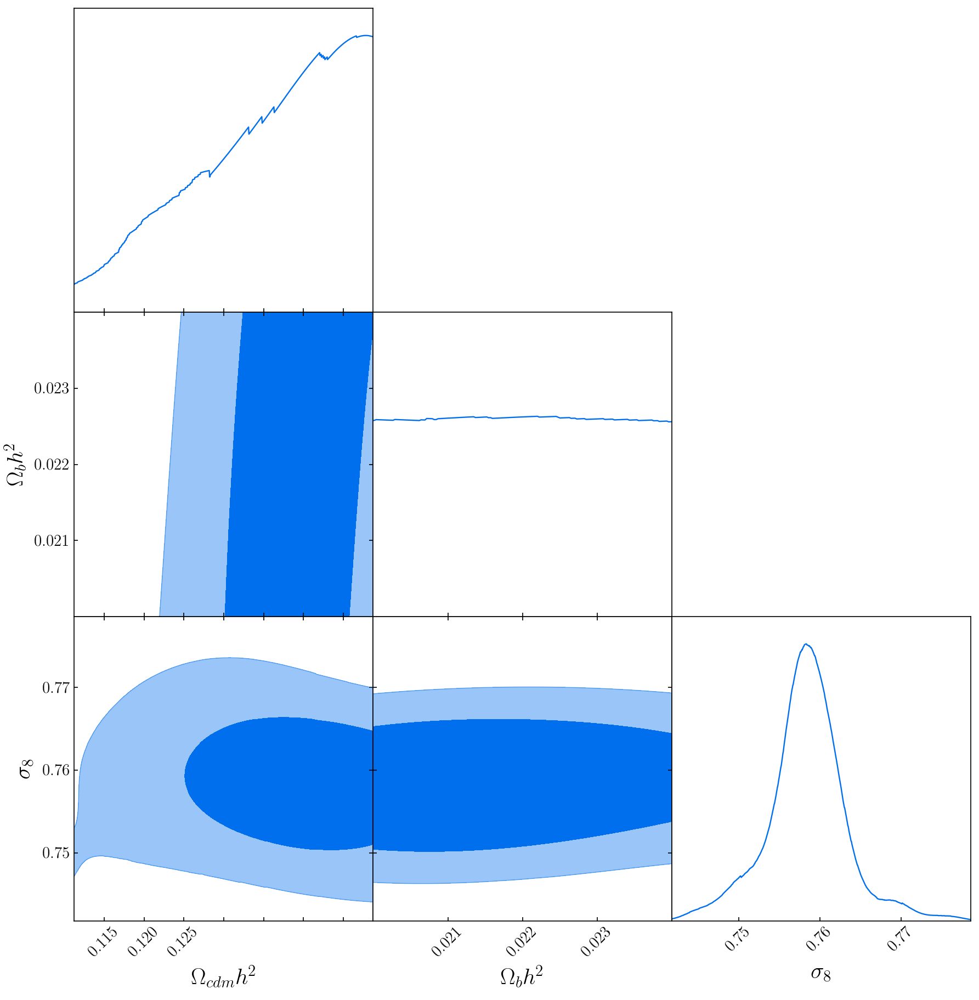

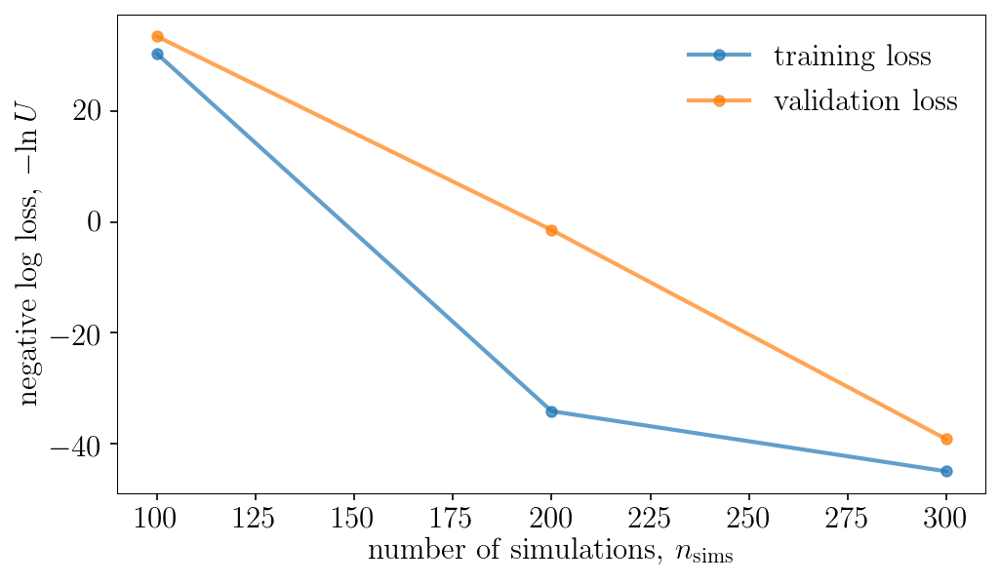

Population 5/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...


Done.
Removed no burn in


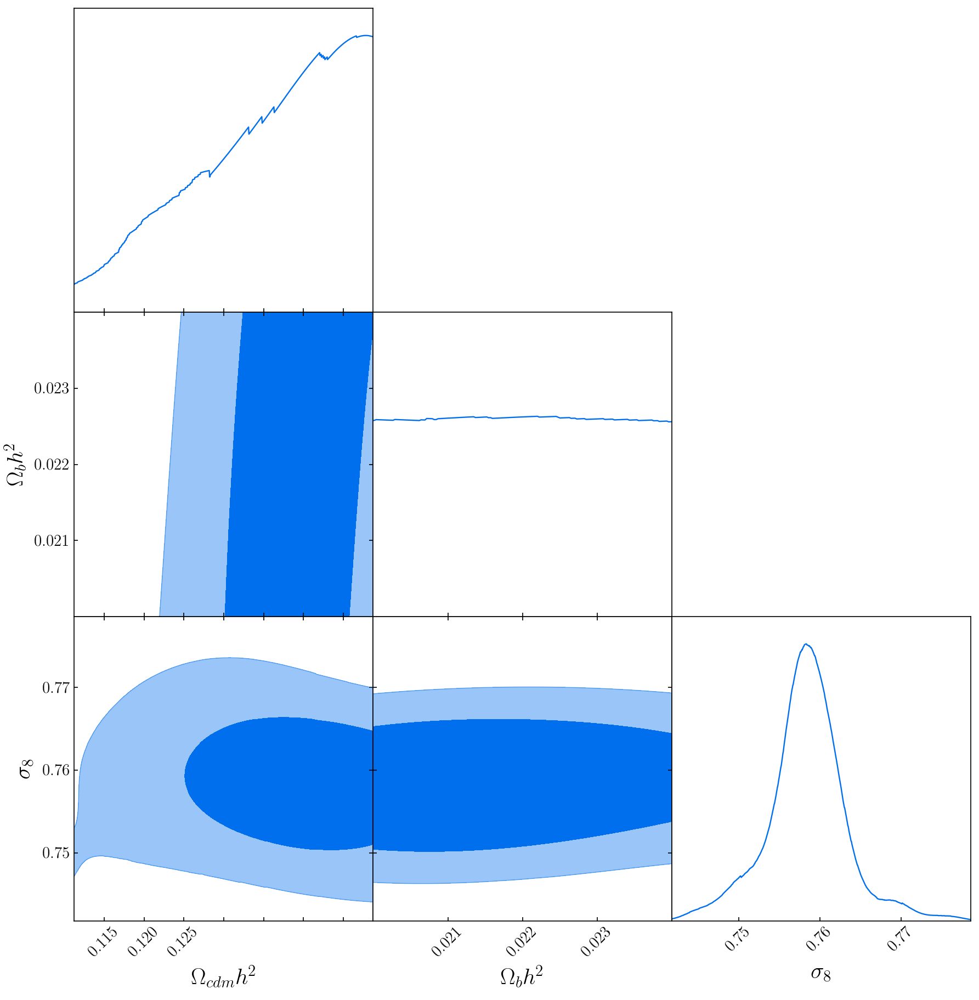

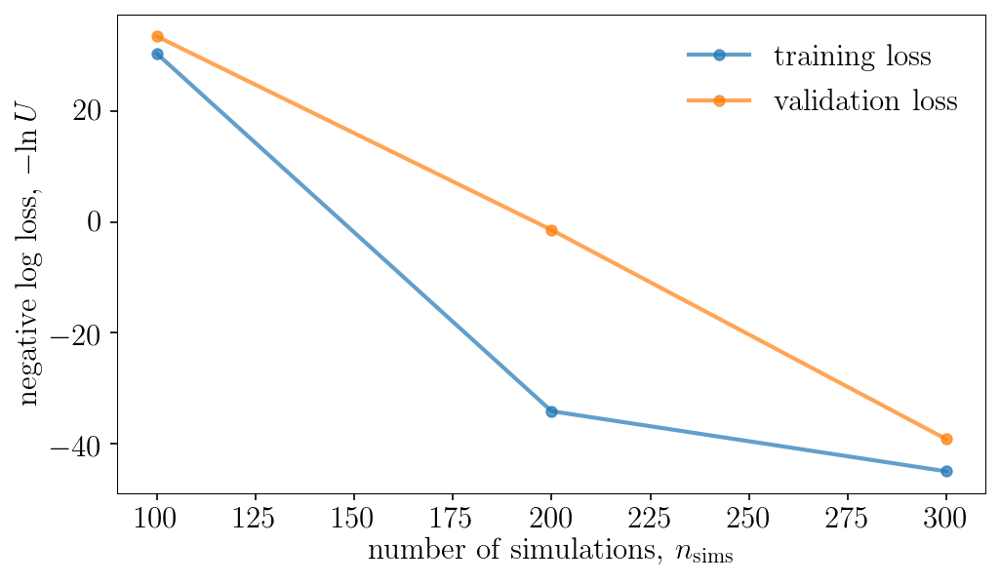

Population 6/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...


Done.
Removed no burn in


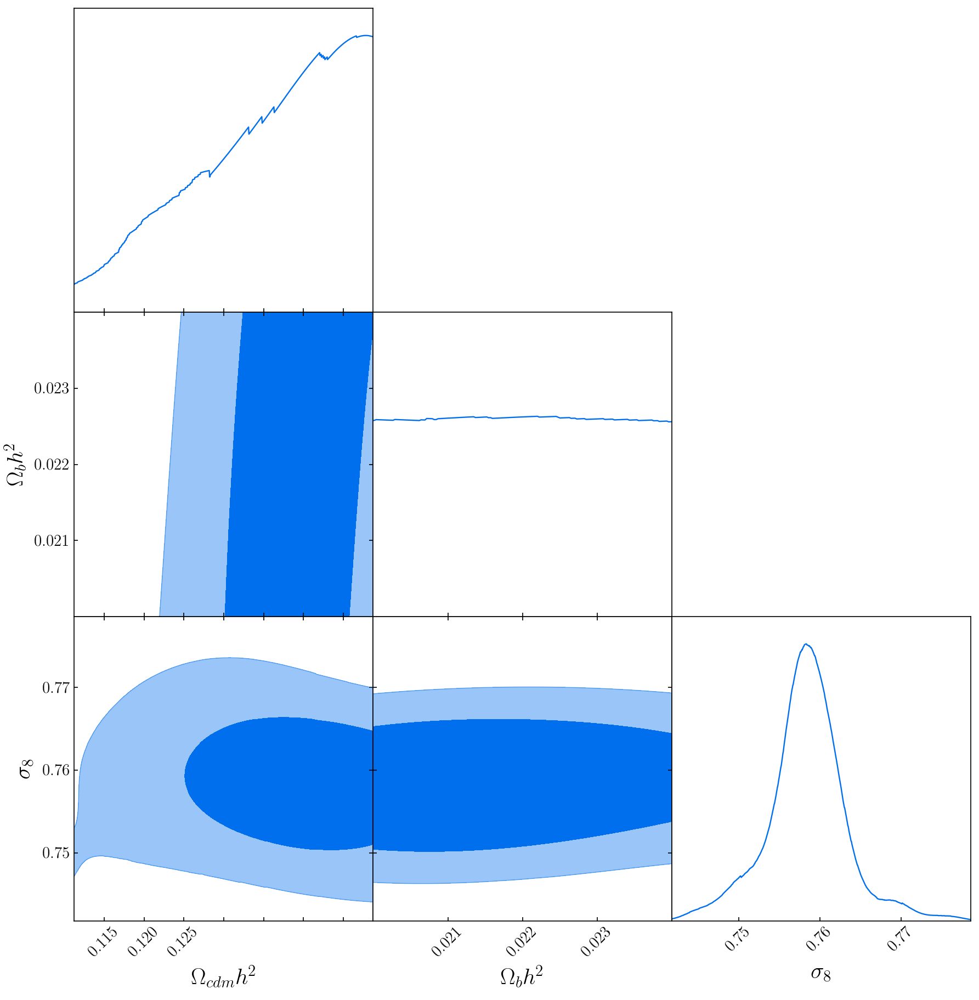

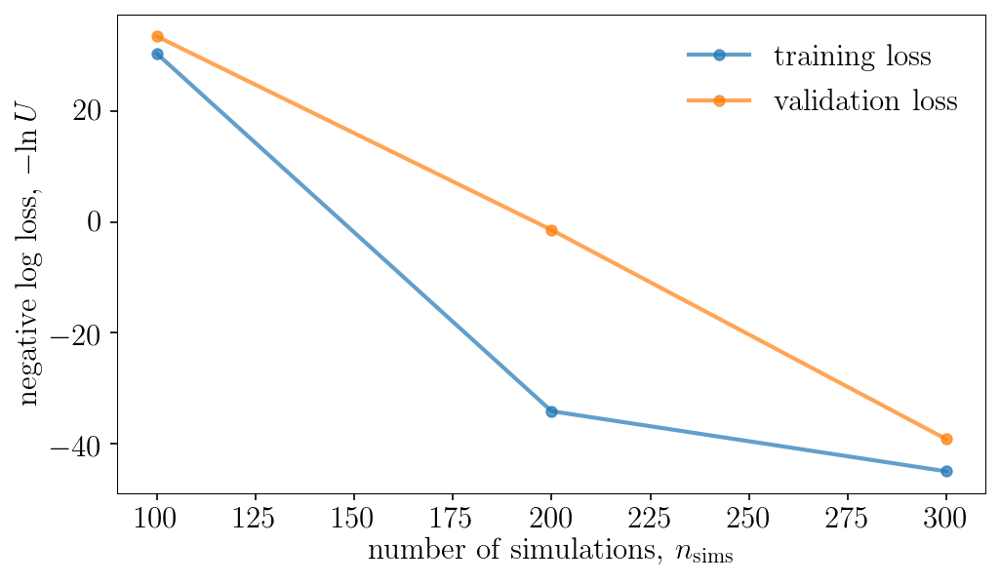

Population 7/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...


Done.
Removed no burn in


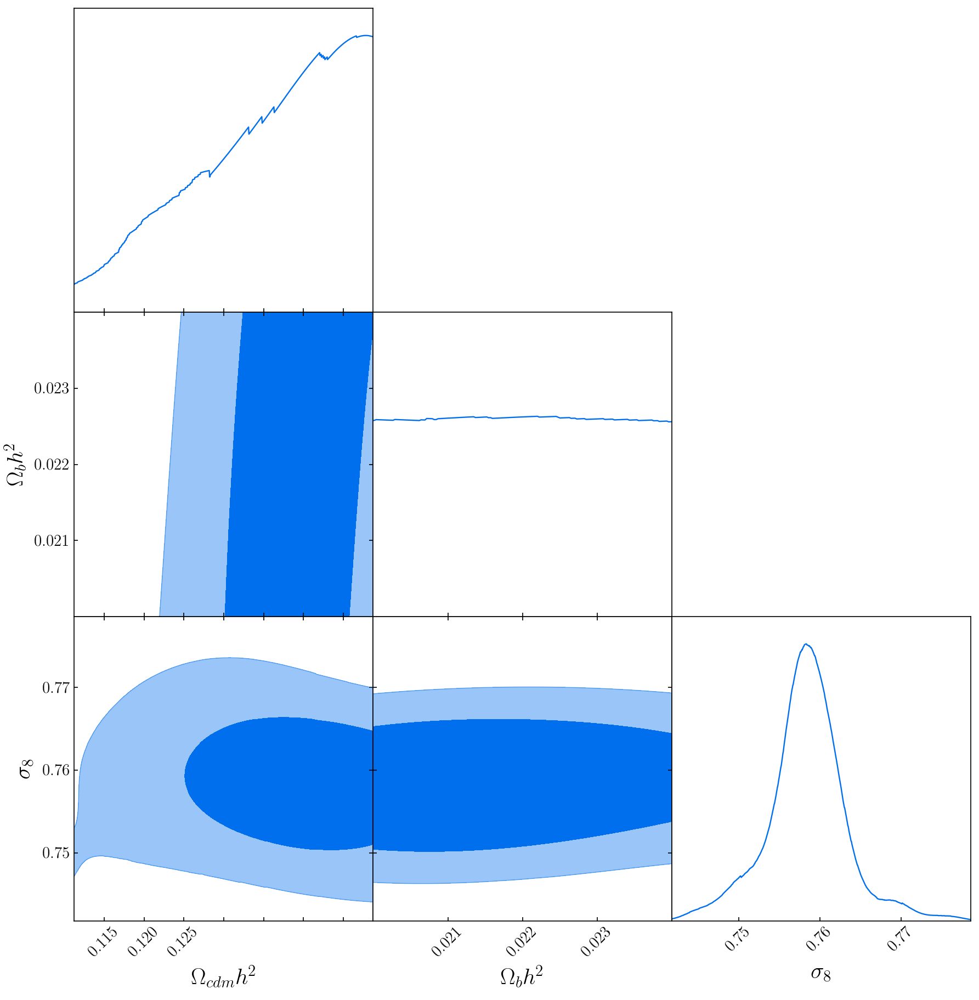

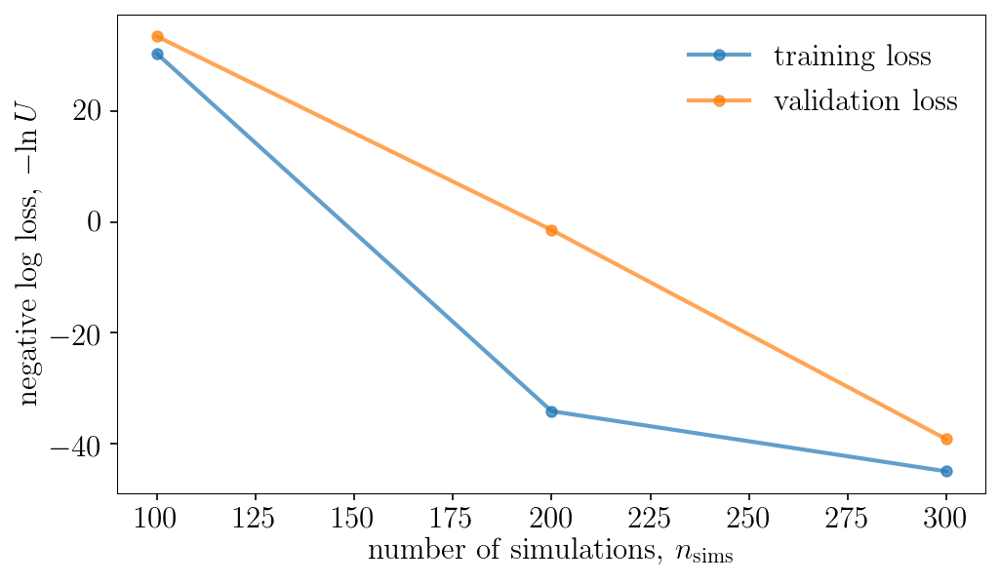

Population 8/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...


Done.
Removed no burn in


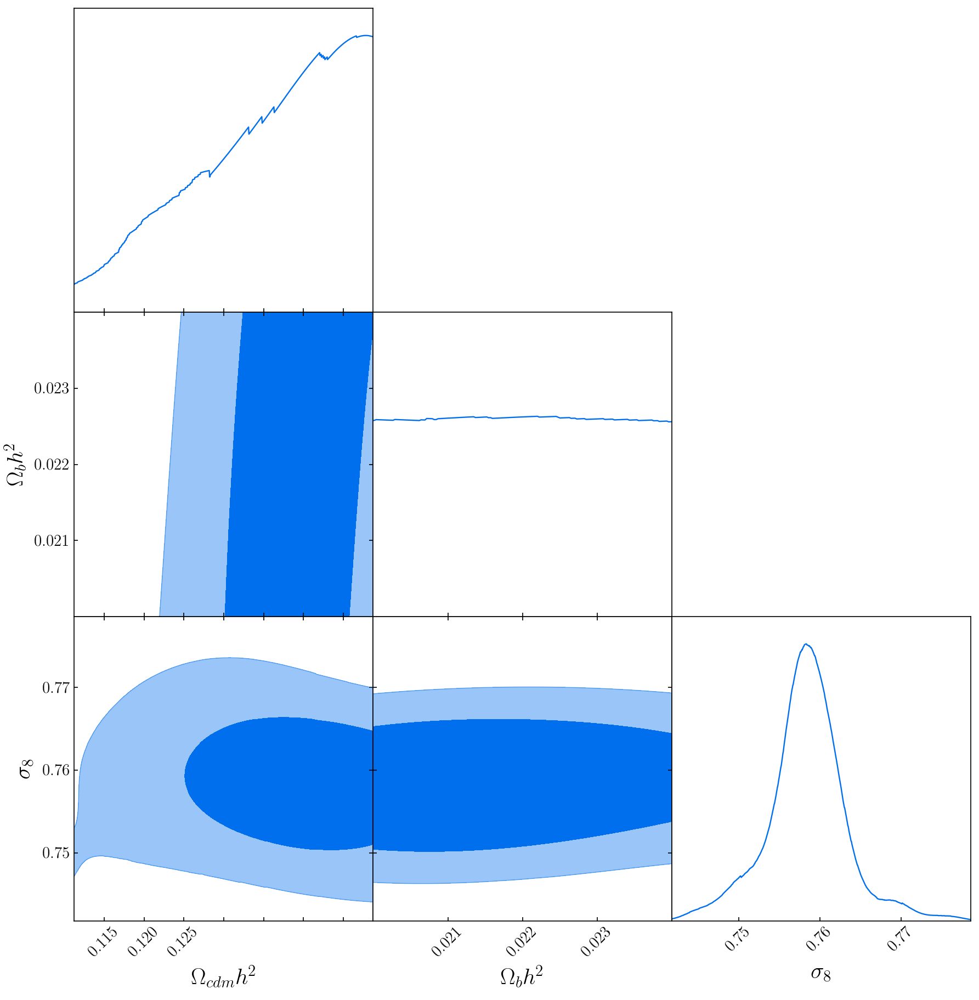

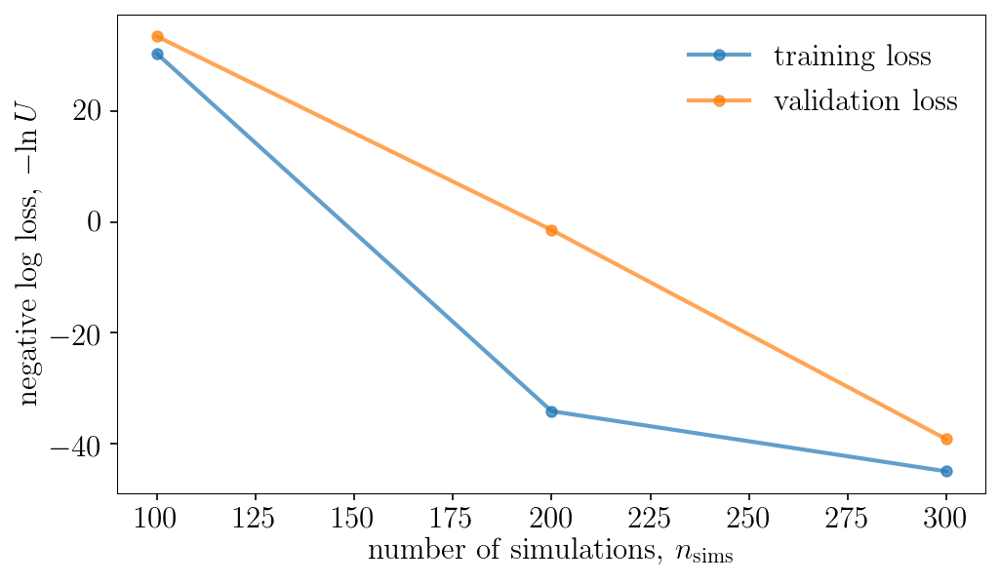

Population 9/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...


Done.
Removed no burn in


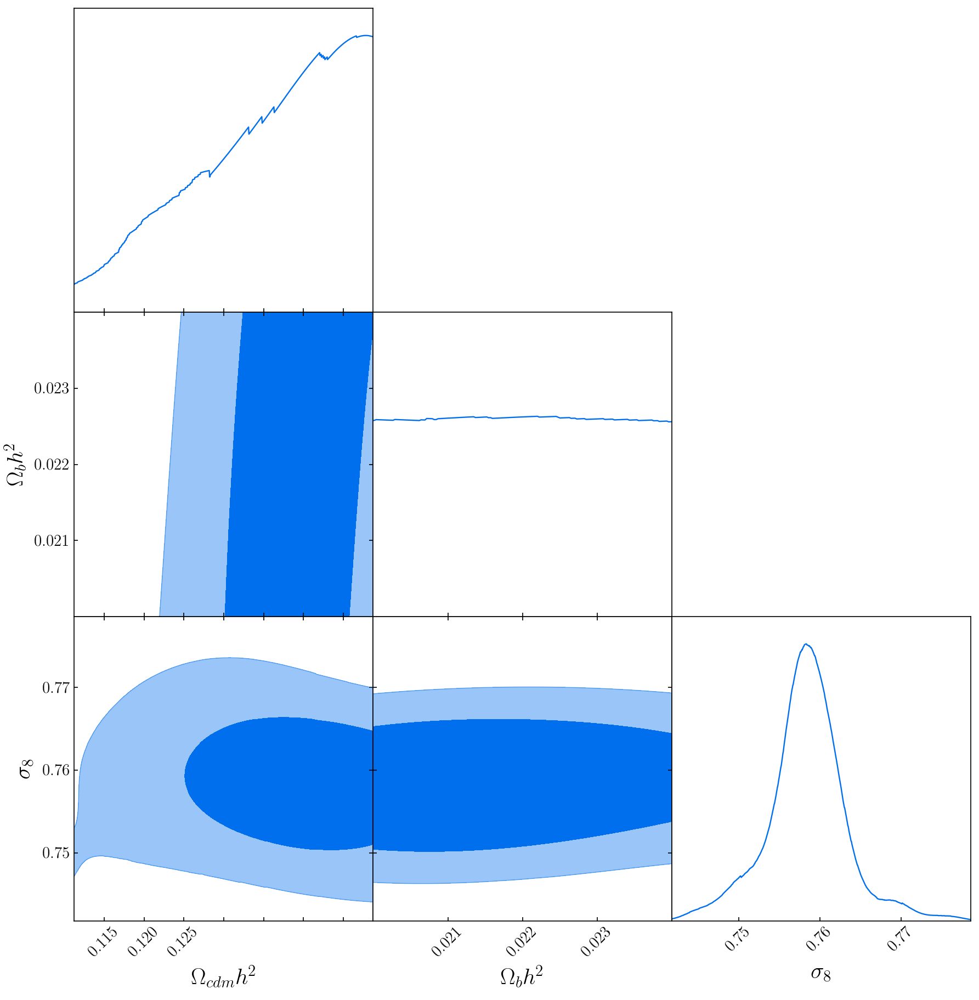

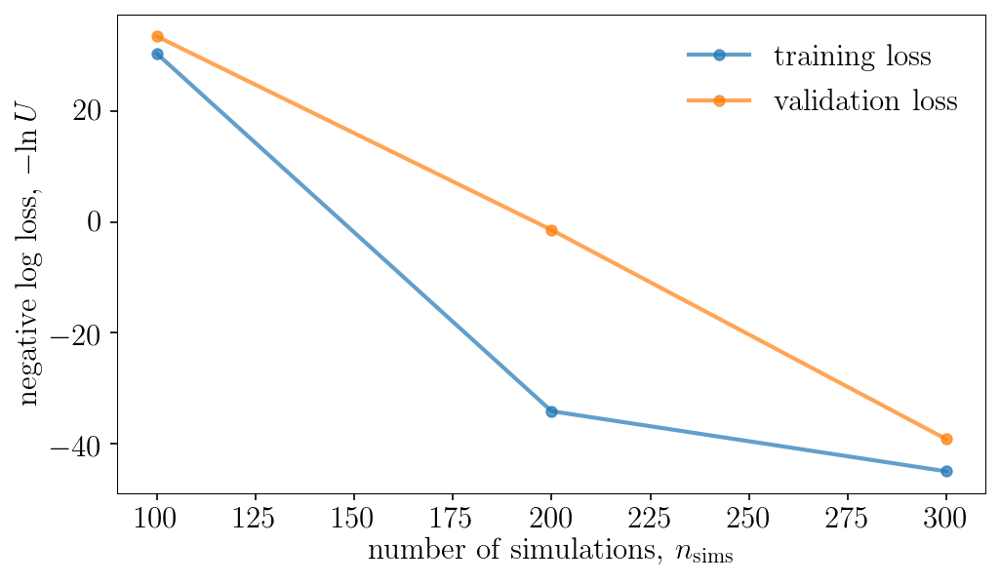

Population 10/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...


Done.
Removed no burn in


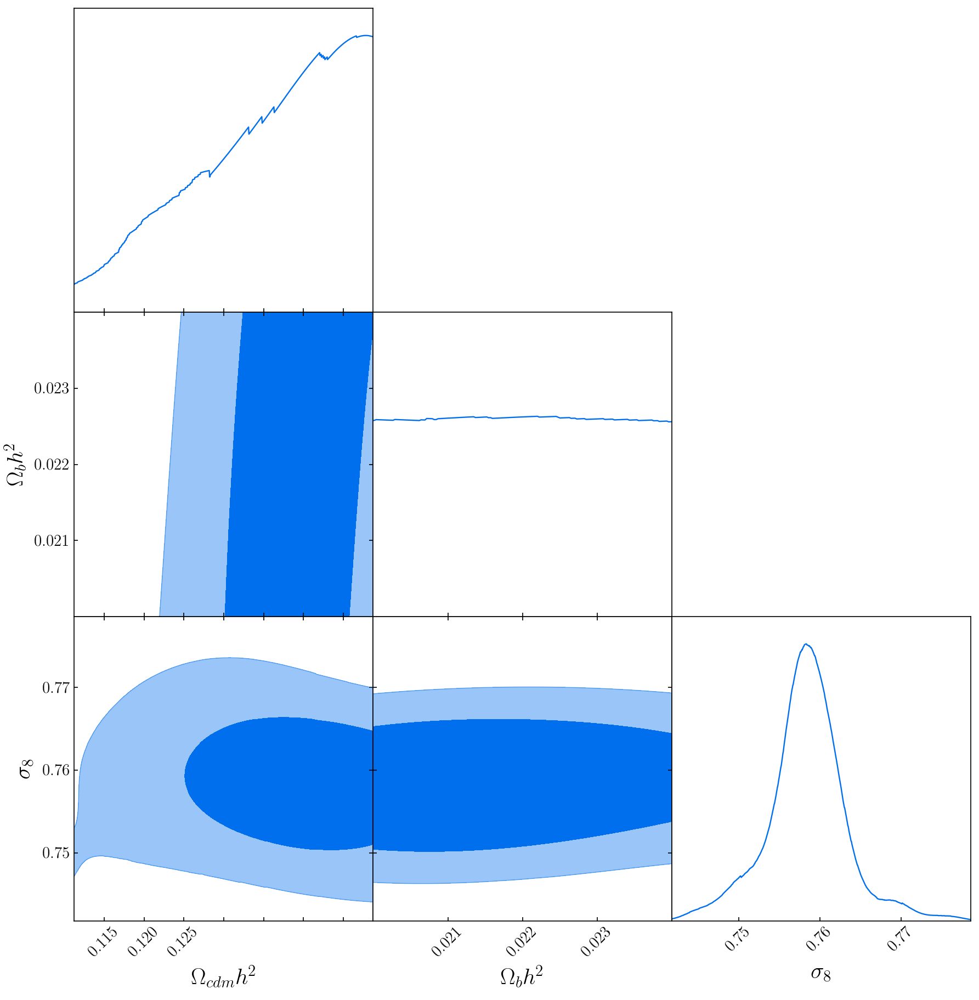

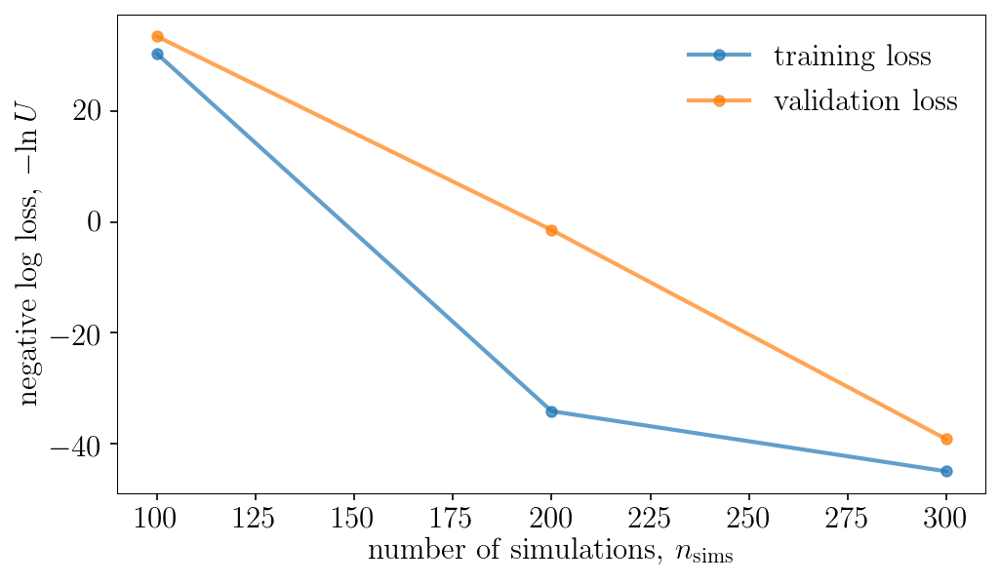

Population 11/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...


Done.
Removed no burn in


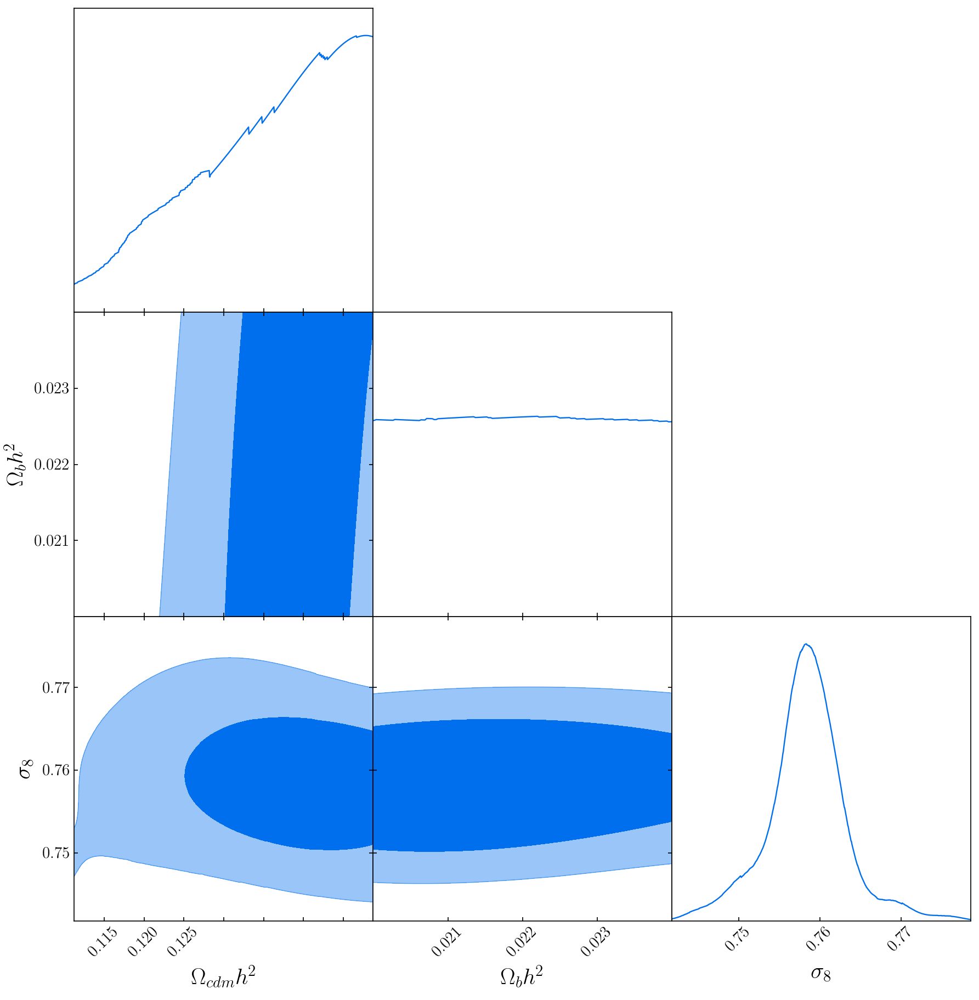

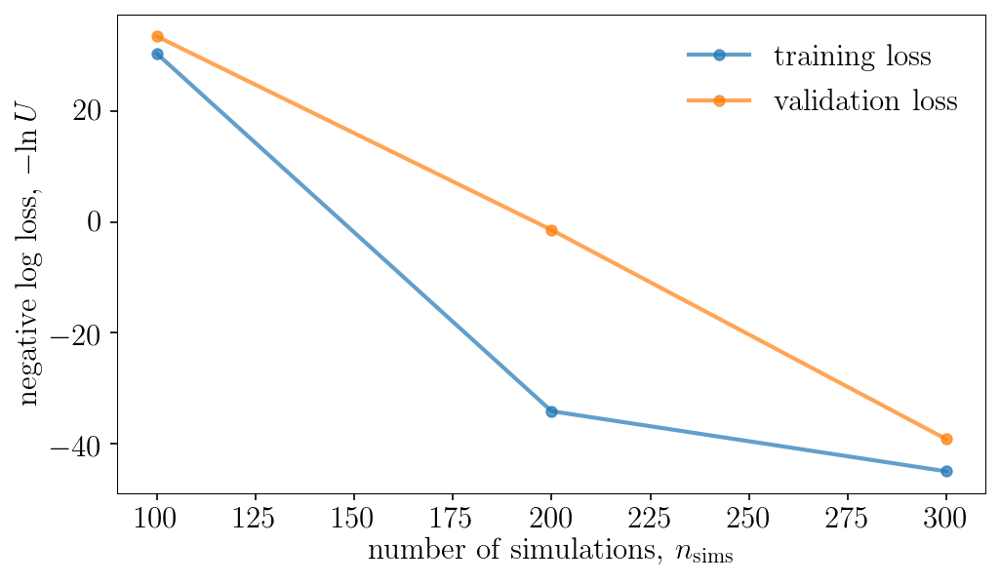

Population 12/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...


Done.
Removed no burn in


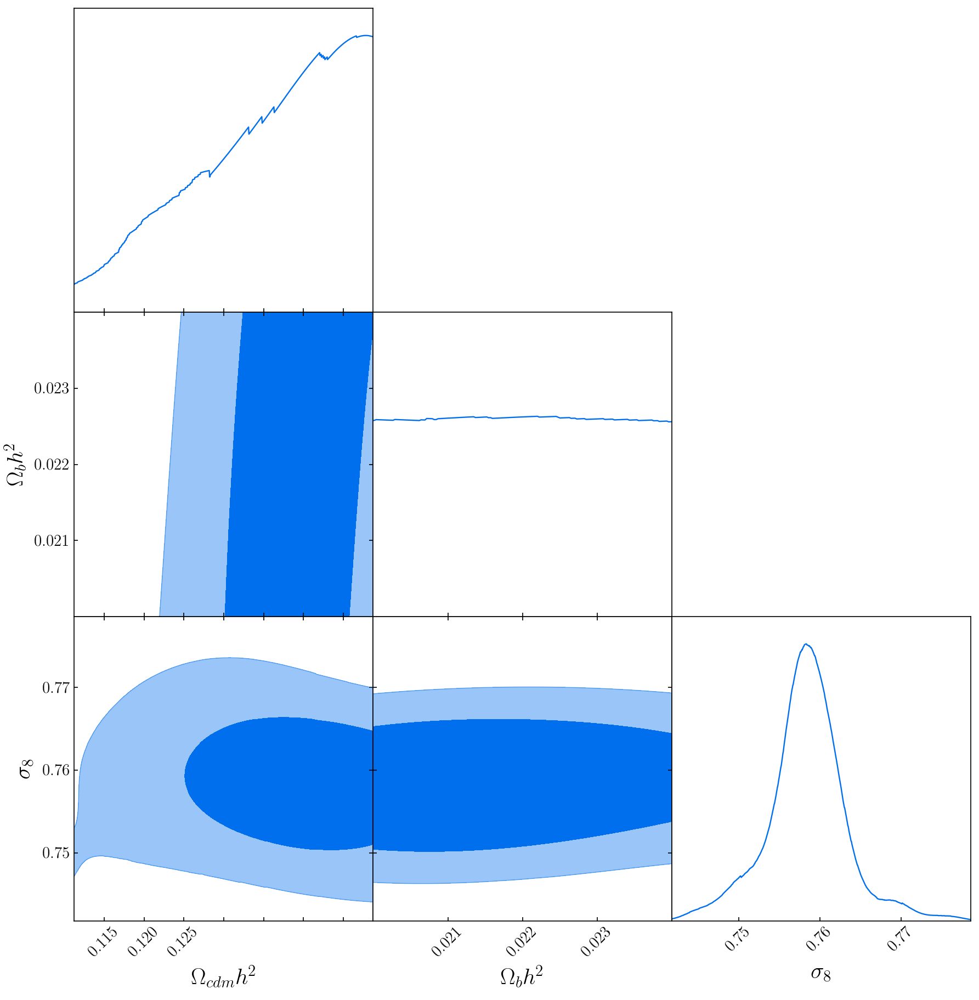

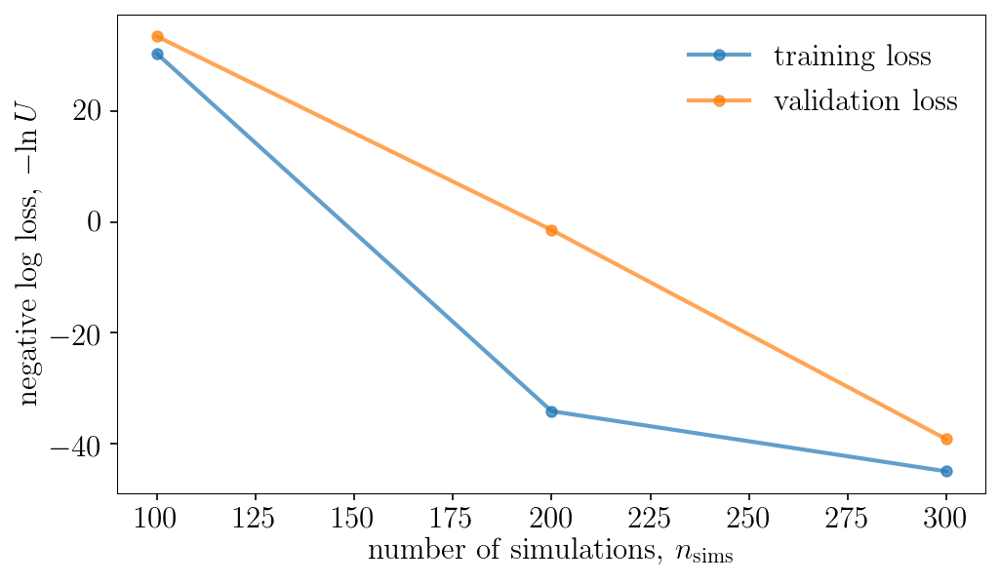

Population 13/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...


Done.
Removed no burn in


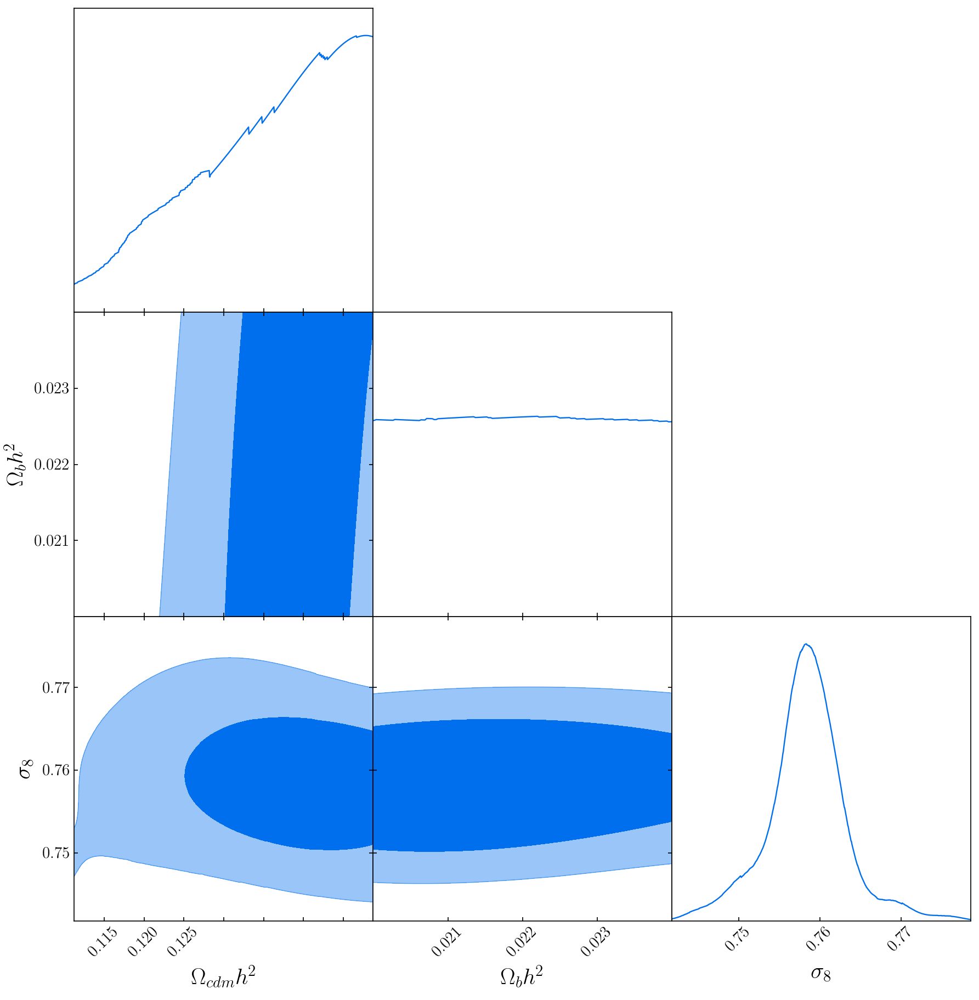

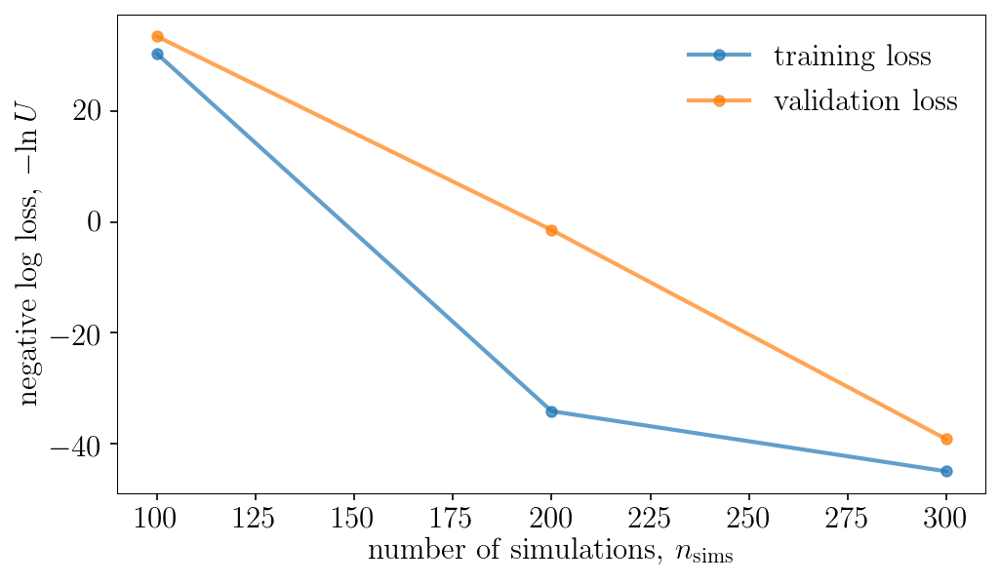

Population 14/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...


Done.
Removed no burn in


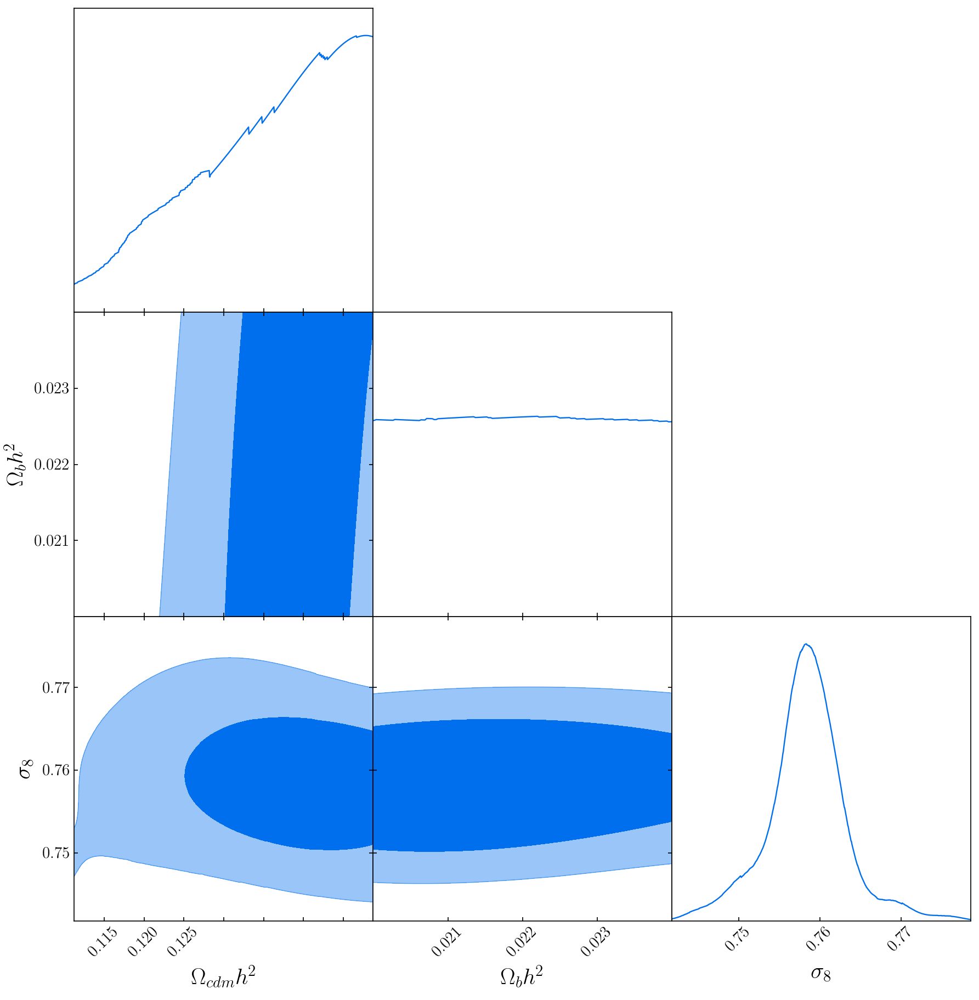

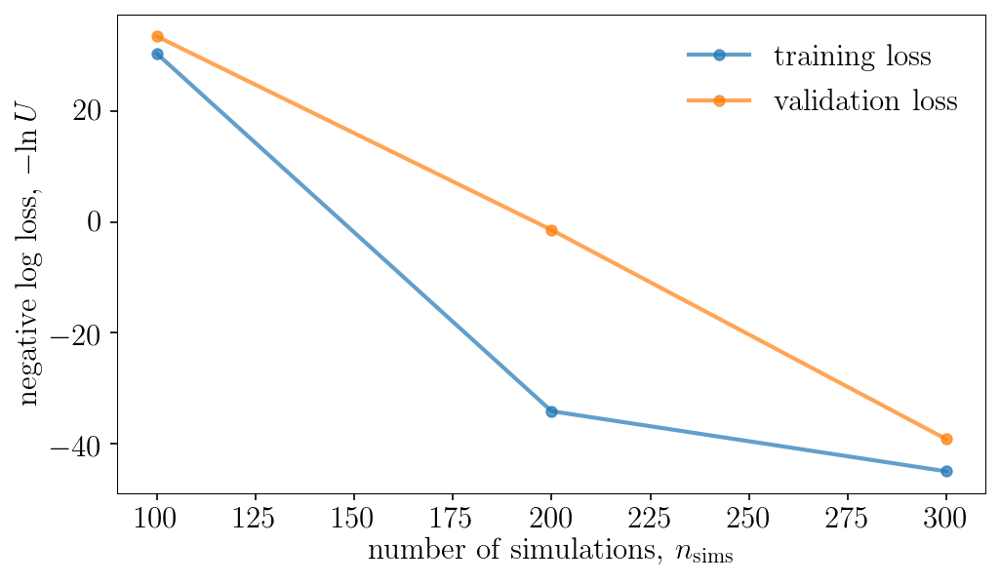

Population 15/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...


Done.
Removed no burn in


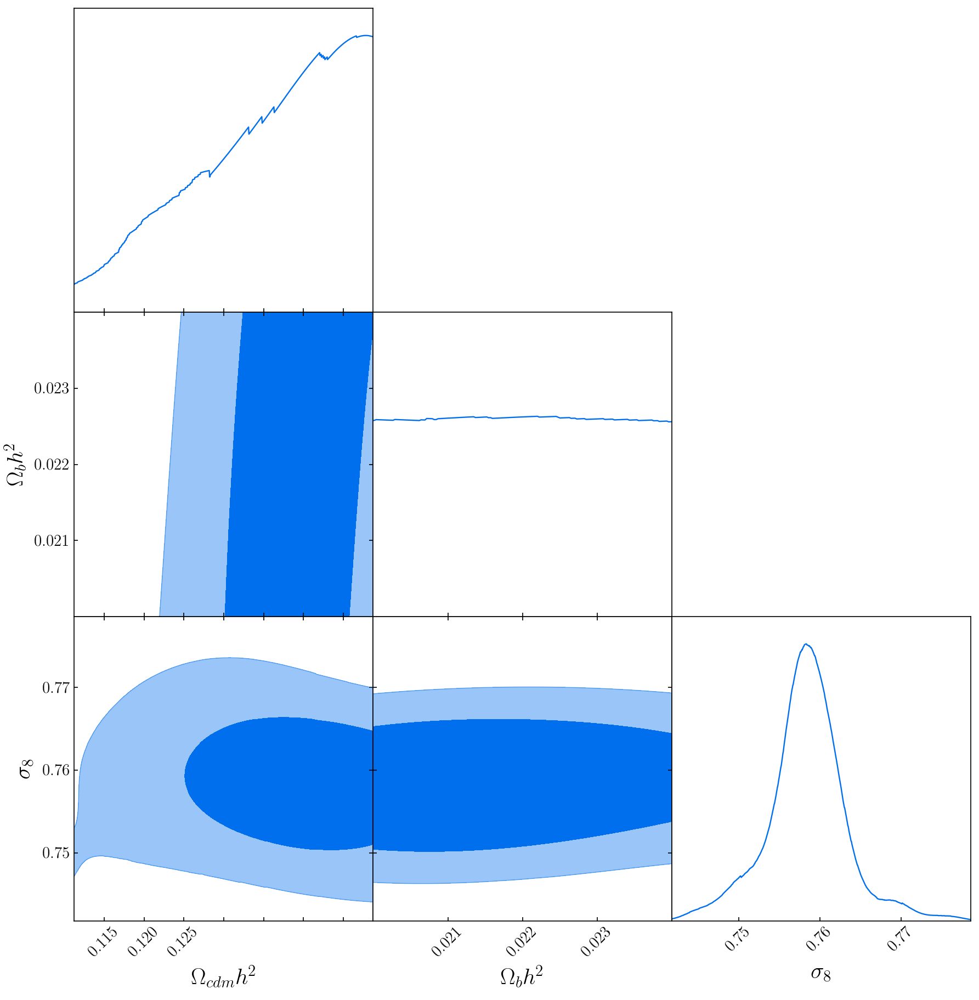

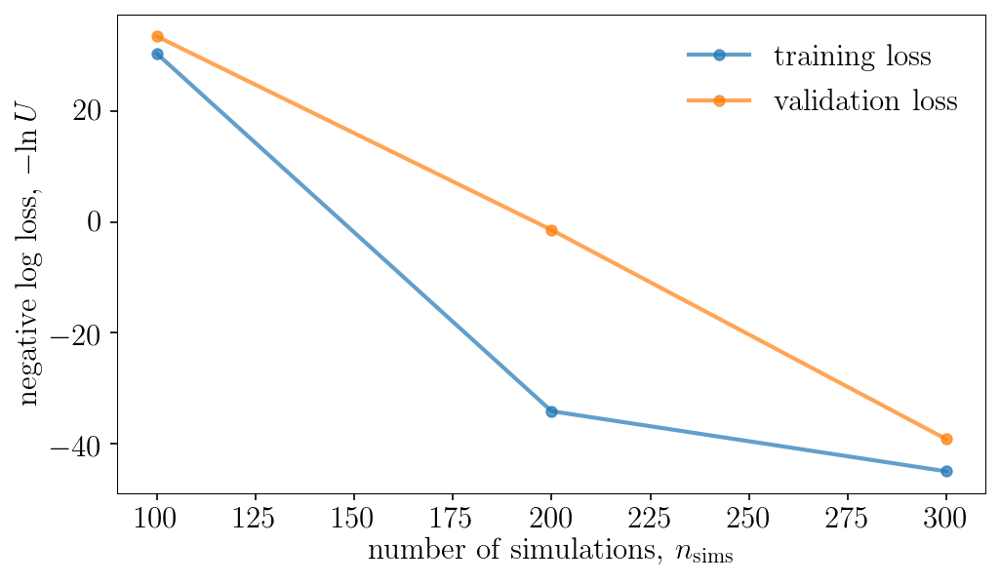

Population 16/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...


Done.
Removed no burn in


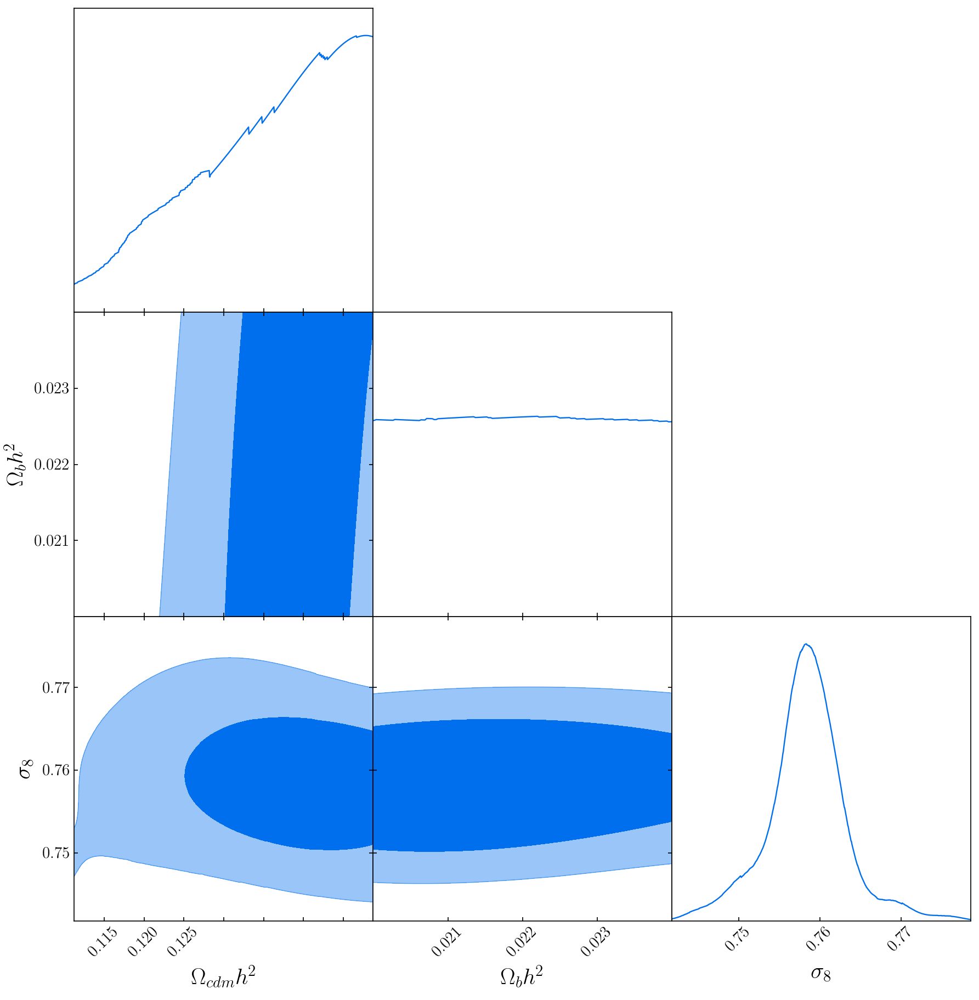

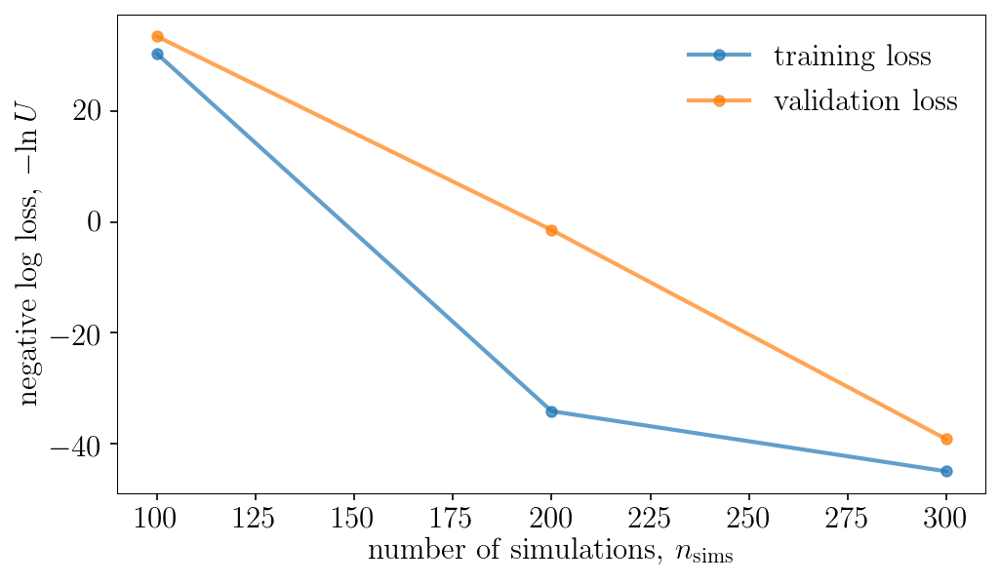

Population 17/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...


Done.
Removed no burn in


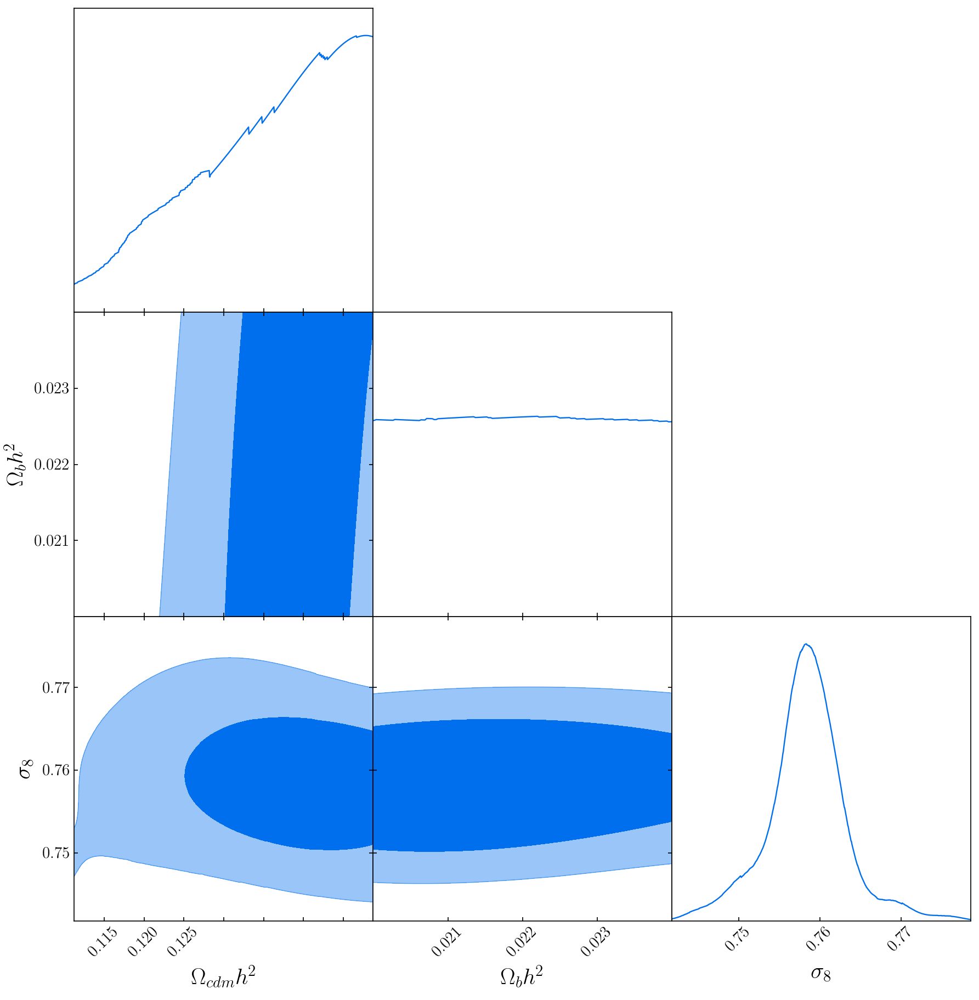

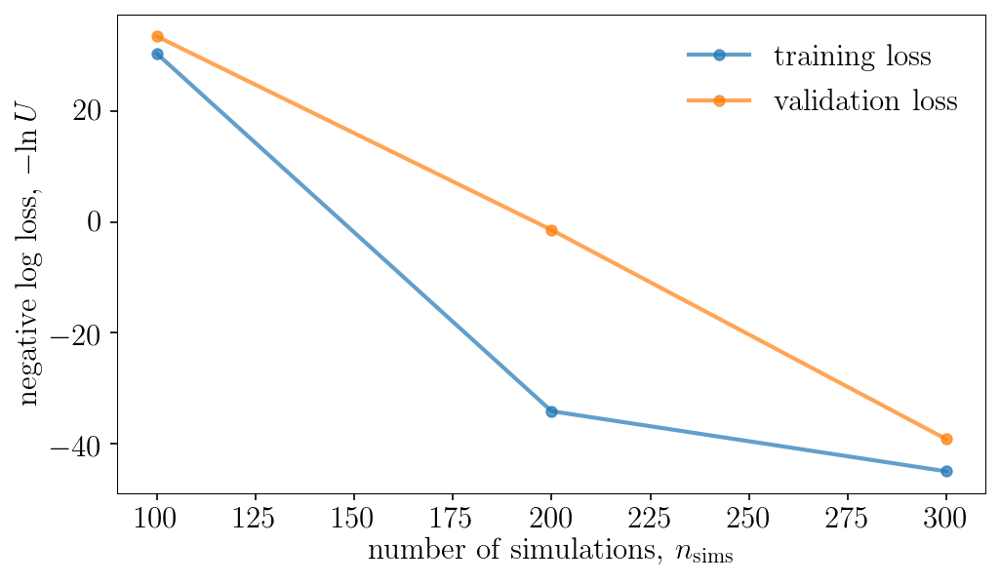

Population 18/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...


Done.
Removed no burn in


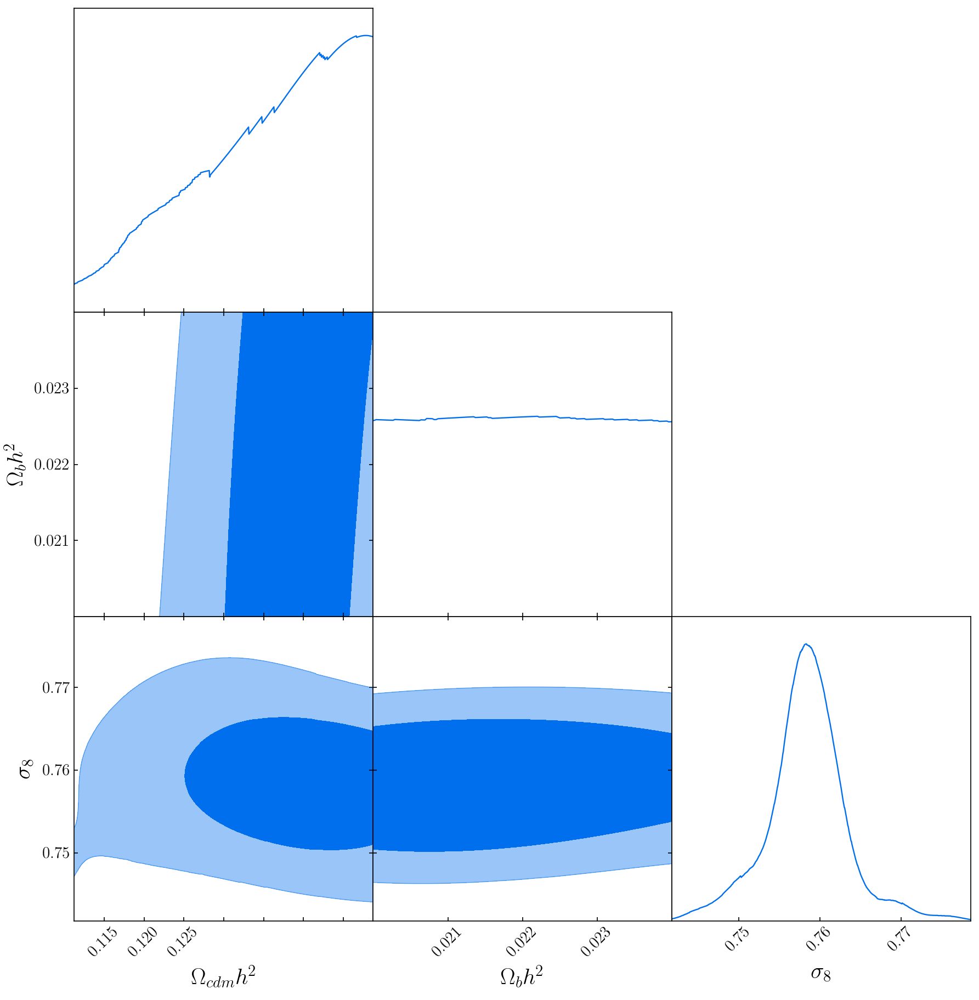

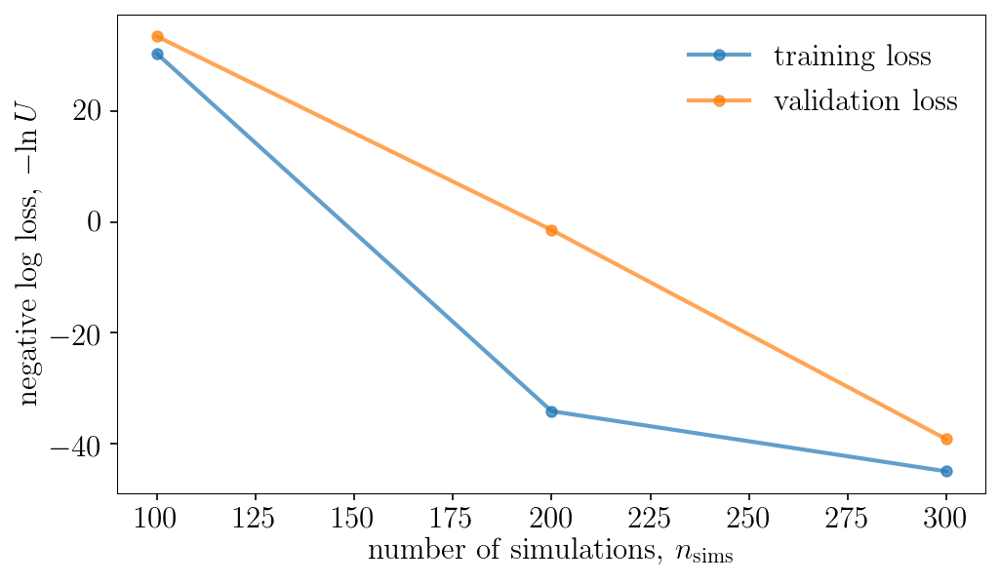

Population 19/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...


Done.
Removed no burn in


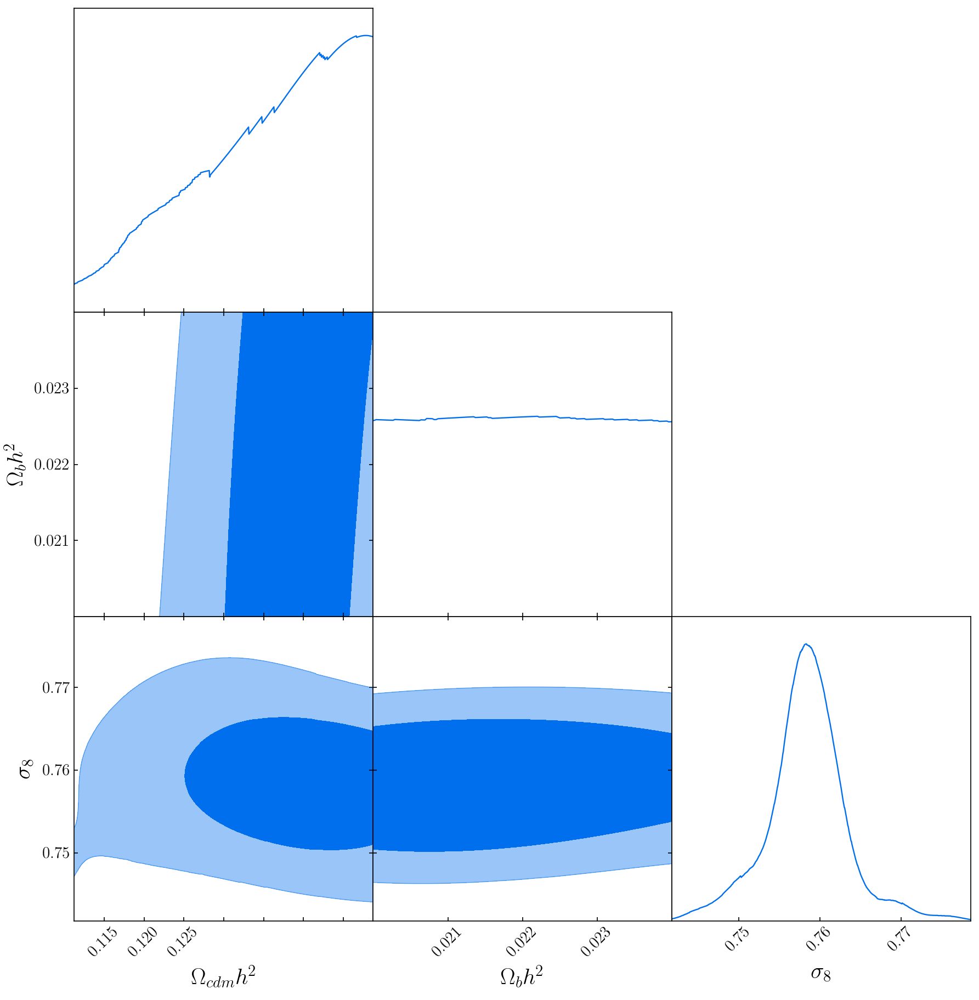

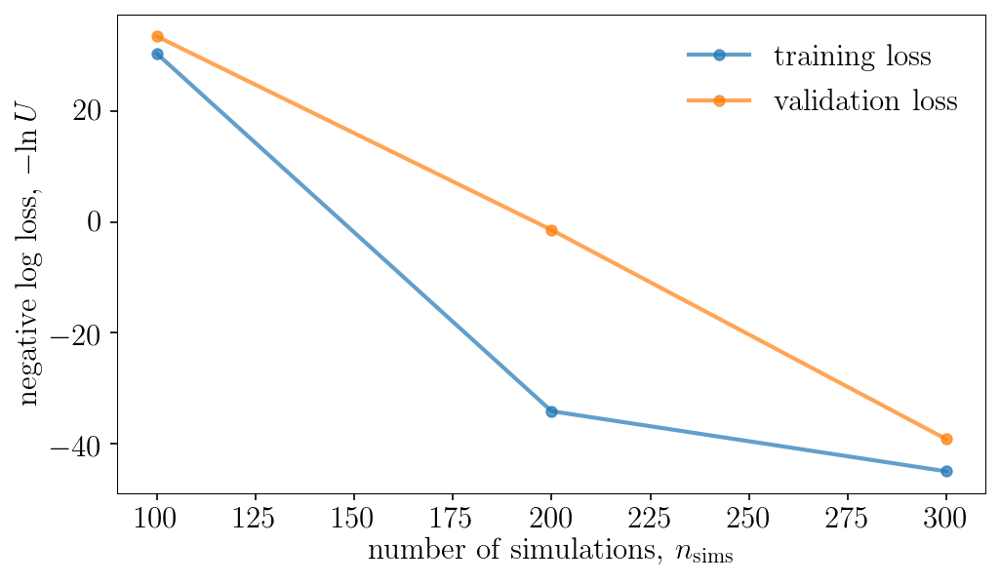

Population 20/20
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


Sampling approximate posterior...


Done.
Removed no burn in


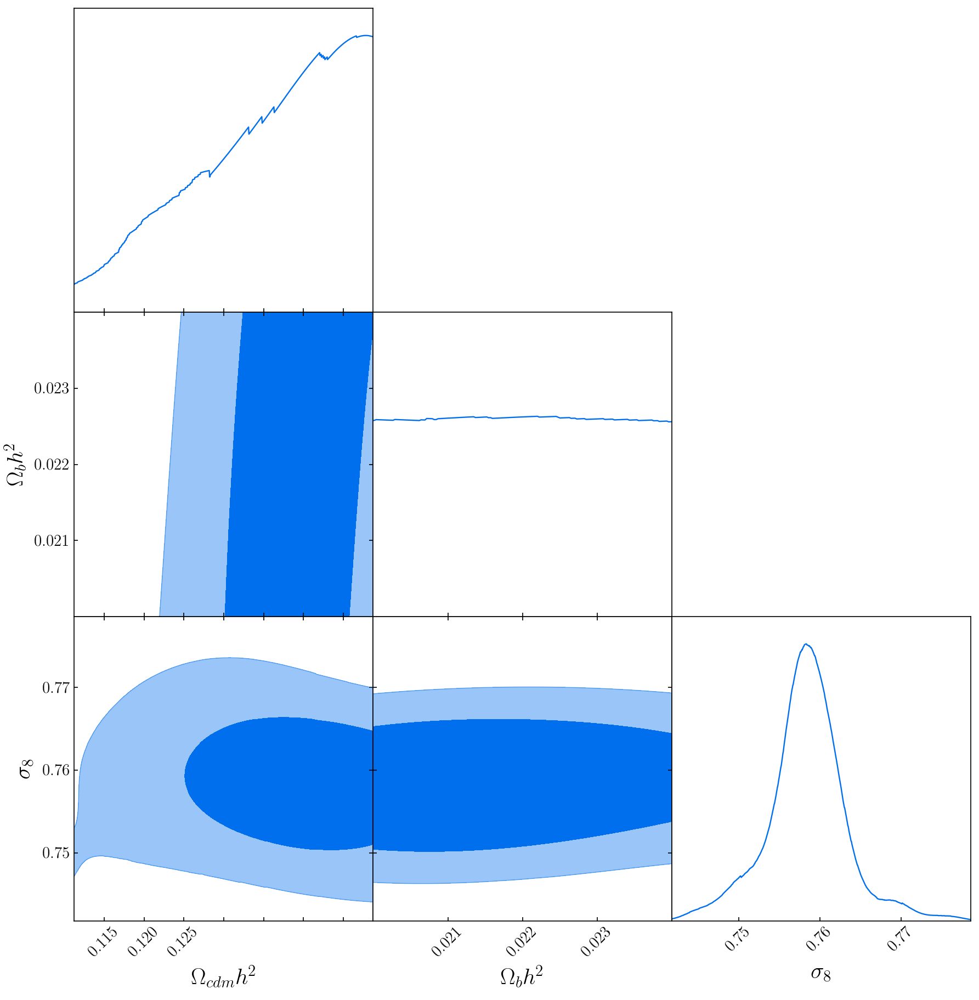

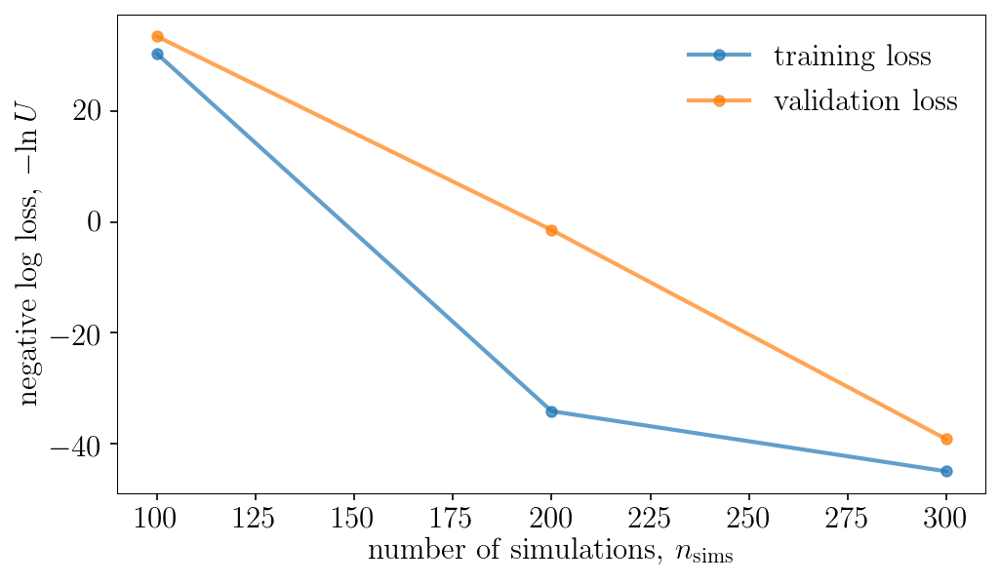

In [30]:
DelfiEnsemble.sequential_training(simulator, compressor, n_initial, n_batch, n_populations, patience=20)

In [31]:
x0 = DelfiEnsemble.posterior_samples[np.random.choice(np.arange(len(DelfiEnsemble.posterior_samples)), p=DelfiEnsemble.posterior_weights.astype(np.float32)/sum(DelfiEnsemble.posterior_weights), replace=False, size=DelfiEnsemble.nwalkers),:]
posterior_samples, posterior_weights, log_prob = DelfiEnsemble.emcee_sample(x0=x0)

/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Removed no burn in


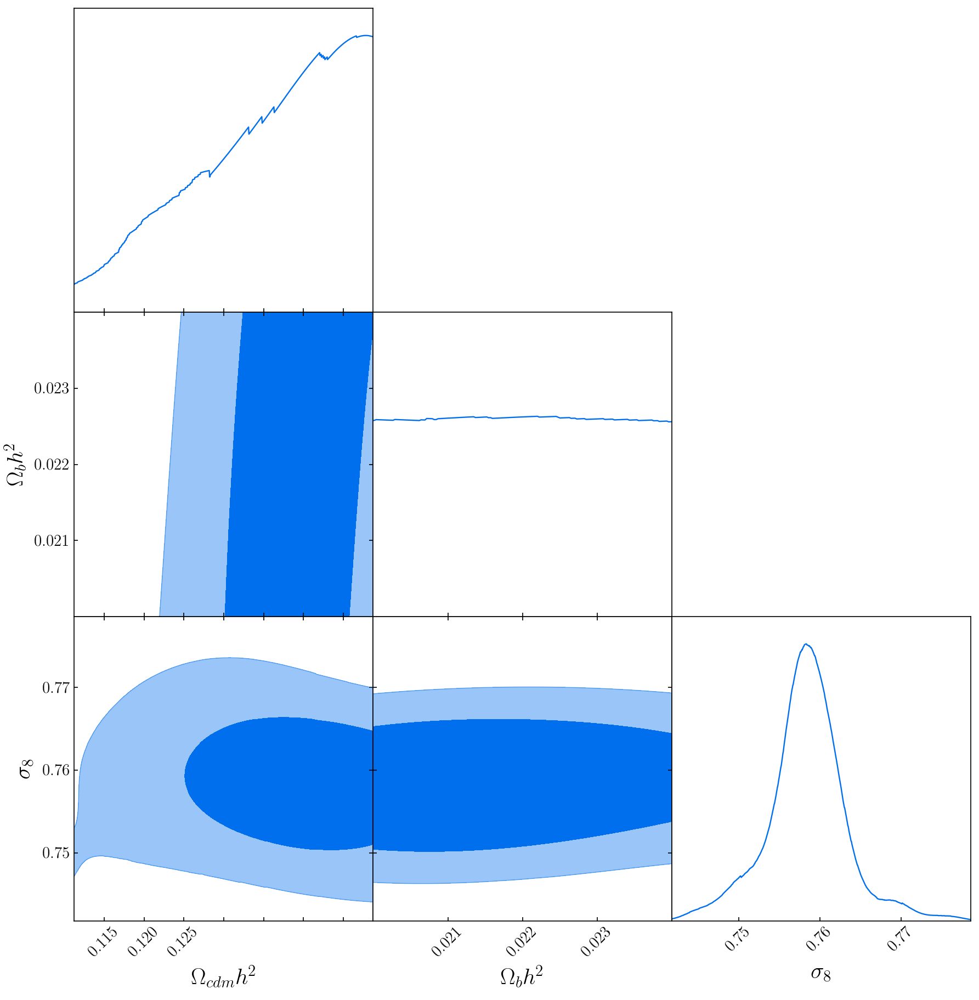

<Figure size 900x600 with 0 Axes>

In [32]:
DelfiEnsemble.triangle_plot(samples=[posterior_samples], weights=[posterior_weights])
plt.savefig('posteriors_3params_20populations.png')

## Attempt 4

In [17]:
DelfiEnsemble = delfi.Delfi(N_counts_data.reshape(20), prior, NDEs1, 
                            theta_fiducial = theta_fiducial, 
                            param_limits = [lower, upper],
                            param_names = ['\\Omega_{cdm}h^{2}', '\\Omega_{b}h^{2}', '\\sigma_{8}'],
                            results_dir = "simulators/mass_function_n_counts/results_1000simulations/")

In [18]:
n_initial = 20 #200
n_batch = 20 #200
n_populations = 50 #20


total: 0.7792955509999988 s
total: 0.7789939819999994 s
total: 0.7848959729999994 s
total: 0.7791483379999988 s
total: 0.783589997 s
total: 0.7852569509999974 s
total: 0.7839620260000011 s
total: 0.7869569280000022 s
total: 0.7970507289999986 s
total: 0.7891381770000017 s
total: 0.7990099430000015 s
total: 0.781358161 s
total: 0.7846847189999977 s
total: 0.7892585220000008 s
total: 0.7843365149999997 s
total: 0.7794135490000009 s
total: 0.7848744230000015 s
total: 0.7802223910000023 s
total: 0.7945511719999985 s
total: 0.7839453540000001 s



Sampling approximate posterior...
Done.
Removed no burn in


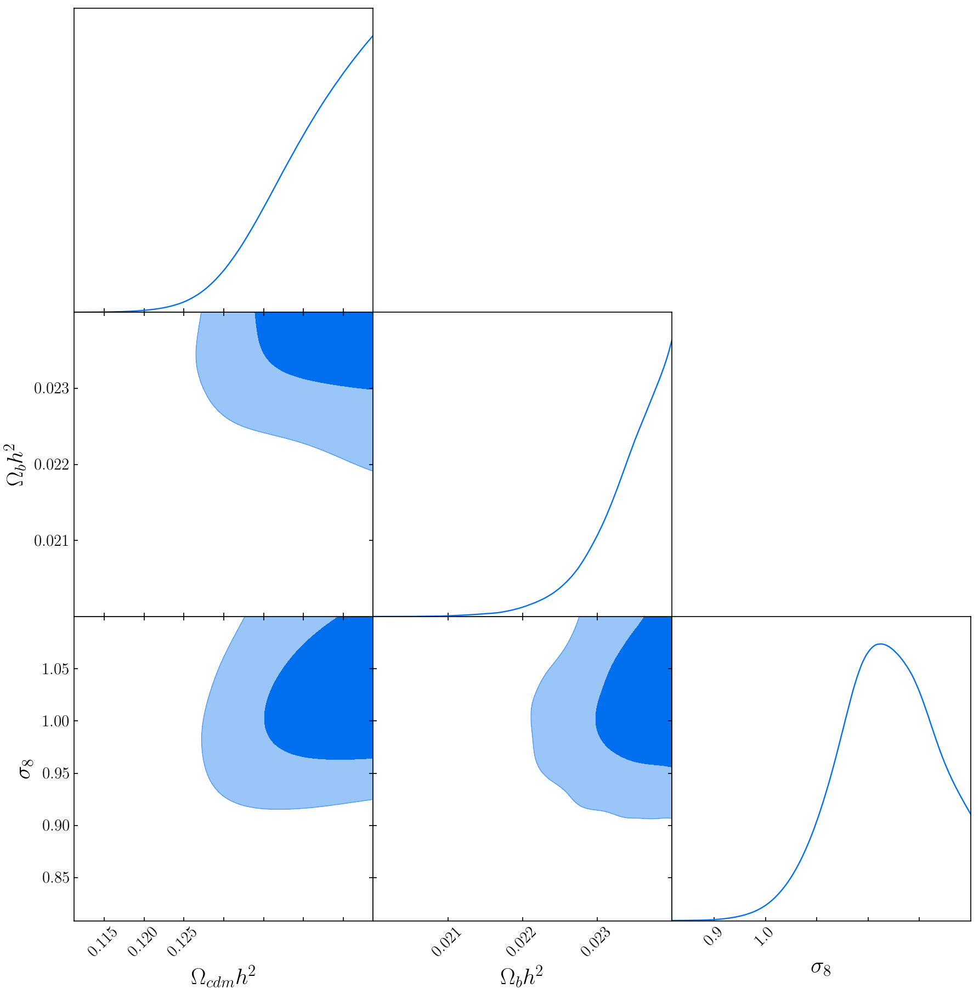

Population 1/50
Sampling proposal density...
Done.


total: 0.8463518810000323 s
total: 0.8404870810000489 s
total: 0.8585730430000353 s
total: 0.7962596849999954 s
total: 0.7995734959999936 s
total: 0.8039496800000165 s
total: 0.8011416560000271 s
total: 0.7915532779999808 s
total: 0.8022091590000286 s
total: 0.7947333609999987 s
total: 0.7990393260000133 s
total: 0.8010367470000119 s
total: 0.7963978180000026 s
total: 0.8026282669999887 s
total: 0.8178666809999982 s
total: 0.8079179709999948 s
total: 0.8052915999999755 s
total: 0.8062226979999991 s
total: 0.8019898470000157 s
total: 0.7912781299999665 s


Sampling approximate posterior...
Done.
Removed no burn in


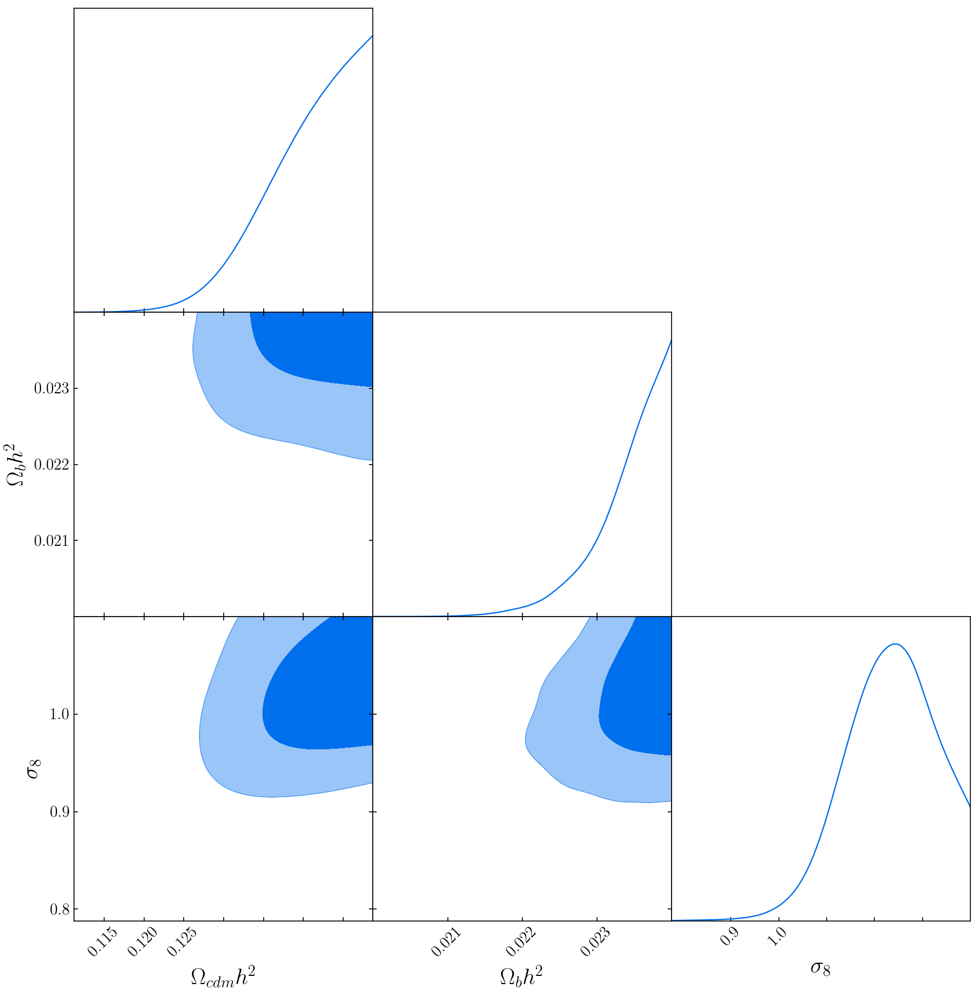

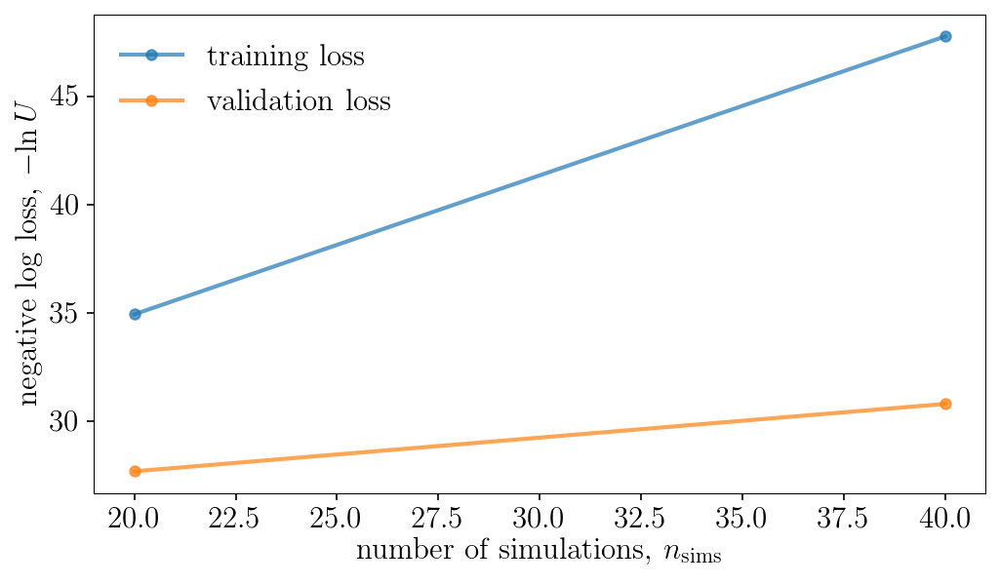

Population 2/50
Sampling proposal density...
Done.


total: 0.8069929790000288 s
total: 0.8513706729999058 s
total: 0.7954532489999337 s
total: 0.7877064250000103 s
total: 0.7739921150000555 s
total: 0.7868015120000109 s
total: 0.7746196560000271 s
total: 0.7925052360000109 s
total: 0.7776028439999436 s
total: 0.8017512399999305 s
total: 0.7744170180000083 s
total: 0.8060922230000642 s
total: 0.7804563669999425 s
total: 0.8068408680001085 s
total: 0.7747418689999677 s
total: 0.788304423999989 s
total: 0.7875836409999692 s
total: 0.7873675020000519 s
total: 0.7731655070000443 s
total: 0.7988339890000589 s


Sampling approximate posterior...
Done.
Removed no burn in


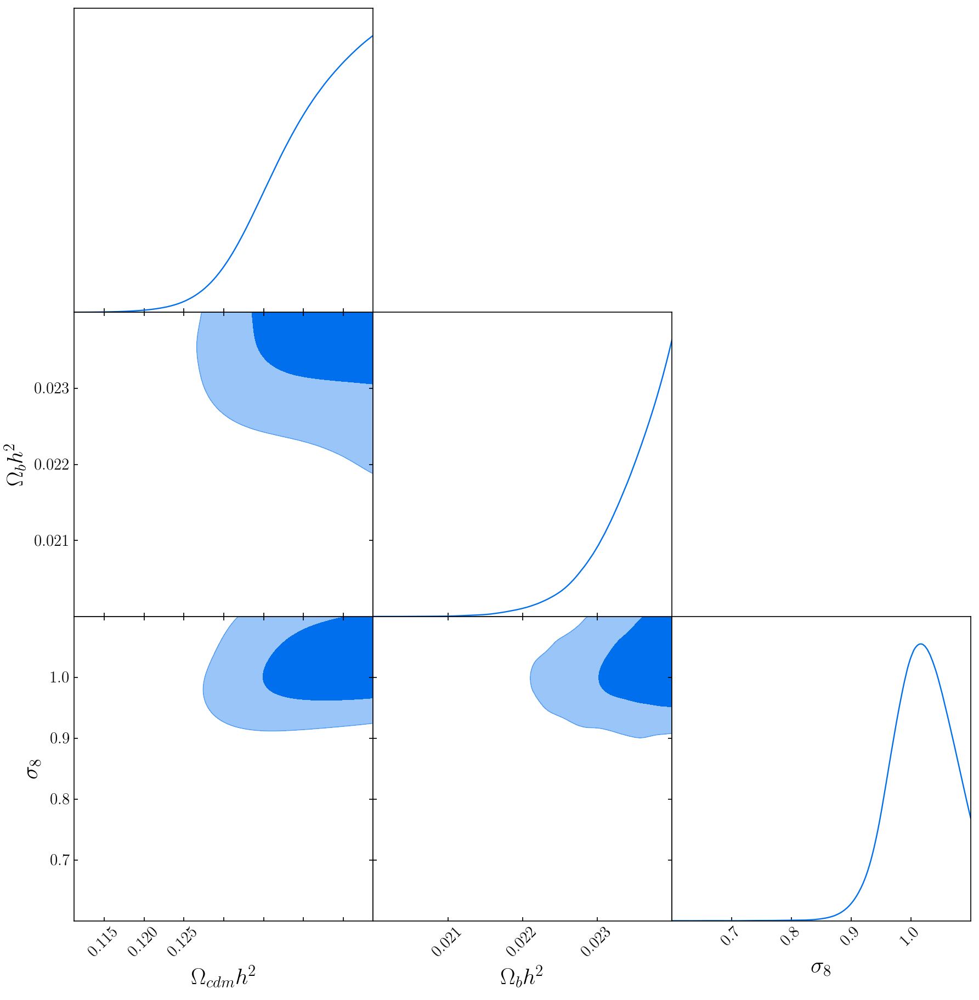

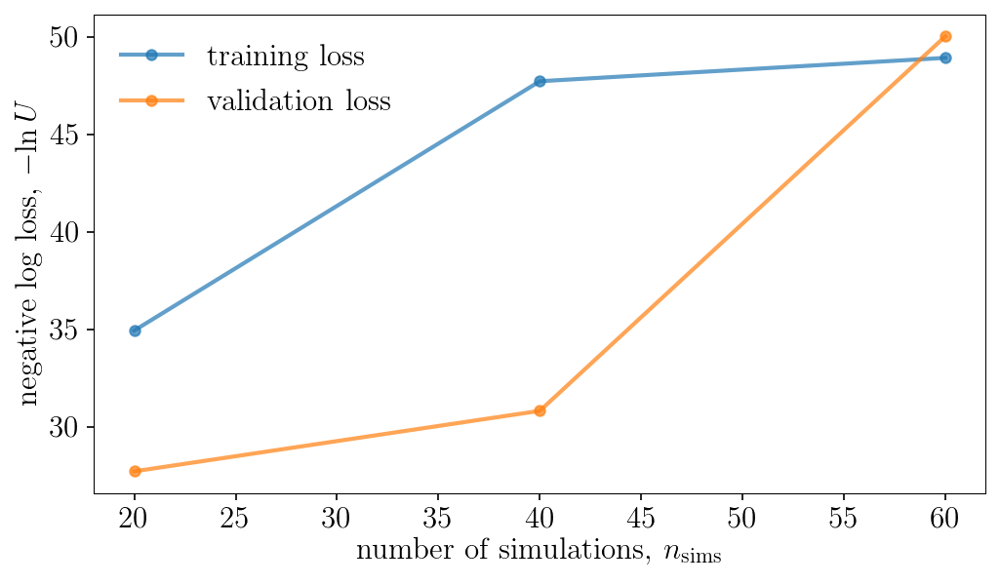

Population 3/50
Sampling proposal density...
Done.


total: 0.8601272050000262 s
total: 0.8133261730001777 s
total: 0.7927495640001325 s
total: 0.8274144590000105 s
total: 0.7988519110001562 s
total: 0.7919840760000625 s
total: 0.7993920739997975 s
total: 0.7917004920000181 s
total: 0.7903751260000718 s
total: 0.8091493060001085 s
total: 0.7916098329999386 s
total: 0.7949617549998038 s
total: 0.7981313140001021 s
total: 0.7884918900001594 s
total: 0.794694083999957 s
total: 0.7946219989999008 s
total: 0.790856753000071 s
total: 0.7889072369998757 s
total: 0.79047654399983 s
total: 0.7955931450001117 s


Sampling approximate posterior...
Done.
Removed no burn in


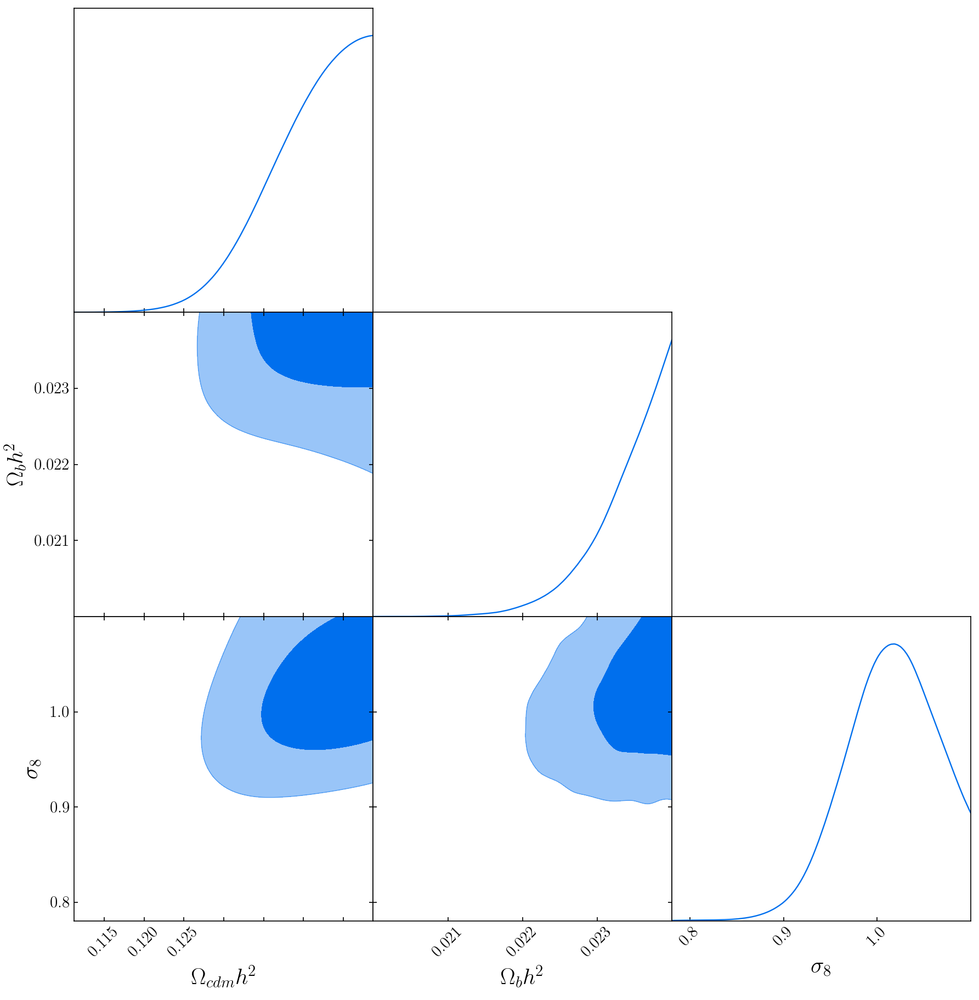

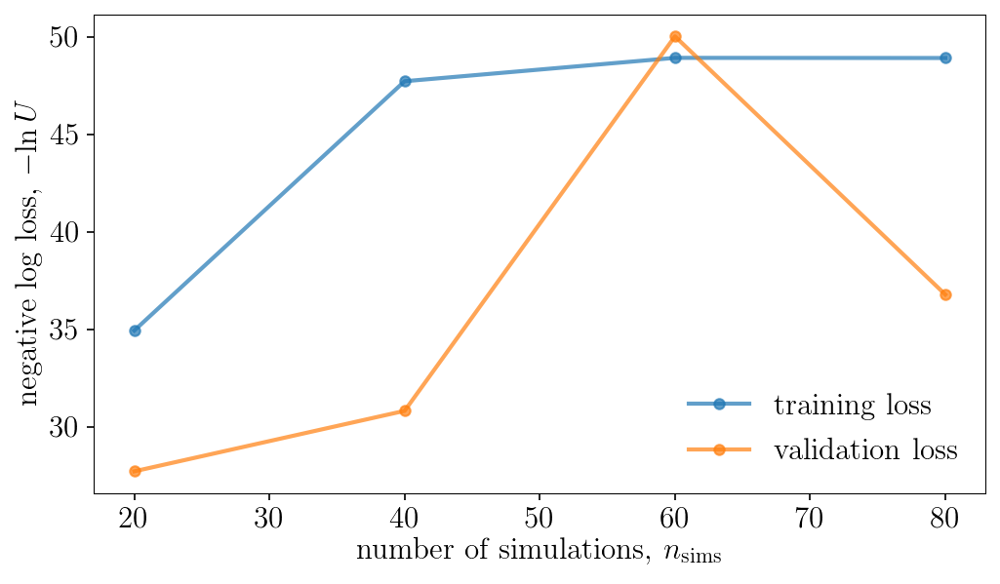

Population 4/50
Sampling proposal density...
Done.


total: 0.8306766000000607 s
total: 0.8041301739999653 s
total: 0.8001692499999535 s
total: 0.7979189310001402 s
total: 0.786882844000047 s
total: 0.7982434900000044 s
total: 0.7921885009998277 s
total: 0.8042024890000903 s
total: 0.7931100400001014 s
total: 0.7946773190001295 s
total: 0.7918451999998979 s
total: 0.7905732920000901 s
total: 0.7918307820000337 s
total: 0.7948774859999048 s
total: 0.8079124500000034 s
total: 0.7958458400000836 s
total: 0.7872809769999094 s
total: 0.7902487470000779 s
total: 0.7957780389999698 s
total: 0.7929650799999308 s


Sampling approximate posterior...
Done.
Removed no burn in


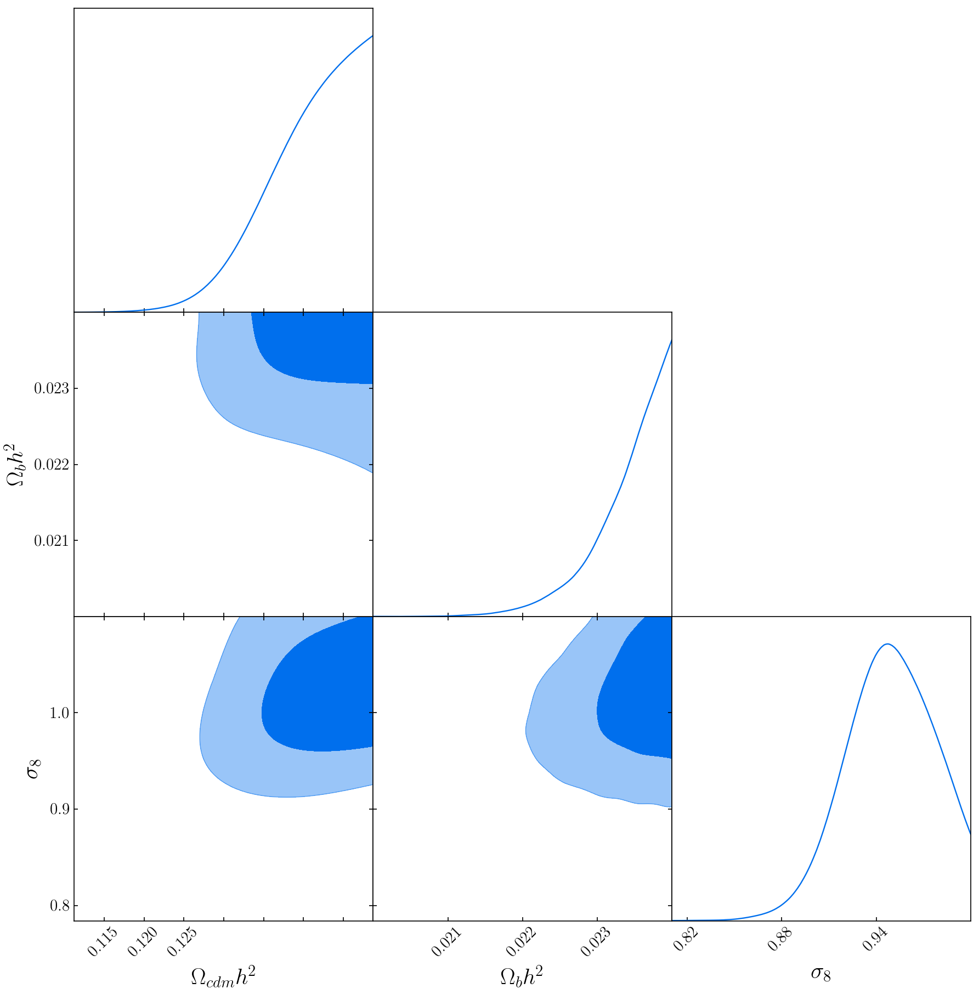

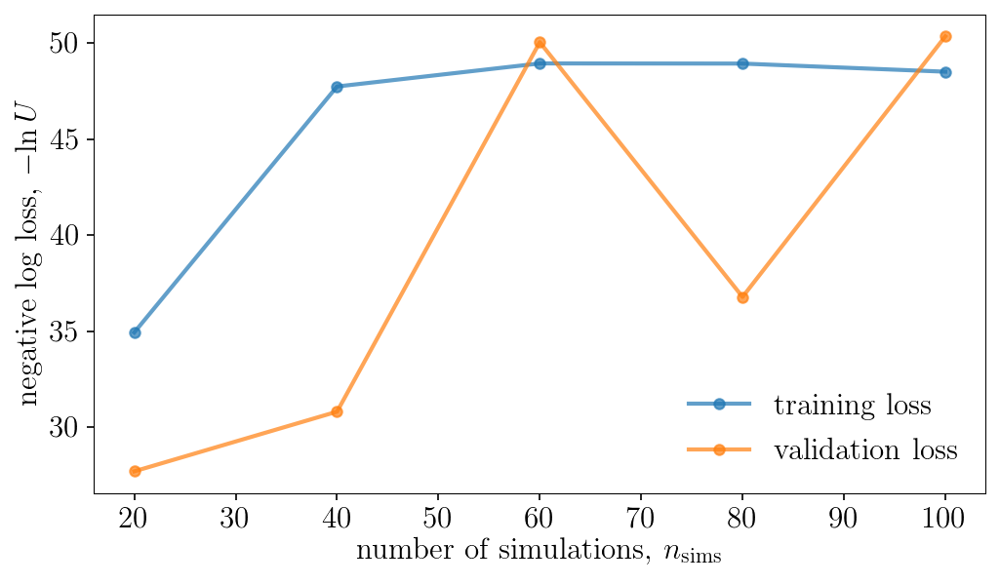

Population 5/50
Sampling proposal density...
Done.


total: 0.7941369140000916 s
total: 0.7994176809997953 s
total: 0.7845514360001289 s
total: 0.7833335370000896 s
total: 0.7899995509999371 s
total: 0.7838446690000183 s
total: 0.7840665819999231 s
total: 0.7852521230001912 s
total: 0.7884543319999011 s
total: 0.7917605049999565 s
total: 0.7886290390001705 s
total: 0.7862835219998487 s
total: 0.7819043209999563 s
total: 0.7979270069999984 s
total: 0.7849506909999491 s
total: 0.7855164079999213 s
total: 0.8121142490001603 s
total: 0.7950593230000322 s
total: 0.7878526980000515 s
total: 0.7897784770000271 s


Sampling approximate posterior...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.
Removed no burn in


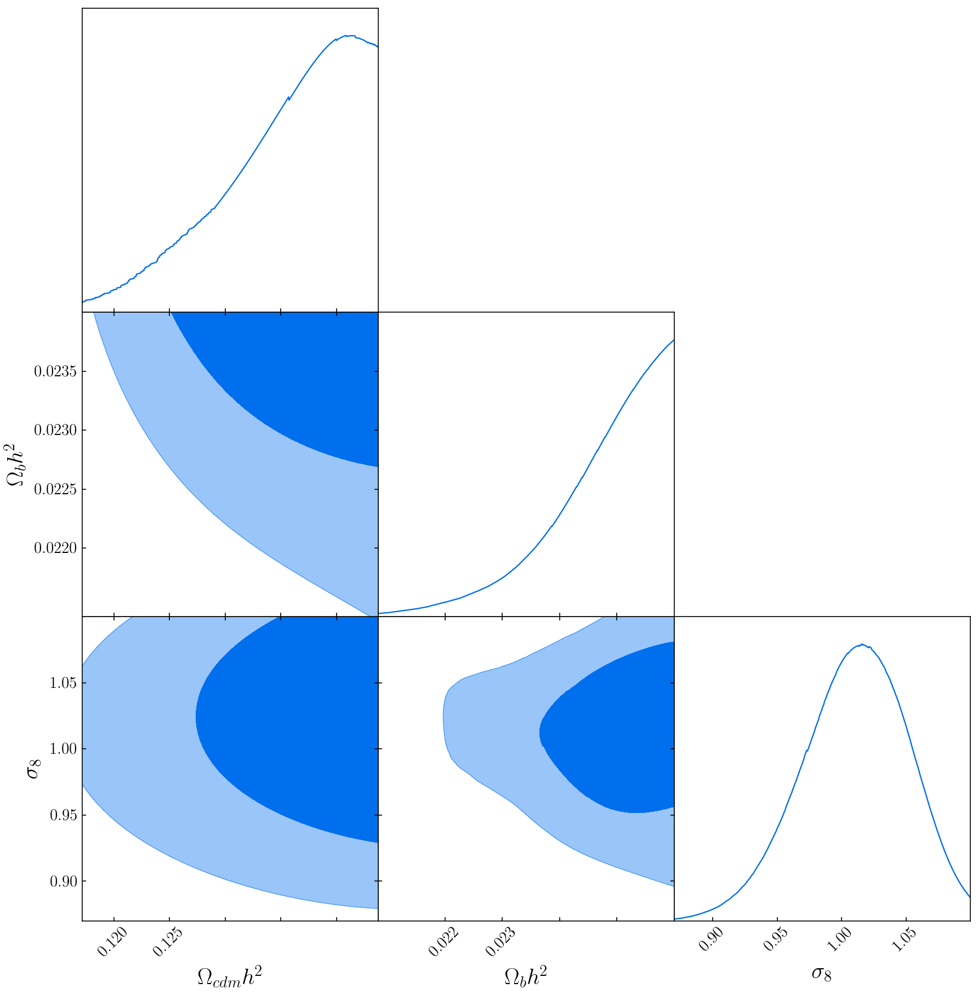

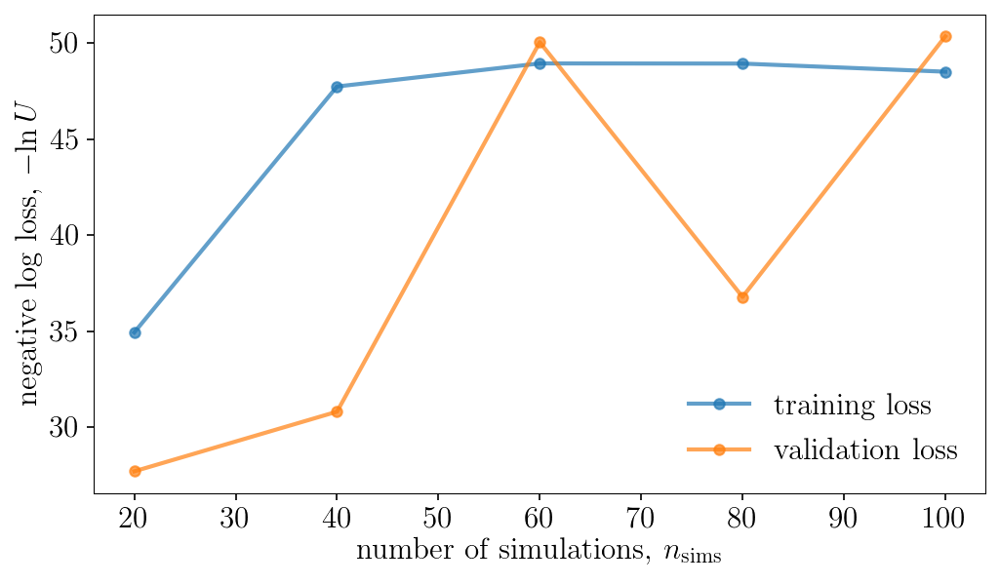

Population 6/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8128961190000155 s
total: 0.8138821449997522 s
total: 0.7941918850001457 s
total: 0.810566265000034 s
total: 0.7897482519997538 s
total: 0.7790061250002509 s
total: 0.7904181529997913 s
total: 0.7817154889999074 s
total: 0.7887291900001401 s
total: 0.7776075530000526 s
total: 0.7803388130000712 s
total: 0.7798222730002635 s
total: 0.7922243709999748 s
total: 0.7896510630002922 s
total: 0.7959470939999846 s
total: 0.7773149329996158 s
total: 0.7776453579999725 s
total: 0.8005587590000687 s
total: 0.7886550500002159 s
total: 0.7820571150000433 s


Sampling approximate posterior...
Done.
Removed no burn in


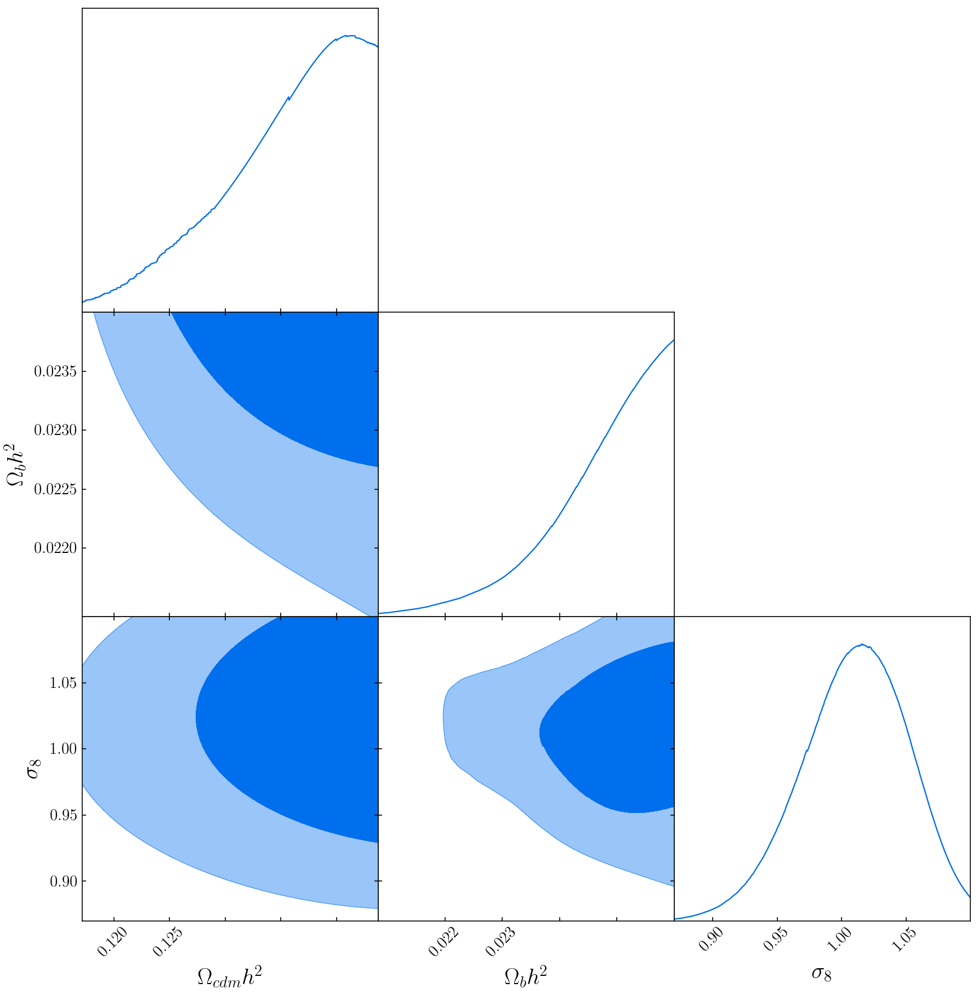

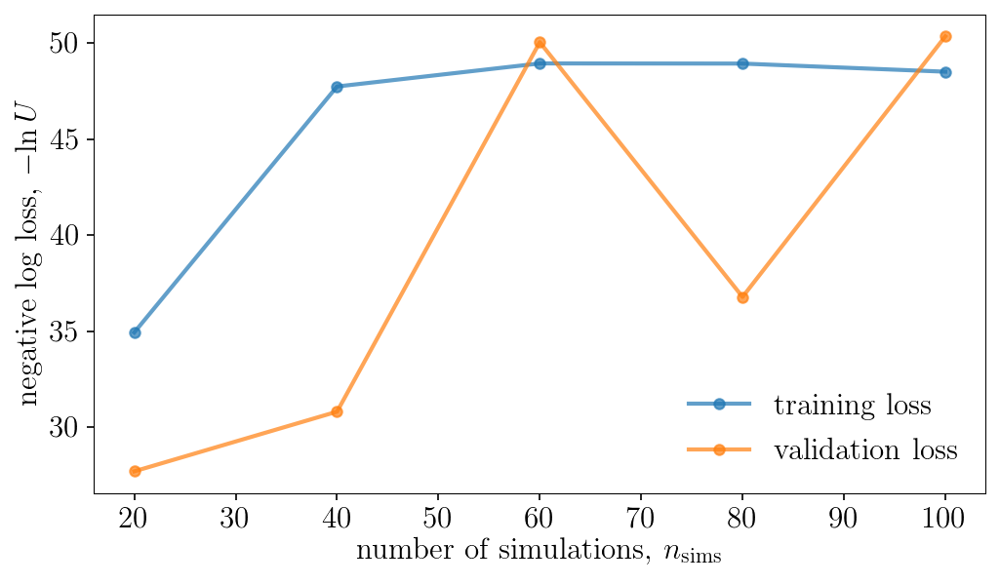

Population 7/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8245913020000444 s
total: 0.8211183779994826 s
total: 0.7876132860001235 s
total: 0.7898990929998035 s
total: 0.8004273560000001 s
total: 0.7943826670007184 s
total: 0.7994405760000518 s
total: 0.8000857710003402 s
total: 0.79140598199956 s
total: 0.7887087130002328 s
total: 0.7982875709994914 s
total: 0.7859659420000753 s
total: 0.802915438999662 s
total: 0.8036622949994126 s
total: 0.799692010000399 s
total: 0.7953520360006223 s
total: 0.7991708839999774 s
total: 0.7909759590002068 s
total: 0.7919391639998139 s
total: 0.8003900240000803 s


Sampling approximate posterior...
Done.
Removed no burn in


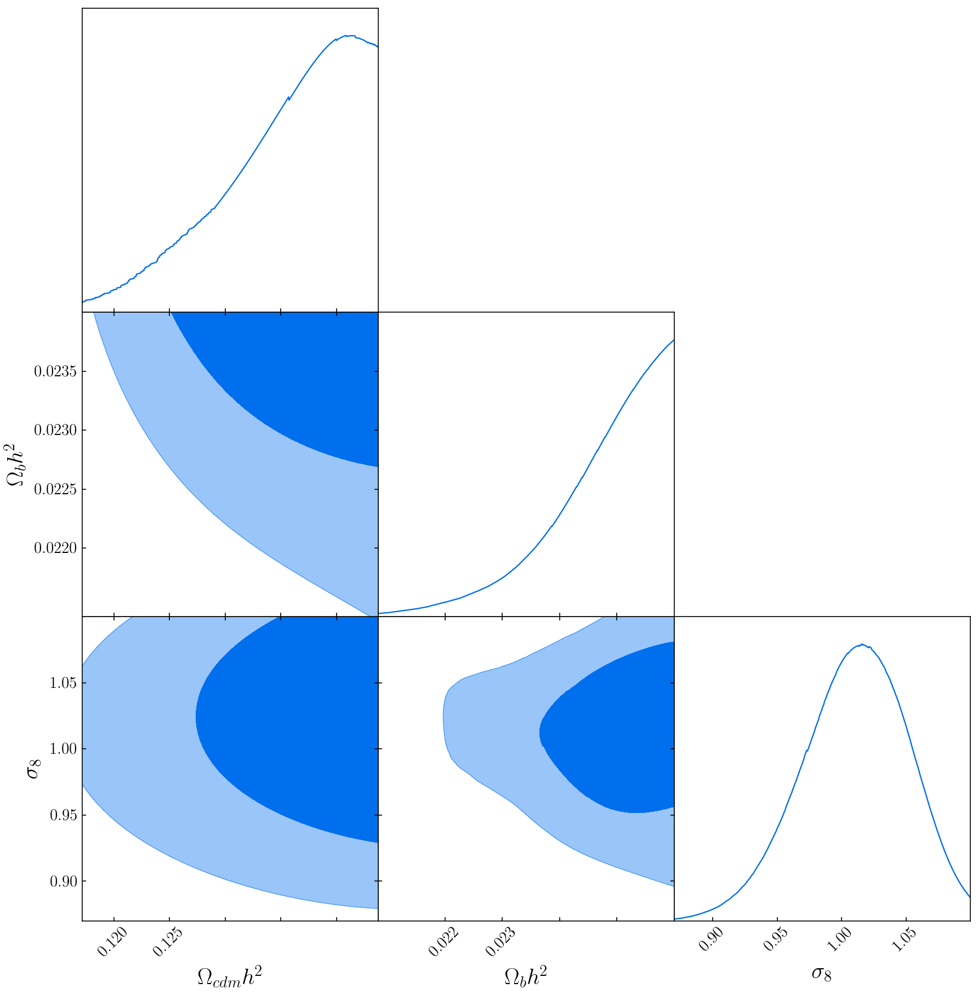

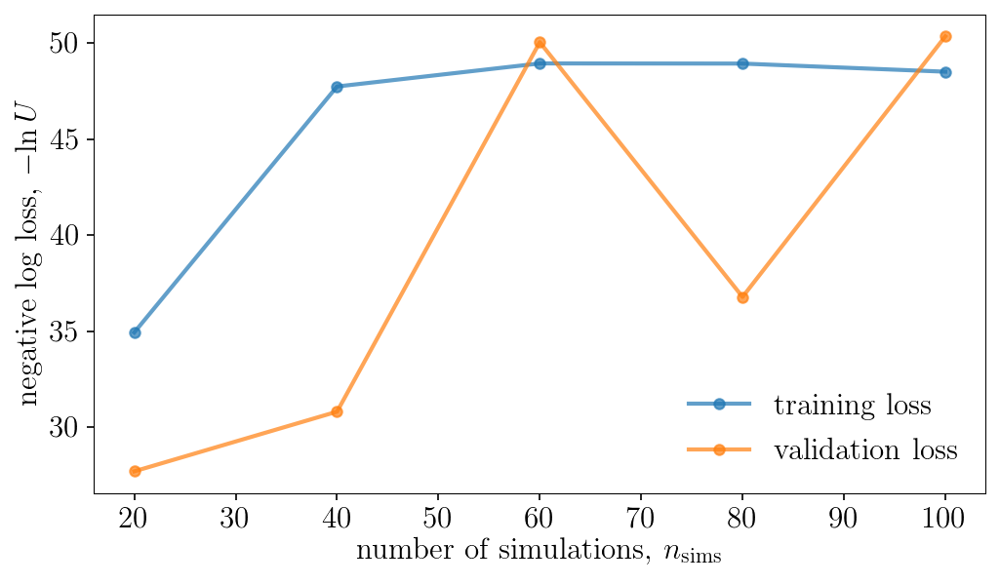

Population 8/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8612782390000575 s
total: 0.8474852619992816 s
total: 0.8128807950006376 s
total: 0.8087011999996321 s
total: 0.8310388359996068 s
total: 0.8231815310000457 s
total: 0.8080214809997415 s
total: 0.8130976030006423 s
total: 0.8443776539997998 s
total: 0.8405085440008406 s
total: 0.8119190840006922 s
total: 0.8020646220002163 s
total: 0.8125687069996275 s
total: 0.8103715609995561 s
total: 0.8092047690006439 s
total: 0.804754136000156 s
total: 0.8040307120008947 s
total: 0.8105857210002796 s
total: 0.8107176710000203 s
total: 0.8092860000006112 s


Sampling approximate posterior...
Done.
Removed no burn in


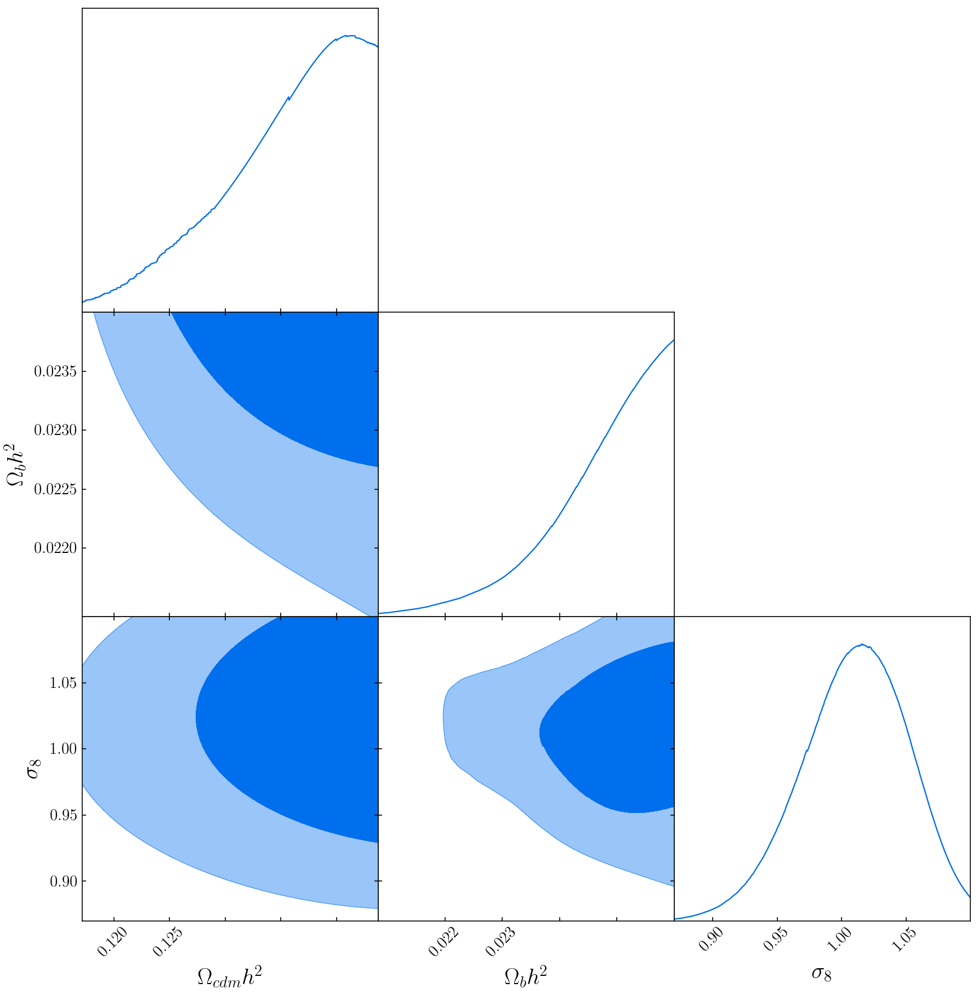

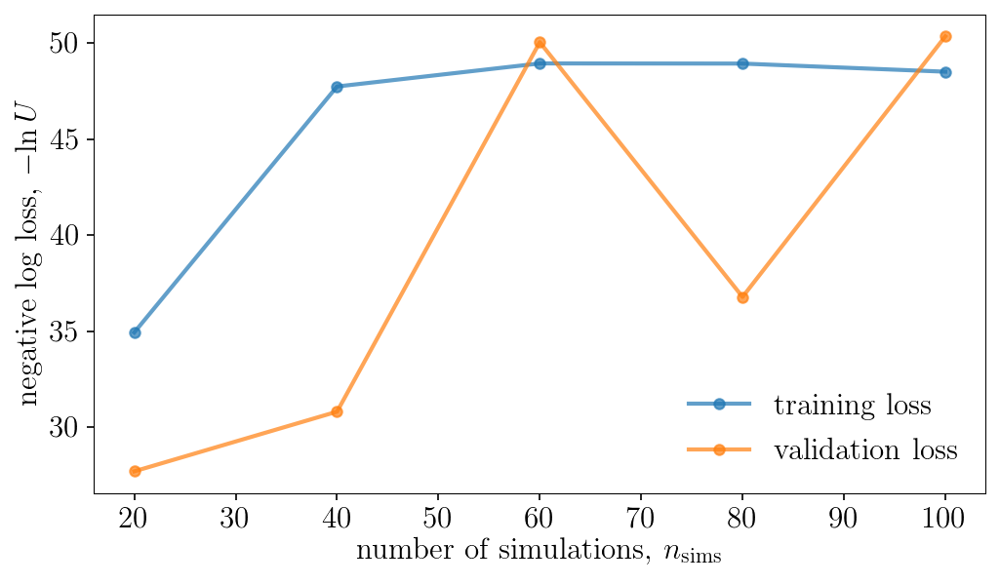

Population 9/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8281042010003148 s
total: 0.8158156939998662 s
total: 0.788344620999851 s
total: 0.7882946860008815 s
total: 0.7886220150003282 s
total: 0.7903931339997143 s
total: 0.7903882700002214 s
total: 0.7973018560005585 s
total: 0.7930868390003525 s
total: 0.7886692949996359 s
total: 0.7898321129996475 s
total: 0.7864886130000741 s
total: 0.8035785829997621 s
total: 0.7910559840001952 s
total: 0.7885879960003876 s
total: 0.7869279989999995 s
total: 0.7881464070005677 s
total: 0.8070095559996844 s
total: 0.7877701320003325 s
total: 0.786525901999994 s


Sampling approximate posterior...
Done.
Removed no burn in


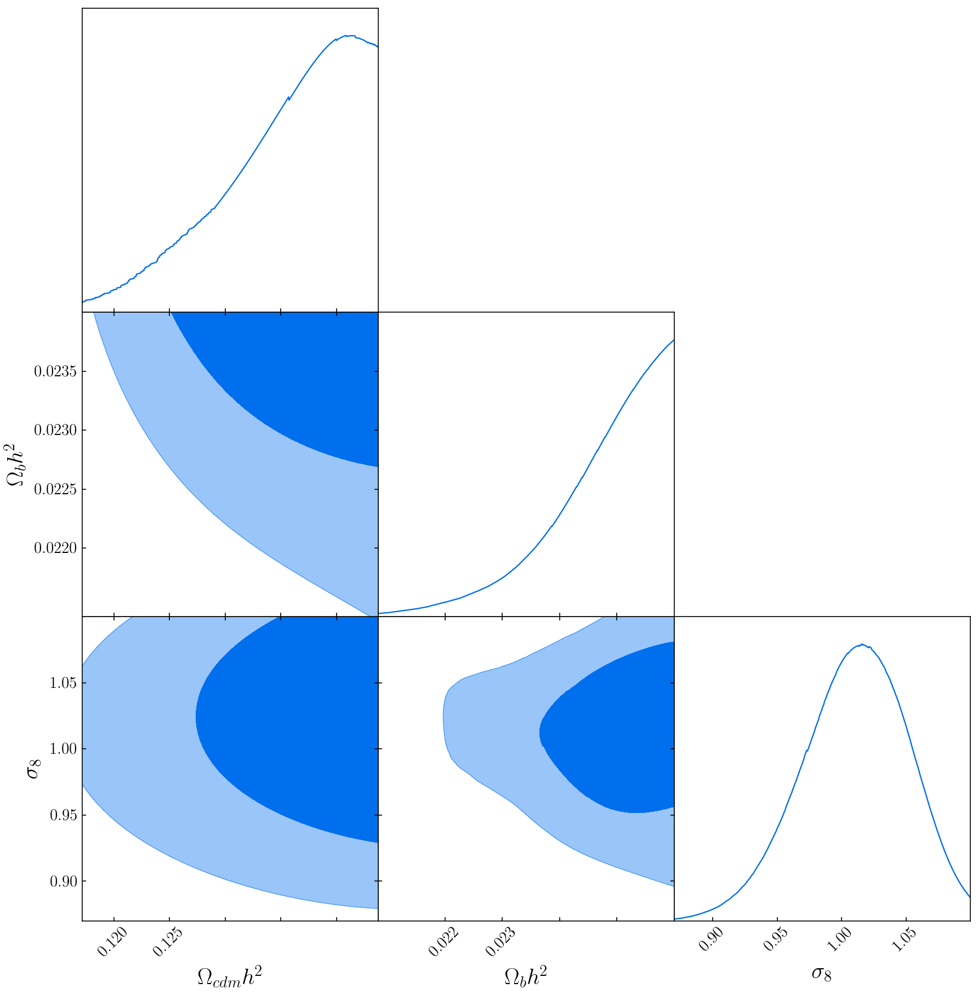

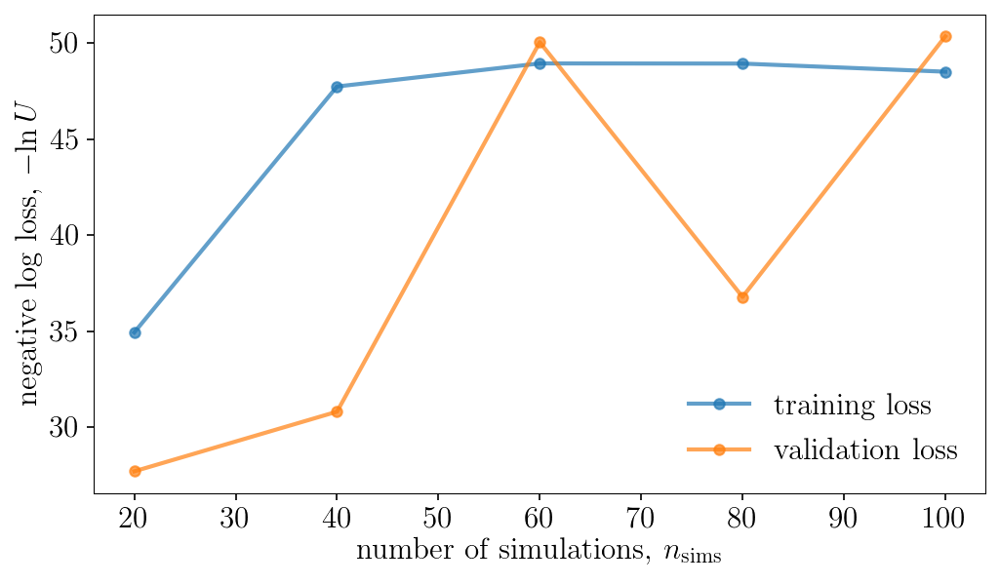

Population 10/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.831421416000012 s
total: 0.8010727339997175 s
total: 0.7855483880002794 s
total: 0.790587602999949 s
total: 0.7871471600001314 s
total: 0.7880110180003612 s
total: 0.7930976609995923 s
total: 0.7878885709997121 s
total: 0.7870438469999499 s
total: 0.7885274689997459 s
total: 0.7903445330002796 s
total: 0.7965394650000235 s
total: 0.7902950829993642 s
total: 0.7989224610000747 s
total: 0.7892007129994454 s
total: 0.794198642000083 s
total: 0.7866111980001733 s
total: 0.7922684619998108 s
total: 0.7871267589998752 s
total: 0.7873724739993122 s


Sampling approximate posterior...
Done.
Removed no burn in


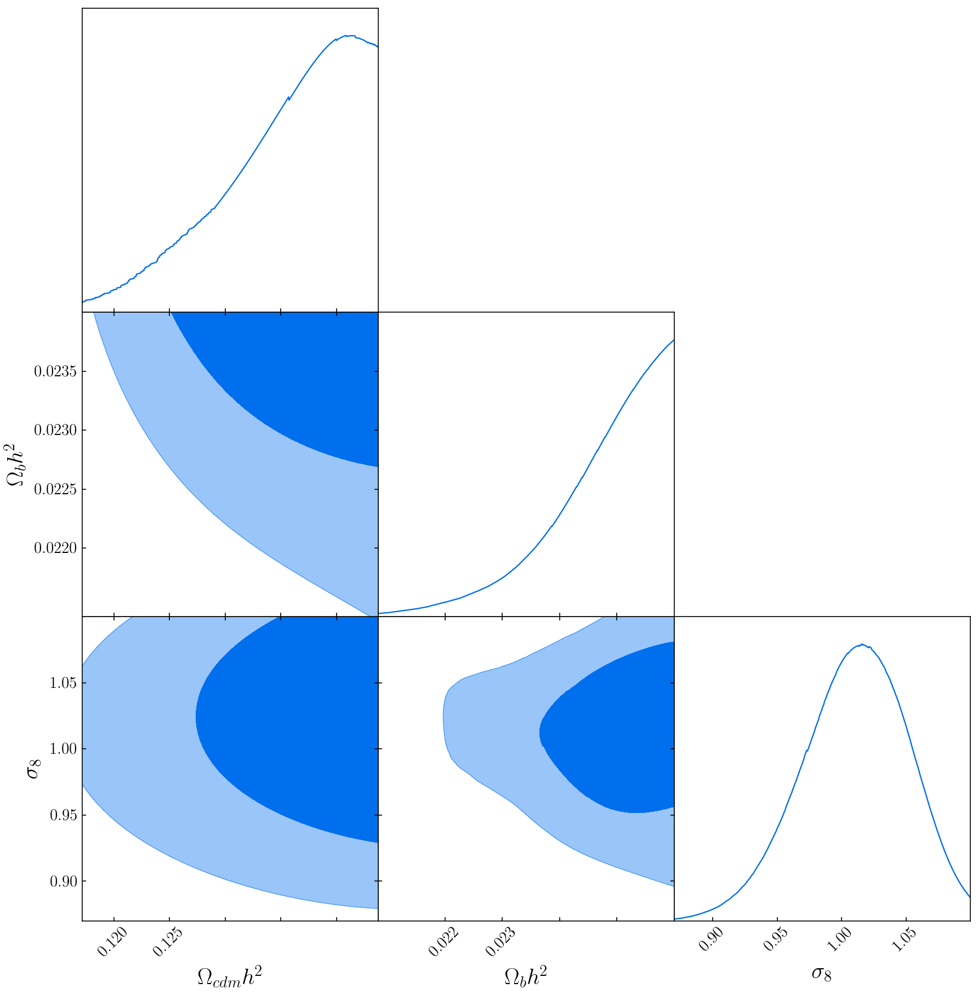

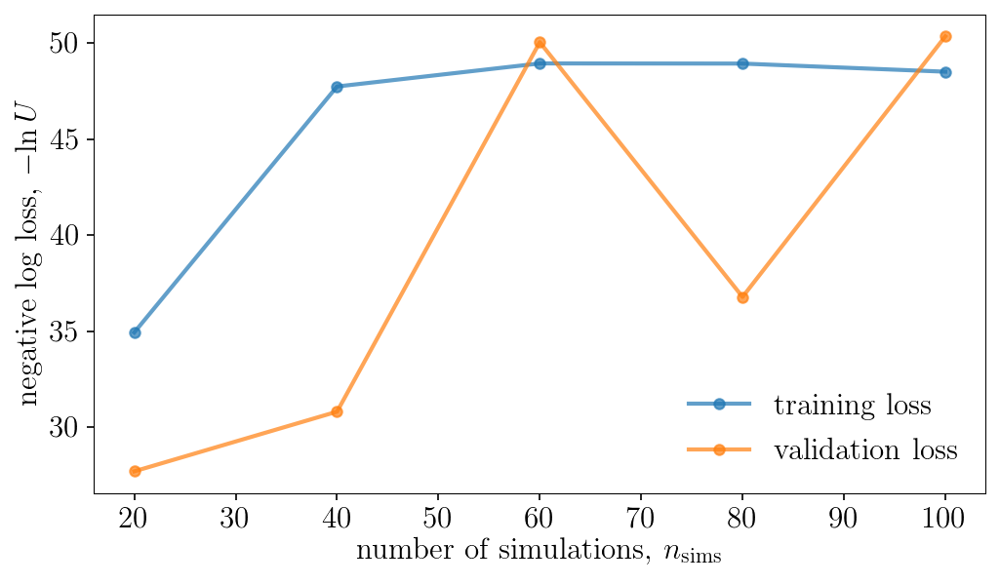

Population 11/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8622472690003633 s
total: 0.8501583520001077 s
total: 0.8066872469998998 s
total: 0.8133236359999501 s
total: 0.8384158019998722 s
total: 0.8052508439996018 s
total: 0.808987810999497 s
total: 0.8083226250000735 s
total: 0.8109482500003651 s
total: 0.8156157419998635 s
total: 0.8058412520003913 s
total: 0.8066169980002087 s
total: 0.8086360990000685 s
total: 0.8067552229995272 s
total: 0.8109870680000313 s
total: 0.8081840059994647 s
total: 0.8203999950001162 s
total: 0.8074709269994855 s
total: 0.81112483600009 s
total: 0.8075464910007213 s


Sampling approximate posterior...
Done.
Removed no burn in


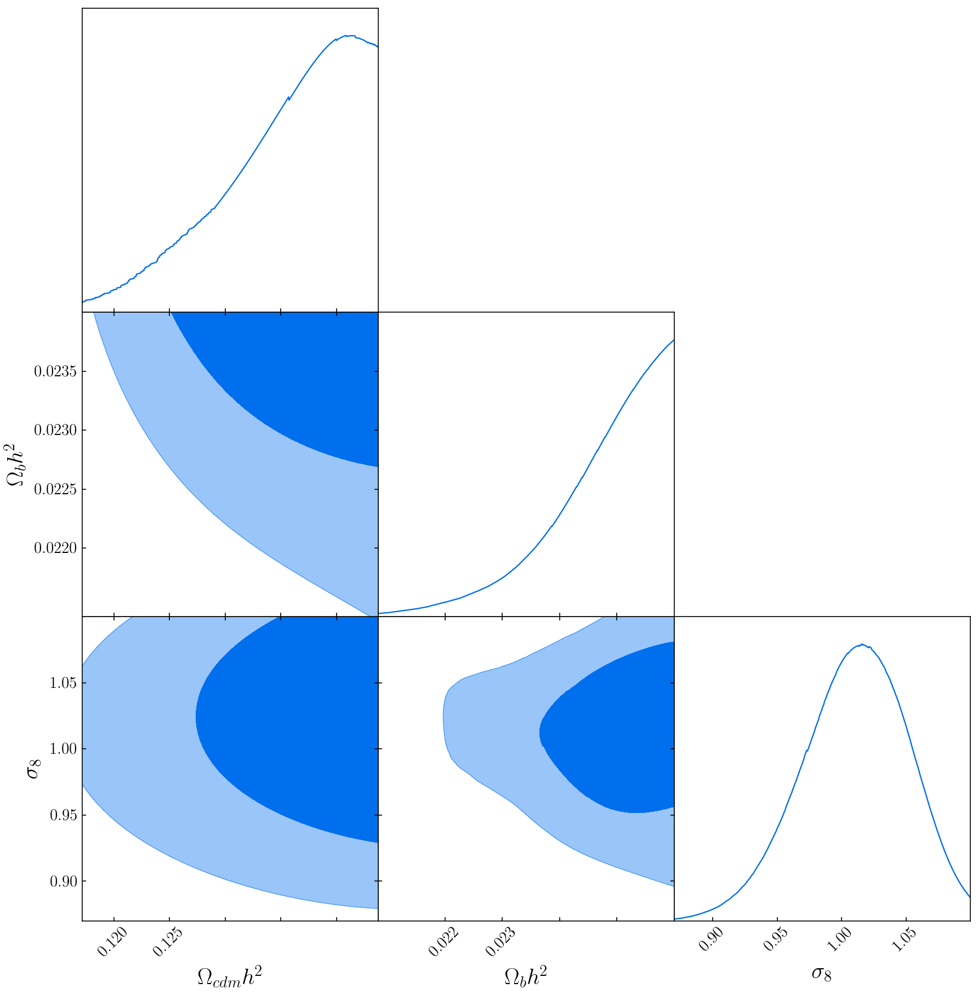

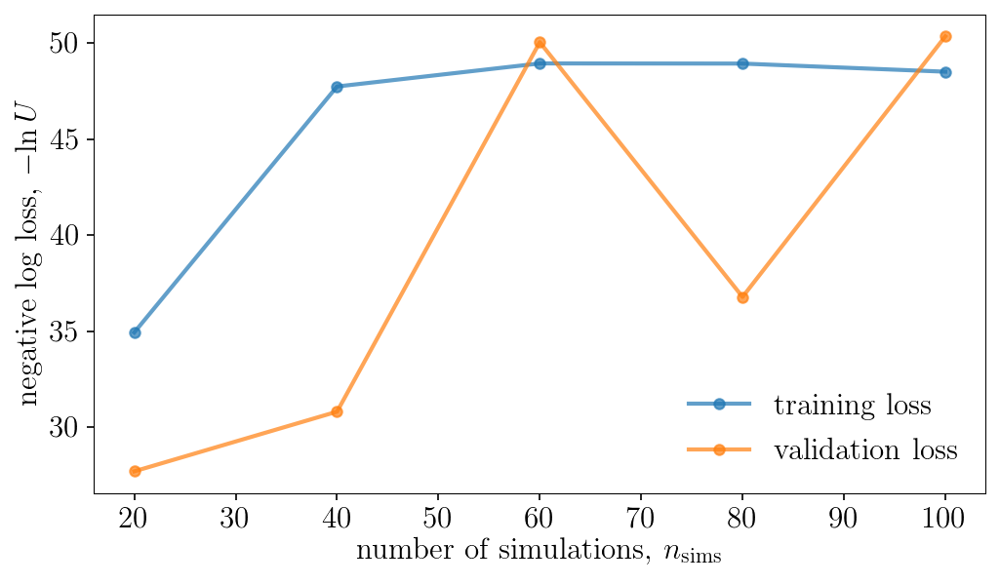

Population 12/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8559174020001592 s
total: 0.7932446739996522 s
total: 0.7888021230000959 s
total: 0.8181755599998723 s
total: 0.7961360529998274 s
total: 0.815435274000265 s
total: 0.8075518650002778 s
total: 0.7915350270004637 s
total: 0.7948126179999235 s
total: 0.8128440070004217 s
total: 0.8031195769999613 s
total: 0.8143517340004109 s
total: 0.7922355539994896 s
total: 0.792546322999442 s
total: 0.7890425219993631 s
total: 0.7895555579998472 s
total: 0.793239843000265 s
total: 0.8124273409994203 s
total: 0.803642602999389 s
total: 0.8078950640001494 s


Sampling approximate posterior...
Done.
Removed no burn in


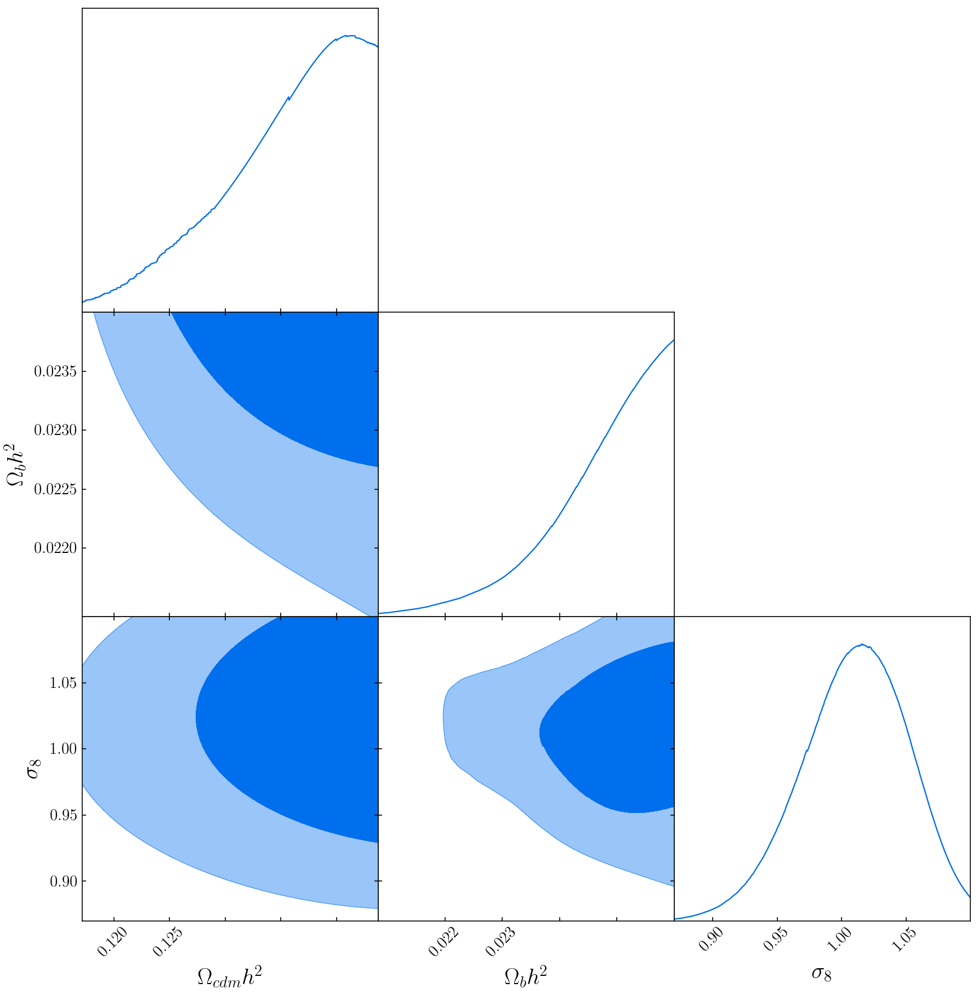

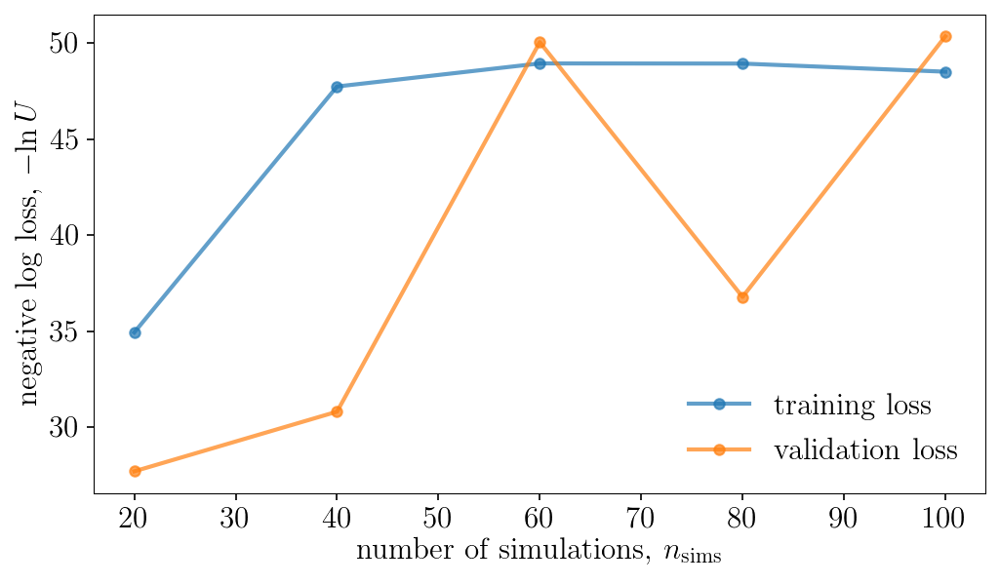

Population 13/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8369979600001898 s
total: 0.7890103579993593 s
total: 0.7943032819994187 s
total: 0.7778232479995495 s
total: 0.7870875150001666 s
total: 0.7921792810002444 s
total: 0.8080990930002372 s
total: 0.786936257999514 s
total: 0.8056923379999716 s
total: 0.776507627000683 s
total: 0.8109550769995622 s
total: 0.7907024500000261 s
total: 0.81025938699986 s
total: 0.780933076999645 s
total: 0.8046357069997612 s
total: 0.7896270920000461 s
total: 0.7882720359993982 s
total: 0.7800322819994108 s
total: 0.8085303219995694 s
total: 0.7761849919997985 s


Sampling approximate posterior...
Done.
Removed no burn in


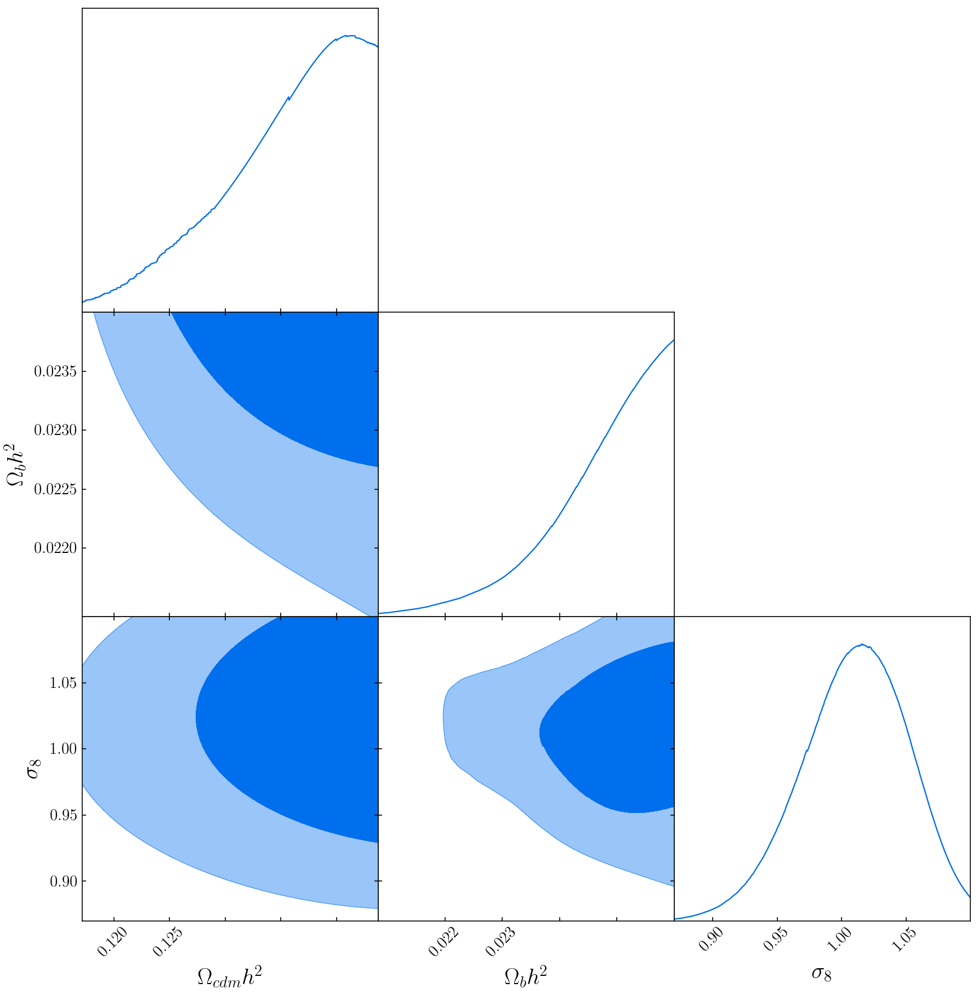

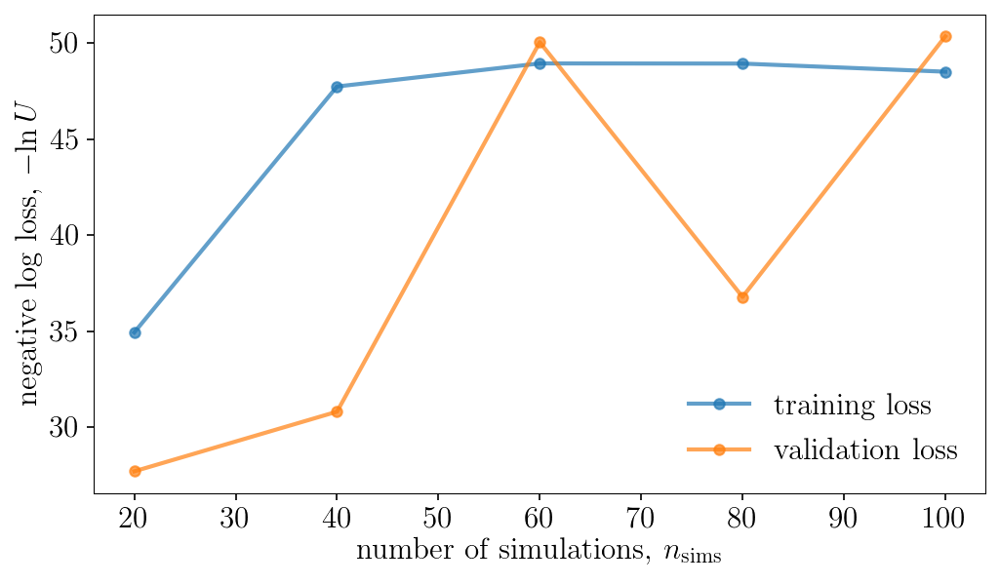

Population 14/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8479071090005164 s
total: 0.8428615299999365 s
total: 0.8264199699997334 s
total: 0.793201200999647 s
total: 0.7873487520000708 s
total: 0.798078648000228 s
total: 0.7854236310004126 s
total: 0.7911285820000558 s
total: 0.7844037390004814 s
total: 0.7880602149998595 s
total: 0.7861843020000379 s
total: 0.8078884649994507 s
total: 0.7863476619995708 s
total: 0.8134420870001122 s
total: 0.8051575199997387 s
total: 0.7883211449998271 s
total: 0.8163711229999535 s
total: 0.8116444899997077 s
total: 0.7868296570004532 s
total: 0.8209975469999335 s


Sampling approximate posterior...
Done.
Removed no burn in


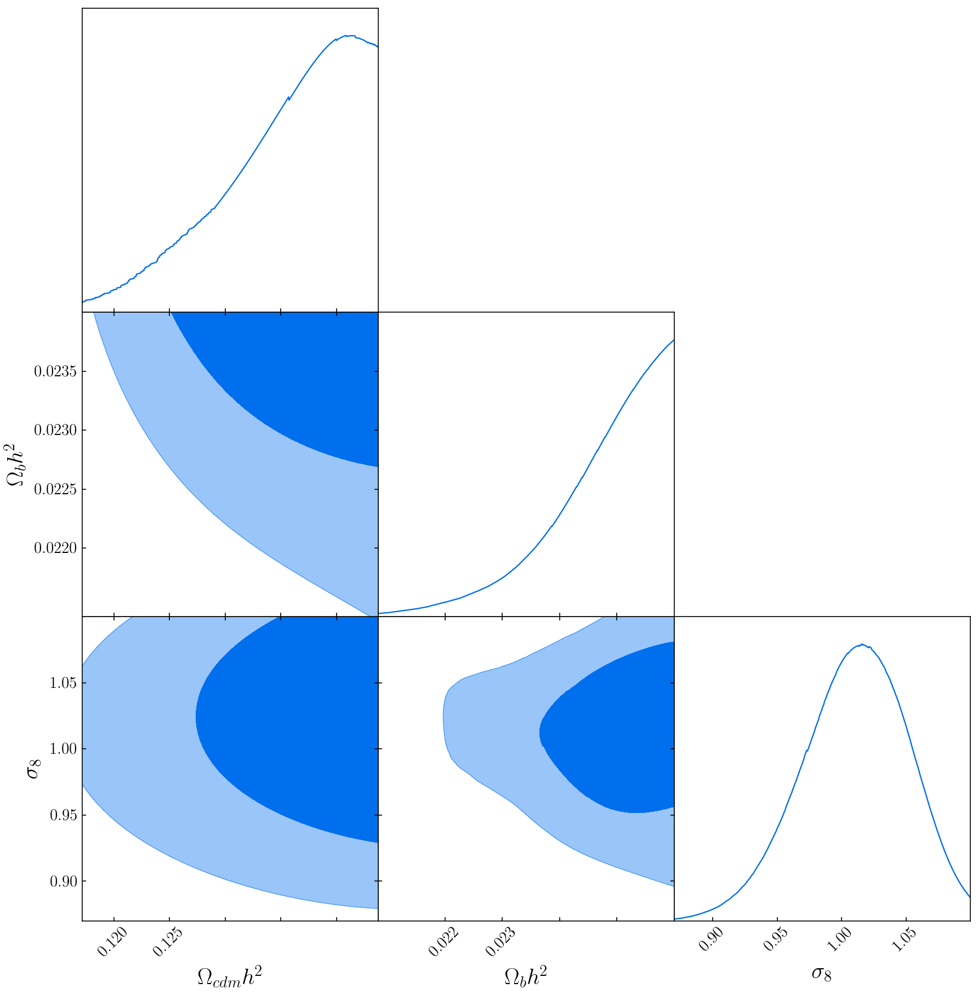

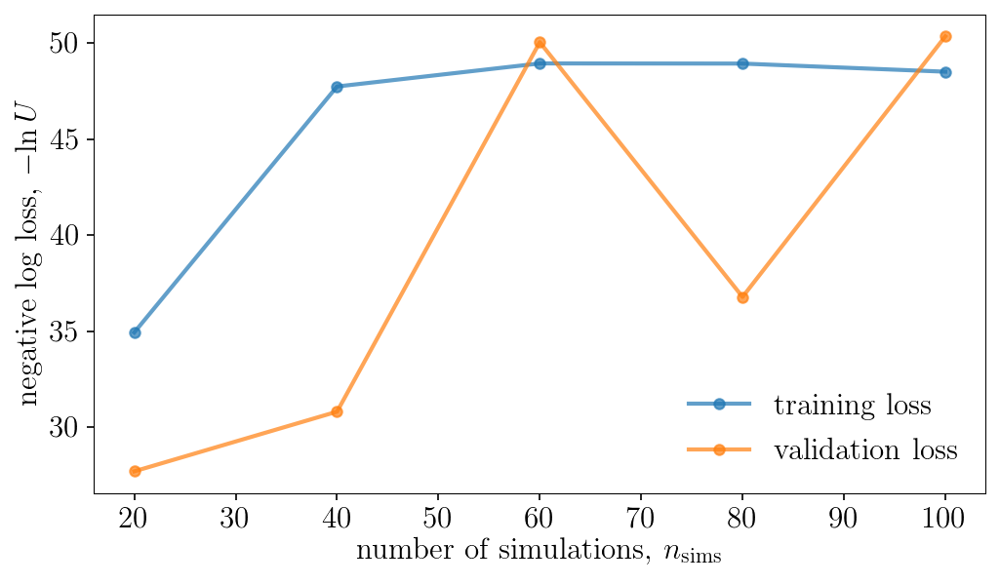

Population 15/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8276715240008343 s
total: 0.8217716700000892 s
total: 0.7828319849995751 s
total: 0.7859862670011353 s
total: 0.7864706069995009 s
total: 0.8008963159991254 s
total: 0.7844738519997918 s
total: 0.7884525680001389 s
total: 0.797033601998919 s
total: 0.7965555920000043 s
total: 0.790573136000603 s
total: 0.7862988159995439 s
total: 0.7888696729987714 s
total: 0.7847283129995049 s
total: 0.7825076010012708 s
total: 0.802193826999428 s
total: 0.8030010200000106 s
total: 0.7942728510006418 s
total: 0.7819083829999727 s
total: 0.7917825339991396 s


Sampling approximate posterior...
Done.
Removed no burn in


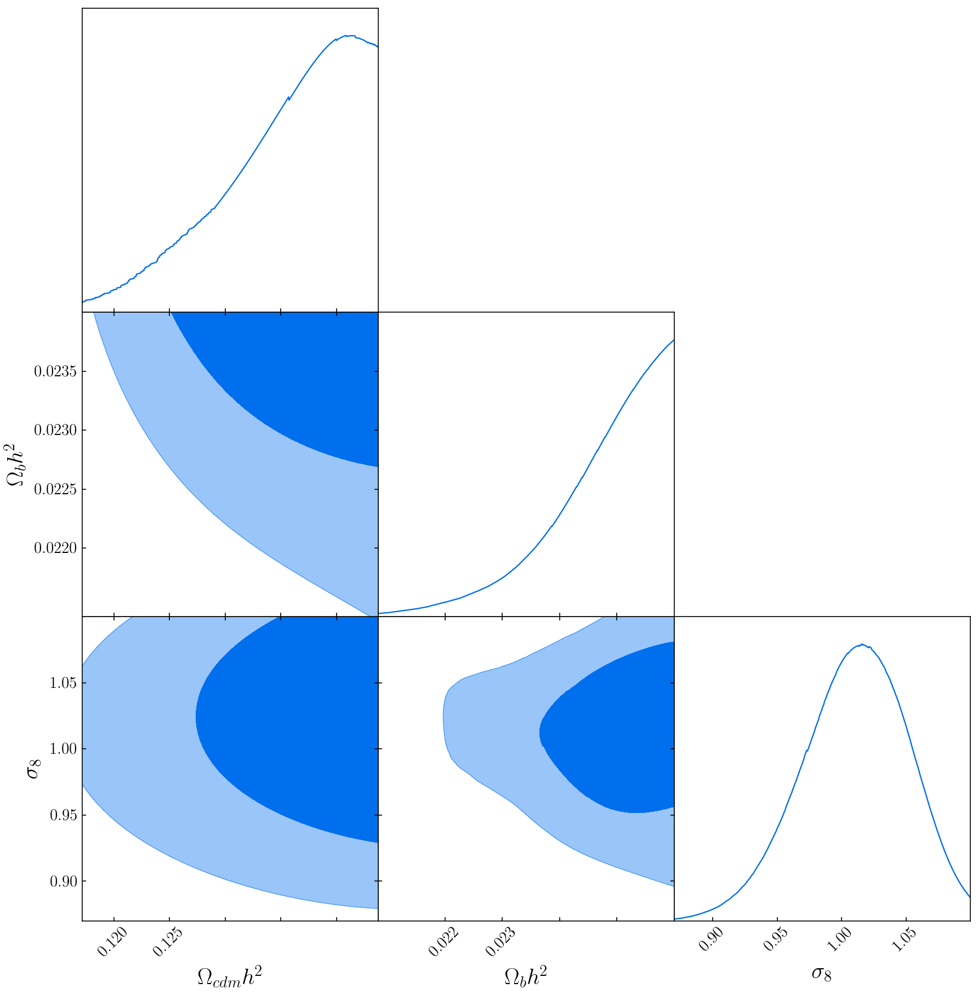

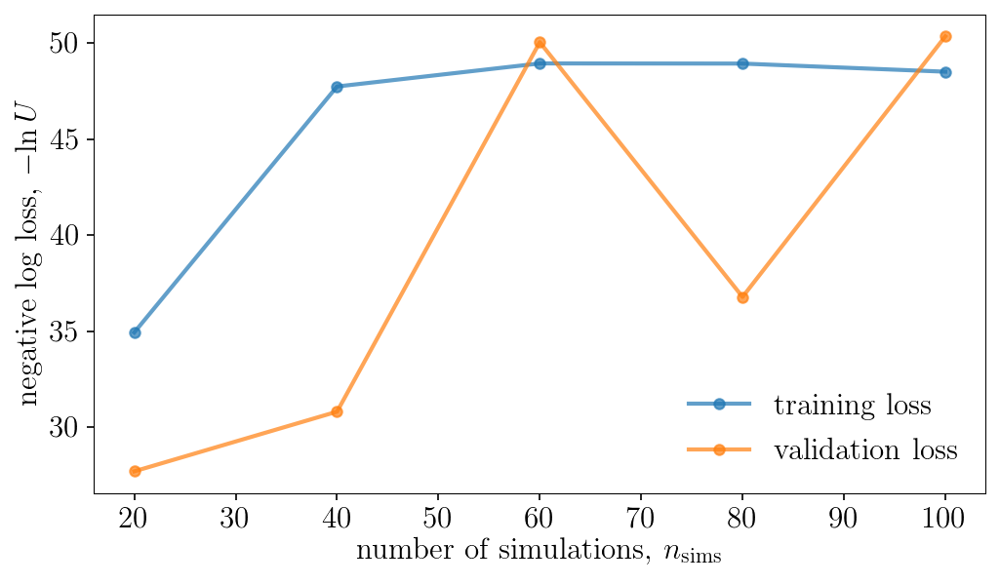

Population 16/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.7930935669992323 s
total: 0.7857680729994172 s
total: 0.7827689229998214 s
total: 0.804762796000432 s
total: 0.7888703560001886 s
total: 0.8035231909998402 s
total: 0.8102992170006473 s
total: 0.792593042999215 s
total: 0.8157704380009818 s
total: 0.7846251240007405 s
total: 0.7814653929999622 s
total: 0.8020404039998539 s
total: 0.7876833640002587 s
total: 0.8058542750004563 s
total: 0.8118878549994406 s
total: 0.8021511409988307 s
total: 0.7983343639989471 s
total: 0.8109834259994386 s
total: 0.7999318099991797 s
total: 0.7987649170008808 s


Sampling approximate posterior...
Done.
Removed no burn in


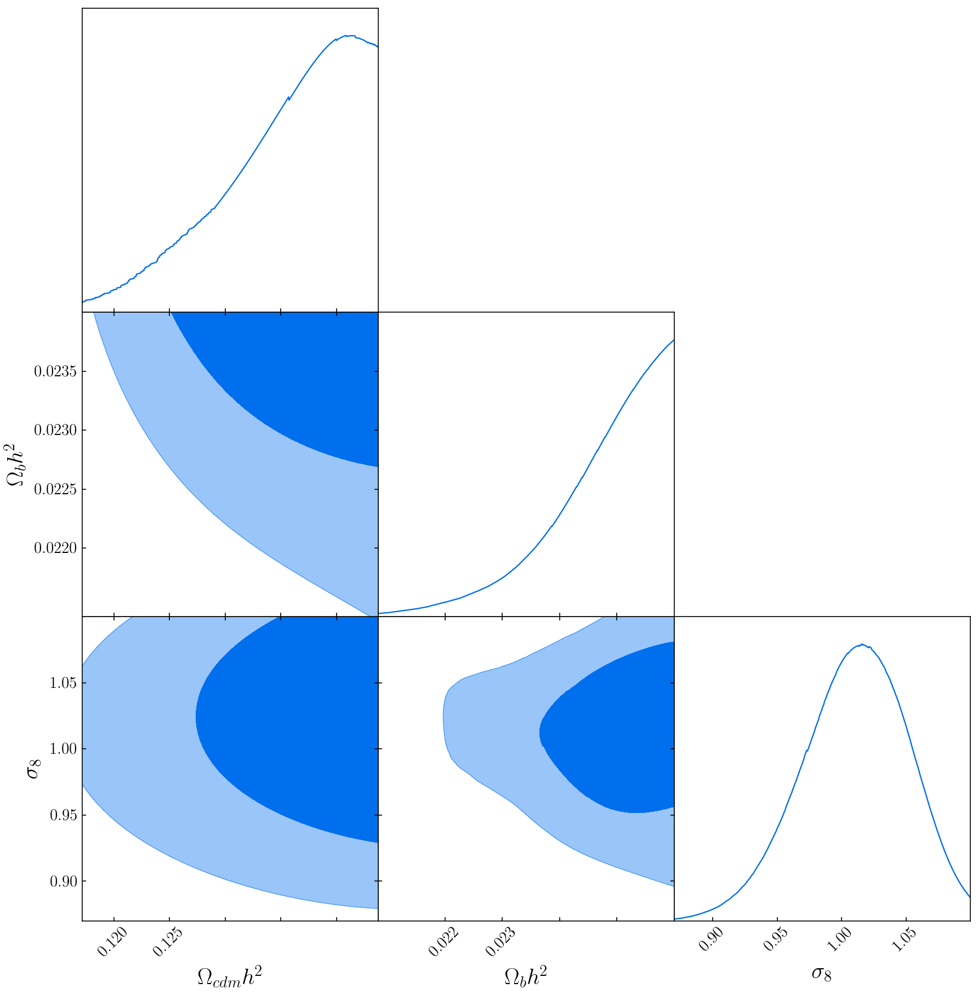

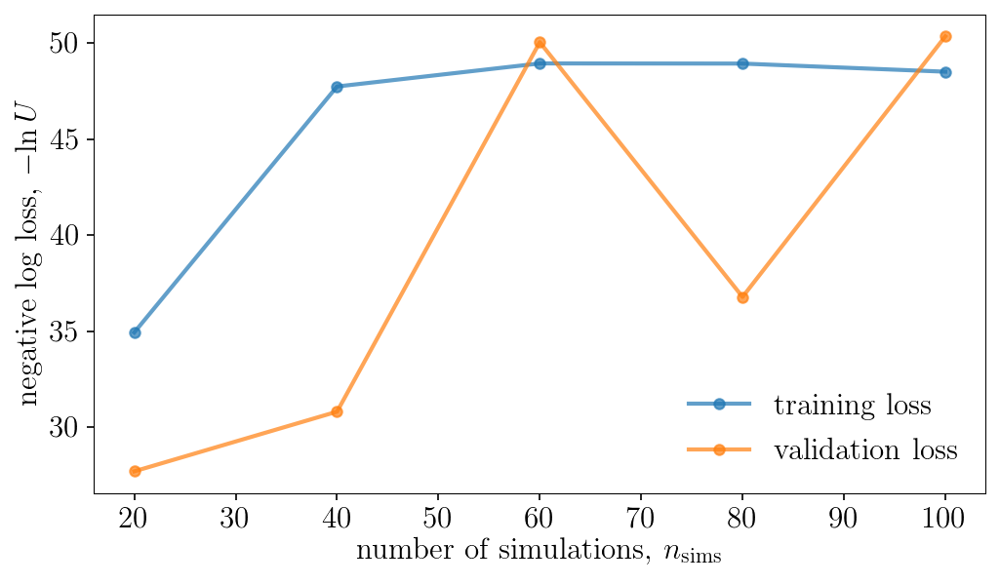

Population 17/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.7918034140002419 s
total: 0.783631427999353 s
total: 0.7784569390005345 s
total: 0.7830842769999435 s
total: 0.7853564779998123 s
total: 0.7755671679988154 s
total: 0.7816635500003031 s
total: 0.7816527240011055 s
total: 0.7831852969993633 s
total: 0.7834379710002395 s
total: 0.7937605970000732 s
total: 0.7762092880002456 s
total: 0.7795393680007692 s
total: 0.7847149970002647 s
total: 0.7788042989996029 s
total: 0.7845395719996304 s
total: 0.7854736889985361 s
total: 0.7807073929998296 s
total: 0.7837973940004304 s
total: 0.7799993919998087 s


Sampling approximate posterior...
Done.
Removed no burn in


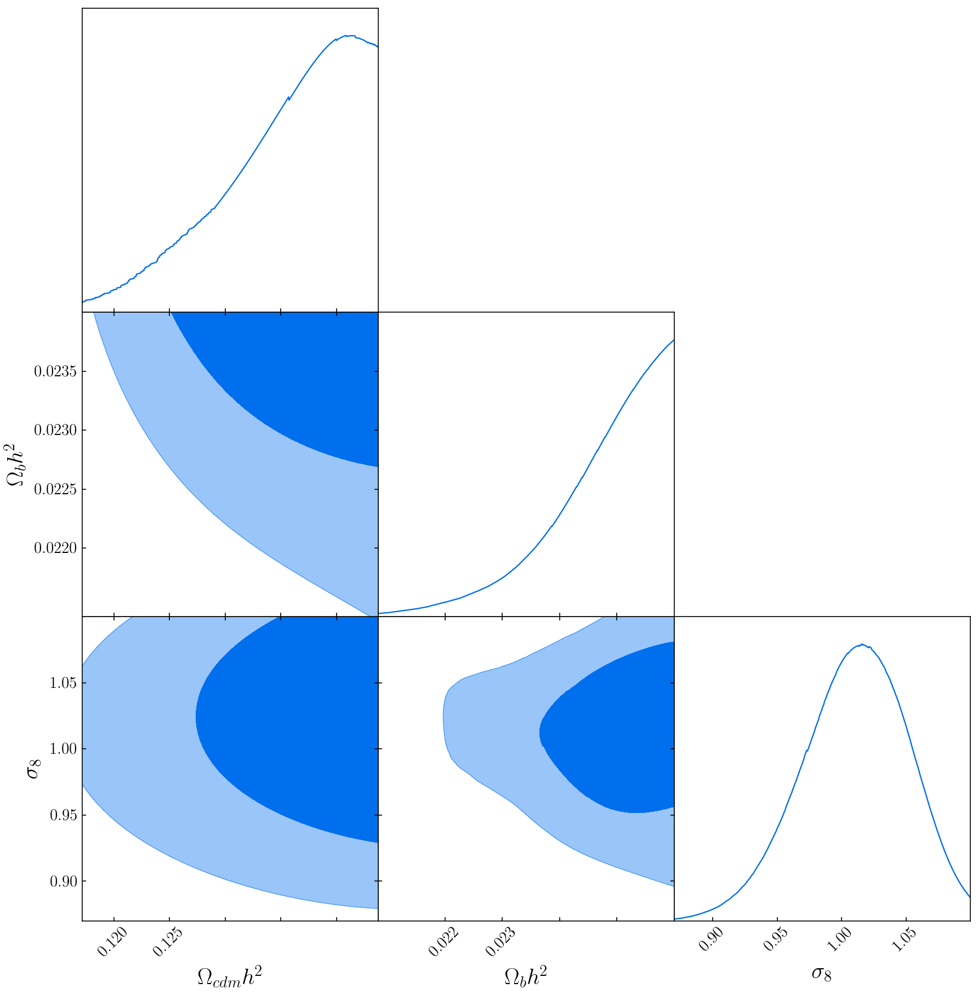

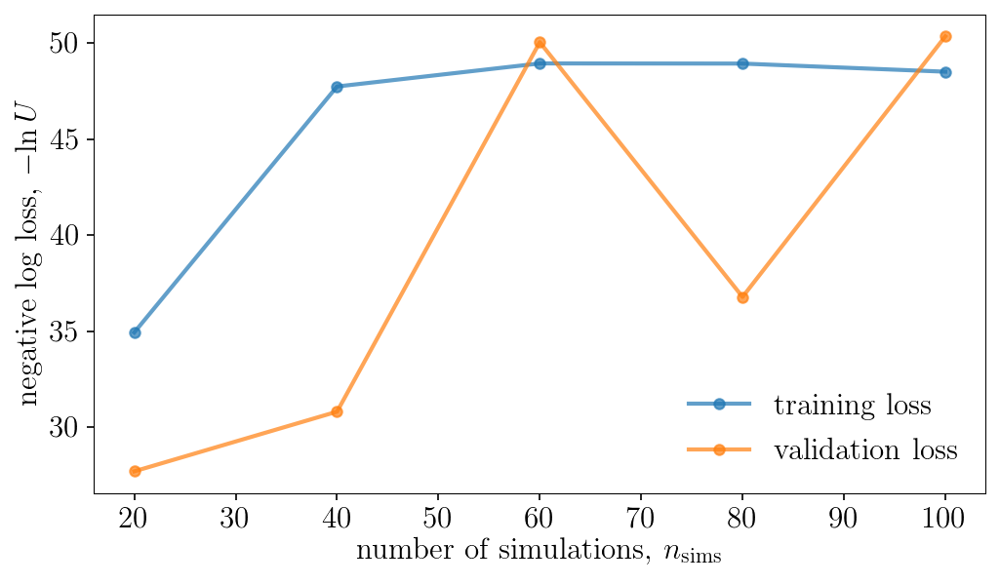

Population 18/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8011724409989256 s
total: 0.7842332199998054 s
total: 0.7790468020011758 s
total: 0.7824375670006702 s
total: 0.7771492680003576 s
total: 0.7760350549997383 s
total: 0.8081501809992915 s
total: 0.7817124029988918 s
total: 0.7804320380000718 s
total: 0.7889152230000036 s
total: 0.7840937940000003 s
total: 0.779890081999838 s
total: 0.7890742870004033 s
total: 0.7742504779998853 s
total: 0.7795750219993351 s
total: 0.7834922950005421 s
total: 0.7796096620004391 s
total: 0.783686837001369 s
total: 0.7843468909995863 s
total: 0.7958293050014618 s


Sampling approximate posterior...
Done.
Removed no burn in


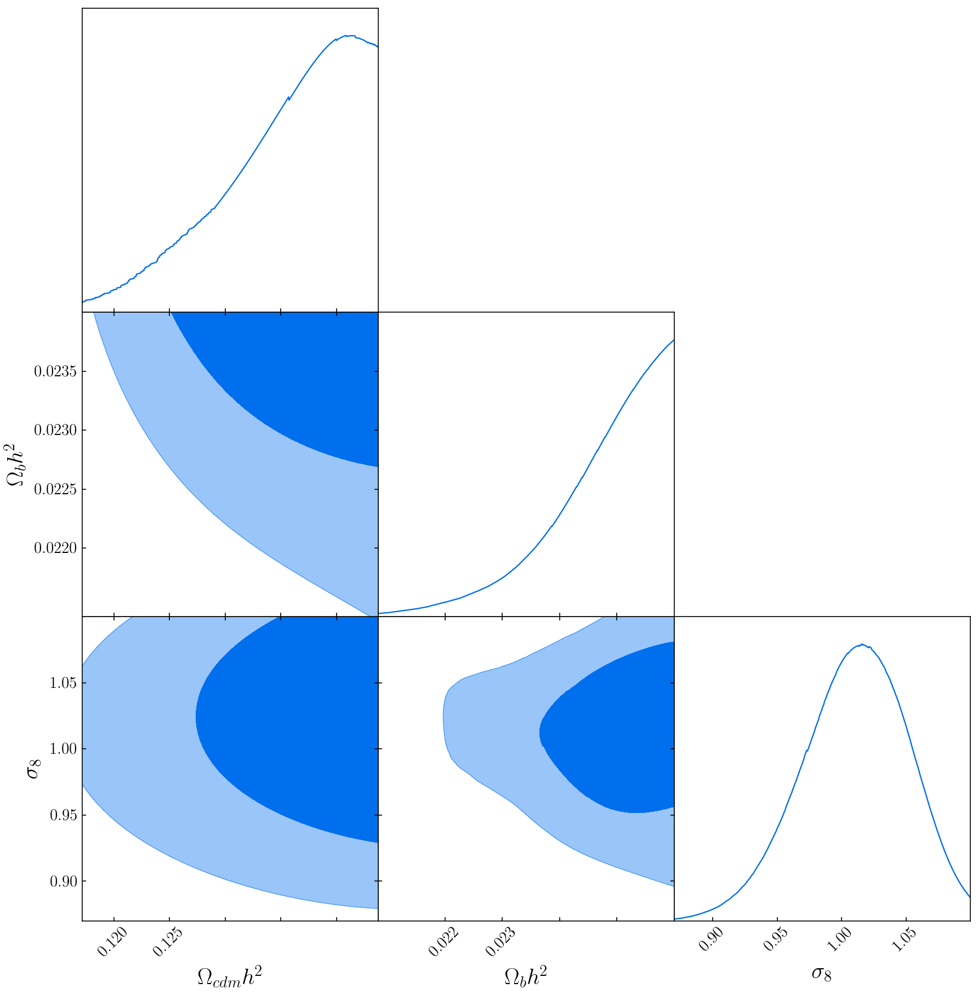

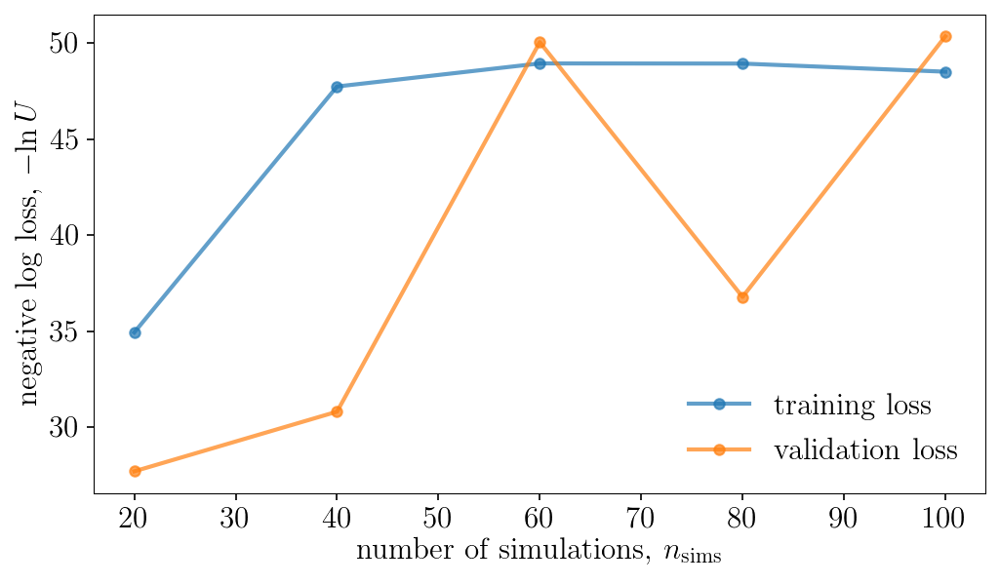

Population 19/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.828881444000217 s
total: 0.7951134979994094 s
total: 0.776623028999893 s
total: 0.776521978999881 s
total: 0.7798559139991994 s
total: 0.8033361790003255 s
total: 0.7799090070002421 s
total: 0.7752097820011841 s
total: 0.7724869899993791 s
total: 0.7770779090005817 s
total: 0.7741451999991114 s
total: 0.7708147969988204 s
total: 0.7768727709990344 s
total: 0.7732724680008687 s
total: 0.7707255850000365 s
total: 0.7788137089992233 s
total: 0.7710910779987898 s
total: 0.7738148860007641 s
total: 0.7807399169996643 s
total: 0.7738547019998805 s


Sampling approximate posterior...
Done.
Removed no burn in


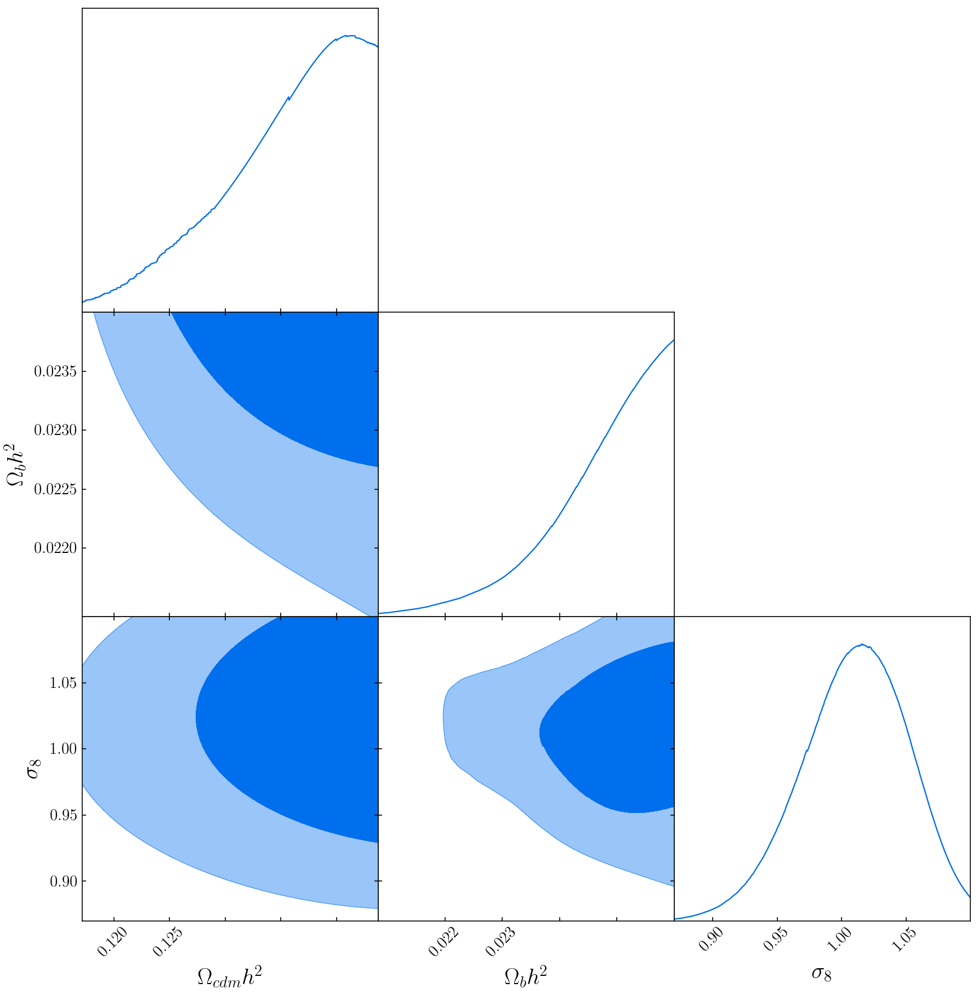

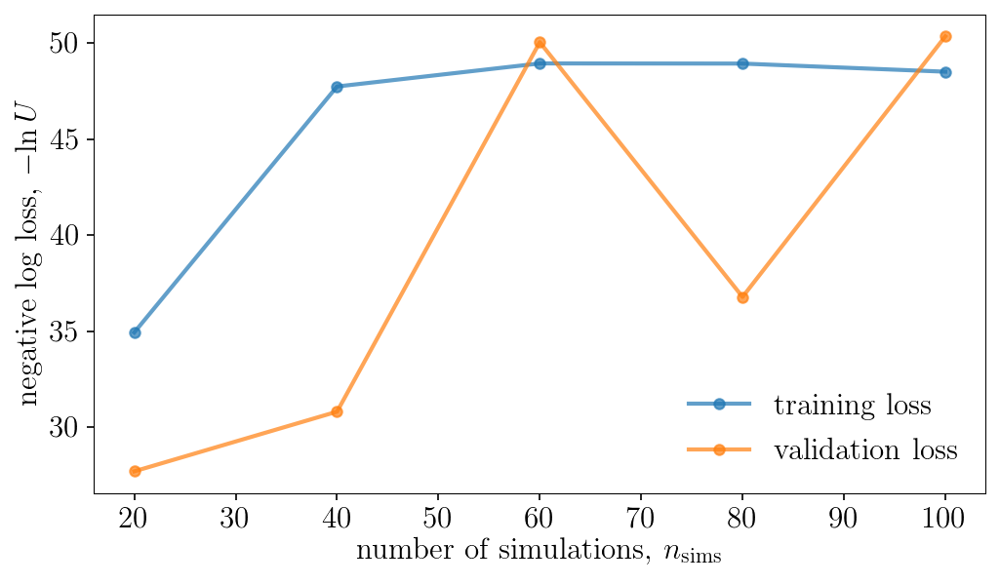

Population 20/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.7877163739995012 s
total: 0.7984357869991072 s
total: 0.7831374209999922 s
total: 0.7825634109995008 s
total: 0.7854570630006492 s
total: 0.7931925039993075 s
total: 0.7777160000005097 s
total: 0.7868873299994448 s
total: 0.7998140279996733 s
total: 0.7827359060011077 s
total: 0.7839780650010653 s
total: 0.7896132499990927 s
total: 0.7853422930002125 s
total: 0.7946228410000913 s
total: 0.7810134049996122 s
total: 0.8088176990004285 s
total: 0.7802161380004691 s
total: 0.7917634479999833 s
total: 0.7801473749987053 s
total: 0.7841734339999675 s


Sampling approximate posterior...
Done.
Removed no burn in


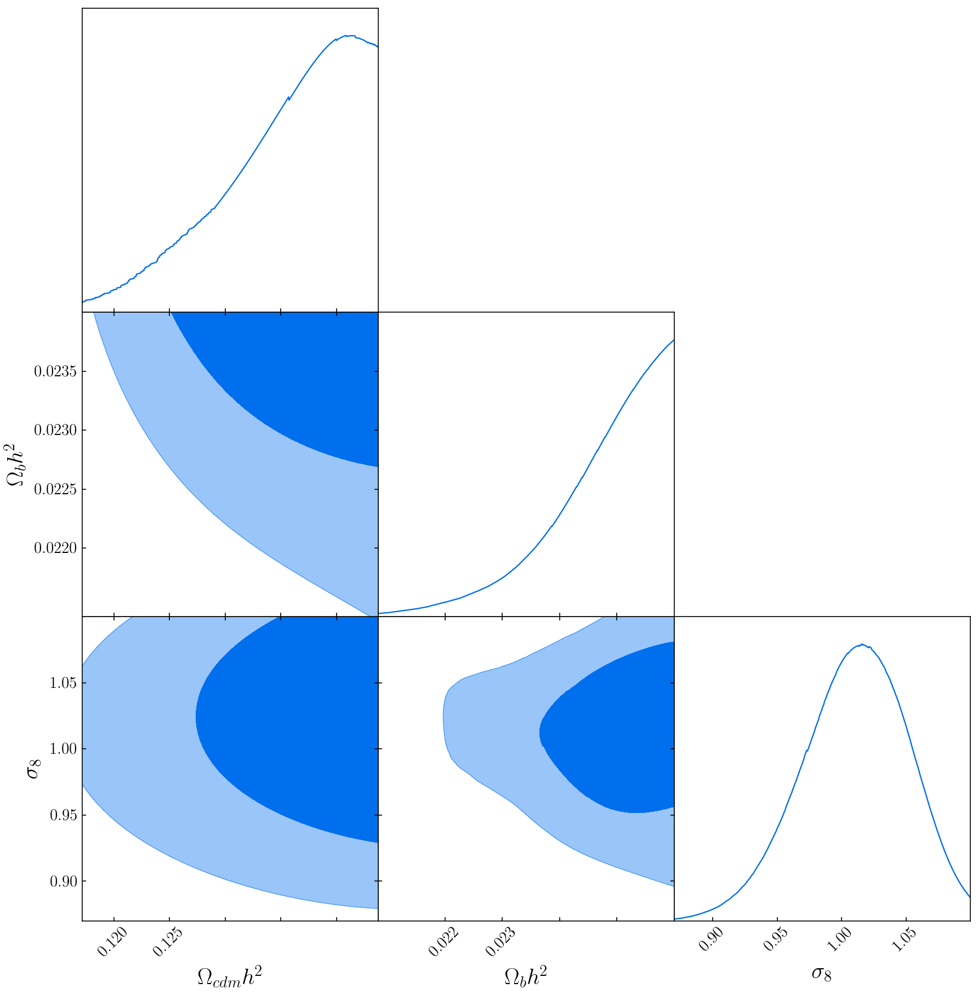

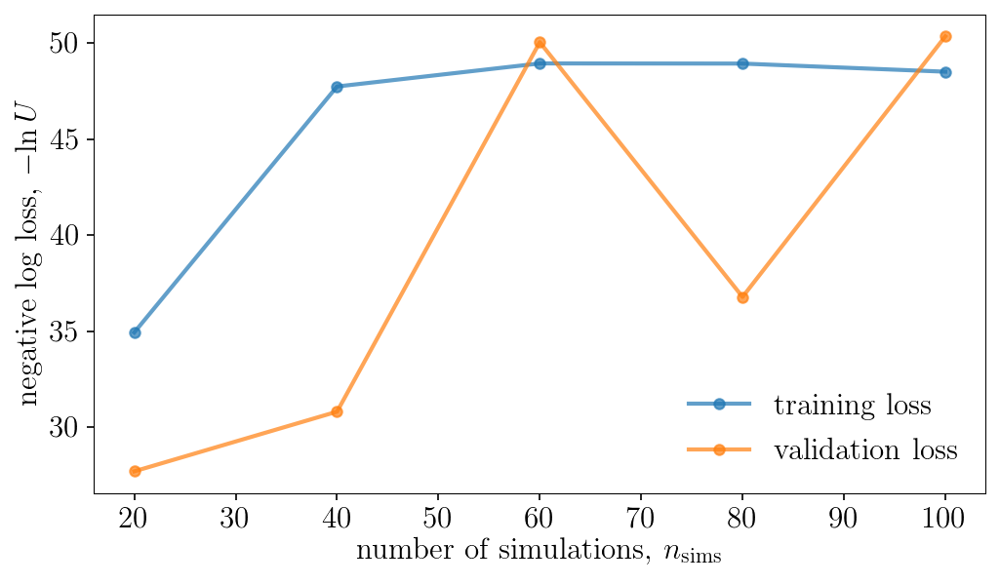

Population 21/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8264246329999878 s
total: 0.8030356160015799 s
total: 0.8074118830008956 s
total: 0.8001838350010075 s
total: 0.7985598510003911 s
total: 0.8059755989997939 s
total: 0.8352029339985165 s
total: 0.8053656960000808 s
total: 0.8026282410010026 s
total: 0.799796946999777 s
total: 0.7980468449986802 s
total: 0.8006378970003425 s
total: 0.8088224769999215 s
total: 0.8096442550013307 s
total: 0.8260552979991189 s
total: 0.8145286090002628 s
total: 0.7998567149988958 s
total: 0.7990182159992401 s
total: 0.8021646920005878 s
total: 0.8034333780015004 s


Sampling approximate posterior...
Done.
Removed no burn in


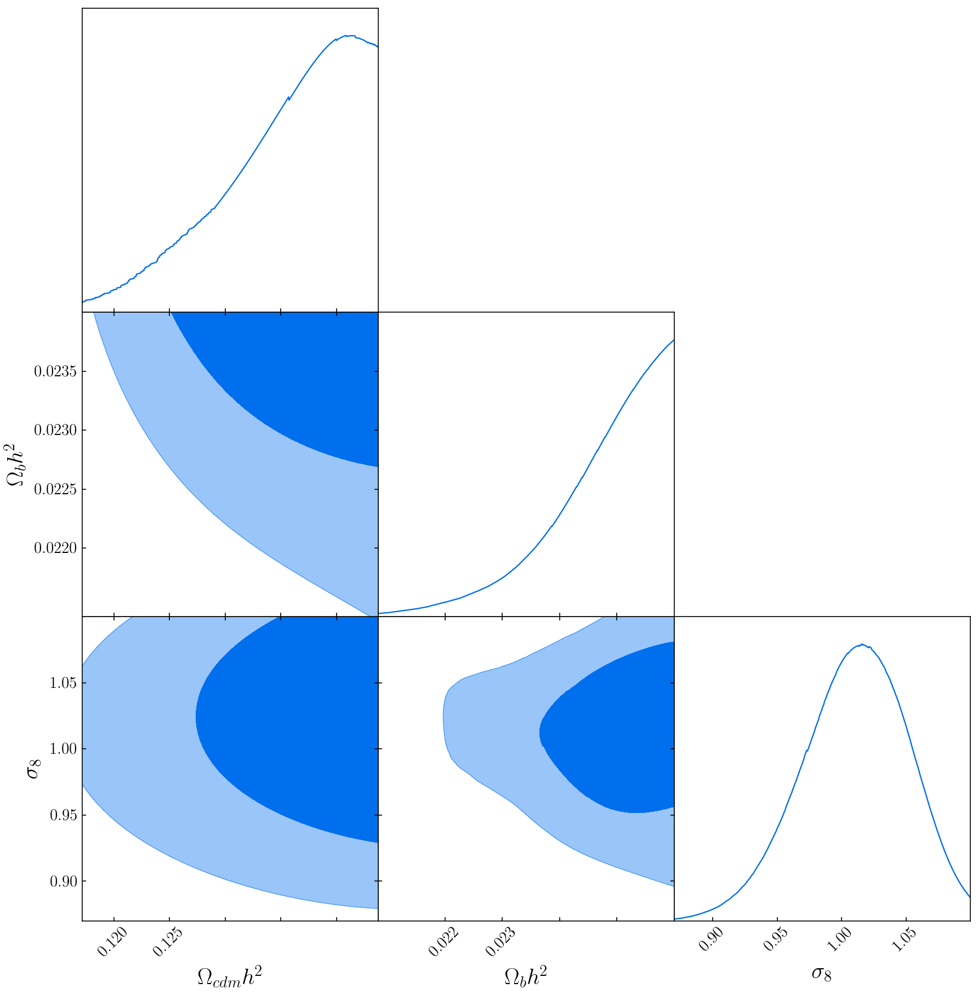

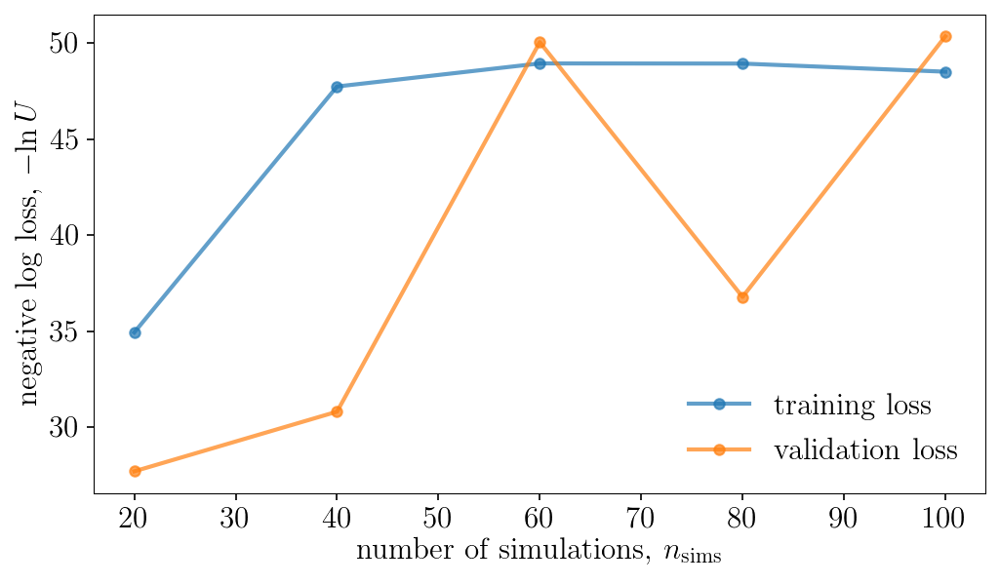

Population 22/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8175949749984284 s
total: 0.7873687300016172 s
total: 0.7846213270004228 s
total: 0.7824049270002433 s
total: 0.7879663120002078 s
total: 0.7863385760010715 s
total: 0.7895856100003584 s
total: 0.7818150160001096 s
total: 0.7898374980013614 s
total: 0.7778045690010913 s
total: 0.7812825979999616 s
total: 0.7828796680005325 s
total: 0.7831884629995329 s
total: 0.7981710770000063 s
total: 0.7777473789992655 s
total: 0.7855362859991146 s
total: 0.7804002450011467 s
total: 0.7832406739998987 s
total: 0.784552799001176 s
total: 0.7867867690001731 s


Sampling approximate posterior...
Done.
Removed no burn in


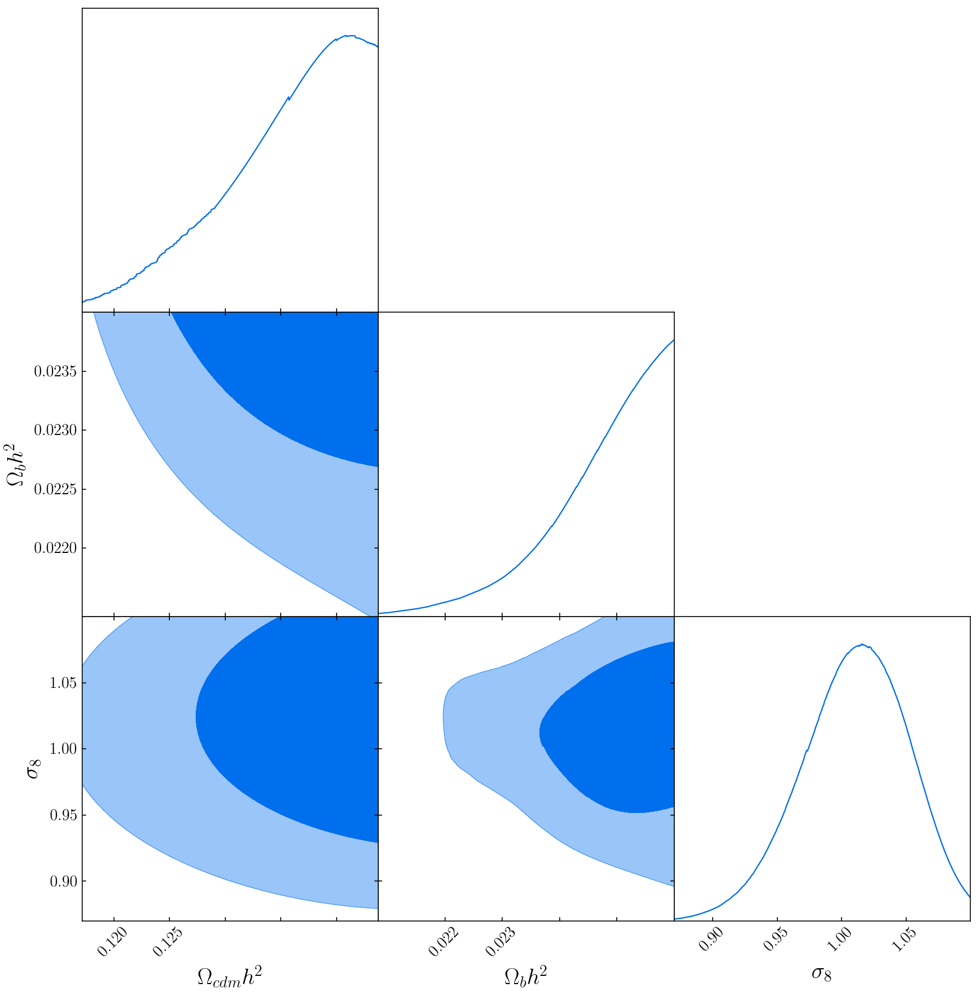

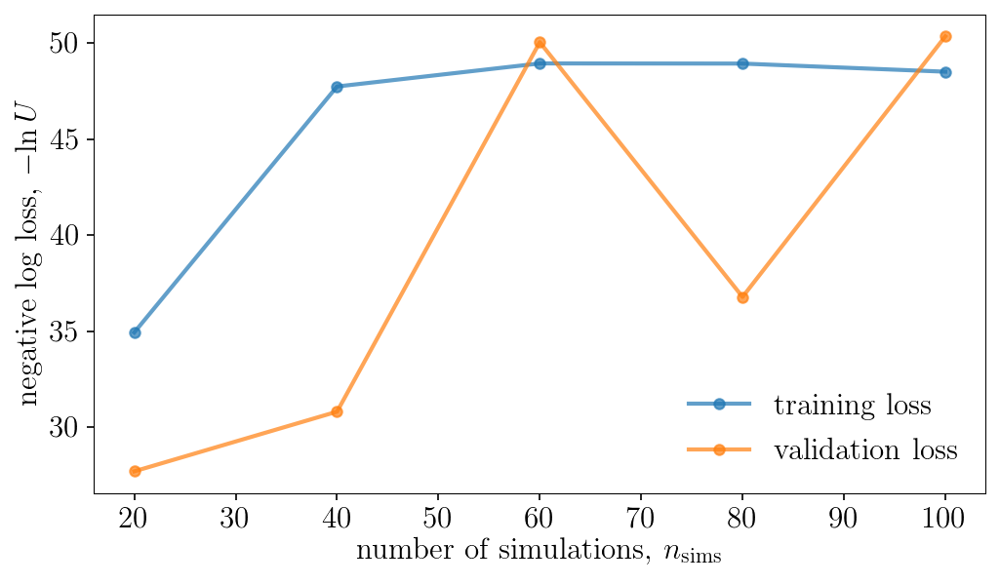

Population 23/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8204241980001825 s
total: 0.8065810879998025 s
total: 0.8017605589993764 s
total: 0.8041329820007377 s
total: 0.8283509520006191 s
total: 0.8095045190002566 s
total: 0.8292663890006224 s
total: 0.8200076059983985 s
total: 0.8250131940003484 s
total: 0.8522569760007173 s
total: 0.8439724750005553 s
total: 0.8341502410003159 s
total: 0.8578176940009143 s
total: 0.8563458650005487 s
total: 0.8745220079999854 s
total: 0.8235814560011931 s
total: 0.8158458519992564 s
total: 0.8023437899992132 s
total: 0.8073219630005042 s
total: 0.8036236549996829 s


Sampling approximate posterior...
Done.
Removed no burn in


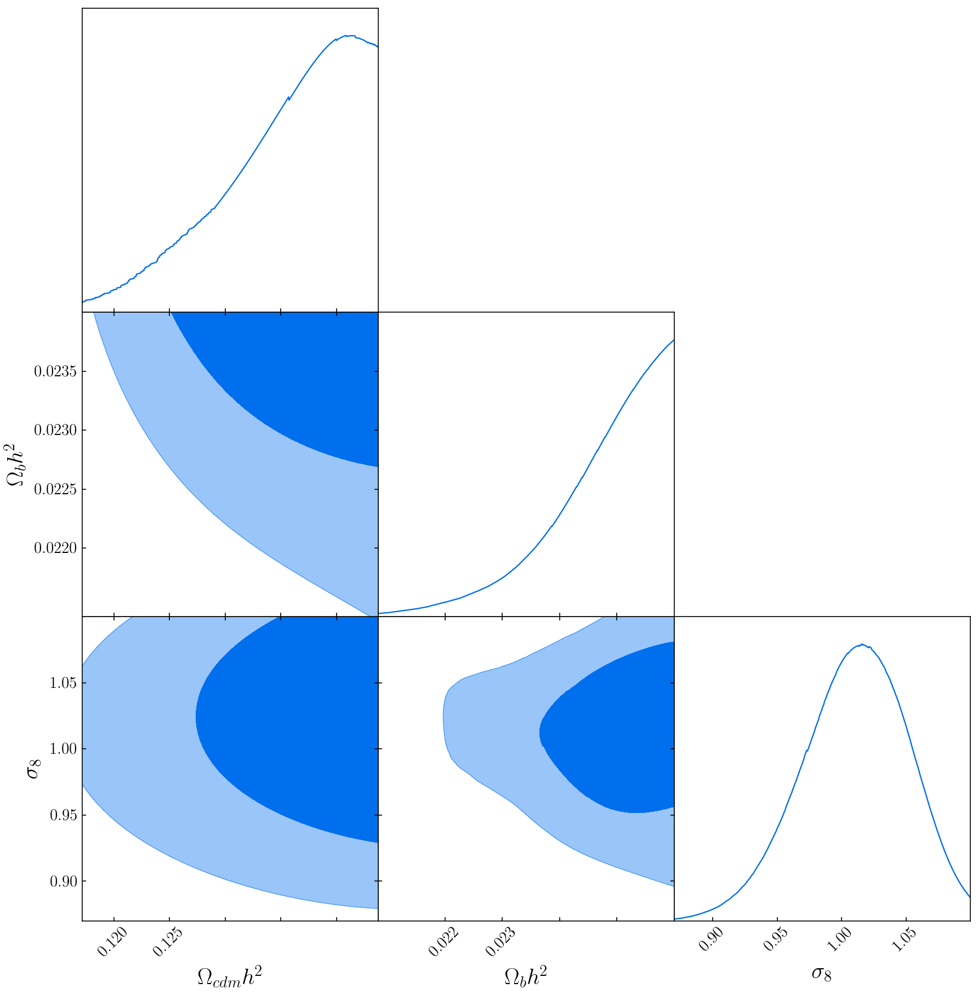

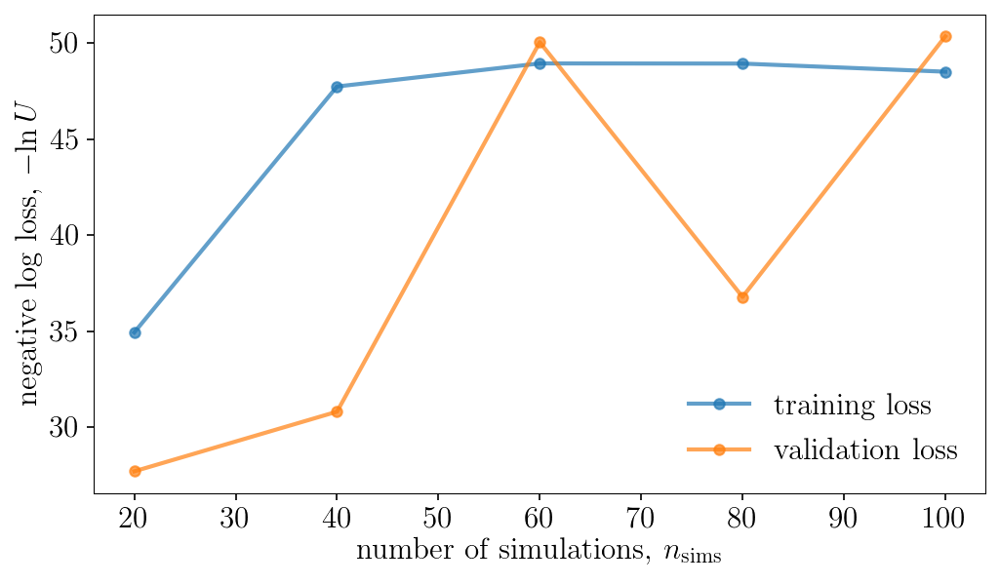

Population 24/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8388924880000559 s
total: 0.8555447600010666 s
total: 0.8398751279983117 s
total: 0.8231461929990473 s
total: 0.8176915220010414 s
total: 0.8276470599994354 s
total: 0.8398538499986898 s
total: 0.8693860699986544 s
total: 0.862502019999738 s
total: 0.8293204820001847 s
total: 0.8343106819993409 s
total: 0.8328051830012555 s
total: 0.823086747999696 s
total: 0.8524936850008089 s
total: 0.8489565230011067 s
total: 0.8363242670002364 s
total: 0.8561304380000365 s
total: 0.8592749620001996 s
total: 0.8107851259992458 s
total: 0.8230772389997583 s


Sampling approximate posterior...
Done.
Removed no burn in


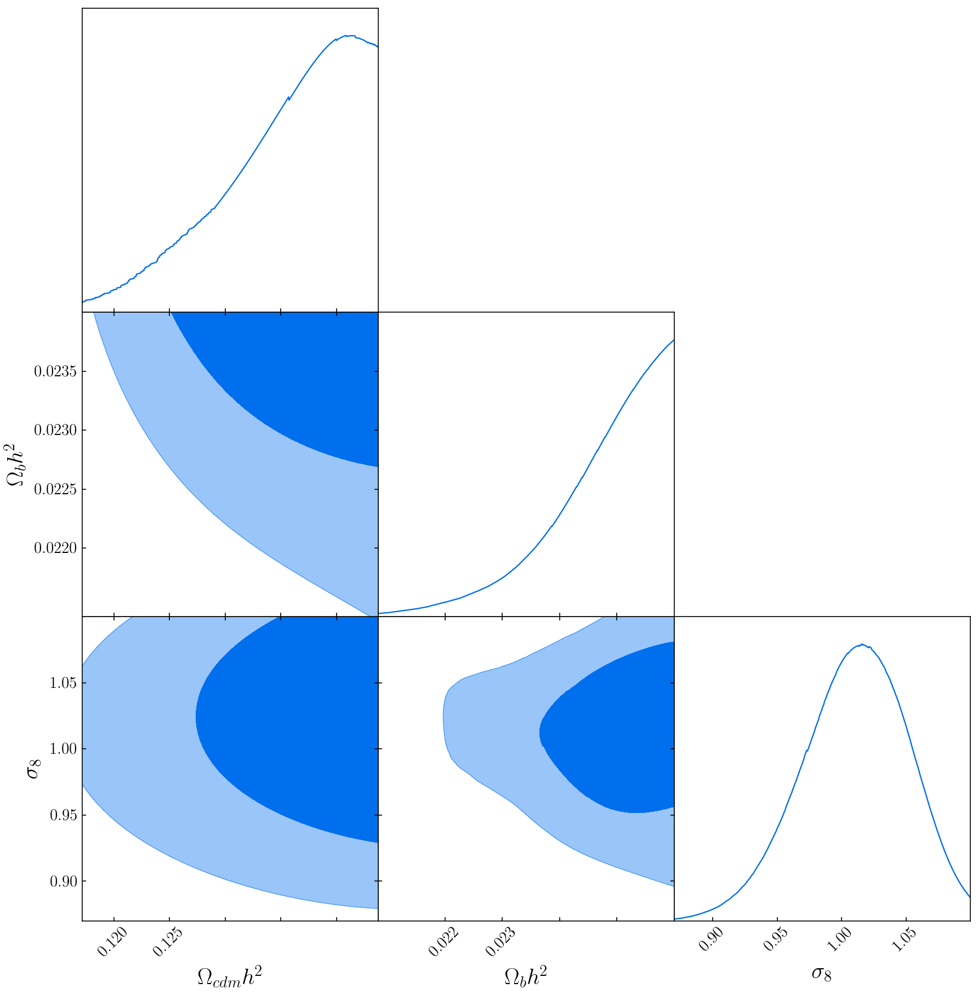

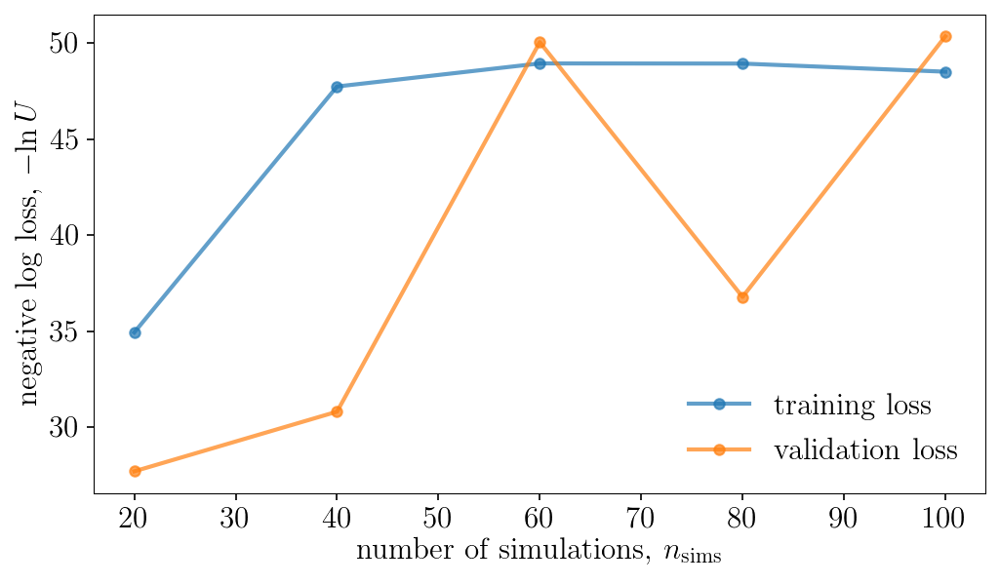

Population 25/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.818245927001044 s
total: 0.8249529889999394 s
total: 0.8101500409993605 s
total: 0.793674407999788 s
total: 0.7827458379997552 s
total: 0.8061564069994347 s
total: 0.79193547199975 s
total: 0.8065340840003046 s
total: 0.7840313050000987 s
total: 0.795228823000798 s
total: 0.8041452760007815 s
total: 0.8038179640007002 s
total: 0.79126578299838 s
total: 0.7910210829995776 s
total: 0.7920289029989362 s
total: 0.7791581510009564 s
total: 0.7828324219990463 s
total: 0.7841381959988212 s
total: 0.7918460649998451 s
total: 0.7834598299996287 s


Sampling approximate posterior...
Done.
Removed no burn in


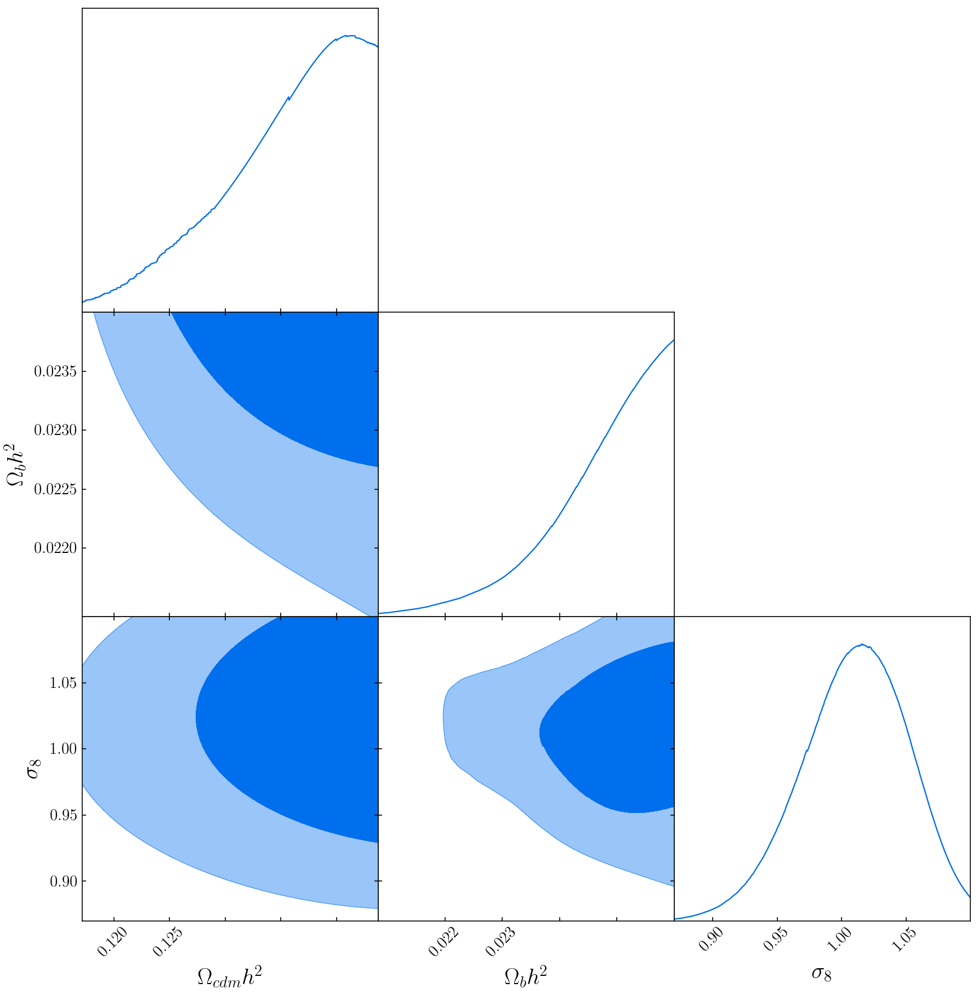

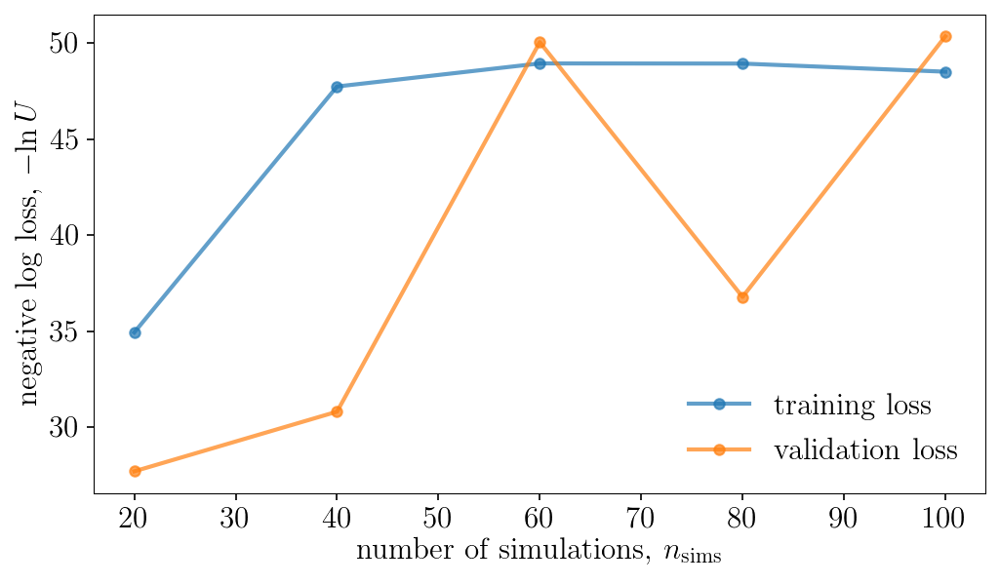

Population 26/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.7774153169993951 s
total: 0.7807272619993455 s
total: 0.7862651899995399 s
total: 0.7947314590001042 s
total: 0.7842865100010386 s
total: 0.7808689930006949 s
total: 0.7744217039999057 s
total: 0.7799492730009661 s
total: 0.7797080300006201 s
total: 0.7745973960008996 s
total: 0.7816676389993518 s
total: 0.7802646110012574 s
total: 0.7758102299994789 s
total: 0.7880301659988618 s
total: 0.7791523999985657 s
total: 0.7749605720000545 s
total: 0.780159806001393 s
total: 0.7800625979998586 s
total: 0.7852705479999713 s
total: 0.7843594299993129 s


Sampling approximate posterior...
Done.
Removed no burn in


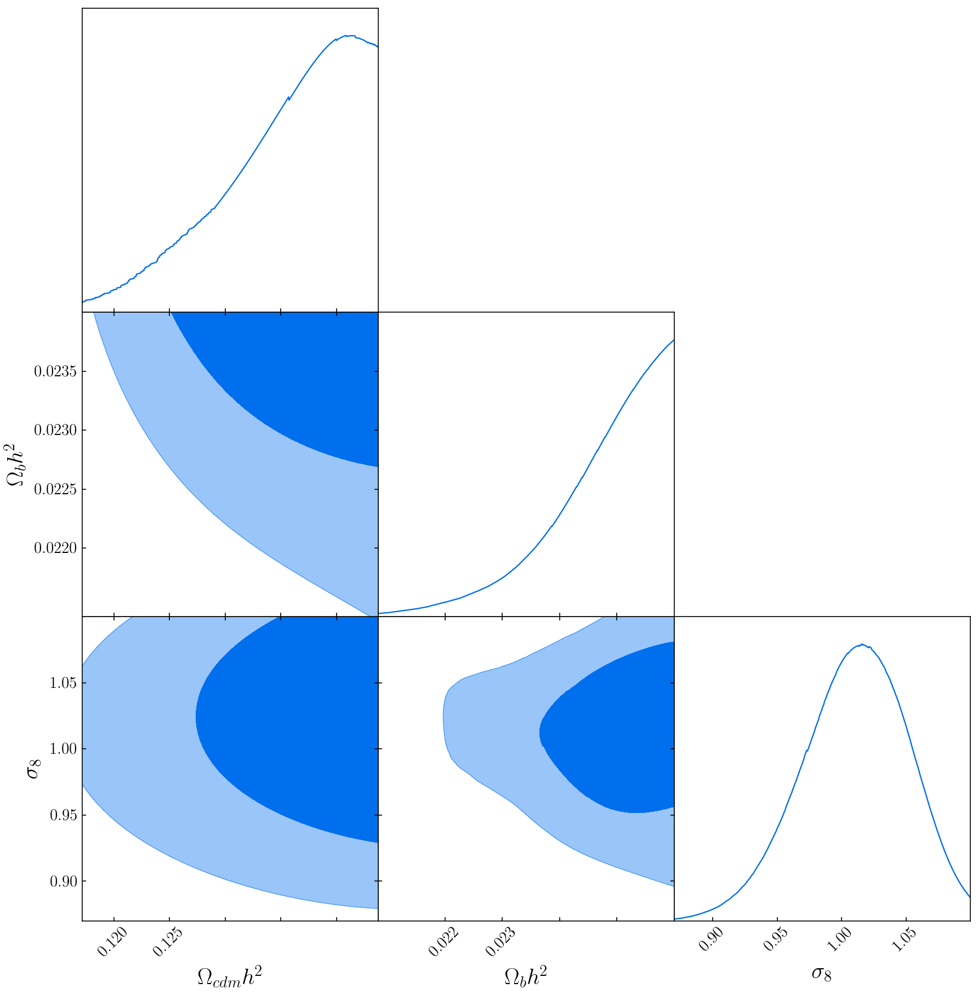

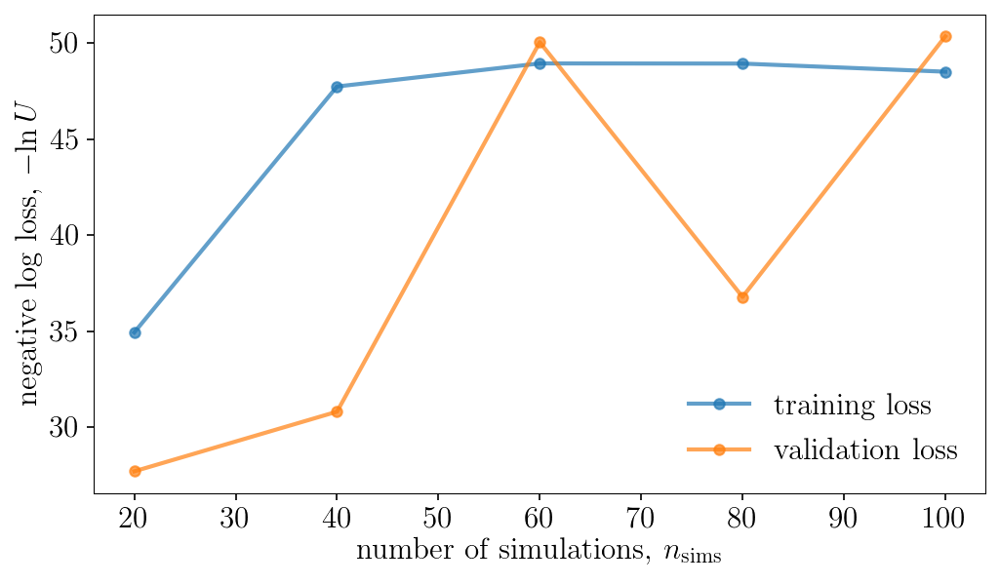

Population 27/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8038064499996835 s
total: 0.796734061999814 s
total: 0.798331934000089 s
total: 0.7908965420010645 s
total: 0.8004516350010817 s
total: 0.803326711000409 s
total: 0.7975894519986468 s
total: 0.790133082000466 s
total: 0.8028056109997124 s
total: 0.7814803849996679 s
total: 0.8002438280000206 s
total: 0.7825578409992886 s
total: 0.7964921270013292 s
total: 0.7825777019988891 s
total: 0.7800049590005074 s
total: 0.7763558909991843 s
total: 0.7796956669990323 s
total: 0.7853264660006971 s
total: 0.7796974060001958 s
total: 0.7809357080004702 s


Sampling approximate posterior...
Done.
Removed no burn in


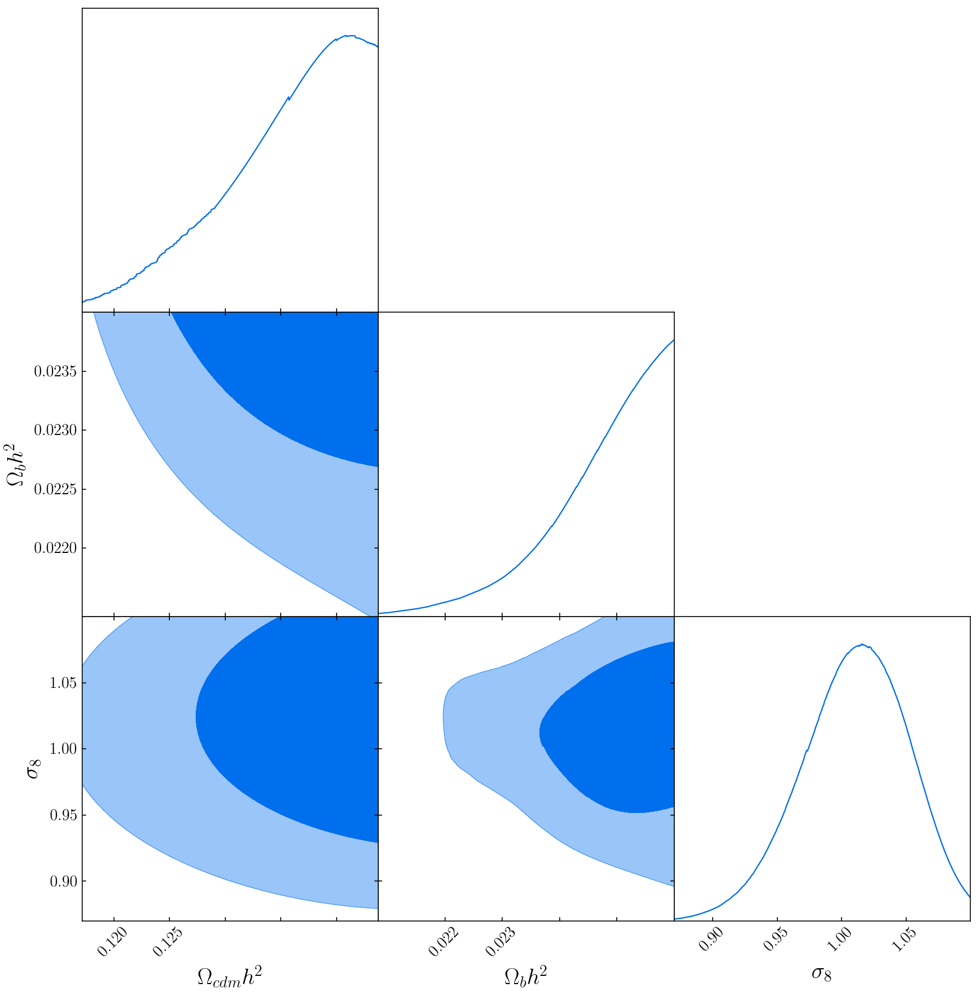

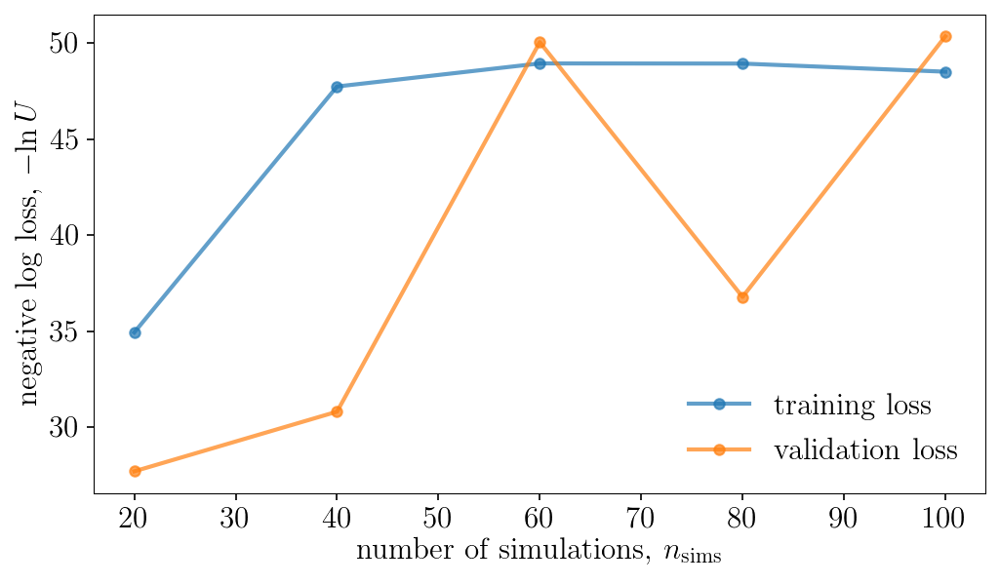

Population 28/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8092399189990829 s
total: 0.7936007759999484 s
total: 0.7803931499984174 s
total: 0.7773930999992444 s
total: 0.7746928300002764 s
total: 0.7783669610016659 s
total: 0.7743638470001315 s
total: 0.7761340910001309 s
total: 0.7731684230002429 s
total: 0.7845677839995915 s
total: 0.7797289059999457 s
total: 0.7763981469997816 s
total: 0.7770379659996252 s
total: 0.7818480400001135 s
total: 0.7760748979999335 s
total: 0.7764992470001744 s
total: 0.7776319389995479 s
total: 0.7749194309999439 s
total: 0.7784739250000712 s
total: 0.7748095719998673 s


Sampling approximate posterior...
Done.
Removed no burn in


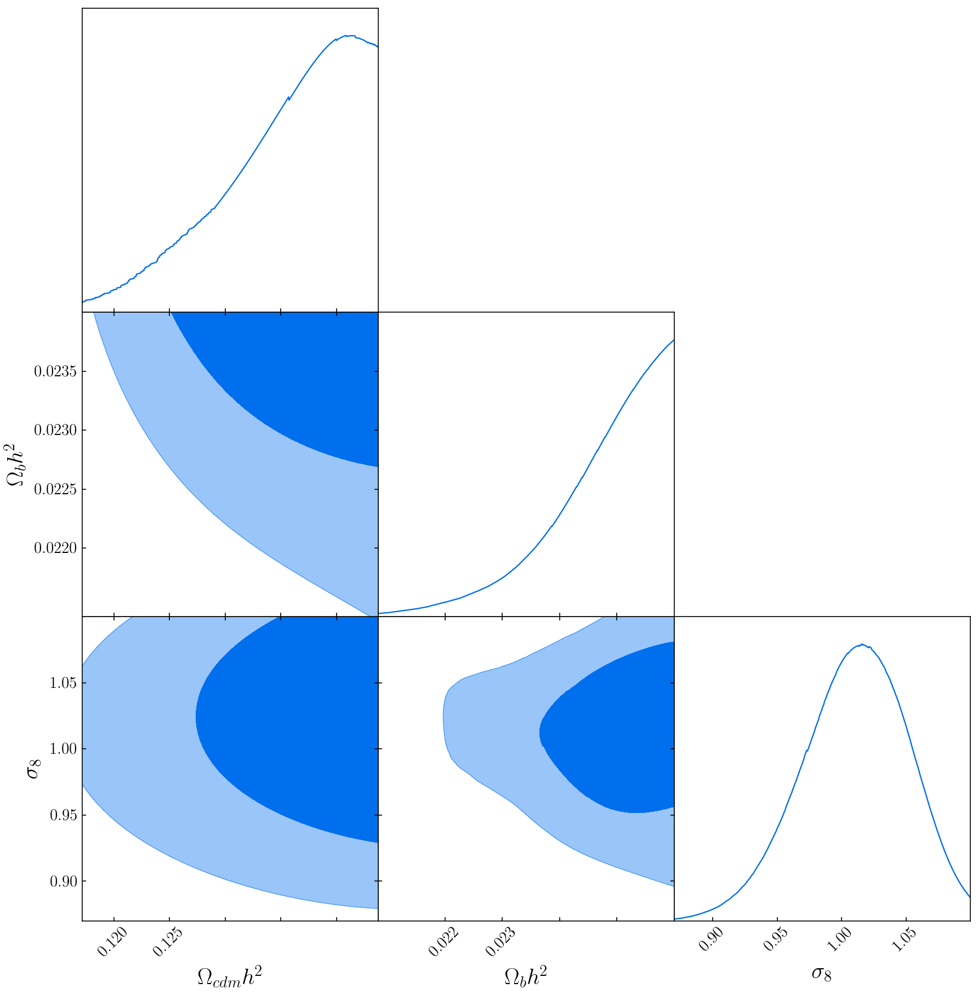

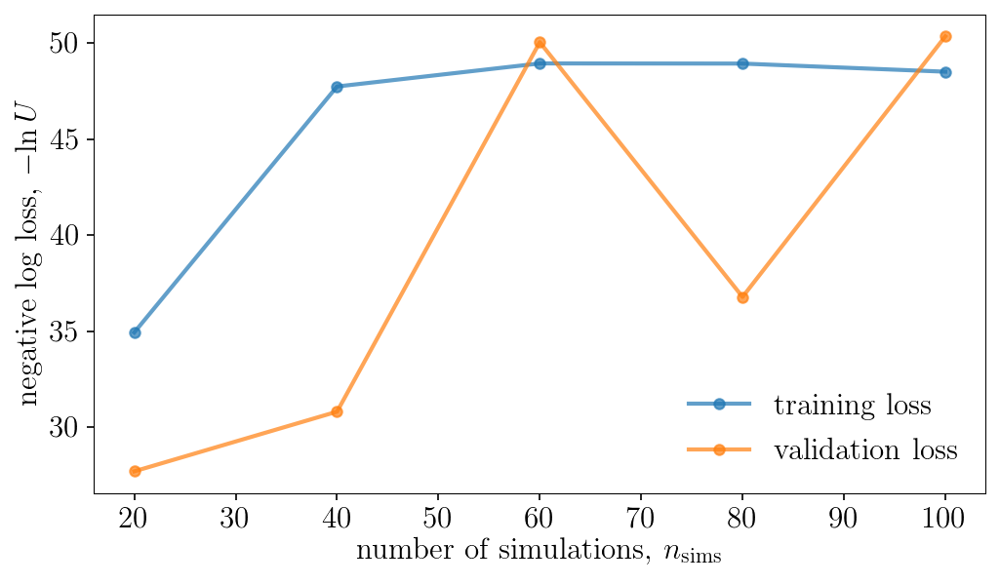

Population 29/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8154550359995483 s
total: 0.7900287409993325 s
total: 0.7955516060010268 s
total: 0.7889056080002774 s
total: 0.7883533450003597 s
total: 0.8089356240016059 s
total: 0.8013857730002201 s
total: 0.7965063950014155 s
total: 0.8210752699997101 s
total: 0.786235099998521 s
total: 0.7892627900000662 s
total: 0.7910346130011021 s
total: 0.8097005300005549 s
total: 0.79577436100044 s
total: 0.7901976100001775 s
total: 0.7973227780003072 s
total: 0.7863294789985957 s
total: 0.8037222050006676 s
total: 0.8093202700001711 s
total: 0.7977449760001036 s


Sampling approximate posterior...
Done.
Removed no burn in


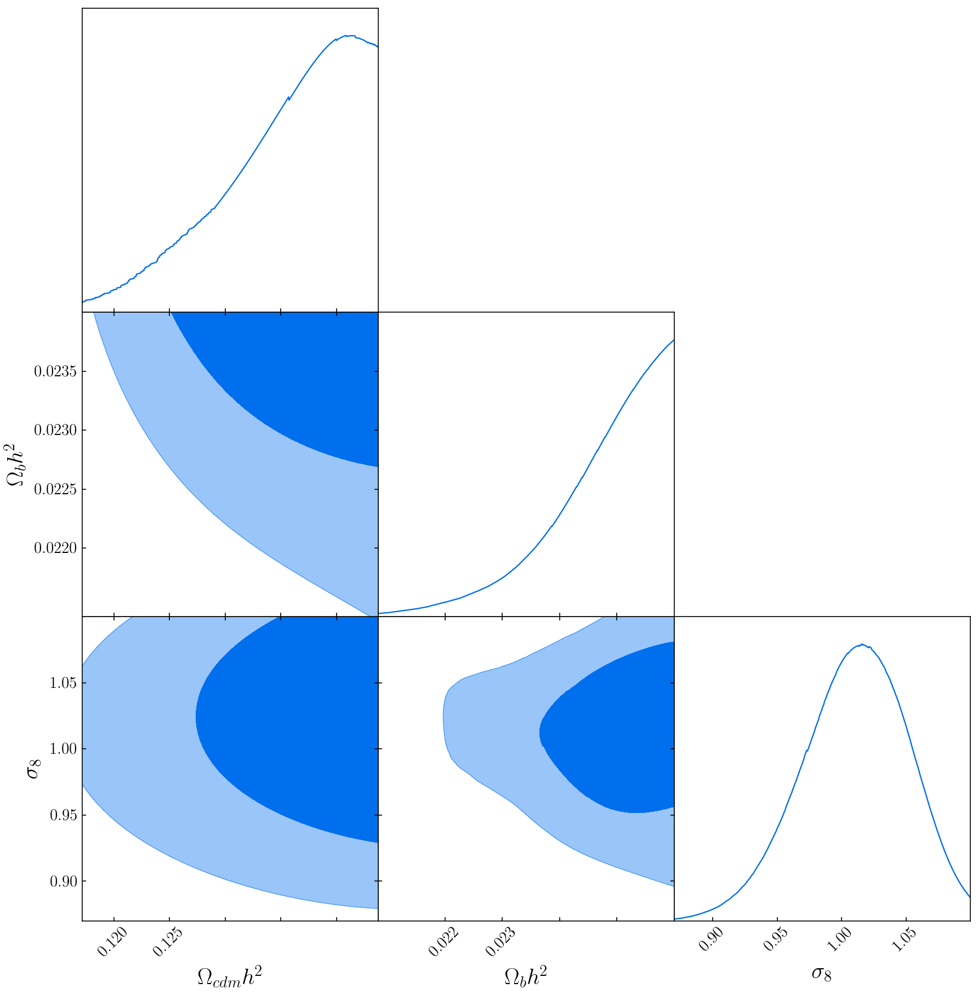

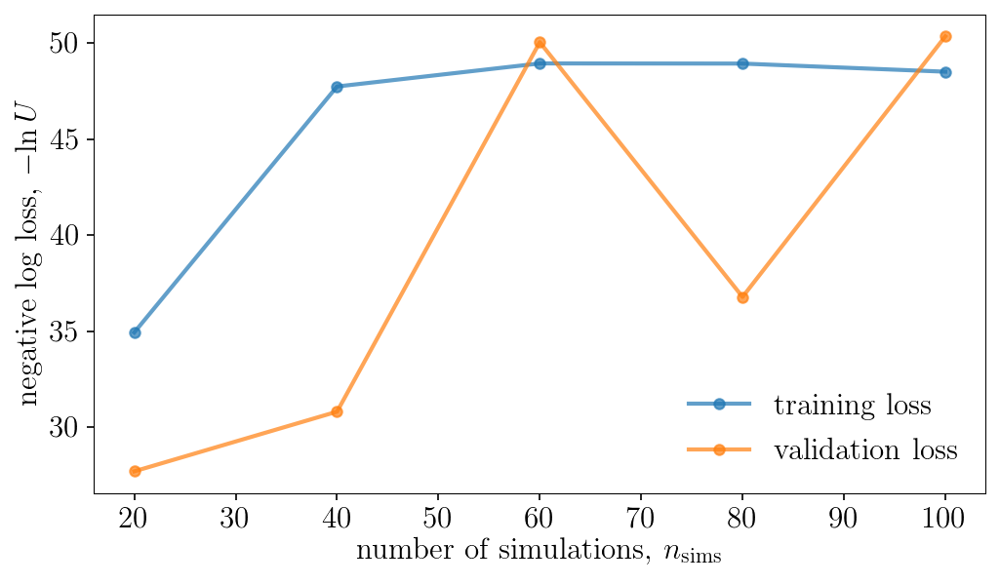

Population 30/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.83971270100119 s
total: 0.816620032001083 s
total: 0.8243889129989839 s
total: 0.8156791400015209 s
total: 0.8064747900007205 s
total: 0.7853824069989059 s
total: 0.7768310970004677 s
total: 0.790666158998647 s
total: 0.7929873510001926 s
total: 0.7790941800012661 s
total: 0.7814919009997539 s
total: 0.7876542100002553 s
total: 0.7898532819999673 s
total: 0.792905136000627 s
total: 0.7815046220002841 s
total: 0.7845741479995922 s
total: 0.7826690069996403 s
total: 0.7788630399991234 s
total: 0.7990878830005386 s
total: 0.8004644609991374 s


Sampling approximate posterior...
Done.
Removed no burn in


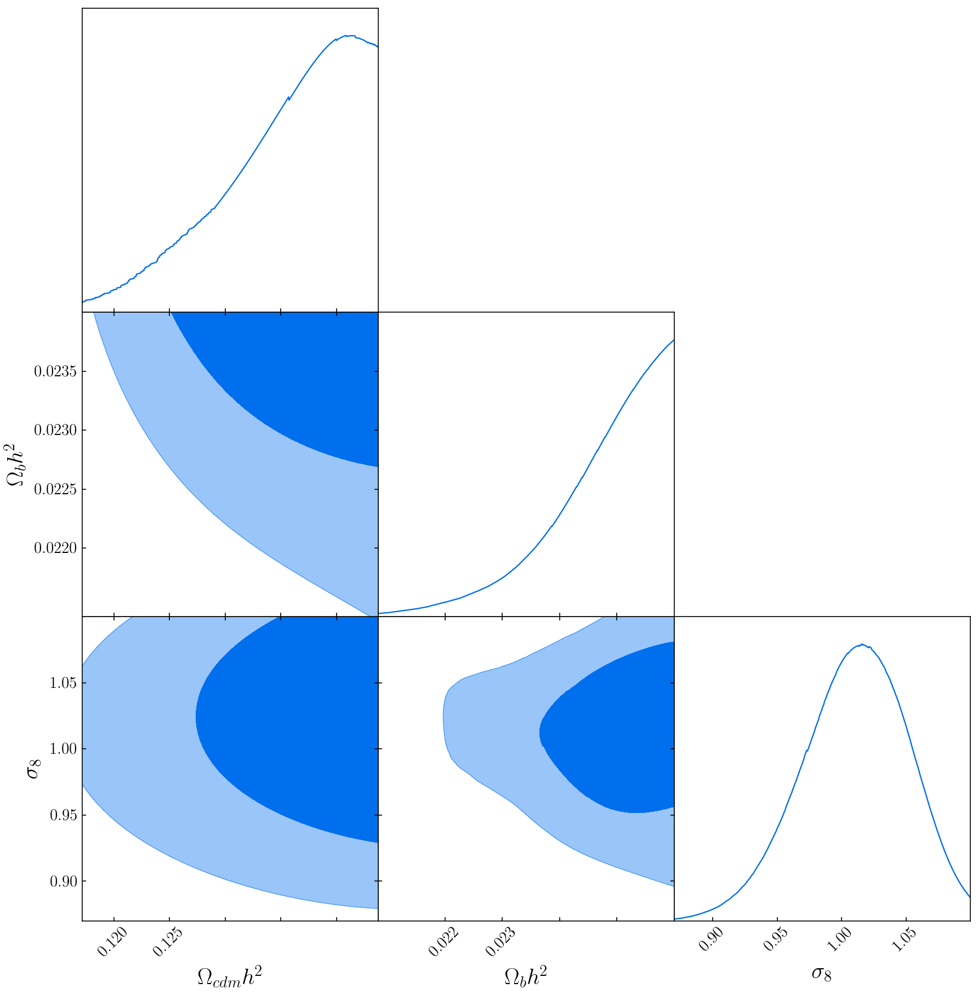

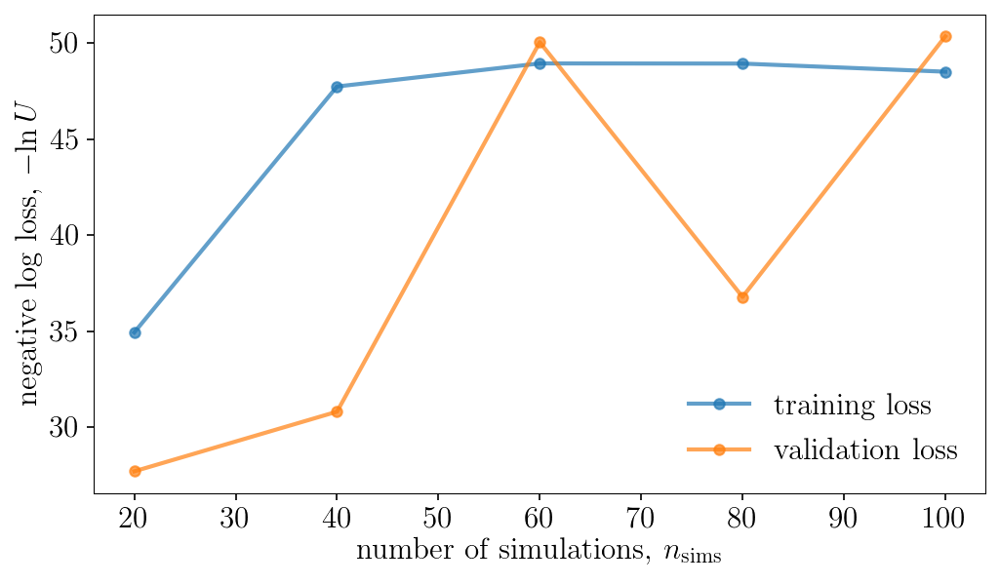

Population 31/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8059848760003661 s
total: 0.7939893869988737 s
total: 0.8152639590007311 s
total: 0.7830178489984974 s
total: 0.7878047230005905 s
total: 0.7869943330006208 s
total: 0.7909486740009015 s
total: 0.7835579960010364 s
total: 0.8101602129991079 s
total: 0.7782343210001272 s
total: 0.7843479359999037 s
total: 0.7816624729985051 s
total: 0.7745844950004539 s
total: 0.7883754369995586 s
total: 0.781173312001556 s
total: 0.7789495929991972 s
total: 0.7805111260004196 s
total: 0.7819149799997831 s
total: 0.7783018499994796 s
total: 0.777330068000083 s


Sampling approximate posterior...
Done.
Removed no burn in


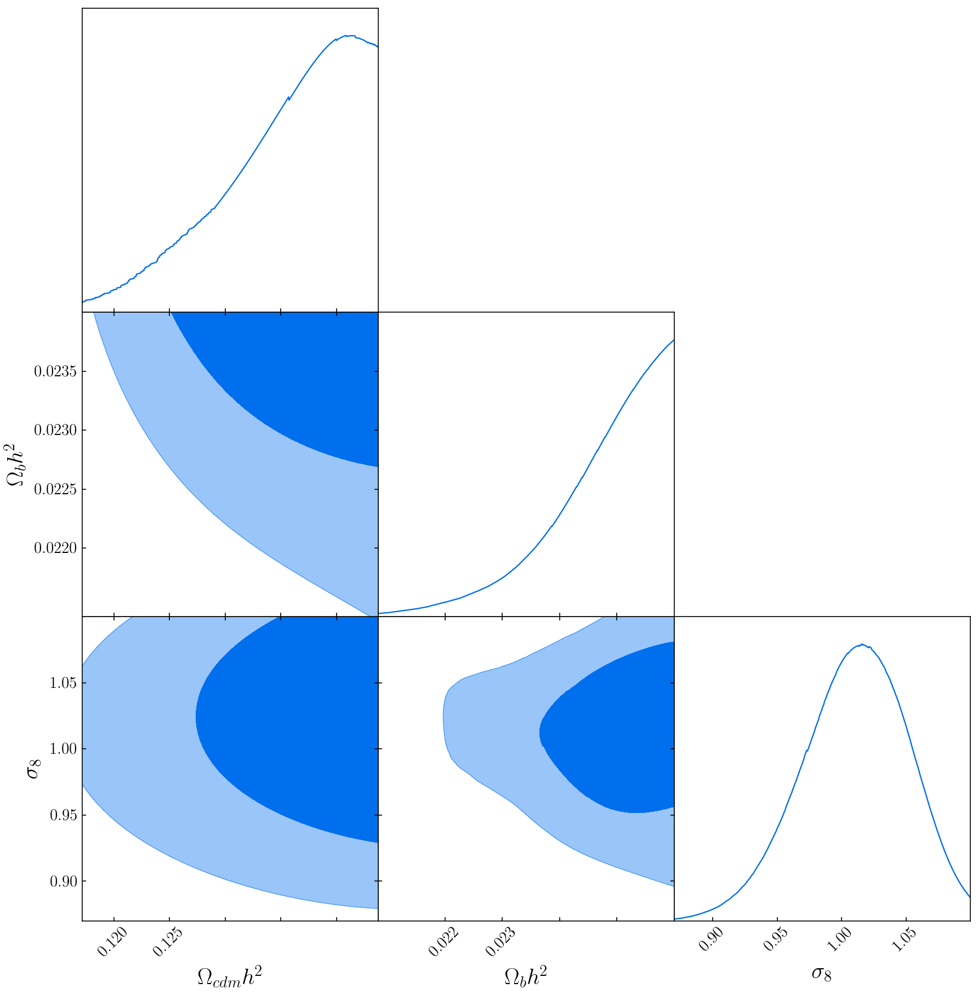

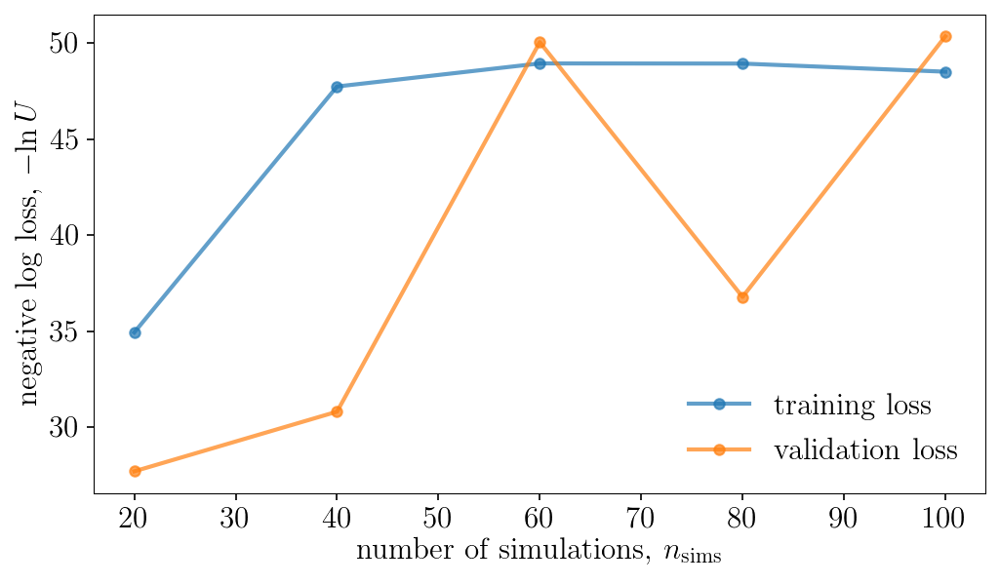

Population 32/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8297839530005149 s
total: 0.8291855770003167 s
total: 0.8023687109998718 s
total: 0.7968803550011216 s
total: 0.8060705600000801 s
total: 0.8101493070007564 s
total: 0.7991790080013743 s
total: 0.8187106479999784 s
total: 0.8093527609999001 s
total: 0.7980044650012132 s
total: 0.8007700400012254 s
total: 0.8034074600000167 s
total: 0.7984883139997692 s
total: 0.8026445680006873 s
total: 0.8129488020003919 s
total: 0.8236095089996525 s
total: 0.8376809330002288 s
total: 0.8106051879985898 s
total: 0.8080515859983279 s
total: 0.8009025940009451 s


Sampling approximate posterior...
Done.
Removed no burn in


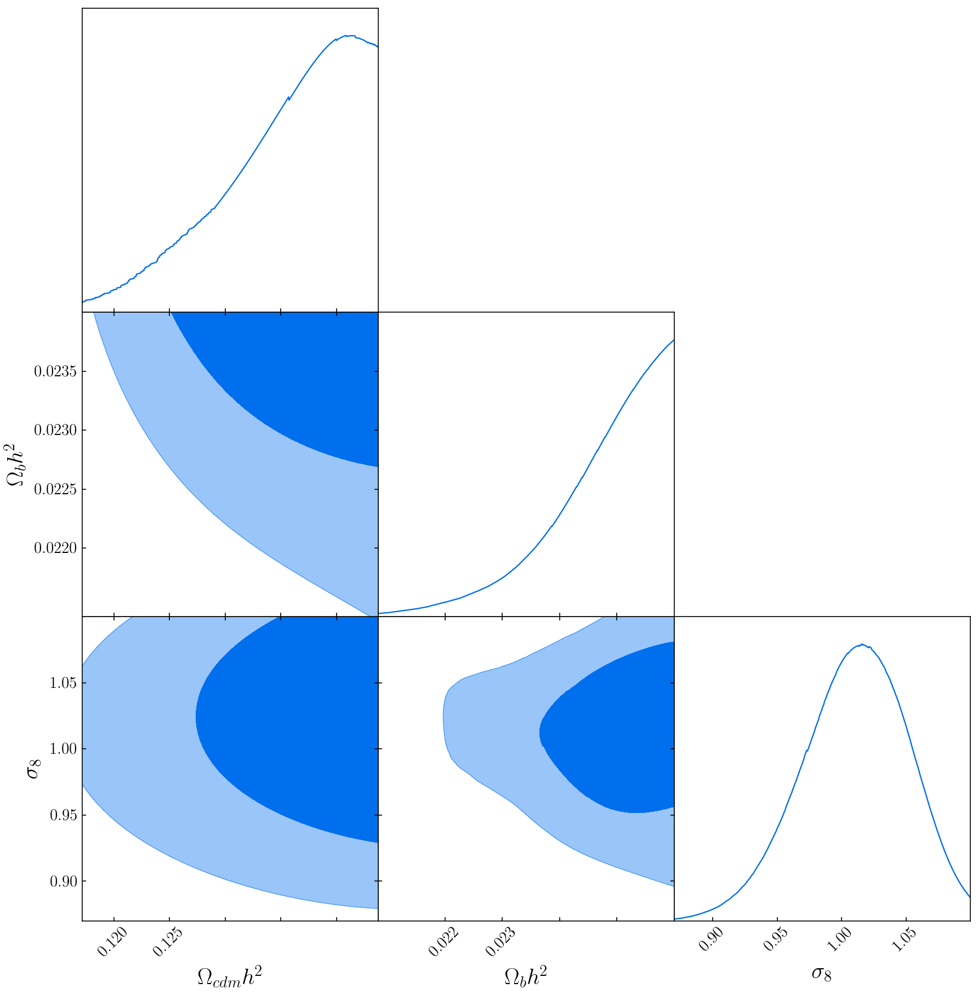

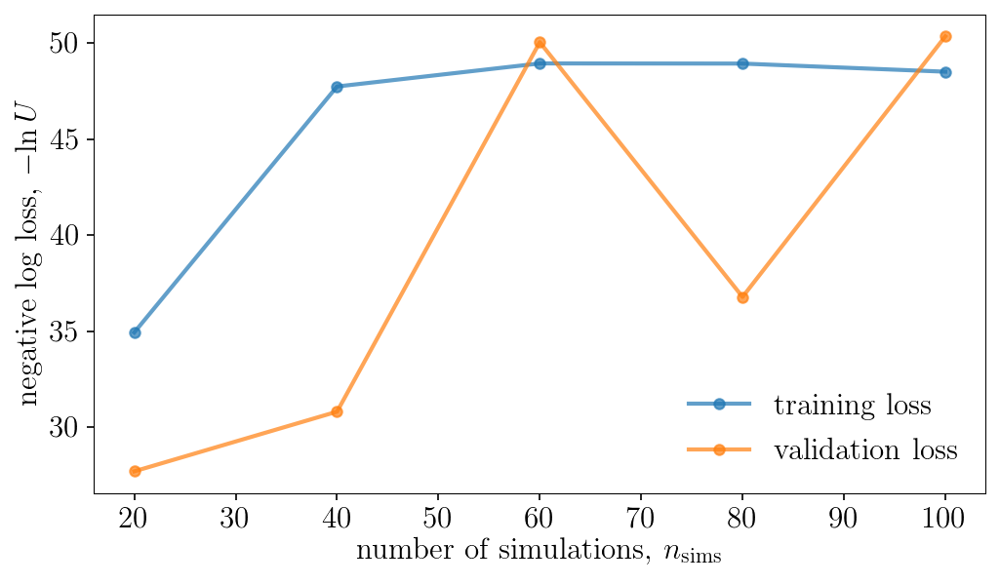

Population 33/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8559387080022134 s
total: 0.8414318409995758 s
total: 0.8529423560030409 s
total: 0.791478568000457 s
total: 0.7852714909968199 s
total: 0.7842023539997172 s
total: 0.7861364380005398 s
total: 0.7863301170000341 s
total: 0.7827661240007728 s
total: 0.7872538459996576 s
total: 0.7989818019996164 s
total: 0.7855875679997553 s
total: 0.7892787899982068 s
total: 0.8090110459997959 s
total: 0.7853174889969523 s
total: 0.7856824009977572 s
total: 0.7912576519993308 s
total: 0.7839240320026875 s
total: 0.8199479110007815 s
total: 0.7818063519989664 s


Sampling approximate posterior...
Done.
Removed no burn in


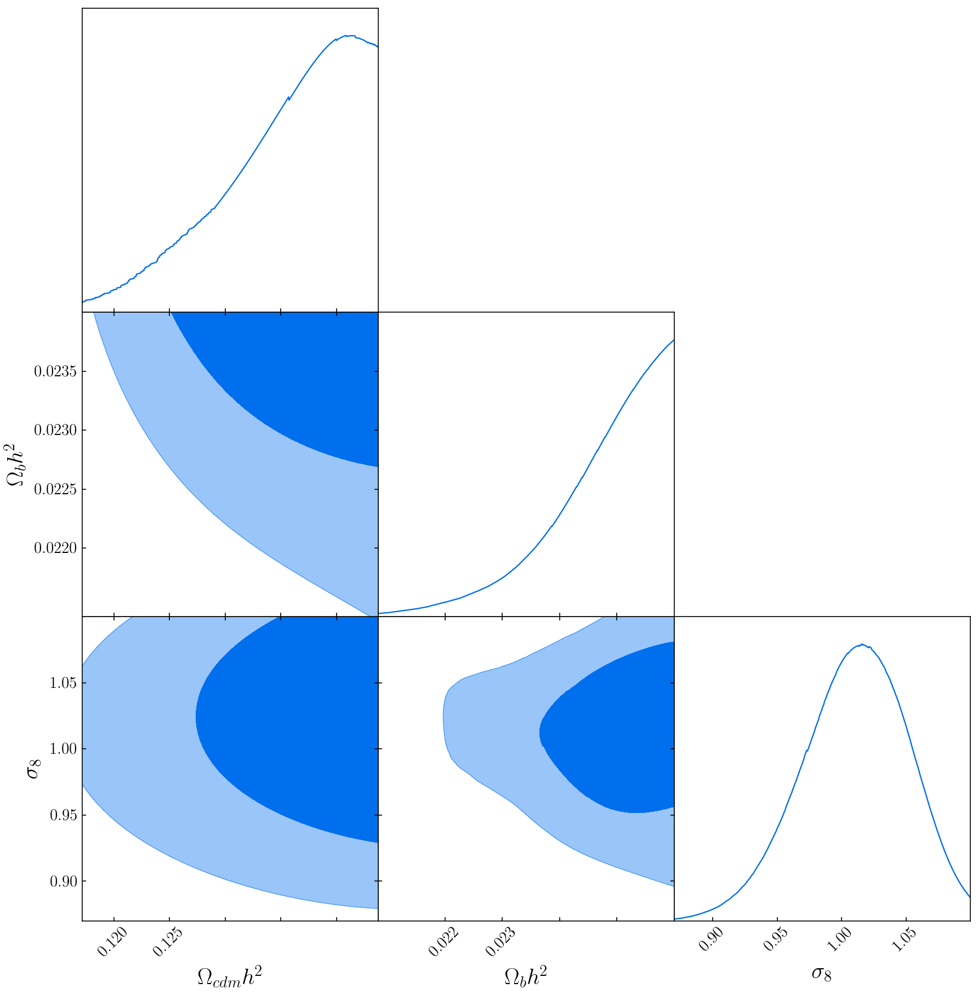

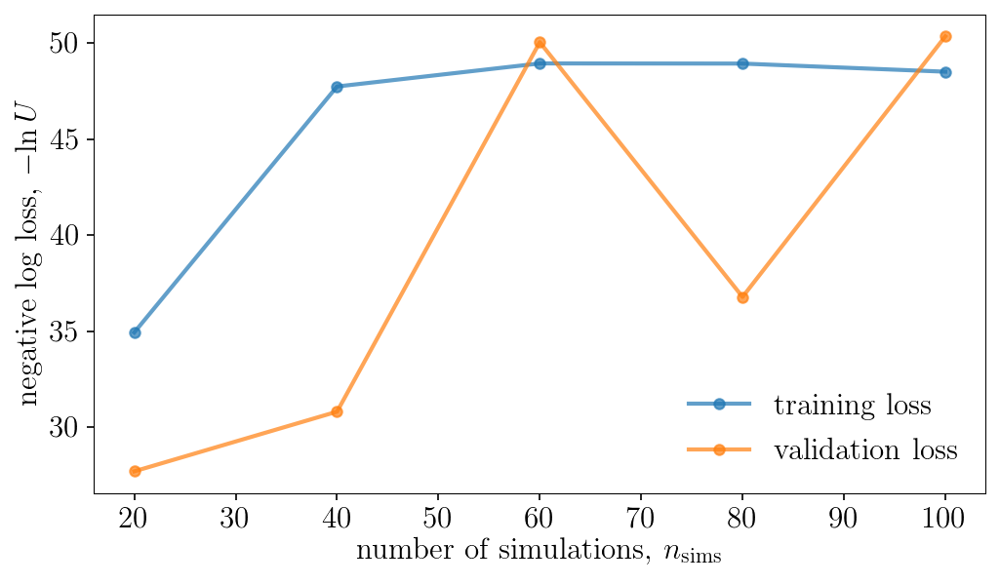

Population 34/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.805632355997659 s
total: 0.803850528998737 s
total: 0.797439354002563 s
total: 0.8050522459998319 s
total: 0.7956714860010834 s
total: 0.8112250479971408 s
total: 0.8244878170007723 s
total: 0.8061896929975774 s
total: 0.8037226850028674 s
total: 0.8058312549983384 s
total: 0.7995882659997733 s
total: 0.8189037310003187 s
total: 0.8026223950000713 s
total: 0.8016481890008436 s
total: 0.805220043999725 s
total: 0.8029163319988584 s
total: 0.8018126360002498 s
total: 0.7990946399986569 s
total: 0.806568314001197 s
total: 0.8042102300023544 s


Sampling approximate posterior...
Done.
Removed no burn in


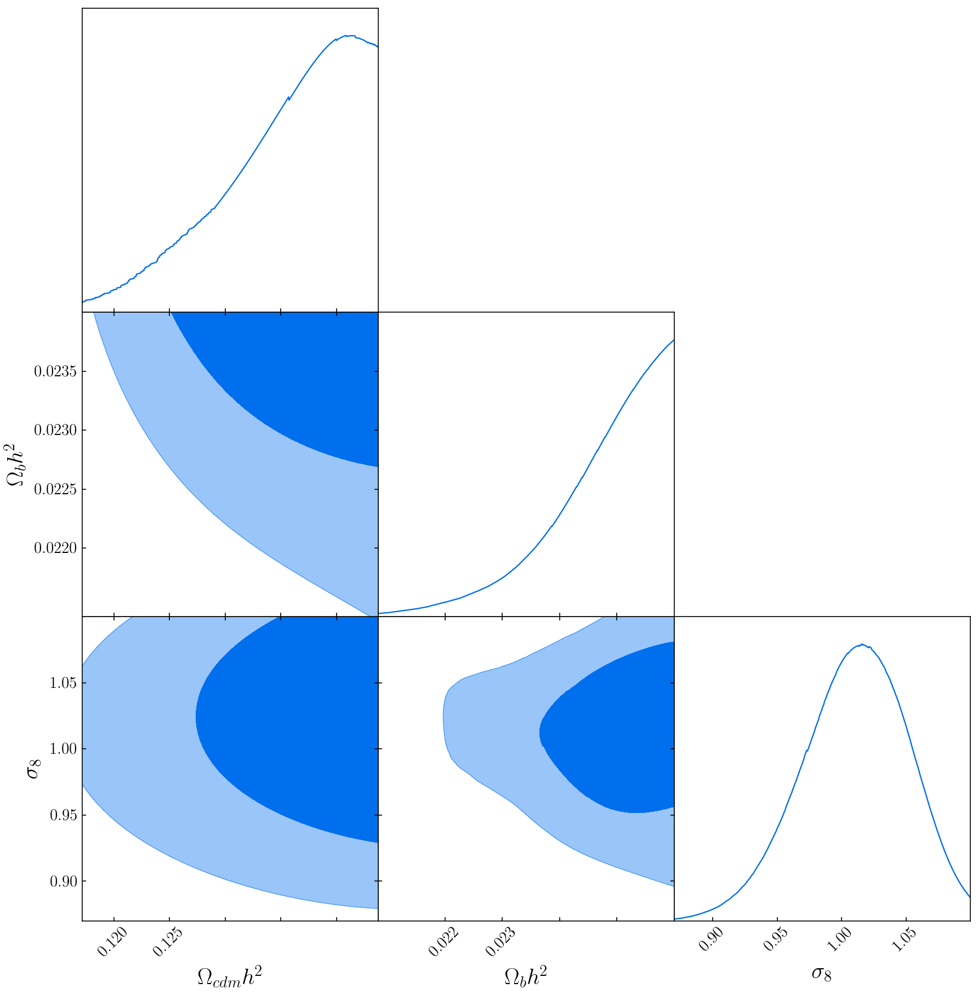

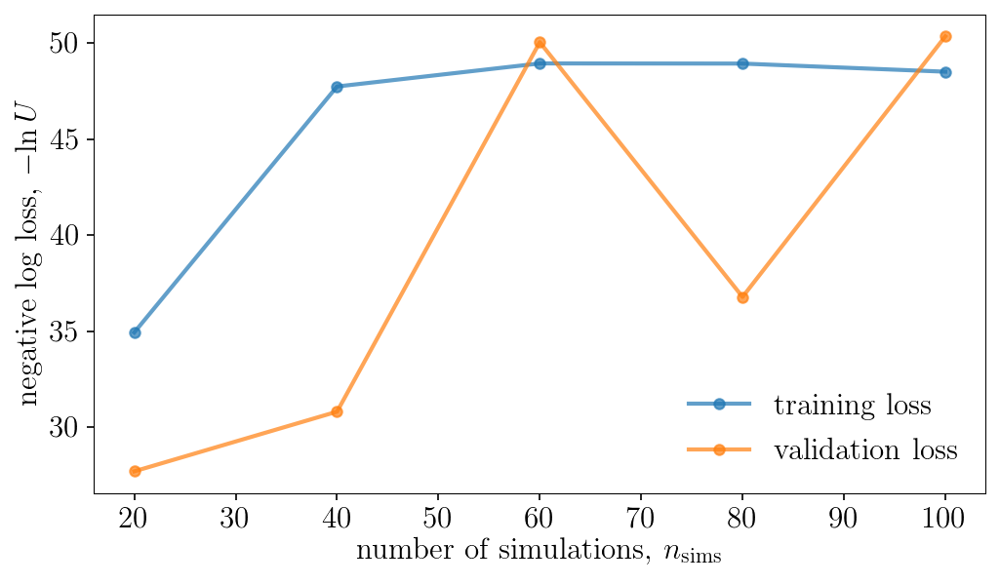

Population 35/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8473043439989851 s
total: 0.7959226979983214 s
total: 0.7831341970013455 s
total: 0.8393818539989297 s
total: 0.7885741400023107 s
total: 0.785619468002551 s
total: 0.7857586230020388 s
total: 0.7812405369986664 s
total: 0.7889116190017376 s
total: 0.7954679050017148 s
total: 0.8016352929989807 s
total: 0.8011962200034759 s
total: 0.7897620339972491 s
total: 0.7946369249984855 s
total: 0.7830604820010194 s
total: 0.7832834440014267 s
total: 0.7870287510013441 s
total: 0.7846196809987305 s
total: 0.7857224500003213 s
total: 0.7901881889993092 s


Sampling approximate posterior...
Done.
Removed no burn in


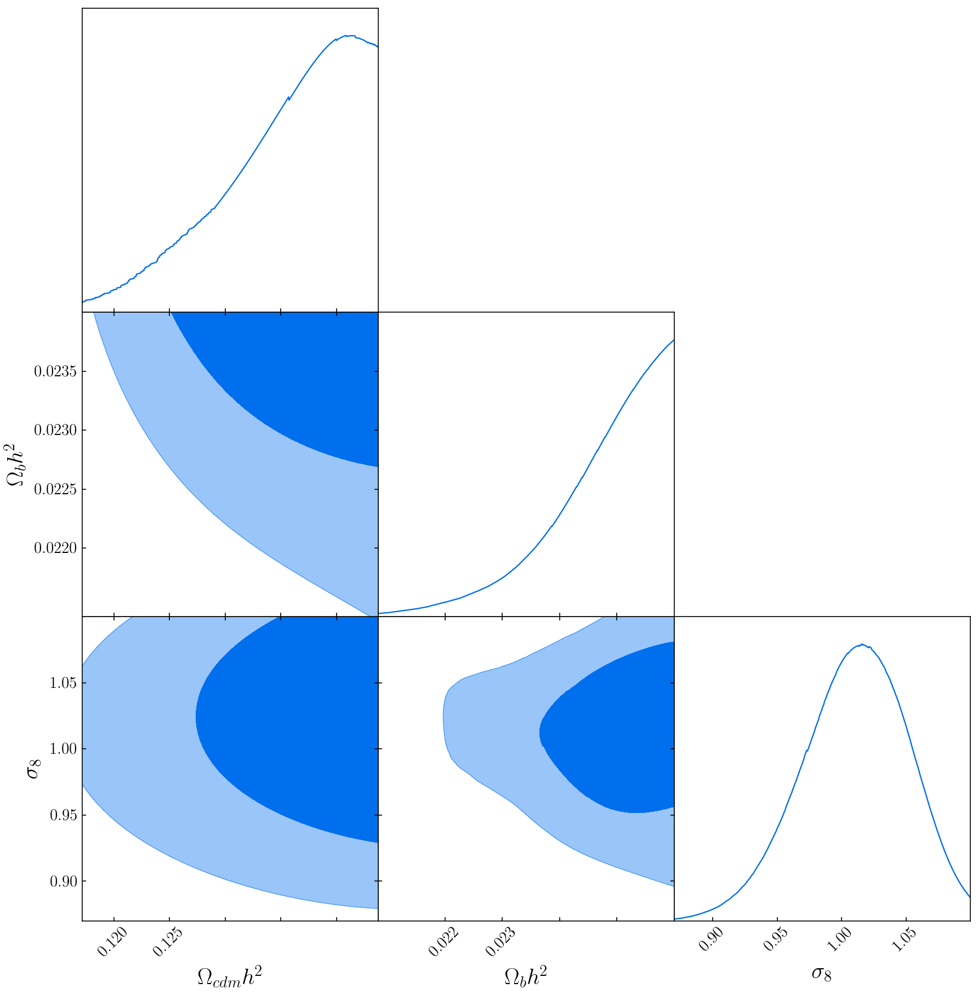

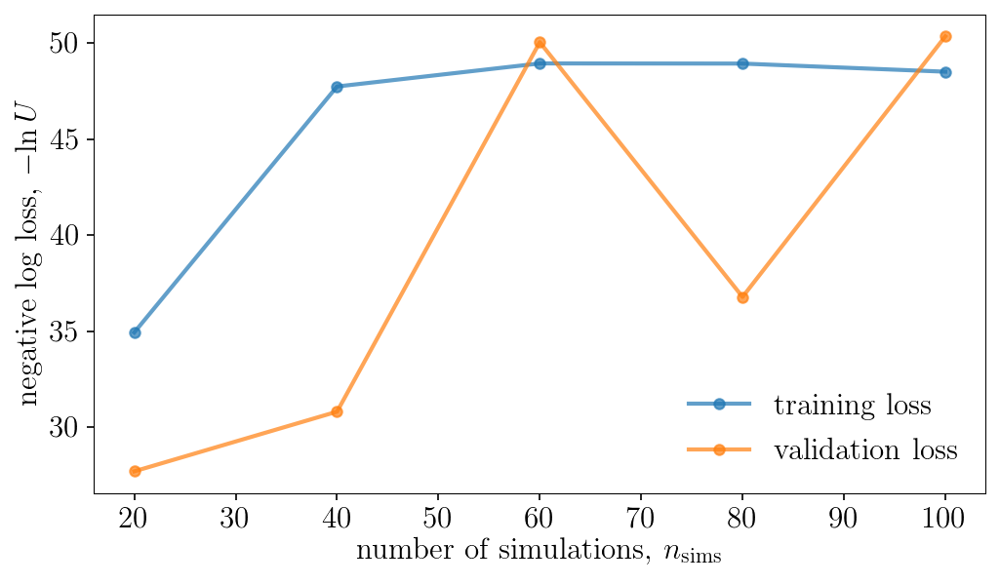

Population 36/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8013818760009599 s
total: 0.7937736769999901 s
total: 0.7984342019990436 s
total: 0.8106271749966254 s
total: 0.7924701480005751 s
total: 0.8106919050005672 s
total: 0.7961822799989022 s
total: 0.7939522710003075 s
total: 0.8025031280012627 s
total: 0.796136936001858 s
total: 0.7992675409986987 s
total: 0.7975924829988799 s
total: 0.8103992830001516 s
total: 0.8101073860016186 s
total: 0.8067860740011383 s
total: 0.8088331600010861 s
total: 0.7964750860010099 s
total: 0.7998032510004123 s
total: 0.8071736220008461 s
total: 0.7964090519999445 s


Sampling approximate posterior...
Done.
Removed no burn in


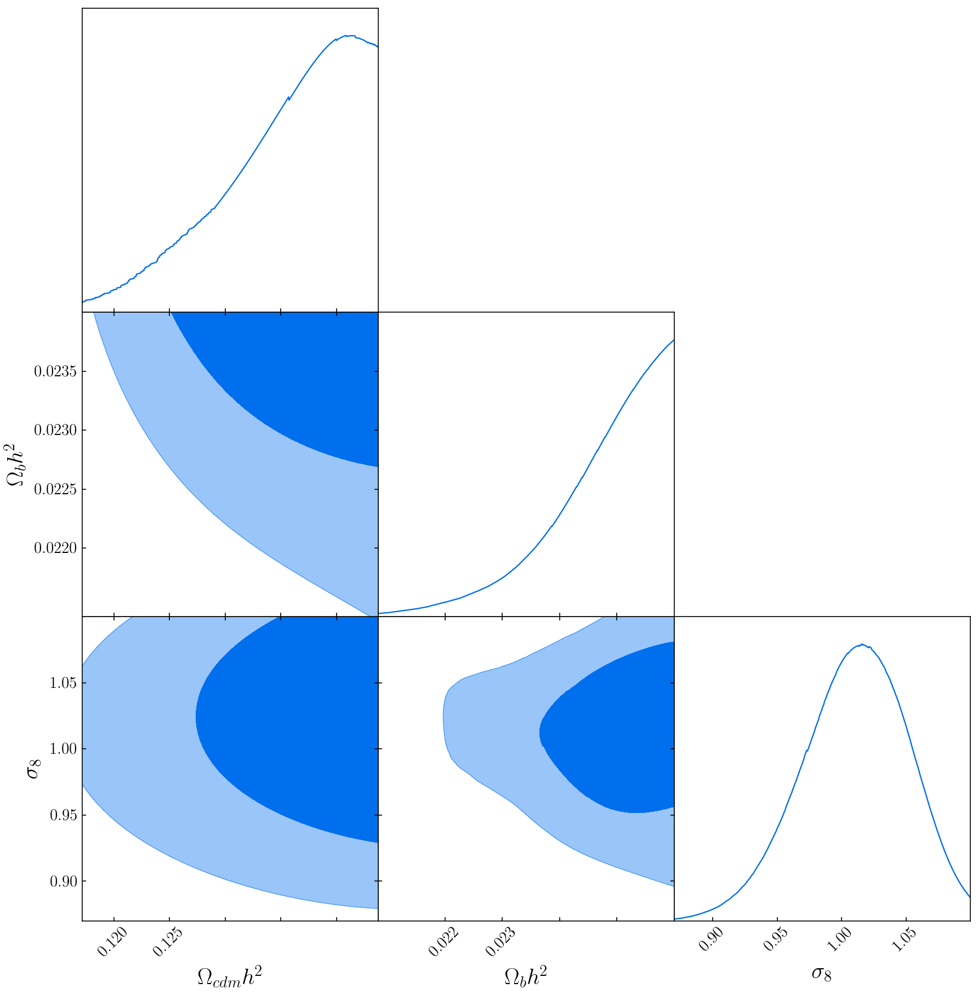

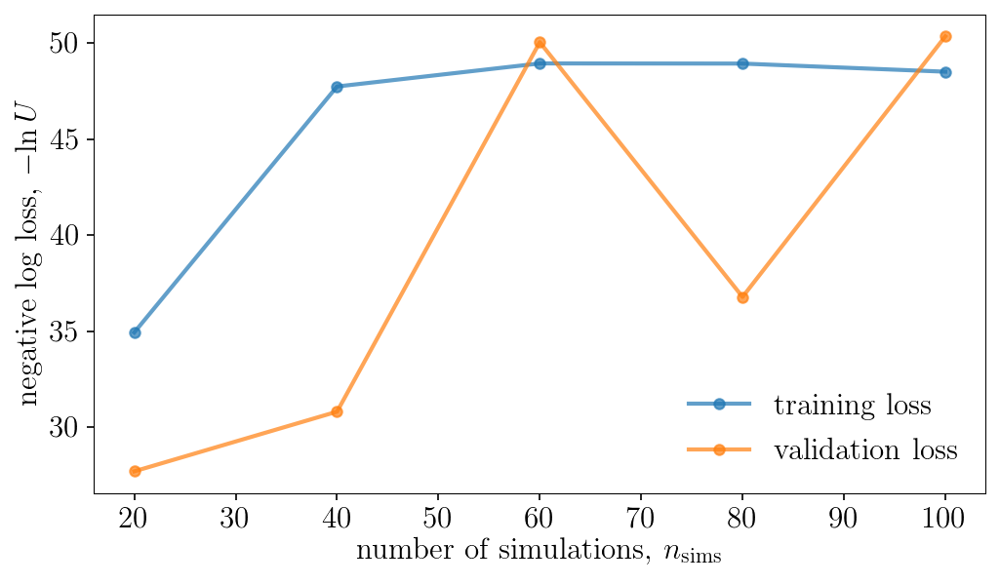

Population 37/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.7864633760000288 s
total: 0.7789324249970377 s
total: 0.7789881289972982 s
total: 0.7838174860007712 s
total: 0.7748935970012099 s
total: 0.779386546000751 s
total: 0.7949892030010233 s
total: 0.7870086260008975 s
total: 0.788252376998571 s
total: 0.787329785998736 s
total: 0.7870201879995875 s
total: 0.7818821280015982 s
total: 0.7884226520000084 s
total: 0.7830827980033064 s
total: 0.8309440220000397 s
total: 0.7908809189975727 s
total: 0.7795857880009862 s
total: 0.7754706010018708 s
total: 0.8024786000023596 s
total: 0.7774342390002857 s


Sampling approximate posterior...
Done.
Removed no burn in


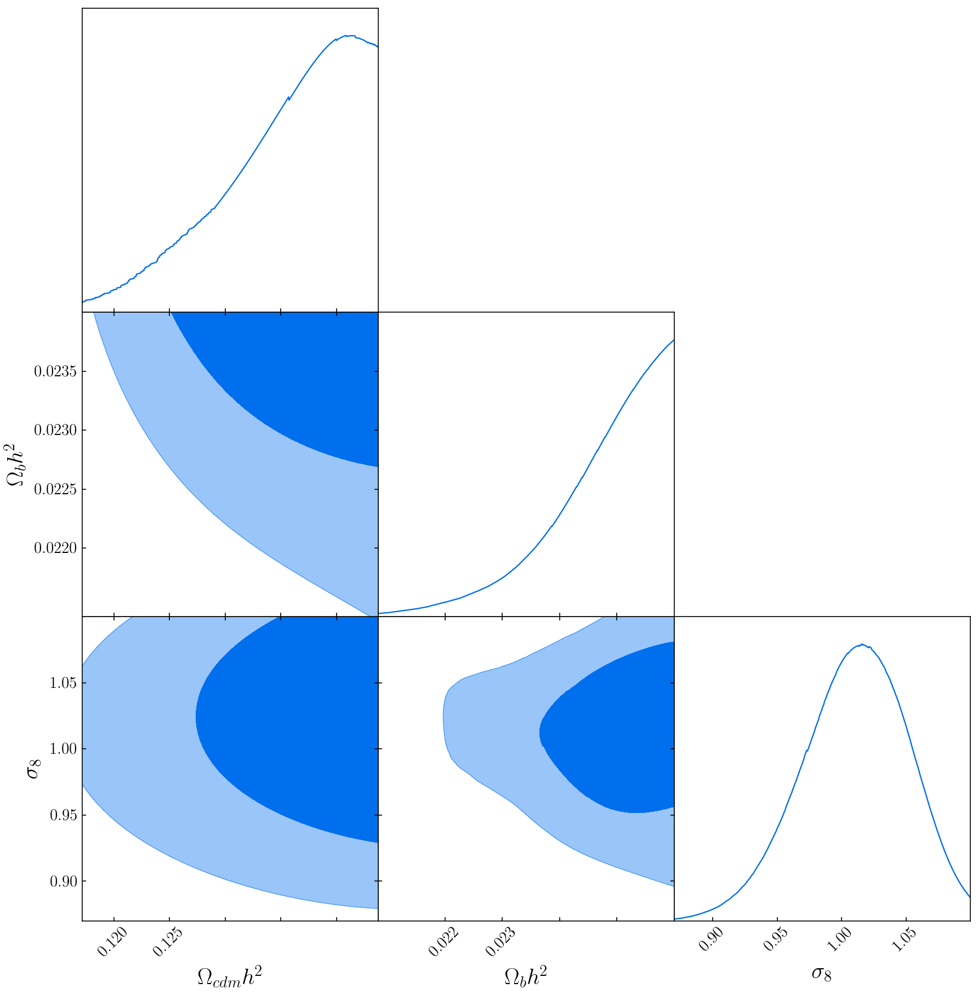

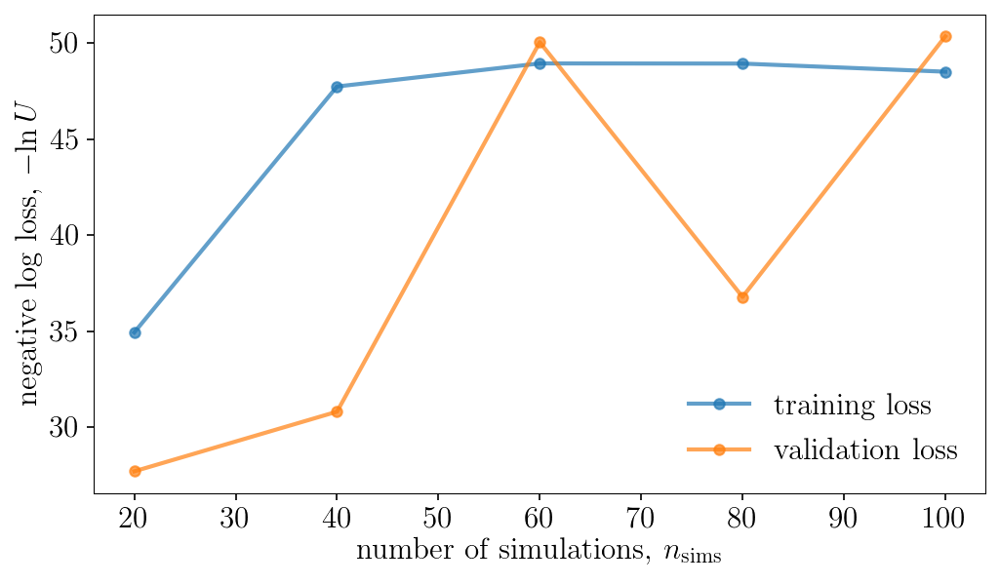

Population 38/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8512334490005742 s
total: 0.796589164998295 s
total: 0.7894831849989714 s
total: 0.7918242610030575 s
total: 0.7795254859993292 s
total: 0.7822236860010889 s
total: 0.784615708002093 s
total: 0.7872123870001815 s
total: 0.7869968220002193 s
total: 0.7858706850020098 s
total: 0.7877270089993544 s
total: 0.7812826719964505 s
total: 0.781504157002928 s
total: 0.7874358180015406 s
total: 0.7830062889988767 s
total: 0.7844658560024982 s
total: 0.7876376839994919 s
total: 0.783547021997947 s
total: 0.7868991719988117 s
total: 0.7833681990014156 s


Sampling approximate posterior...
Done.
Removed no burn in


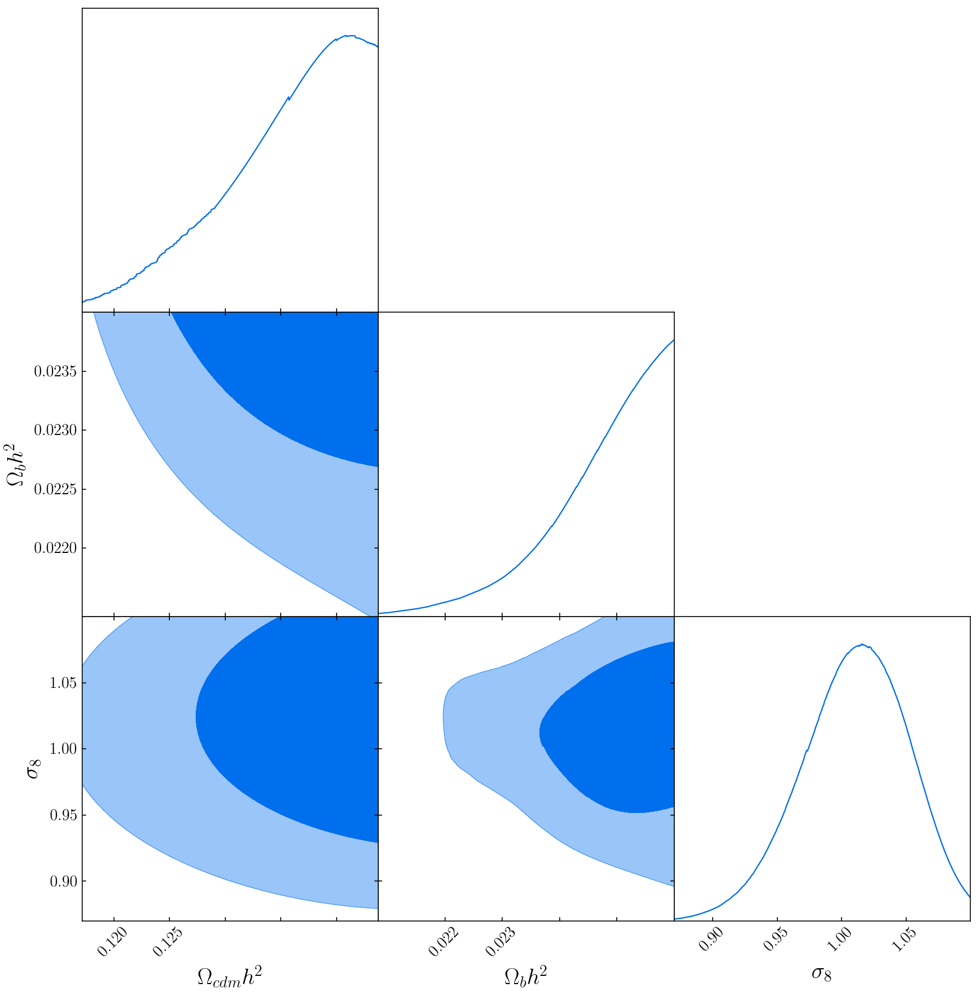

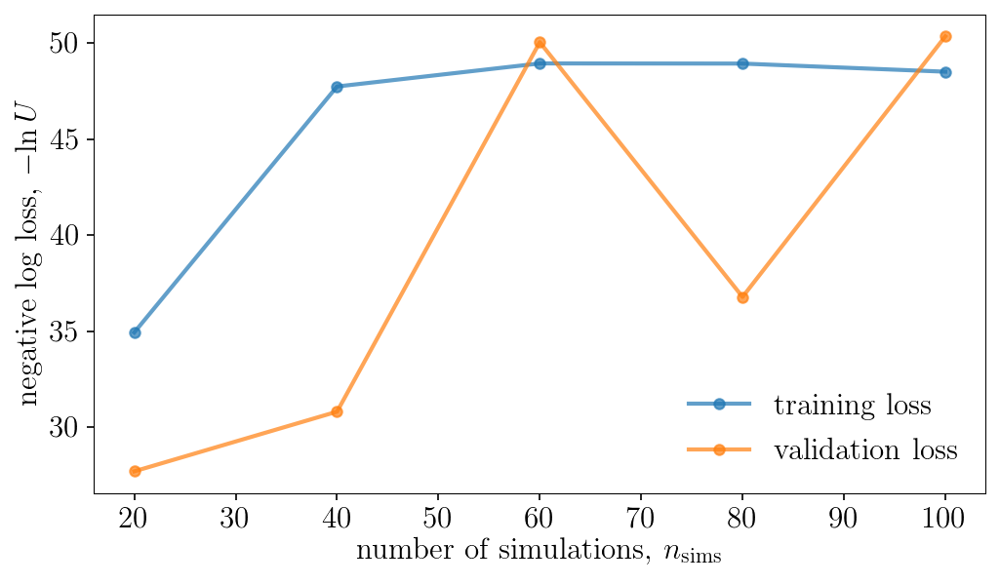

Population 39/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8462905610031157 s
total: 0.8112552649981808 s
total: 0.782044263996795 s
total: 0.7918397709981946 s
total: 0.7873637049997342 s
total: 0.7777613580001344 s
total: 0.7916900009986421 s
total: 0.7992173029997502 s
total: 0.8031682960026956 s
total: 0.785311890002049 s
total: 0.781424649998371 s
total: 0.7772154539998155 s
total: 0.7810447430019849 s
total: 0.7874288749990228 s
total: 0.7867652550012281 s
total: 0.7841883129985945 s
total: 0.7849107340007322 s
total: 0.7809951710005407 s
total: 0.8114069019975432 s
total: 0.7861448180010484 s


Sampling approximate posterior...
Done.
Removed no burn in


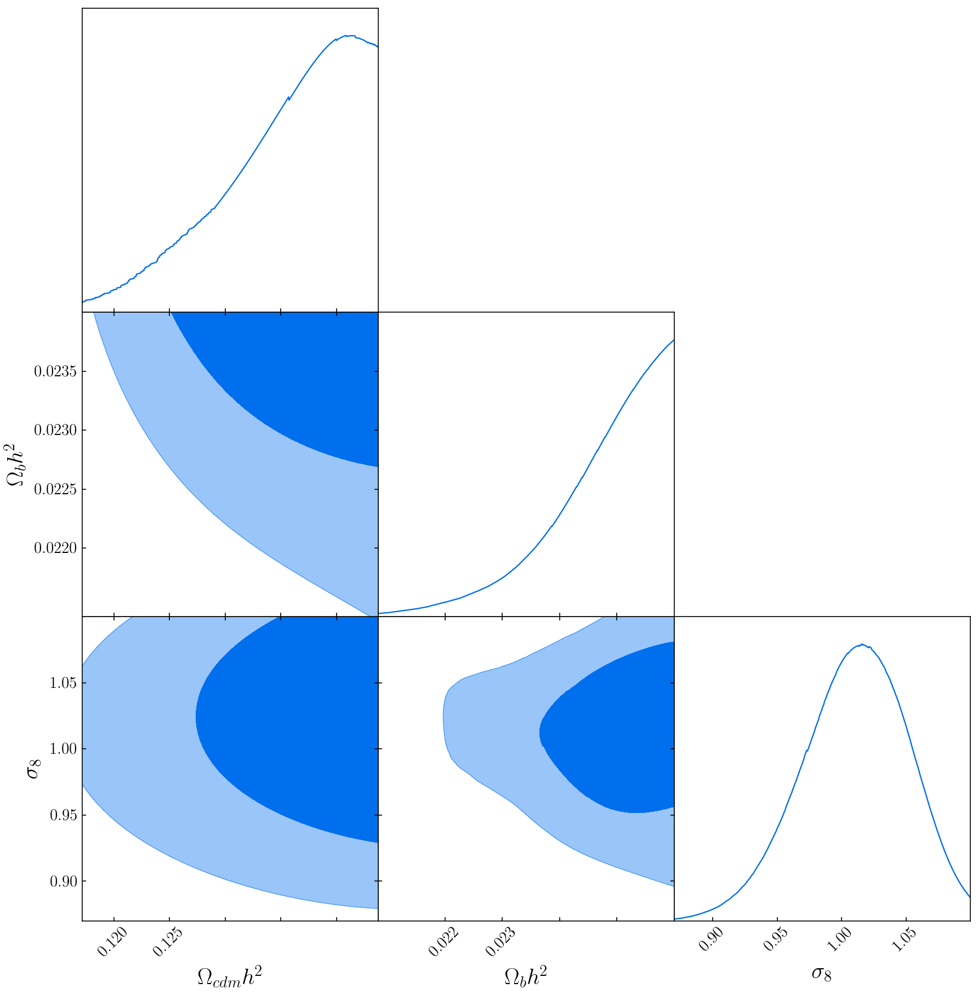

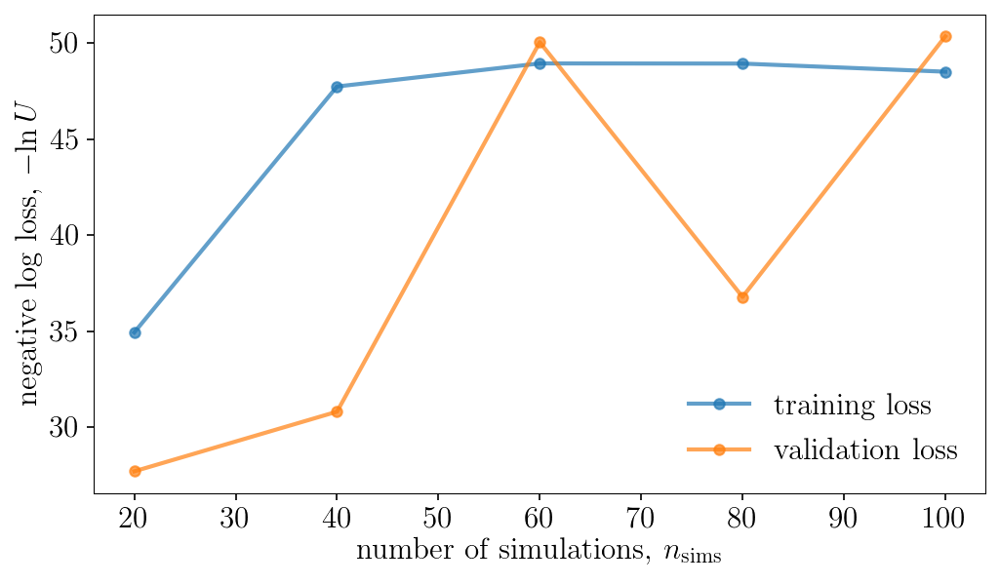

Population 40/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.7881755759990483 s
total: 0.7887183860002551 s
total: 0.7869717590001528 s
total: 0.785583682001743 s
total: 0.8256970030015509 s
total: 0.8125165390010807 s
total: 0.8052949900011299 s
total: 0.7849798559982446 s
total: 0.7868463470003917 s
total: 0.7954629380001279 s
total: 0.8105529189997469 s
total: 0.8129246019998391 s
total: 0.7848106710007414 s
total: 0.7871611369992024 s
total: 0.8014675759986858 s
total: 0.7797857040022791 s
total: 0.7869049029977759 s
total: 0.8131303800000751 s
total: 0.7824809089979681 s
total: 0.80035994300124 s


Sampling approximate posterior...
Done.
Removed no burn in


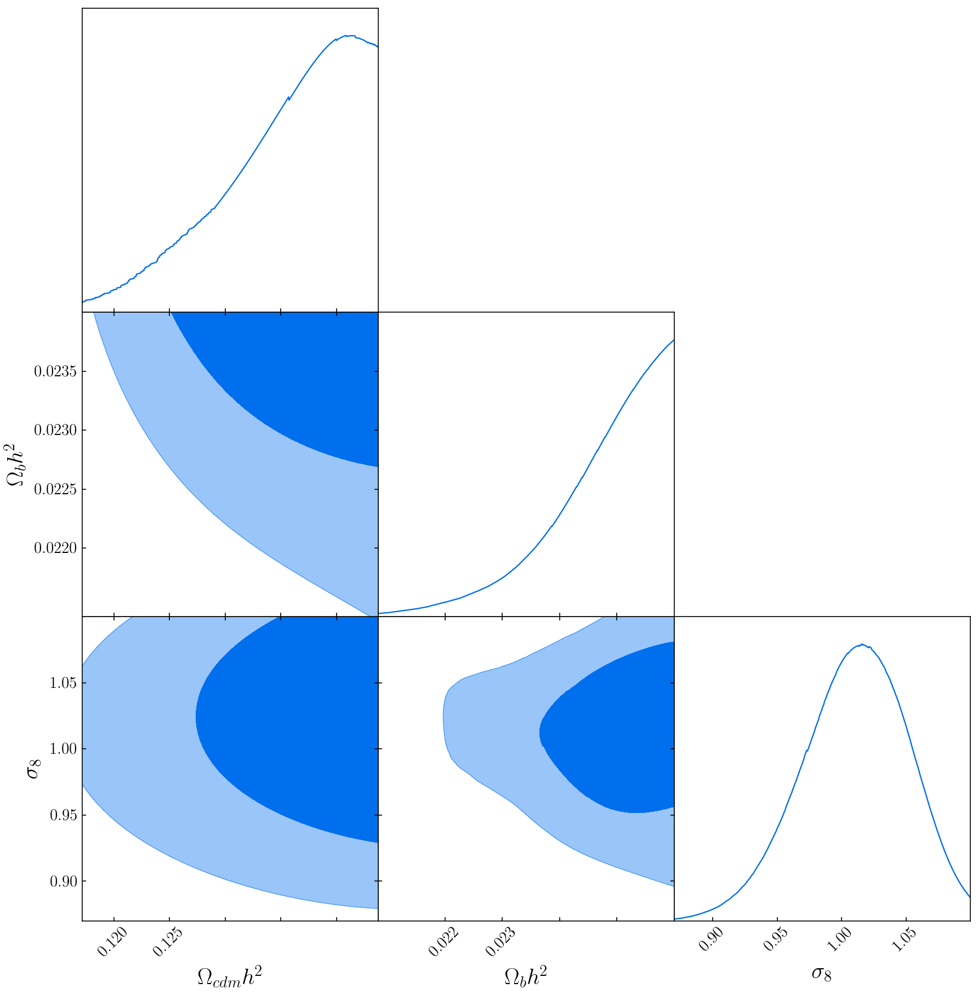

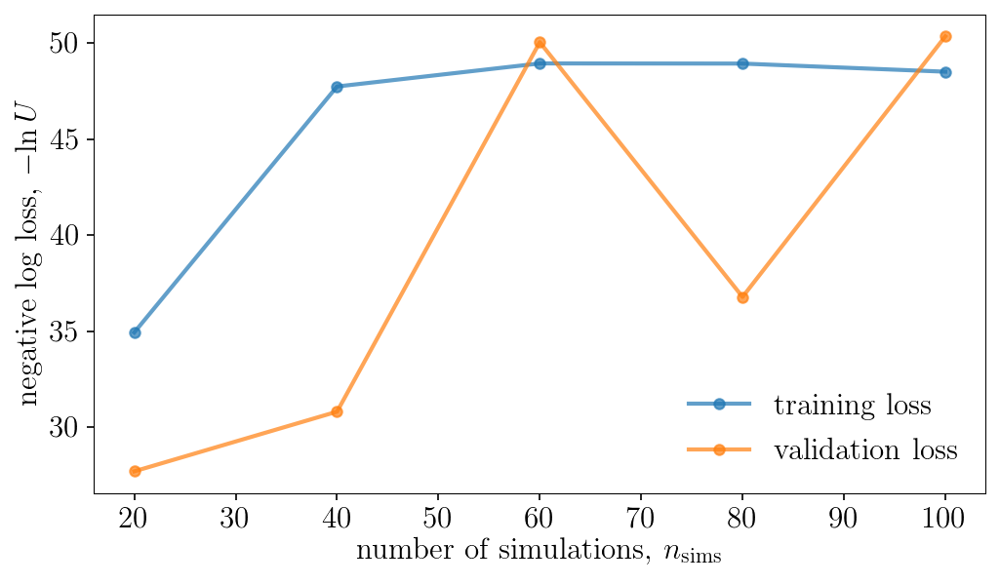

Population 41/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8302144030021736 s
total: 0.8287317249996704 s
total: 0.7830690139999206 s
total: 0.7945822879992193 s
total: 0.8090671729987662 s
total: 0.7849135149990616 s
total: 0.7831490500029759 s
total: 0.7963010929997836 s
total: 0.7828715869982261 s
total: 0.8172496560000582 s
total: 0.7948889059989597 s
total: 0.8078137270022125 s
total: 0.8009839000005741 s
total: 0.7811246679993928 s
total: 0.8023063449982146 s
total: 0.7973680920003972 s
total: 0.8199335989993415 s
total: 0.789212186999066 s
total: 0.7865103309995902 s
total: 0.7918621850003547 s


Sampling approximate posterior...
Done.
Removed no burn in


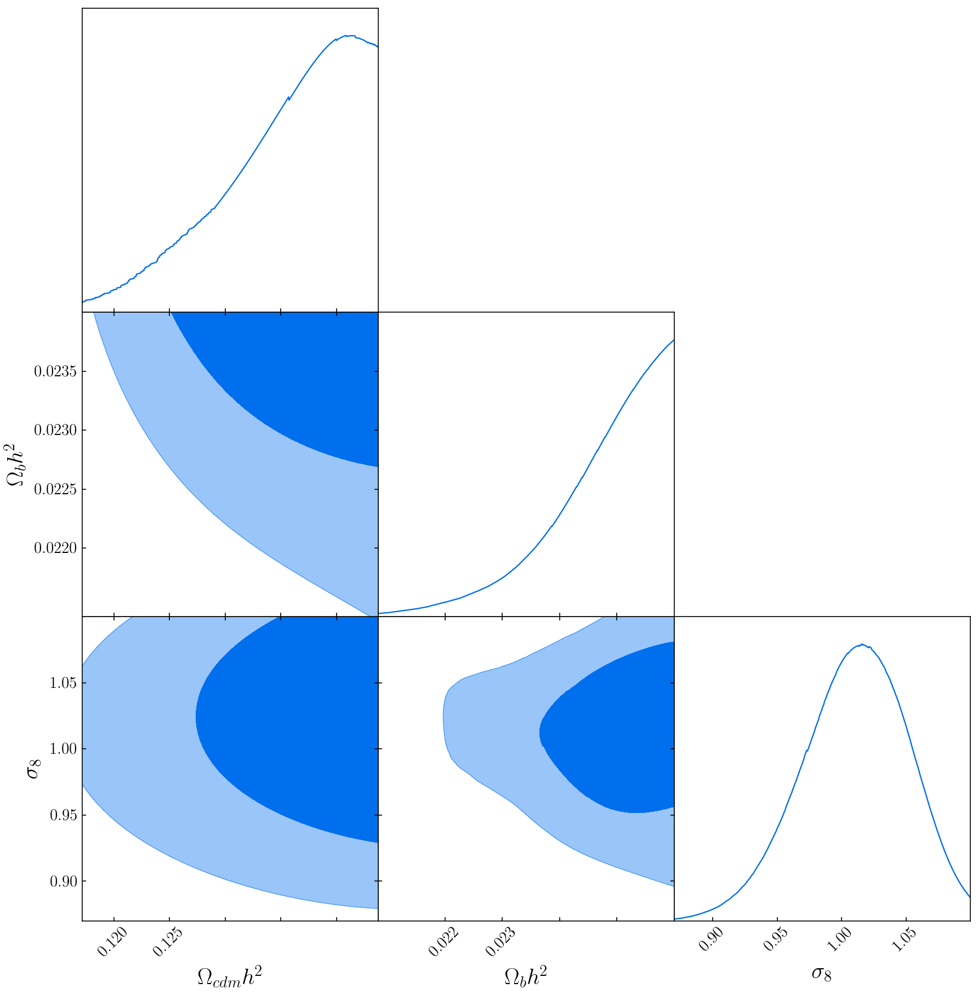

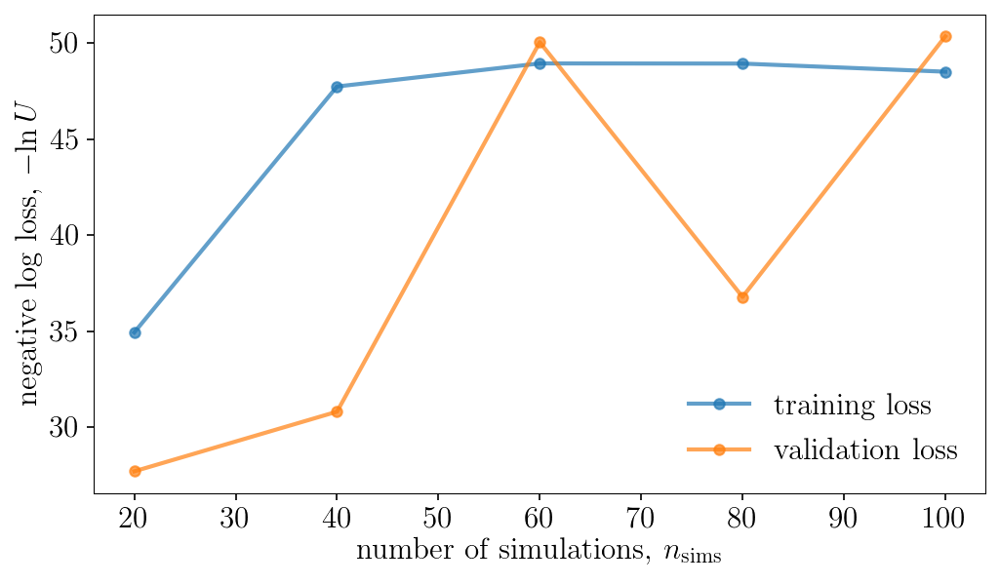

Population 42/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8030471620004391 s
total: 0.7795322380006837 s
total: 0.7828092170020682 s
total: 0.7783404010006052 s
total: 0.7837299719976727 s
total: 0.7811782179996953 s
total: 0.790475208999851 s
total: 0.7875628510009847 s
total: 0.7878568429987354 s
total: 0.7913257569998677 s
total: 0.7870710870010953 s
total: 0.7968605399983062 s
total: 0.8074588300005416 s
total: 0.7907704350000131 s
total: 0.7984488549991511 s
total: 0.7913591190008447 s
total: 0.7835052039990842 s
total: 0.818676040002174 s
total: 0.8105314729982638 s
total: 0.7975490610006091 s


Sampling approximate posterior...
Done.
Removed no burn in


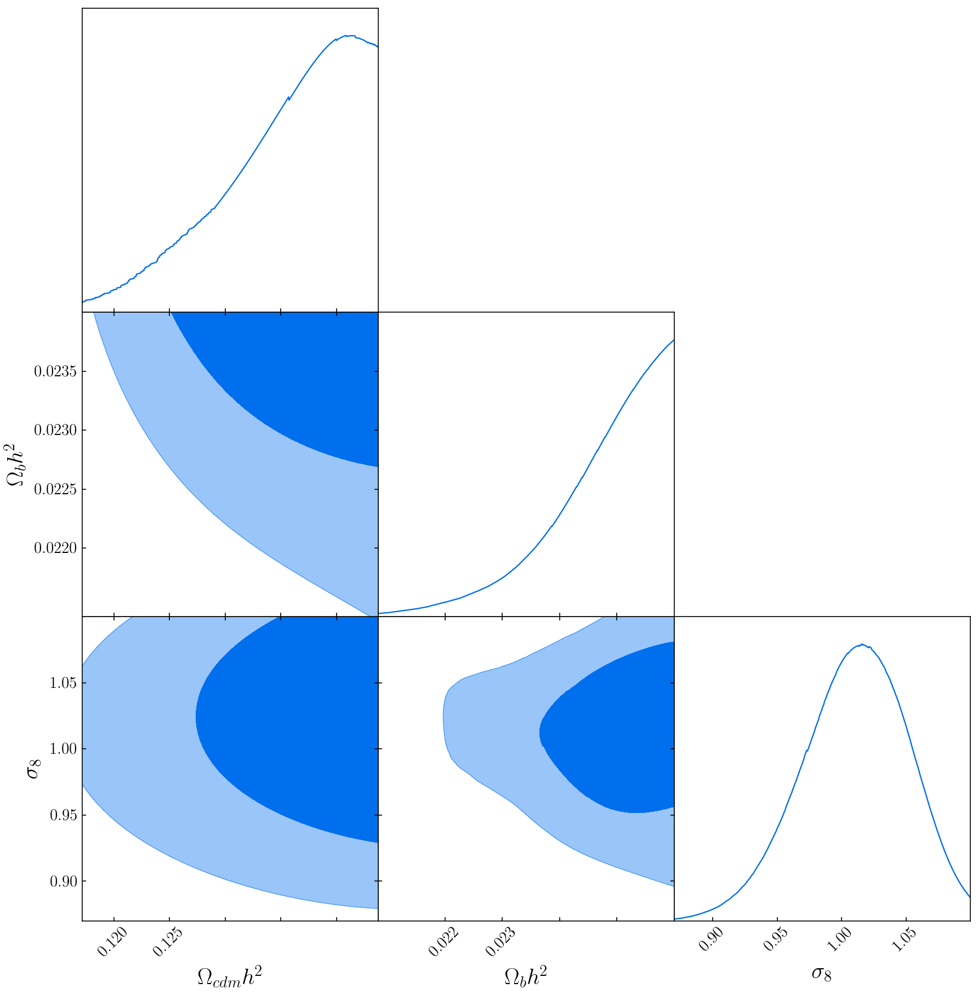

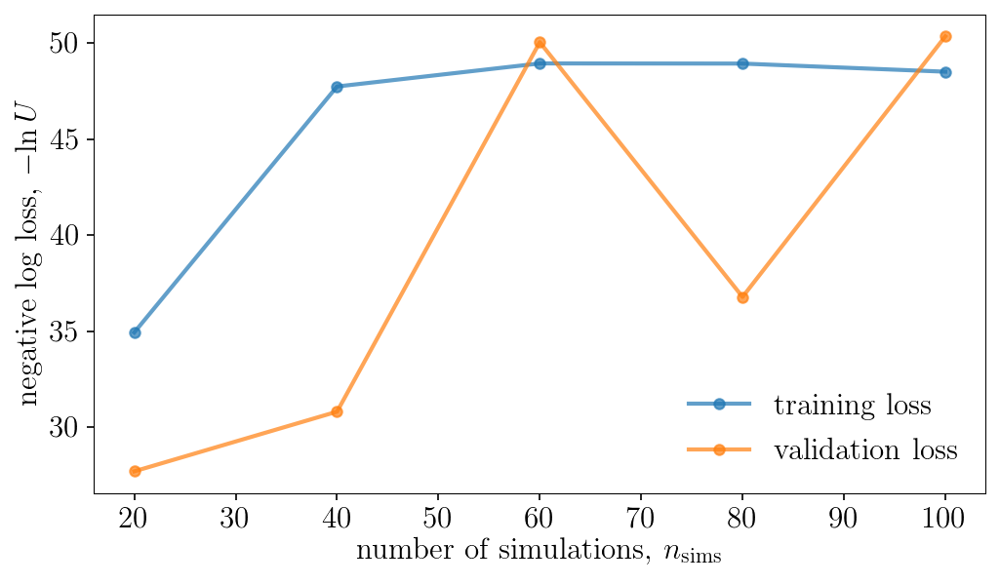

Population 43/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8285221329970227 s
total: 0.8008211800006393 s
total: 0.7963798899982066 s
total: 0.7993370149997645 s
total: 0.800866302997747 s
total: 0.7958694030021434 s
total: 0.8182688910019351 s
total: 0.7899645439974847 s
total: 0.782657855997968 s
total: 0.7851688629998534 s
total: 0.8210914330011292 s
total: 0.8090435520025494 s
total: 0.8314174200022535 s
total: 0.8213022820018523 s
total: 0.7806334159977268 s
total: 0.7994760450019385 s
total: 0.8096711280013551 s
total: 0.7853523240009963 s
total: 0.7839543160007452 s
total: 0.7894774769993091 s


Sampling approximate posterior...
Done.
Removed no burn in


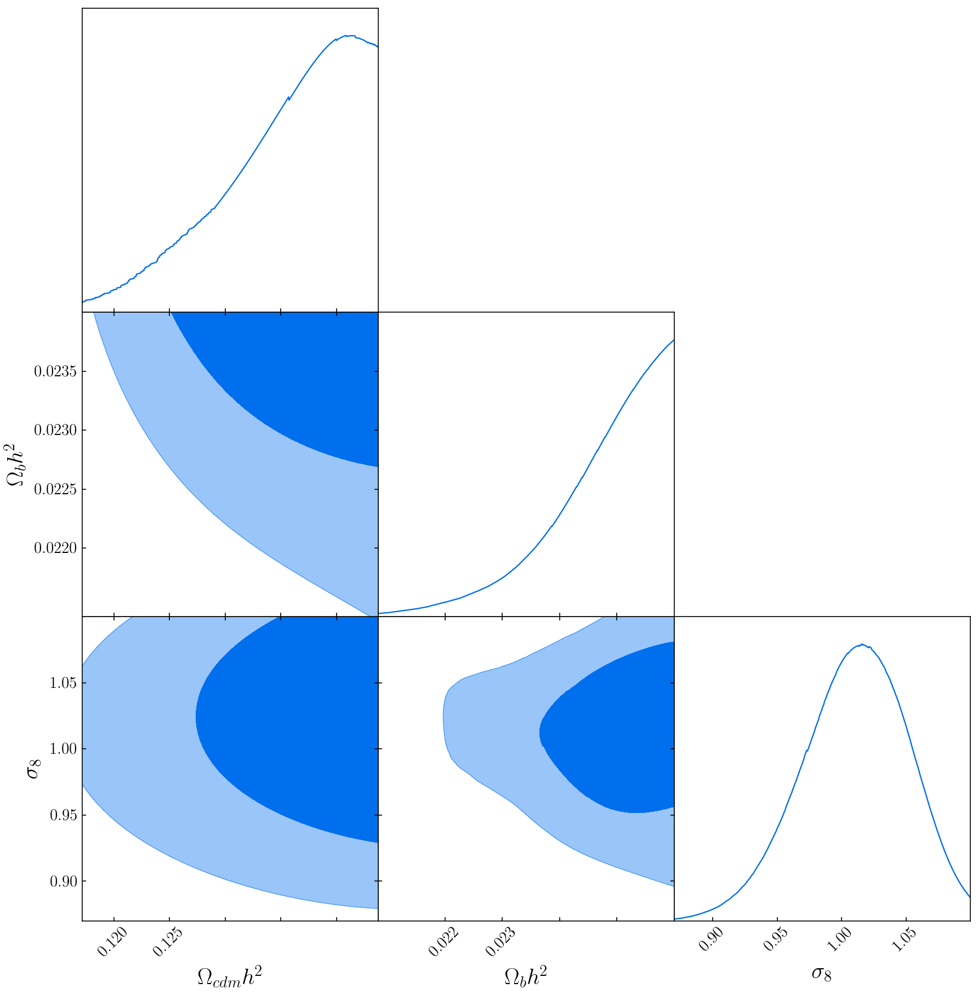

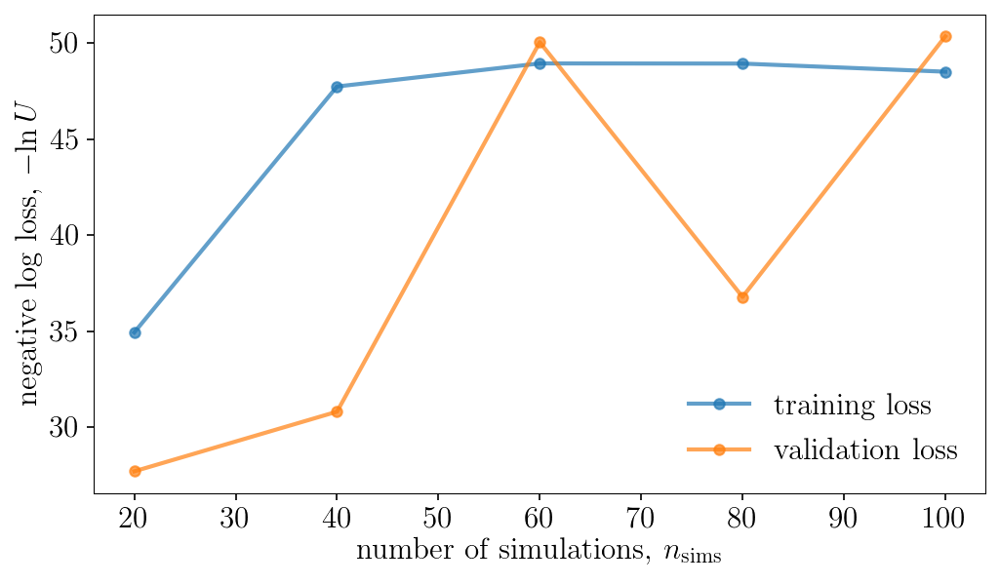

Population 44/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8199309340016043 s
total: 0.7901955579982314 s
total: 0.8102270580020559 s
total: 0.7826025009999285 s
total: 0.7952025949998642 s
total: 0.779900097000791 s
total: 0.7952665250013524 s
total: 0.7777108239970403 s
total: 0.7983297909995599 s
total: 0.783406639999157 s
total: 0.7794528049998917 s
total: 0.7831073329980427 s
total: 0.7853107890005049 s
total: 0.7765881549967162 s
total: 0.7779700380015129 s
total: 0.781106014001125 s
total: 0.7777968800000963 s
total: 0.7913879360021383 s
total: 0.7915127689993824 s
total: 0.778246151003259 s


Sampling approximate posterior...
Done.
Removed no burn in


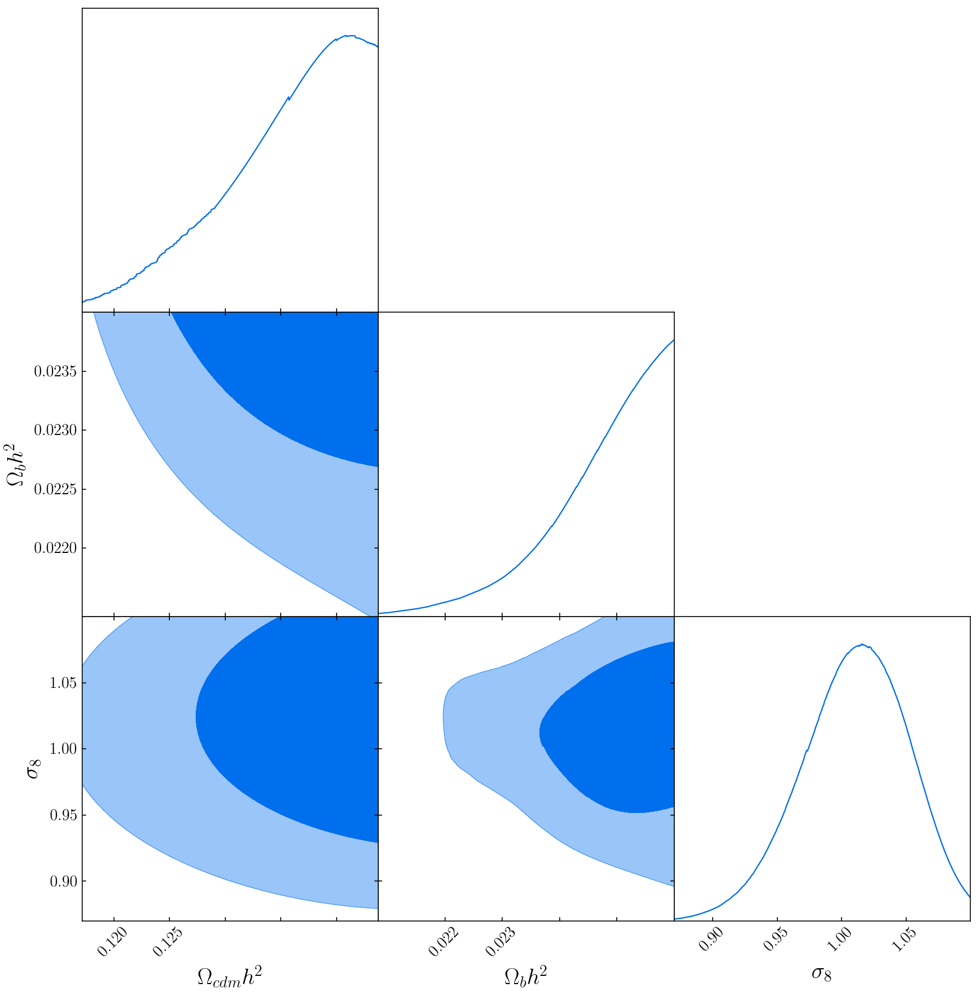

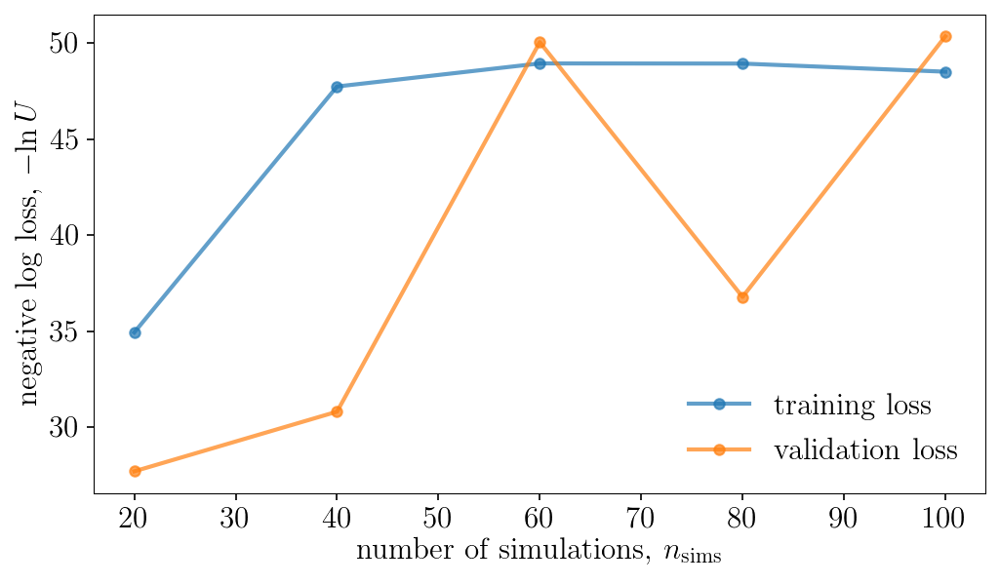

Population 45/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8845757340022828 s
total: 0.8393590560008306 s
total: 0.8645379730005516 s
total: 0.7910543379985029 s
total: 0.8006706800006214 s
total: 0.7785851519984135 s
total: 0.8213905060001707 s
total: 0.7988162170004216 s
total: 0.7949299519968918 s
total: 0.8199042000014742 s
total: 0.7870608400007768 s
total: 0.7852399229996081 s
total: 0.7827220269973623 s
total: 0.7824501569994027 s
total: 0.7868029220007884 s
total: 0.8104482759990788 s
total: 0.7852585970031214 s
total: 0.8092914050030231 s
total: 0.7894462090007437 s
total: 0.7828801079995173 s


Sampling approximate posterior...
Done.
Removed no burn in


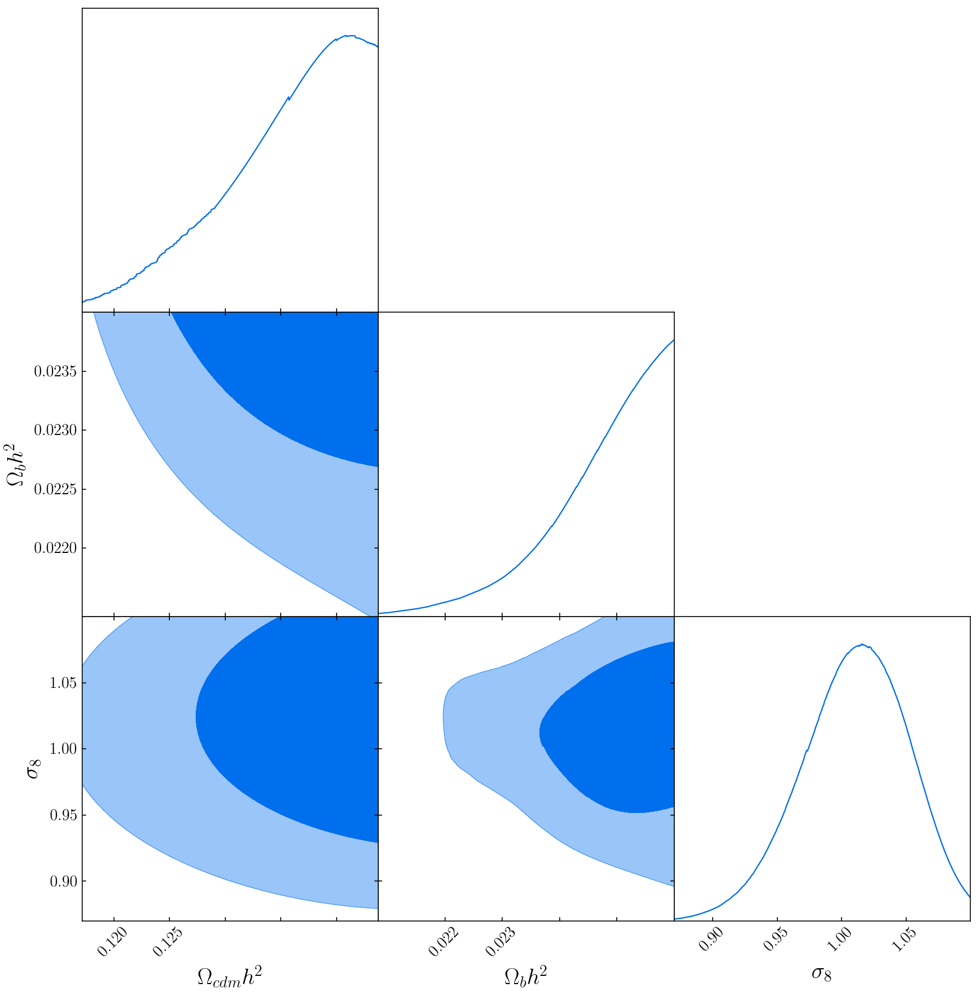

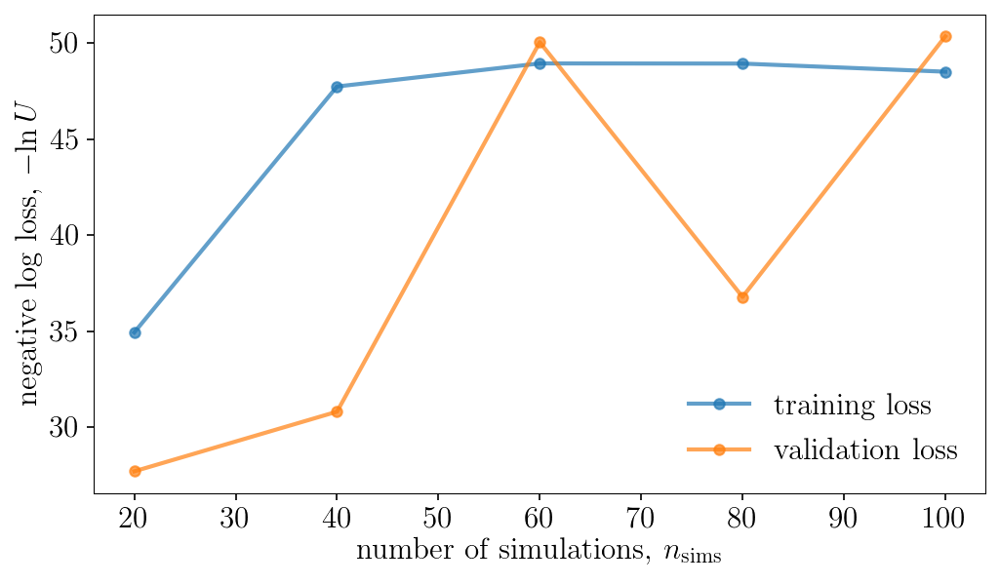

Population 46/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8570579120023467 s
total: 0.8027605829993263 s
total: 0.8231541519999155 s
total: 0.7924397099995986 s
total: 0.827489739000157 s
total: 0.8192769279994536 s
total: 0.7947943039980601 s
total: 0.7944921919988701 s
total: 0.8201583539994317 s
total: 0.8078172019995691 s
total: 0.8229561190019012 s
total: 0.8095134459981637 s
total: 0.7942715220015089 s
total: 0.8121349549983279 s
total: 0.8219542379993072 s
total: 0.81417506499929 s
total: 0.8201033830009692 s
total: 0.7846624080011679 s
total: 0.7876953550003236 s
total: 0.7900597850020858 s


Sampling approximate posterior...
Done.
Removed no burn in


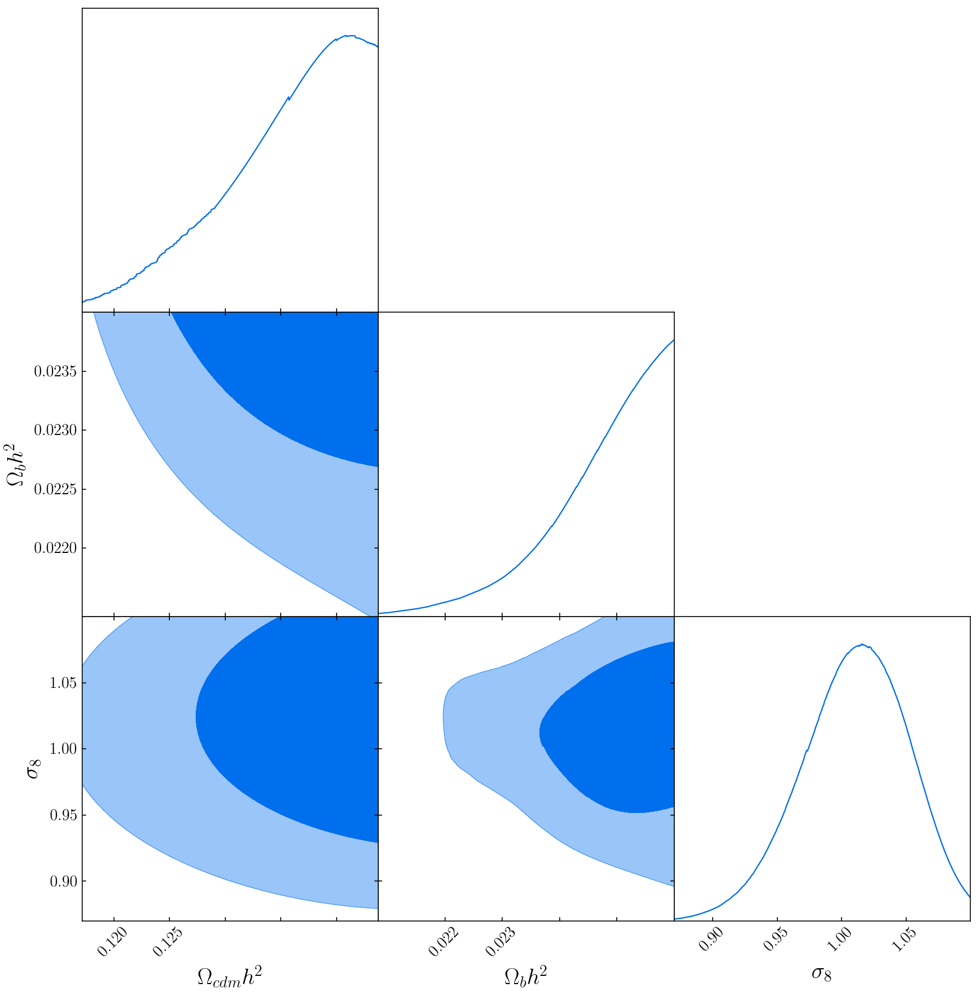

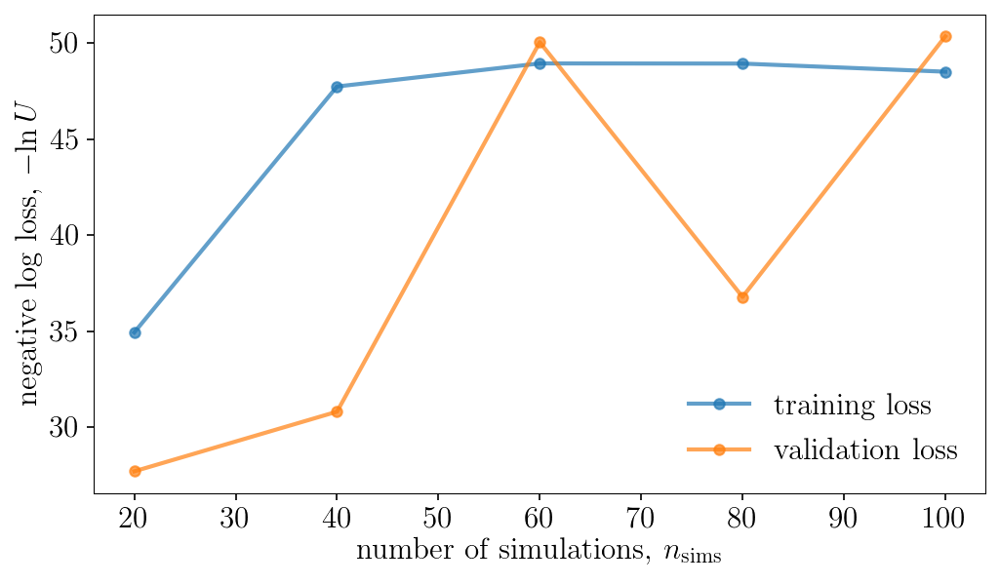

Population 47/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8219421009998769 s
total: 0.8288507699980983 s
total: 0.8008112009993056 s
total: 0.7994483969996509 s
total: 0.7938443089988141 s
total: 0.7940801650001958 s
total: 0.7864963559986791 s
total: 0.7972638589999406 s
total: 0.7887613589991815 s
total: 0.7859445629983384 s
total: 0.7929271820030408 s
total: 0.7965662959977635 s
total: 0.7837699199990311 s
total: 0.7982784539999557 s
total: 0.788510923001013 s
total: 0.7926068880005914 s
total: 0.7901590809997288 s
total: 0.7878160239997669 s
total: 0.794163041999127 s
total: 0.8077841970007285 s


Sampling approximate posterior...
Done.
Removed no burn in


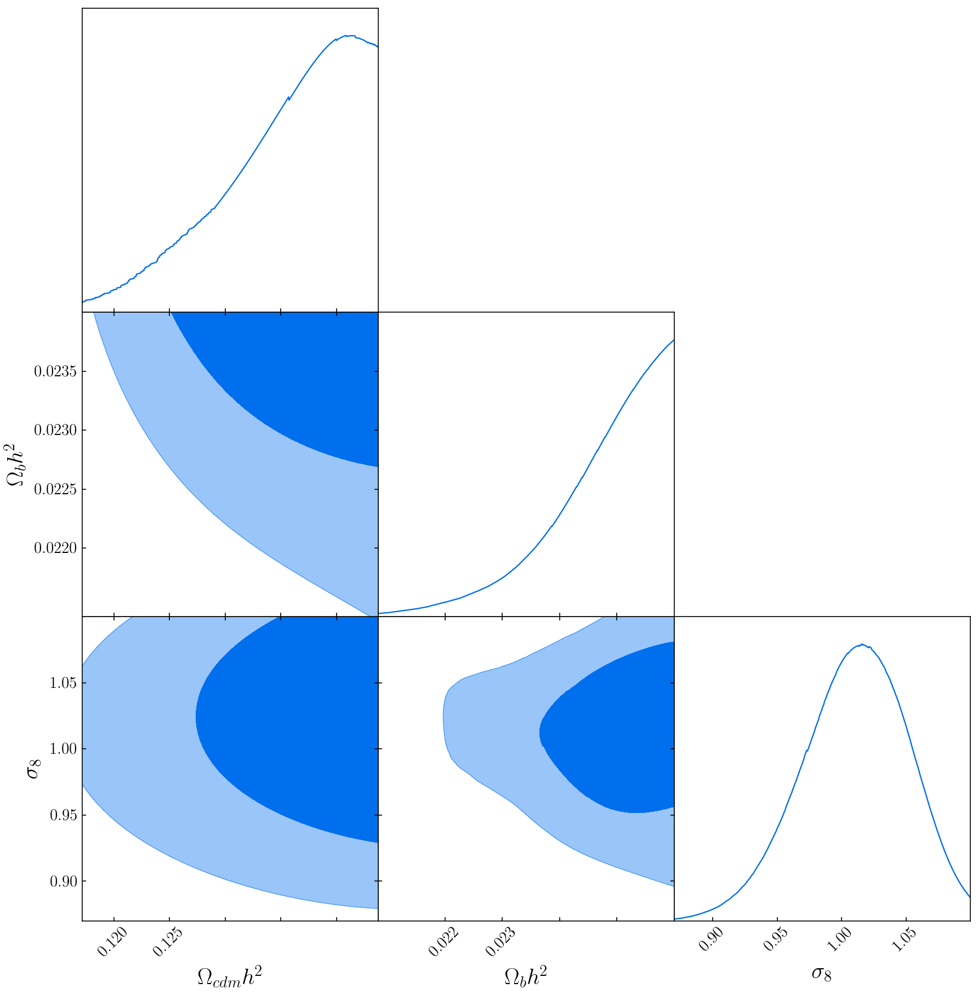

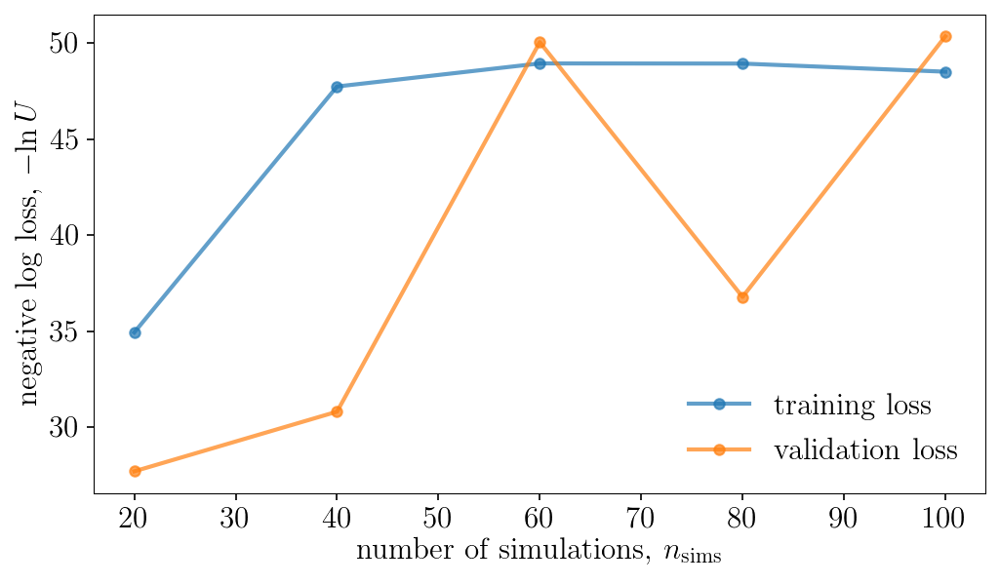

Population 48/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8324146529994323 s
total: 0.8562442260008538 s
total: 0.7867862050006806 s
total: 0.7871948059982969 s
total: 0.7884408320023795 s
total: 0.7879914959994494 s
total: 0.7837844820023747 s
total: 0.7935239960024774 s
total: 0.7873033509968081 s
total: 0.7873335719996248 s
total: 0.8143628879988682 s
total: 0.805706638002448 s
total: 0.7868215960006637 s
total: 0.7869608389992209 s
total: 0.7825940870025079 s
total: 0.8029702860003454 s
total: 0.7834238169998571 s
total: 0.804210387999774 s
total: 0.783371151999745 s
total: 0.8101432020011998 s


Sampling approximate posterior...
Done.
Removed no burn in


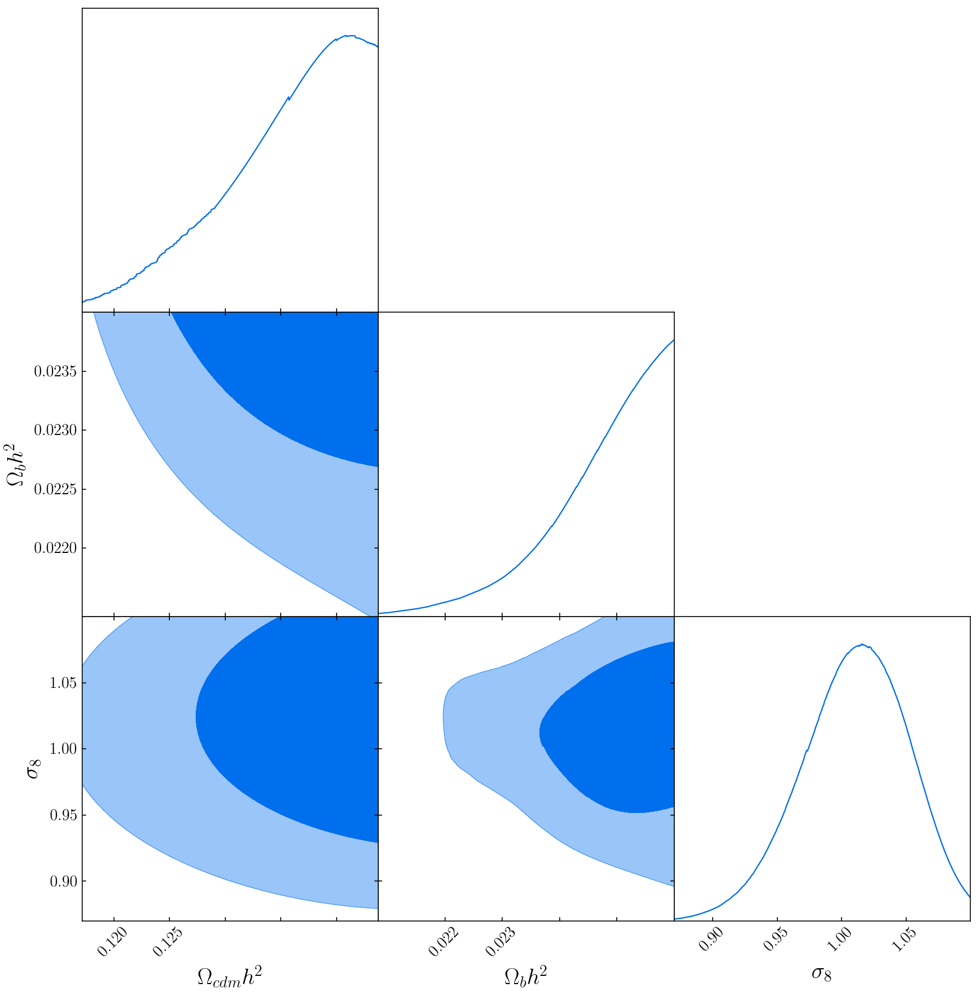

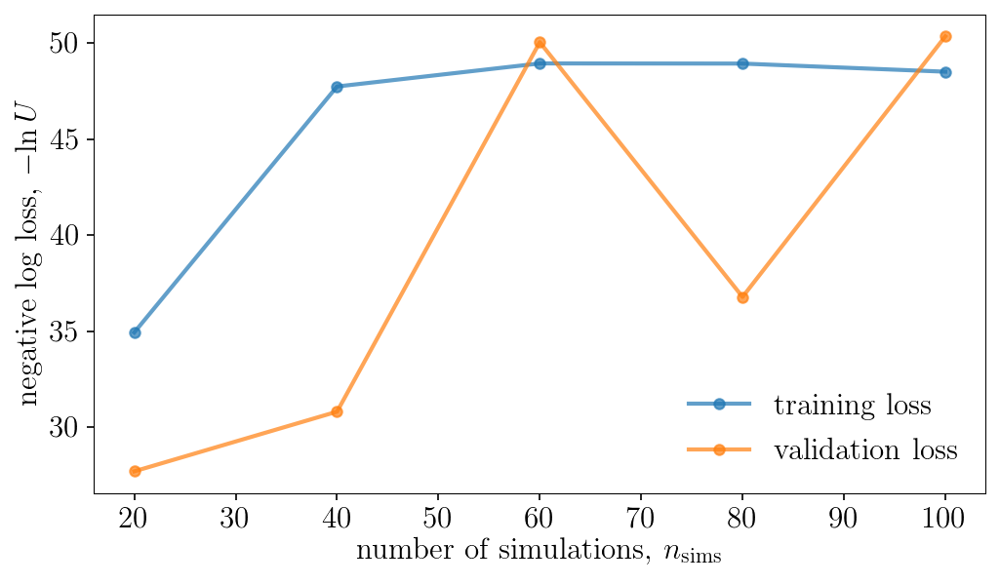

Population 49/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8248975689966755 s
total: 0.8300252500011993 s
total: 0.7781556390000333 s
total: 0.7963798549972125 s
total: 0.7905566709996492 s
total: 0.7807786509983998 s
total: 0.7840809959998296 s
total: 0.7854610069989576 s
total: 0.7789761809981428 s
total: 0.8020307639999373 s
total: 0.785451848001685 s
total: 0.7785893780019251 s
total: 0.781022737002786 s
total: 0.7884388750026119 s
total: 0.7766006470010325 s
total: 0.7779101749983965 s
total: 0.7880297470001096 s
total: 0.7792388510024466 s
total: 0.7844414230021357 s
total: 0.786196535002091 s


Sampling approximate posterior...
Done.
Removed no burn in


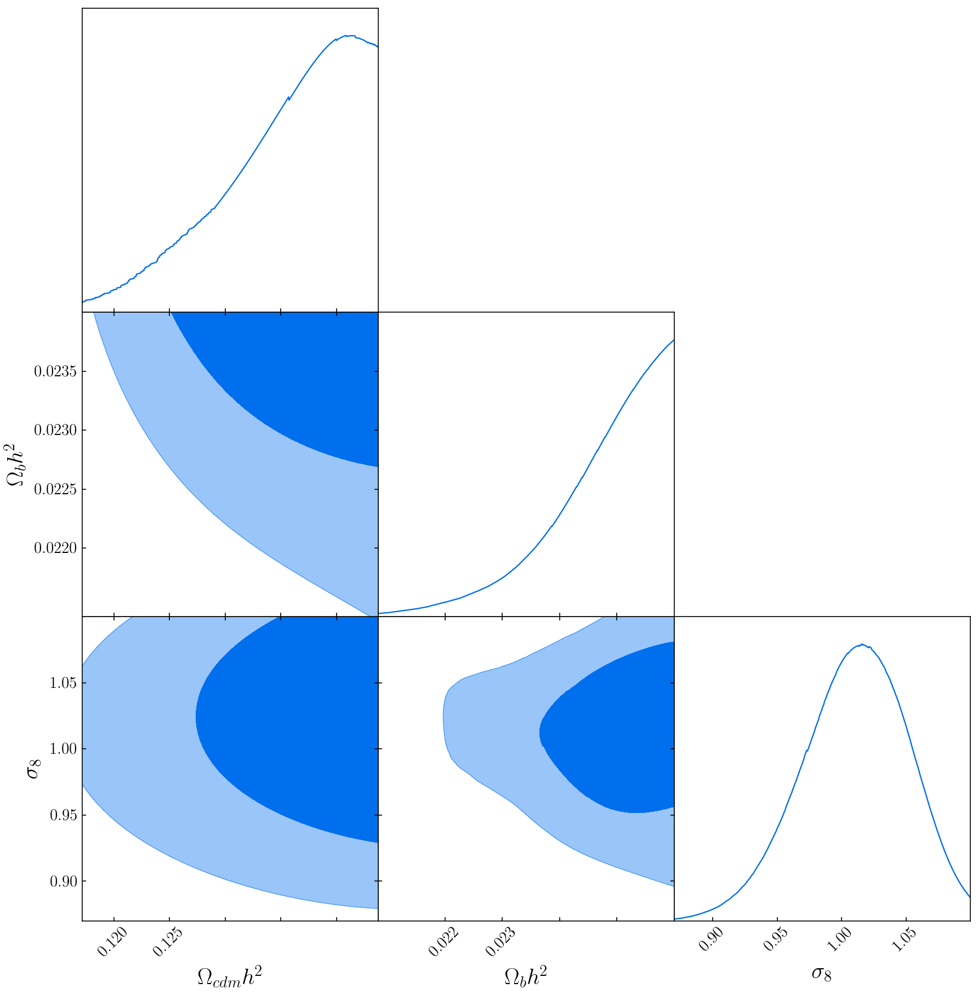

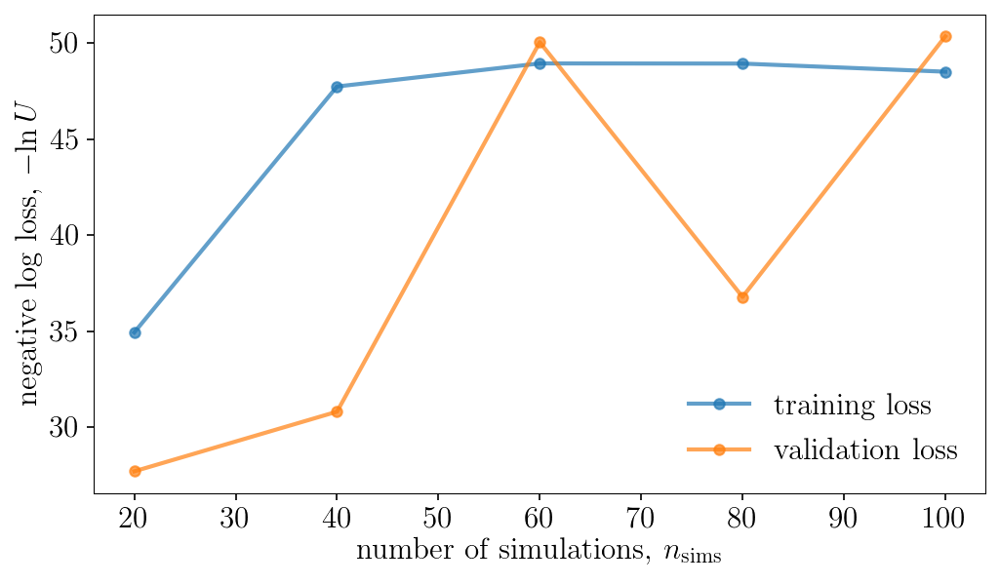

Population 50/50
Sampling proposal density...


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Done.


total: 0.8366347160008445 s
total: 0.8450936219996947 s
total: 0.8237044790002983 s
total: 0.8030418620001001 s
total: 0.7810949359991355 s
total: 0.7849583120005263 s
total: 0.7942213140013337 s
total: 0.7805153490007797 s
total: 0.7824730899992574 s
total: 0.8002467270016496 s
total: 0.7826023119996535 s
total: 0.7959635930019431 s
total: 0.7958720069982519 s
total: 0.7794310479985143 s
total: 0.7838756529999955 s
total: 0.7936363330009044 s
total: 0.7816679579991614 s
total: 0.8052631220016337 s
total: 0.7862741749995621 s
total: 0.7807698889992025 s


Sampling approximate posterior...
Done.
Removed no burn in


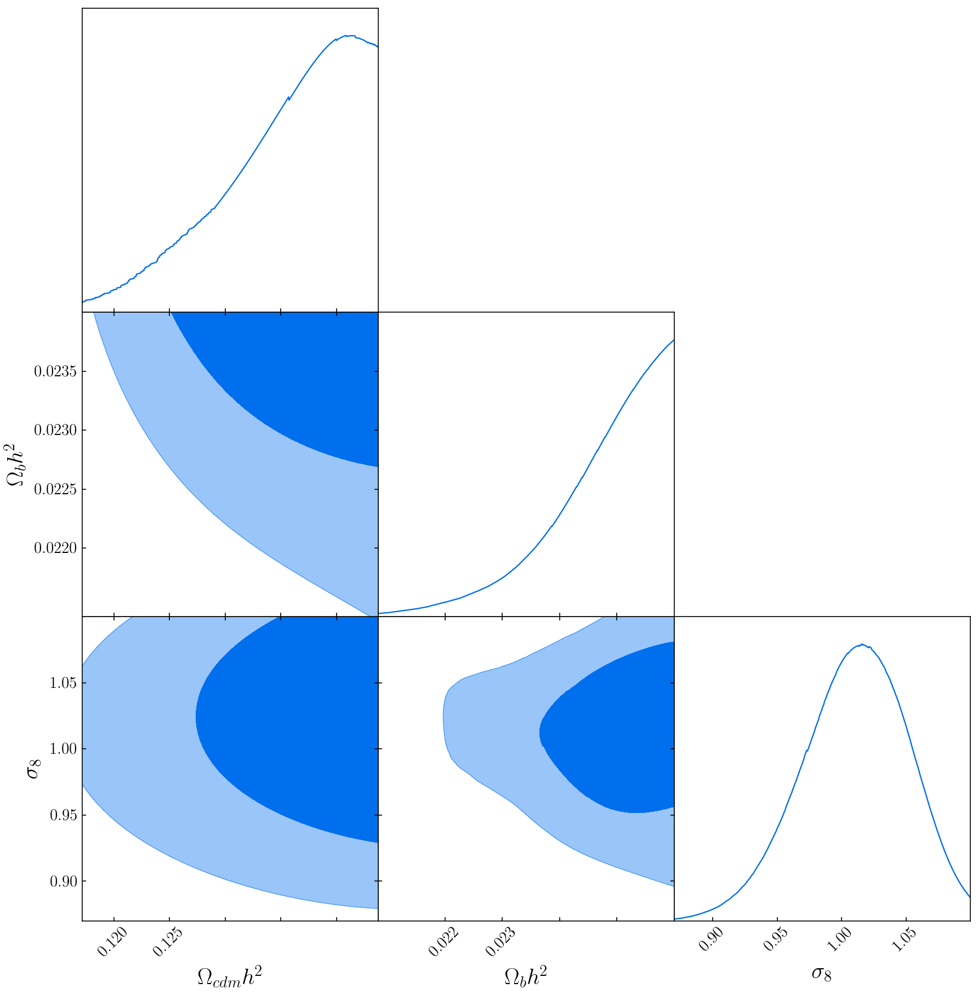

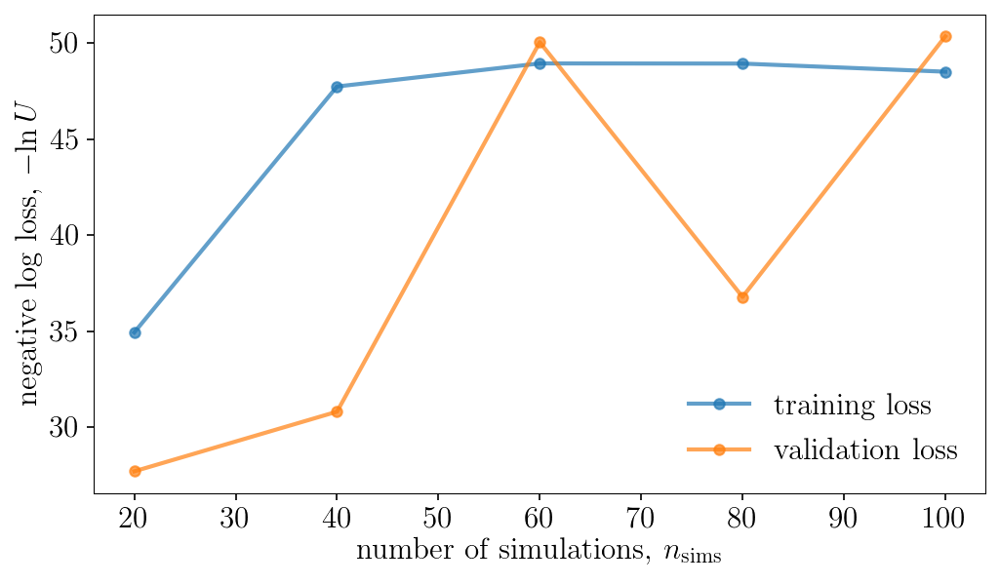

In [19]:
DelfiEnsemble.sequential_training(simulator, compressor, n_initial, n_batch, n_populations, patience=20)

In [20]:
DelfiEnsemble.sequential_nsims

[20,
 40,
 60,
 80,
 100,
 120,
 140,
 160,
 180,
 200,
 220,
 240,
 260,
 280,
 300,
 320,
 340,
 360,
 380,
 400,
 420,
 440,
 460,
 480,
 500,
 520,
 540,
 560,
 580,
 600,
 620,
 640,
 660,
 680,
 700,
 720,
 740,
 760,
 780,
 800,
 820,
 840,
 860,
 880,
 900,
 920,
 940,
 960,
 980,
 1000,
 1020]

In [21]:
DelfiEnsemble.stacked_sequential_training_loss

[34.94218063354493,
 47.75225830078234,
 48.95318984985462,
 48.94574737548886,
 48.522529602051016,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan]

In [23]:
DelfiEnsemble.stacked_sequential_validation_loss

[27.707836151123054,
 30.815376281739844,
 50.05809402465932,
 36.792106628418786,
 50.36354446411156,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan]

In [24]:
x0 = DelfiEnsemble.posterior_samples[np.random.choice(np.arange(len(DelfiEnsemble.posterior_samples)), p=DelfiEnsemble.posterior_weights.astype(np.float32)/sum(DelfiEnsemble.posterior_weights), replace=False, size=DelfiEnsemble.nwalkers),:]
posterior_samples, posterior_weights, log_prob = DelfiEnsemble.emcee_sample(x0=x0)


/home/aizhana/.local/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]


Removed no burn in


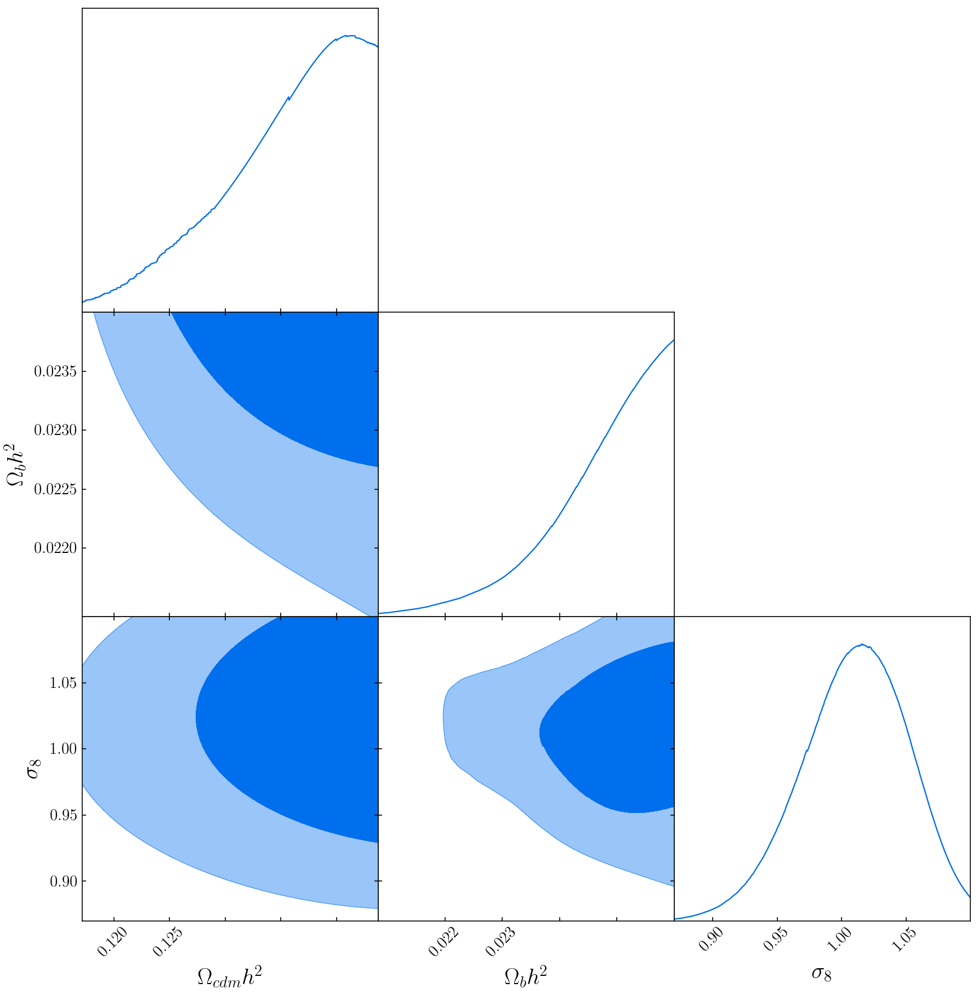

In [25]:
DelfiEnsemble.triangle_plot(samples=[posterior_samples], weights=[posterior_weights])